# Generative Models as Data Augmentation in the Medical Domain

## 1. Overview

This project tries to evaluate the quality of generative models for data augmentation in the medical domain. 

Data augmentation will be relying on geometric data augmentation, (variational) auto-encoder (e.g. stacked denoising, denoising auto-encoder, etc.), and generative adversarial neural networks (e.g. GAN, DCGAN, Wasserstein GAN, etc.) for instance.

We will restrict ourself to three kind of models to generate new data and evaluate the (possible) improvement with regards to a final classification score (i.e. comparing results between augmented and non-augmented training sets). 

### Datasets

We will look into applying the above project on some (if not all) of the following datasets from the MedMNIST Classification Decathlon (https://medmnist.github.io/):

| Dataset | Classification Type | Train size | Validation size | Test size |
| :--- | :--- | :---: | :---: | :---: |  
| PathMNIST Pathology | Multi-Class (9) | 89,996 | 10,004 | 7,180 |
| DermaMNIST Dermatoscope | Multi-Class (7) | 7,007 | 1,003 | 2,005 |
| OctMNIST | Multi-Class (4) | 97,477 | 10,832 | 1,000 |
| PneumoniaMNIST Chest X-ray | Binary-Class (2) |4,708 | 524 | 624 |
| BreastMNIST Breast Ultrasound | Binary-Class (2) | 546 | 78 | 156 |
| OrganMNIST_Axial Abdominal CT | Multi-Class (11) | 34,581 | 6,491 | 17,778 |
| OragnMNIST_Coronal Abdominal CT | Multi-Class (11) |13,000 | 2,392 | 8,268 |
| OrganMNIST_Sagittal Abdominal CT | Multi-Class (11) | 13,940 | 2,452 | 8,829 |

### Notes

We will also provide a short report (in copy) explaining the choice of VAE, AE, and/or GAN models, outlining differences between datasets' results. We will also try to interprete and justify possible differences with regards to models, data specifications, visual features, and bibliography references used to support the choices made.

## 2. Data imports, Library Imports, and other preliminary declarations

### Source

We will retrieve the above dataset from the following website:

> [MedMNIST v2: A Large-Scale Lightweight Benchmark for 2D and 3D Biomedical Image Classification](https://medmnist.com/), Jiancheng Yang,Rui Shi,Donglai Wei,Zequan Liu,Lin Zhao,Bilian Ke,Hanspeter Pfister,Bingbing Ni

By following the instructions on their [github](https://github.com/MedMNIST/MedMNIST), we can download their ready-made module with the following instruction:

```sh
pip install jupyter ipywidgets IProgress
pip install medmnist
```

And load it in a python or ipython instance:

```python
import medmnist
```

### Library Imports

In [1]:
from scripts.classifier import run_classifier_pipeline
from scripts.variational_autoencoders import run_encoder_pipeline, one_hot
from scripts.generative_adversarial_networks import run_GAN_pipeline
from scripts.data import retrieve_flag_info, import_dataset
from scripts.data import check_cuda_availability
from scripts.data import generate_augmented_dataset_condVAE
from scripts.data import generate_augmented_dataset_jointVAE
from scripts.data import generate_augmented_dataset_condGAN

import os
import warnings
warnings.filterwarnings('ignore')

/home/quentin/anaconda3/envs/ML_base/lib/python3.9/site-packages/torchvision/io/image.py:11: UserWarning: Failed to load image Python extension: /home/quentin/anaconda3/envs/ML_base/lib/python3.9/site-packages/torchvision/image.so: undefined symbol: _ZNK2at10TensorBase21__dispatch_contiguousEN3c1012MemoryFormatE
  warn(f"Failed to load image Python extension: {e}")


### Checks CUDA availability

In [2]:
check_cuda_availability()

True,0,<torch.cuda.device object at 0x7f53d63f6040>,1
NVIDIA GeForce GTX 980 Ti


### Data Imports

We import the datasets in four manners:

| import # | with WSR | with Geometric DA | Application | Other transformation | 
| --- | --- | --- | --- | --- |
| 1 | No | No | To test the baseline classifier |  No | 
| 2 | Yes | No | To test the baseline classifier and train the VAE |  No | 
| 3 | Yes | No | To train the GAN |  Iimage upscale to 32x32* | 
| 4 | Yes | Yes | To test the baseline classifier |  No | 

\* Images are upscaled to 32 pixels by 32 pixels in size in order to work with TorchFusion's implementation of a GAN.


In [3]:
data_flags = ["pathmnist", "dermamnist", "octmnist", "pneumoniamnist", 
              "breastmnist", "organamnist", "organcmnist", "organsmnist"]

info_flags = {flag:retrieve_flag_info(flag) for flag in data_flags}

Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Montage of randomly extracted images from the dataset:


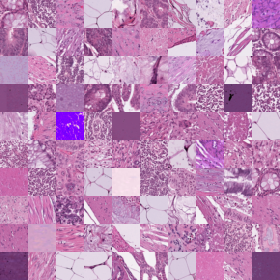

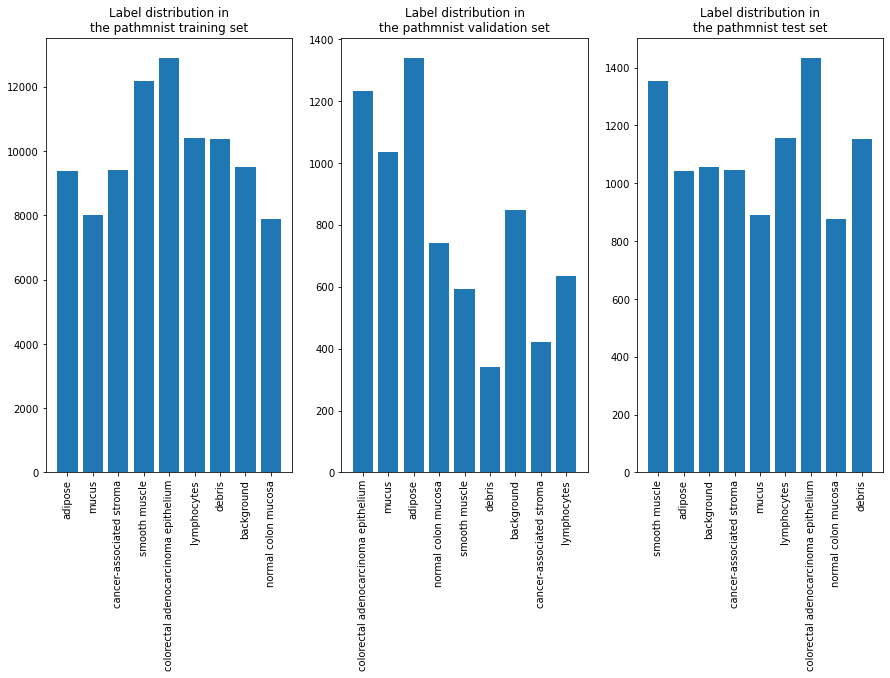

Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pathmnist.npz


In [4]:
pathmnist_noWRS_noGDA = import_dataset(
    "pathmnist", info_flags, print_visualization=True
)
pathmnist_noGDA = import_dataset(
    "pathmnist", info_flags, sampler=True
)
pathmnist_noWSR_GDA = import_dataset(
    "pathmnist", info_flags, geometric_augment=3
)
pathmnist_WSR_GDA = import_dataset(
    "pathmnist", info_flags, sampler=True, geometric_augment=3
)
# To be used for the GAN training
pathmnist_noWRS_noGDA_upscaled = import_dataset(
    "pathmnist", info_flags, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Montage of randomly extracted images from the dataset:


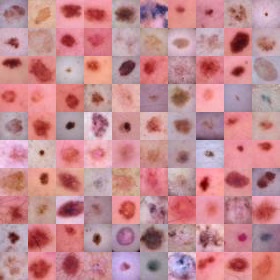

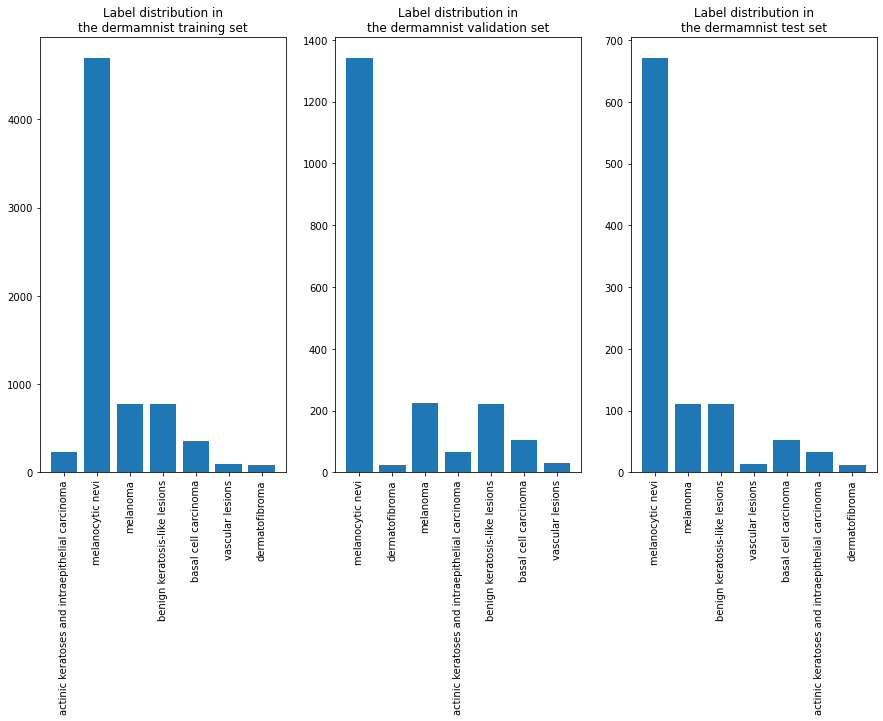

Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/dermamnist.npz


In [5]:
dermamnist_noWRS_noGDA = import_dataset(
    "dermamnist", info_flags, print_visualization=True
)
dermamnist_noGDA = import_dataset(
    "dermamnist", info_flags, sampler=True
)
dermamnist_noWSR_GDA = import_dataset(
    "dermamnist", info_flags, geometric_augment=3
)
dermamnist_WSR_GDA = import_dataset(
    "dermamnist", info_flags, sampler=True, geometric_augment=3
)
# To be used for the GAN training
dermamnist_noWRS_noGDA_upscaled = import_dataset(
    "dermamnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Montage of randomly extracted images from the dataset:


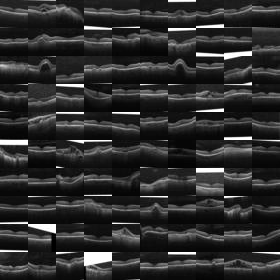

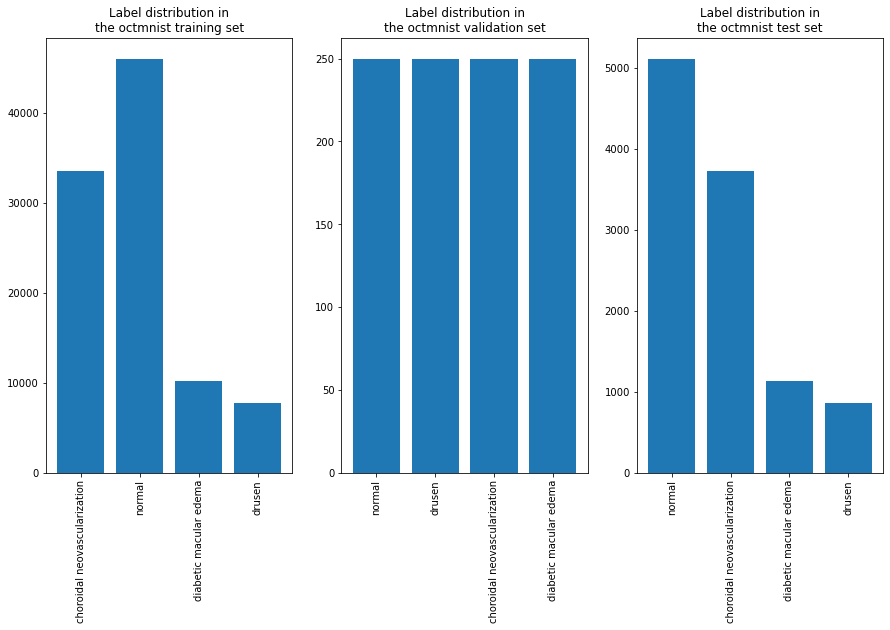

Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/octmnist.npz


In [6]:
octmnist_noWRS_noGDA = import_dataset(
    "octmnist", info_flags, print_visualization=True
)
octmnist_noGDA = import_dataset(
    "octmnist", info_flags, sampler=True
)
octmnist_noWSR_GDA = import_dataset(
    "octmnist", info_flags, geometric_augment=2
)
octmnist_WSR_GDA = import_dataset(
    "octmnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
octmnist_noWRS_noGDA_upscaled = import_dataset(
    "octmnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Montage of randomly extracted images from the dataset:


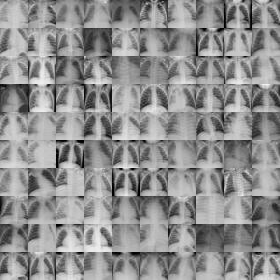

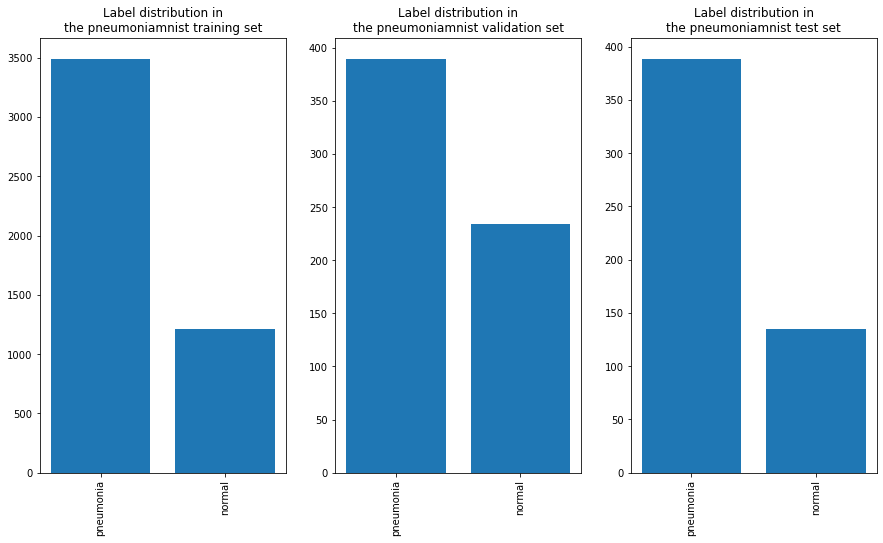

Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/pneumoniamnist.npz


In [7]:
pneumoniamnist_noWRS_noGDA = import_dataset(
    "pneumoniamnist", info_flags, print_visualization=True
)
pneumoniamnist_noGDA = import_dataset(
    "pneumoniamnist", info_flags, sampler=True
)
pneumoniamnist_noWSR_GDA = import_dataset(
    "pneumoniamnist", info_flags, geometric_augment=2
)
pneumoniamnist_WSR_GDA = import_dataset(
    "pneumoniamnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
pneumoniamnist_noWRS_noGDA_upscaled = import_dataset(
    "pneumoniamnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Montage of randomly extracted images from the dataset:


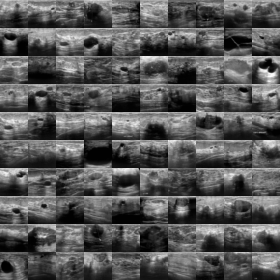

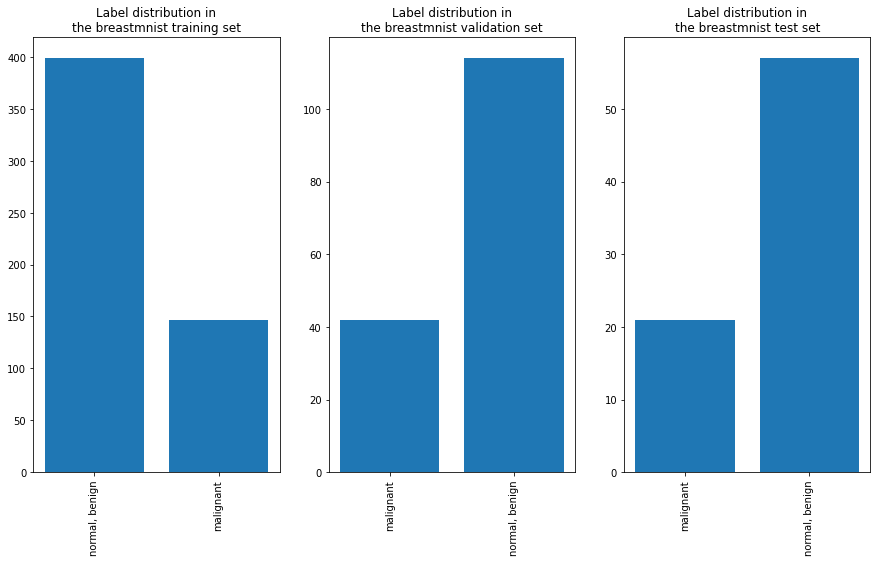

Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/breastmnist.npz


In [8]:
breastmnist_noWRS_noGDA = import_dataset(
    "breastmnist", info_flags, print_visualization=True
)
breastmnist_noGDA = import_dataset(
    "breastmnist", info_flags, sampler=True
)
breastmnist_noWSR_GDA = import_dataset(
    "breastmnist", info_flags, geometric_augment=2
)
breastmnist_WSR_GDA = import_dataset(
    "breastmnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
breastmnist_noWRS_noGDA_upscaled = import_dataset(
    "breastmnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Montage of randomly extracted images from the dataset:


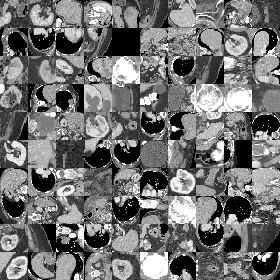

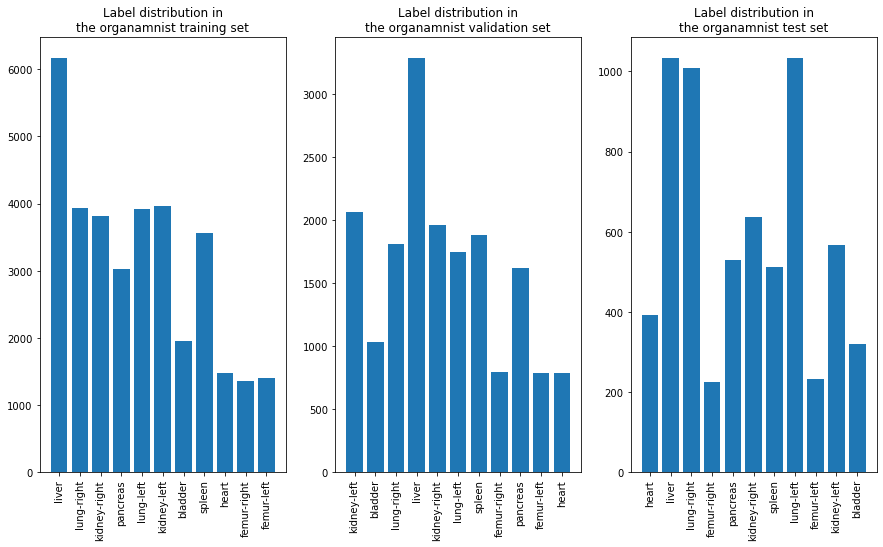

Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organamnist.npz


In [9]:
organamnist_noWRS_noGDA = import_dataset(
    "organamnist", info_flags, print_visualization=True
)
organamnist_noGDA = import_dataset(
    "organamnist", info_flags, sampler=True
)
organamnist_noWSR_GDA = import_dataset(
    "organamnist", info_flags, geometric_augment=2
)
organamnist_WSR_GDA = import_dataset(
    "organamnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
organamnist_noWRS_noGDA_upscaled = import_dataset(
    "organamnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Montage of randomly extracted images from the dataset:


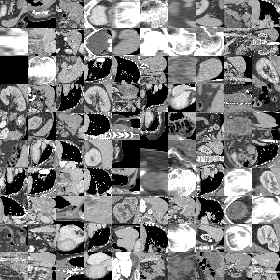

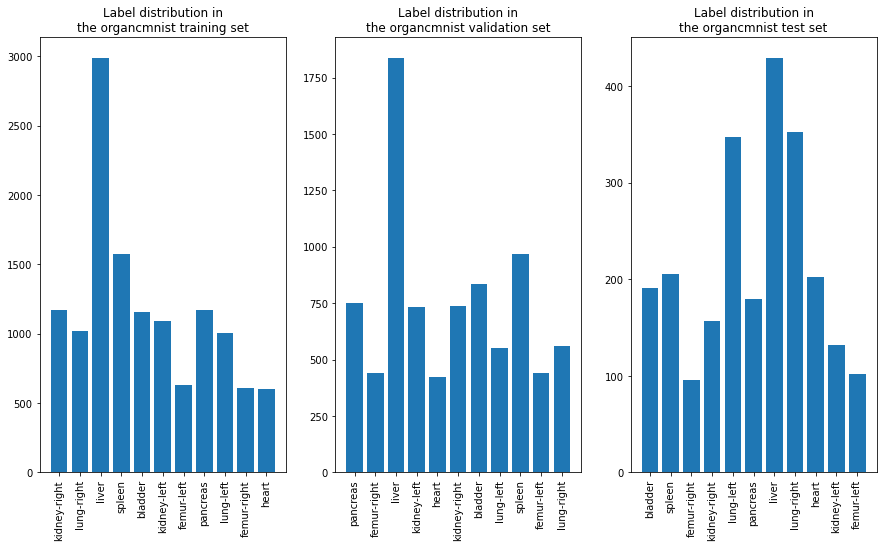

Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organcmnist.npz


In [10]:
organcmnist_noWRS_noGDA = import_dataset(
    "organcmnist", info_flags, print_visualization=True
)
organcmnist_noGDA = import_dataset(
    "organcmnist", info_flags, sampler=True
)
organcmnist_noWSR_GDA = import_dataset(
    "organcmnist", info_flags, geometric_augment=2
)
organcmnist_WSR_GDA = import_dataset(
    "organcmnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
organcmnist_noWRS_noGDA_upscaled = import_dataset(
    "organcmnist", info_flags, sampler=True, upscale=True
)

Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Montage of randomly extracted images from the dataset:


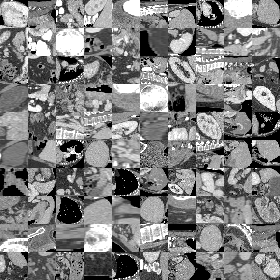

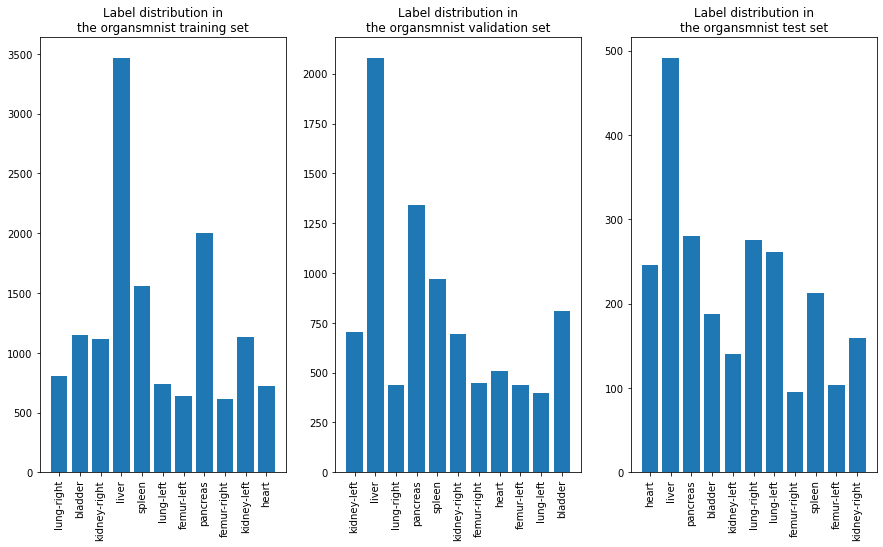

Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz
Using downloaded and verified file: /home/quentin/.medmnist/organsmnist.npz


In [11]:
organsmnist_noWRS_noGDA = import_dataset(
    "organsmnist", info_flags, print_visualization=True
)
organsmnist_noGDA = import_dataset(
    "organsmnist", info_flags, sampler=True
)
organsmnist_noWSR_GDA = import_dataset(
    "organsmnist", info_flags, geometric_augment=2
)
organsmnist_WSR_GDA = import_dataset(
    "organsmnist", info_flags, sampler=True, geometric_augment=2
)
# To be used for the GAN training
organsmnist_noWRS_noGDA_upscaled = import_dataset(
    "organsmnist", info_flags, sampler=True, upscale=True
)

## 3. Training the MedMNIST baseline classifier on dataset without Deep Learning data augmentation

Relying on the MedMNIST baseline classifier available on their github and repurposed for this notebook, we will train it on three variants of the datasets as listed in the previous section:

- Without geometric data augmentation and without weighted random sampling (the data is simply shuffled)
- With weighted random sampling and without geometric data augmentation
- With both geometric data augmentation and weighted random sampling

### 3.1. Training on the MedMNIST datasets without GDA and WSR

In [12]:
# Declares the baseline setup to save the related model
DA_technique="_noWRS_noGDA"

#### PathMNIST

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 56.59it/s]


train -- accuracy: 0.6647
val -- accuracy: 0.7917,  AUC: 0.9753
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.33it/s]


train -- accuracy: 0.8253
val -- accuracy: 0.824,  AUC: 0.983
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.47it/s]


train -- accuracy: 0.8689
val -- accuracy: 0.8343,  AUC: 0.9863
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.94it/s]


train -- accuracy: 0.8917
val -- accuracy: 0.8401,  AUC: 0.987
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.96it/s]


train -- accuracy: 0.9052
val -- accuracy: 0.8723,  AUC: 0.9927
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.43it/s]


train -- accuracy: 0.9193
val -- accuracy: 0.9183,  AUC: 0.9951
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.60it/s]


train -- accuracy: 0.9254
val -- accuracy: 0.9139,  AUC: 0.9948
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:23<00:00, 58.91it/s]


train -- accuracy: 0.9324
val -- accuracy: 0.9042,  AUC: 0.9935
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.26it/s]


train -- accuracy: 0.9389
val -- accuracy: 0.9203,  AUC: 0.9958
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.09it/s]


train -- accuracy: 0.9429
val -- accuracy: 0.908,  AUC: 0.996
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.16it/s]


train -- accuracy: 0.9476
val -- accuracy: 0.9322,  AUC: 0.997
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:23<00:00, 58.84it/s]


train -- accuracy: 0.9506
val -- accuracy: 0.9282,  AUC: 0.9967
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:23<00:00, 58.75it/s]


train -- accuracy: 0.9546
val -- accuracy: 0.9215,  AUC: 0.9964
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.69it/s]


train -- accuracy: 0.9572
val -- accuracy: 0.9342,  AUC: 0.9969
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.00it/s]


train -- accuracy: 0.9582
val -- accuracy: 0.9402,  AUC: 0.9976
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.61it/s]


train -- accuracy: 0.9623
val -- accuracy: 0.9472,  AUC: 0.998
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.34it/s]


train -- accuracy: 0.9664
val -- accuracy: 0.9318,  AUC: 0.9969
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.94it/s]


train -- accuracy: 0.9655
val -- accuracy: 0.9454,  AUC: 0.9978
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.45it/s]


train -- accuracy: 0.9699
val -- accuracy: 0.947,  AUC: 0.9977
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.15it/s]


train -- accuracy: 0.9713
val -- accuracy: 0.9468,  AUC: 0.9977
test -- accuracy: 0.8436,  AUC: 0.9799


<Figure size 720x720 with 0 Axes>

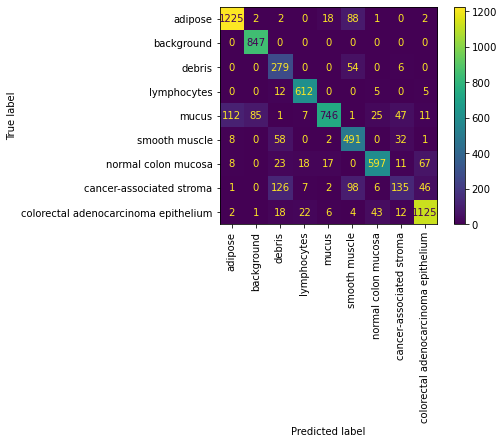

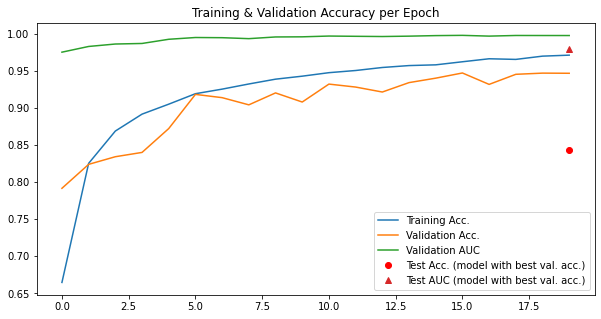

In [13]:
clf = run_classifier_pipeline(
    "pathmnist", info_flags, pathmnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### DermaMNIST

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 56.94it/s]


train -- accuracy: 0.3177
val -- accuracy: 0.4736,  AUC: 0.8269
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.73it/s]


train -- accuracy: 0.4367
val -- accuracy: 0.5005,  AUC: 0.8662
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 59.19it/s]


train -- accuracy: 0.5145
val -- accuracy: 0.5165,  AUC: 0.8709
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.89it/s]


train -- accuracy: 0.5612
val -- accuracy: 0.5733,  AUC: 0.8724
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.44it/s]


train -- accuracy: 0.6154
val -- accuracy: 0.5025,  AUC: 0.8885
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.37it/s]


train -- accuracy: 0.6738
val -- accuracy: 0.5174,  AUC: 0.869
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.95it/s]


train -- accuracy: 0.7326
val -- accuracy: 0.5344,  AUC: 0.8896
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.39it/s]


train -- accuracy: 0.7651
val -- accuracy: 0.675,  AUC: 0.9074
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 59.09it/s]


train -- accuracy: 0.7969
val -- accuracy: 0.5573,  AUC: 0.8939
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.43it/s]


train -- accuracy: 0.8342
val -- accuracy: 0.6461,  AUC: 0.8901
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.20it/s]


train -- accuracy: 0.8487
val -- accuracy: 0.6949,  AUC: 0.9092
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.39it/s]


train -- accuracy: 0.8747
val -- accuracy: 0.683,  AUC: 0.9031
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 59.85it/s]


train -- accuracy: 0.8867
val -- accuracy: 0.6441,  AUC: 0.8942
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 59.49it/s]


train -- accuracy: 0.9007
val -- accuracy: 0.6481,  AUC: 0.9041
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.36it/s]


train -- accuracy: 0.9111
val -- accuracy: 0.666,  AUC: 0.9025
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.89it/s]


train -- accuracy: 0.9259
val -- accuracy: 0.6112,  AUC: 0.8887
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.57it/s]


train -- accuracy: 0.9272
val -- accuracy: 0.679,  AUC: 0.9002
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.18it/s]


train -- accuracy: 0.9368
val -- accuracy: 0.6391,  AUC: 0.8995
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 56.69it/s]


train -- accuracy: 0.9453
val -- accuracy: 0.7069,  AUC: 0.9052
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.79it/s]


train -- accuracy: 0.9519
val -- accuracy: 0.6869,  AUC: 0.9044
test -- accuracy: 0.6594,  AUC: 0.8921


<Figure size 720x720 with 0 Axes>

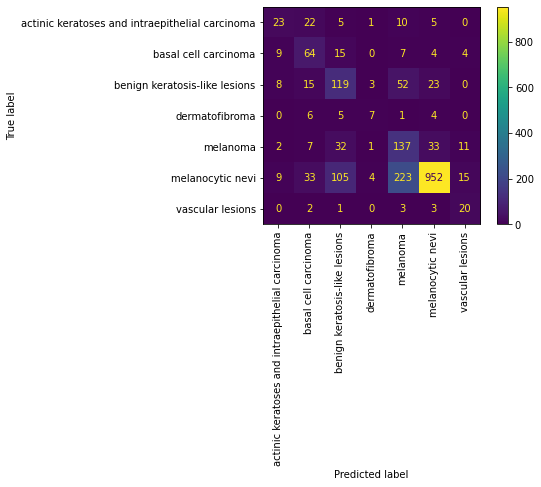

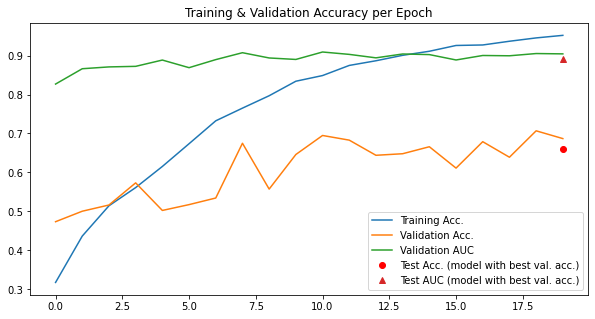

In [14]:
clf = run_classifier_pipeline(
    "dermamnist", info_flags, dermamnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### OctMNIST

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.96it/s]


train -- accuracy: 0.692
val -- accuracy: 0.7915,  AUC: 0.9472
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.67it/s]


train -- accuracy: 0.8099
val -- accuracy: 0.8781,  AUC: 0.9618
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.87it/s]


train -- accuracy: 0.8466
val -- accuracy: 0.7328,  AUC: 0.9637
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.15it/s]


train -- accuracy: 0.8707
val -- accuracy: 0.8783,  AUC: 0.9683
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.47it/s]


train -- accuracy: 0.8852
val -- accuracy: 0.8723,  AUC: 0.9621
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.60it/s]


train -- accuracy: 0.902
val -- accuracy: 0.8565,  AUC: 0.9692
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:23<00:00, 63.60it/s]


train -- accuracy: 0.9154
val -- accuracy: 0.8494,  AUC: 0.9673
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.37it/s]


train -- accuracy: 0.9252
val -- accuracy: 0.8389,  AUC: 0.9678
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.42it/s]


train -- accuracy: 0.935
val -- accuracy: 0.9031,  AUC: 0.9715
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.55it/s]


train -- accuracy: 0.9435
val -- accuracy: 0.8388,  AUC: 0.9673
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.76it/s]


train -- accuracy: 0.9472
val -- accuracy: 0.8881,  AUC: 0.9701
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.41it/s]


train -- accuracy: 0.9527
val -- accuracy: 0.9074,  AUC: 0.9716
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.48it/s]


train -- accuracy: 0.9543
val -- accuracy: 0.8996,  AUC: 0.97
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.73it/s]


train -- accuracy: 0.9626
val -- accuracy: 0.866,  AUC: 0.966
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.01it/s]


train -- accuracy: 0.968
val -- accuracy: 0.9136,  AUC: 0.9742
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.34it/s]


train -- accuracy: 0.9695
val -- accuracy: 0.9133,  AUC: 0.9721
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.51it/s]


train -- accuracy: 0.9722
val -- accuracy: 0.8219,  AUC: 0.963
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.93it/s]


train -- accuracy: 0.9672
val -- accuracy: 0.9093,  AUC: 0.974
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.82it/s]


train -- accuracy: 0.976
val -- accuracy: 0.9042,  AUC: 0.9727
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.63it/s]


train -- accuracy: 0.9771
val -- accuracy: 0.9141,  AUC: 0.9733
test -- accuracy: 0.704,  AUC: 0.934


<Figure size 720x720 with 0 Axes>

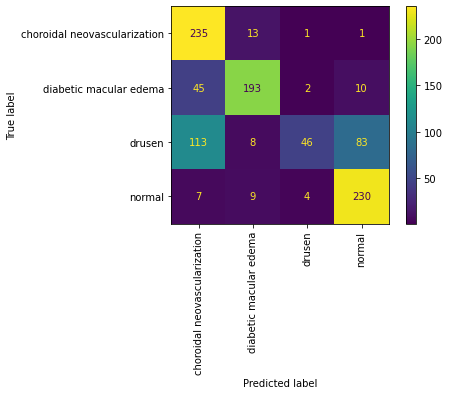

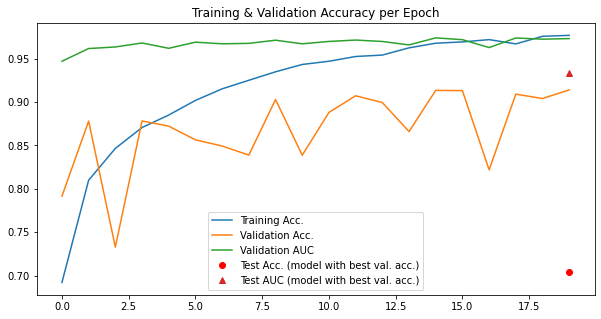

In [15]:
clf = run_classifier_pipeline(
    "octmnist", info_flags, octmnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### PneumoniaMNIST

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 65.17it/s]


train -- accuracy: 0.8218
val -- accuracy: 0.9122,  AUC: 0.9628
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.97it/s]


train -- accuracy: 0.9427
val -- accuracy: 0.9351,  AUC: 0.9853
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.69it/s]


train -- accuracy: 0.9573
val -- accuracy: 0.9561,  AUC: 0.9925
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.32it/s]


train -- accuracy: 0.9611
val -- accuracy: 0.9618,  AUC: 0.9947
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 62.39it/s]


train -- accuracy: 0.9754
val -- accuracy: 0.9637,  AUC: 0.9957
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 63.73it/s]


train -- accuracy: 0.9773
val -- accuracy: 0.9695,  AUC: 0.9965
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 63.71it/s]


train -- accuracy: 0.9834
val -- accuracy: 0.9656,  AUC: 0.9958
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 61.16it/s]


train -- accuracy: 0.9887
val -- accuracy: 0.9695,  AUC: 0.9968
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 63.31it/s]


train -- accuracy: 0.9896
val -- accuracy: 0.9656,  AUC: 0.9961
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 61.67it/s]


train -- accuracy: 0.9943
val -- accuracy: 0.9695,  AUC: 0.9972
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 63.99it/s]


train -- accuracy: 0.9964
val -- accuracy: 0.9714,  AUC: 0.9967
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 61.15it/s]


train -- accuracy: 0.9972
val -- accuracy: 0.9695,  AUC: 0.9964
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 63.44it/s]


train -- accuracy: 0.9983
val -- accuracy: 0.9714,  AUC: 0.9973
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 61.83it/s]


train -- accuracy: 0.9966
val -- accuracy: 0.9676,  AUC: 0.9962
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 62.76it/s]


train -- accuracy: 0.9992
val -- accuracy: 0.9676,  AUC: 0.9976
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 63.54it/s]


train -- accuracy: 0.9992
val -- accuracy: 0.9714,  AUC: 0.9976
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 65.06it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9733,  AUC: 0.9978
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 65.06it/s]


train -- accuracy: 0.9994
val -- accuracy: 0.9695,  AUC: 0.9973
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 62.64it/s]


train -- accuracy: 0.9994
val -- accuracy: 0.9695,  AUC: 0.9974
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.85it/s]


train -- accuracy: 1.0
val -- accuracy: 0.9733,  AUC: 0.9974
test -- accuracy: 0.8558,  AUC: 0.958


<Figure size 720x720 with 0 Axes>

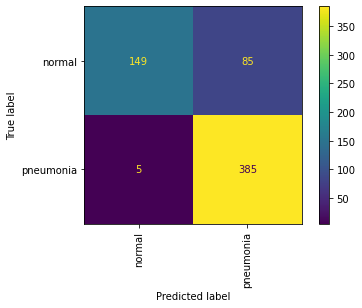

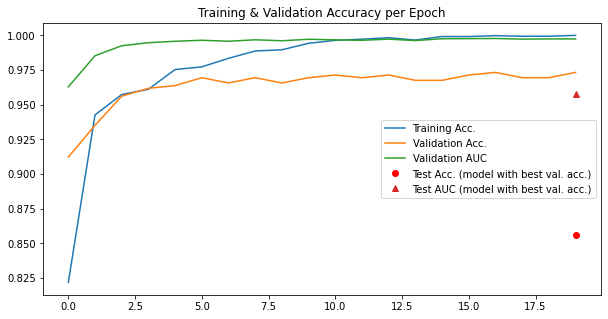

In [16]:
clf = run_classifier_pipeline(
    "pneumoniamnist", info_flags, pneumoniamnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### BreastMNIST

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 62.07it/s]


train -- accuracy: 0.5568
val -- accuracy: 0.2692,  AUC: 0.3241
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 66.25it/s]


train -- accuracy: 0.6337
val -- accuracy: 0.5641,  AUC: 0.5965
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 41.72it/s]


train -- accuracy: 0.6978
val -- accuracy: 0.4487,  AUC: 0.7561
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 63.80it/s]


train -- accuracy: 0.674
val -- accuracy: 0.5385,  AUC: 0.7753
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 64.29it/s]


train -- accuracy: 0.7033
val -- accuracy: 0.7051,  AUC: 0.7878
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 67.54it/s]


train -- accuracy: 0.7454
val -- accuracy: 0.7179,  AUC: 0.8028
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 65.06it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7179,  AUC: 0.8012
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 65.86it/s]


train -- accuracy: 0.7601
val -- accuracy: 0.7436,  AUC: 0.8087
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 64.35it/s]


train -- accuracy: 0.7875
val -- accuracy: 0.7436,  AUC: 0.812
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 66.09it/s]


train -- accuracy: 0.7912
val -- accuracy: 0.7436,  AUC: 0.8279
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 65.10it/s]


train -- accuracy: 0.8242
val -- accuracy: 0.7436,  AUC: 0.8329
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 64.69it/s]


train -- accuracy: 0.8004
val -- accuracy: 0.7436,  AUC: 0.848
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 61.57it/s]


train -- accuracy: 0.8425
val -- accuracy: 0.7436,  AUC: 0.8513
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 59.74it/s]


train -- accuracy: 0.8297
val -- accuracy: 0.7564,  AUC: 0.8672
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 67.32it/s]


train -- accuracy: 0.8535
val -- accuracy: 0.7436,  AUC: 0.8663
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 62.71it/s]


train -- accuracy: 0.8919
val -- accuracy: 0.7564,  AUC: 0.873
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 64.17it/s]


train -- accuracy: 0.9103
val -- accuracy: 0.7436,  AUC: 0.8722
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 67.70it/s]


train -- accuracy: 0.9139
val -- accuracy: 0.8077,  AUC: 0.8939
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 65.24it/s]


train -- accuracy: 0.9231
val -- accuracy: 0.7564,  AUC: 0.8822
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 64.10it/s]


train -- accuracy: 0.9322
val -- accuracy: 0.8077,  AUC: 0.9006
test -- accuracy: 0.8269,  AUC: 0.8835


<Figure size 720x720 with 0 Axes>

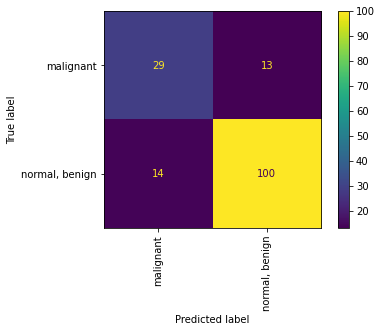

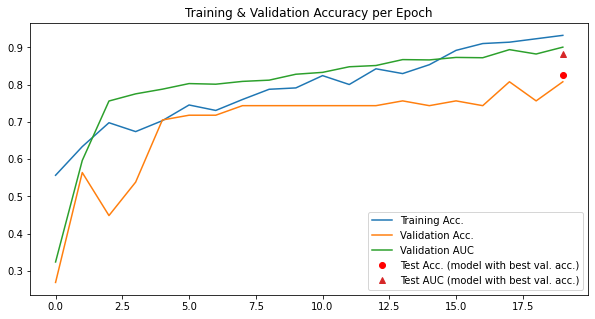

In [17]:
clf= run_classifier_pipeline(
    "breastmnist", info_flags, breastmnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### OrganAMNIST

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.80it/s]


train -- accuracy: 0.5816
val -- accuracy: 0.8906,  AUC: 0.9946
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.14it/s]


train -- accuracy: 0.8689
val -- accuracy: 0.9532,  AUC: 0.9986
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.47it/s]


train -- accuracy: 0.931
val -- accuracy: 0.9533,  AUC: 0.9986
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.85it/s]


train -- accuracy: 0.9543
val -- accuracy: 0.961,  AUC: 0.999
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.71it/s]


train -- accuracy: 0.9716
val -- accuracy: 0.9584,  AUC: 0.9993
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.06it/s]


train -- accuracy: 0.9785
val -- accuracy: 0.9621,  AUC: 0.9993
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.79it/s]


train -- accuracy: 0.9826
val -- accuracy: 0.9678,  AUC: 0.9993
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.85it/s]


train -- accuracy: 0.9873
val -- accuracy: 0.9616,  AUC: 0.9992
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.21it/s]


train -- accuracy: 0.9889
val -- accuracy: 0.9632,  AUC: 0.9991
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.94it/s]


train -- accuracy: 0.9905
val -- accuracy: 0.9663,  AUC: 0.9993
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.51it/s]


train -- accuracy: 0.9926
val -- accuracy: 0.969,  AUC: 0.9993
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.21it/s]


train -- accuracy: 0.9944
val -- accuracy: 0.9661,  AUC: 0.9995
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.84it/s]


train -- accuracy: 0.9952
val -- accuracy: 0.9701,  AUC: 0.9994
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.98it/s]


train -- accuracy: 0.9947
val -- accuracy: 0.9718,  AUC: 0.9994
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.98it/s]


train -- accuracy: 0.9975
val -- accuracy: 0.9698,  AUC: 0.9992
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.88it/s]


train -- accuracy: 0.9973
val -- accuracy: 0.9695,  AUC: 0.9994
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 64.11it/s]


train -- accuracy: 0.9975
val -- accuracy: 0.9641,  AUC: 0.9993
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 61.92it/s]


train -- accuracy: 0.9977
val -- accuracy: 0.9697,  AUC: 0.9994
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.35it/s]


train -- accuracy: 0.998
val -- accuracy: 0.97,  AUC: 0.9994
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.35it/s]


train -- accuracy: 0.9981
val -- accuracy: 0.9726,  AUC: 0.9994
test -- accuracy: 0.881,  AUC: 0.9912


<Figure size 720x720 with 0 Axes>

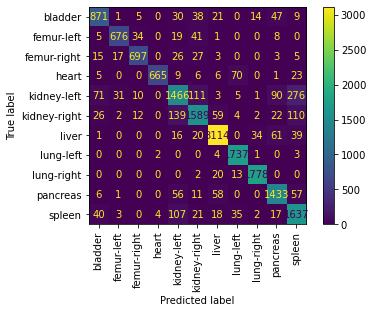

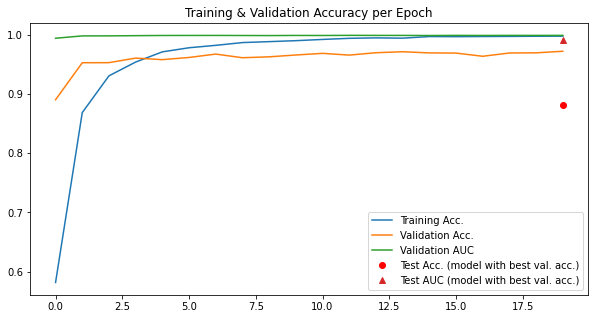

In [18]:
clf = run_classifier_pipeline(
    "organamnist", info_flags, organamnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### OrganCMNIST

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.93it/s]


train -- accuracy: 0.403
val -- accuracy: 0.7266,  AUC: 0.9543
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 61.71it/s]


train -- accuracy: 0.6825
val -- accuracy: 0.8516,  AUC: 0.9895
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.19it/s]


train -- accuracy: 0.7987
val -- accuracy: 0.9034,  AUC: 0.995
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.20it/s]


train -- accuracy: 0.8572
val -- accuracy: 0.9093,  AUC: 0.9955
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.00it/s]


train -- accuracy: 0.8854
val -- accuracy: 0.9239,  AUC: 0.9971
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.78it/s]


train -- accuracy: 0.8981
val -- accuracy: 0.9423,  AUC: 0.9977
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.14it/s]


train -- accuracy: 0.9194
val -- accuracy: 0.9314,  AUC: 0.9974
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.69it/s]


train -- accuracy: 0.9258
val -- accuracy: 0.9348,  AUC: 0.9982
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.79it/s]


train -- accuracy: 0.9382
val -- accuracy: 0.9356,  AUC: 0.9978
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.49it/s]


train -- accuracy: 0.9487
val -- accuracy: 0.9486,  AUC: 0.998
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.08it/s]


train -- accuracy: 0.9575
val -- accuracy: 0.9415,  AUC: 0.9982
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.24it/s]


train -- accuracy: 0.9596
val -- accuracy: 0.9419,  AUC: 0.998
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.59it/s]


train -- accuracy: 0.9657
val -- accuracy: 0.9402,  AUC: 0.9974
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.24it/s]


train -- accuracy: 0.9635
val -- accuracy: 0.9473,  AUC: 0.998
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 62.73it/s]


train -- accuracy: 0.9715
val -- accuracy: 0.9406,  AUC: 0.9978
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.13it/s]


train -- accuracy: 0.9748
val -- accuracy: 0.9519,  AUC: 0.9984
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 62.85it/s]


train -- accuracy: 0.9774
val -- accuracy: 0.9515,  AUC: 0.9984
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.56it/s]


train -- accuracy: 0.9822
val -- accuracy: 0.9582,  AUC: 0.9985
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.04it/s]


train -- accuracy: 0.9877
val -- accuracy: 0.9498,  AUC: 0.9982
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.23it/s]


train -- accuracy: 0.9884
val -- accuracy: 0.9532,  AUC: 0.9986
test -- accuracy: 0.8625,  AUC: 0.9872


<Figure size 720x720 with 0 Axes>

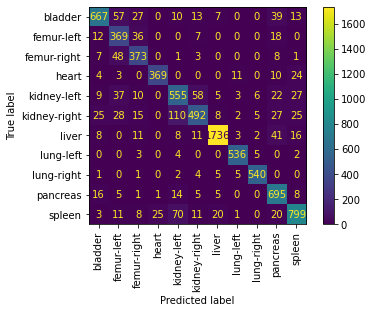

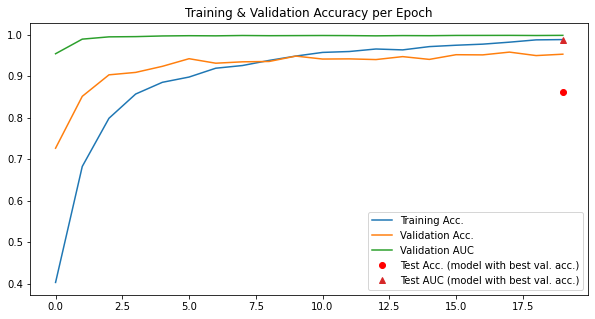

In [19]:
clf = run_classifier_pipeline(
    "organcmnist", info_flags, organcmnist_noWRS_noGDA,
    DA_technique=DA_technique
)

#### OrganSMNIST

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 62.52it/s]


train -- accuracy: 0.335
val -- accuracy: 0.5359,  AUC: 0.9312
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 61.95it/s]


train -- accuracy: 0.5295
val -- accuracy: 0.6203,  AUC: 0.955
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.91it/s]


train -- accuracy: 0.6371
val -- accuracy: 0.7557,  AUC: 0.9829
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.49it/s]


train -- accuracy: 0.6996
val -- accuracy: 0.7867,  AUC: 0.9864
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.02it/s]


train -- accuracy: 0.7374
val -- accuracy: 0.8242,  AUC: 0.9879
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.26it/s]


train -- accuracy: 0.7646
val -- accuracy: 0.821,  AUC: 0.9886
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.51it/s]


train -- accuracy: 0.7941
val -- accuracy: 0.8467,  AUC: 0.9891
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 62.10it/s]


train -- accuracy: 0.8122
val -- accuracy: 0.8467,  AUC: 0.9892
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 62.92it/s]


train -- accuracy: 0.8263
val -- accuracy: 0.8409,  AUC: 0.9892
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.09it/s]


train -- accuracy: 0.8491
val -- accuracy: 0.8377,  AUC: 0.9883
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.39it/s]


train -- accuracy: 0.8664
val -- accuracy: 0.8128,  AUC: 0.9879
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 62.74it/s]


train -- accuracy: 0.8783
val -- accuracy: 0.8063,  AUC: 0.988
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 62.81it/s]


train -- accuracy: 0.8902
val -- accuracy: 0.8316,  AUC: 0.9869
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.06it/s]


train -- accuracy: 0.9075
val -- accuracy: 0.823,  AUC: 0.9882
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.32it/s]


train -- accuracy: 0.9122
val -- accuracy: 0.8267,  AUC: 0.9885
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 61.63it/s]


train -- accuracy: 0.92
val -- accuracy: 0.8271,  AUC: 0.9892
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 61.37it/s]


train -- accuracy: 0.9349
val -- accuracy: 0.8471,  AUC: 0.9895
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 62.05it/s]


train -- accuracy: 0.9419
val -- accuracy: 0.8556,  AUC: 0.9895
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.17it/s]


train -- accuracy: 0.9481
val -- accuracy: 0.8348,  AUC: 0.9874
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 62.86it/s]


train -- accuracy: 0.9541
val -- accuracy: 0.8487,  AUC: 0.9893
test -- accuracy: 0.7192,  AUC: 0.9646


<Figure size 720x720 with 0 Axes>

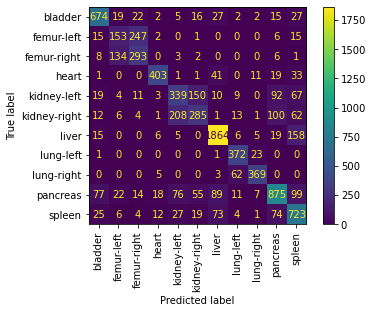

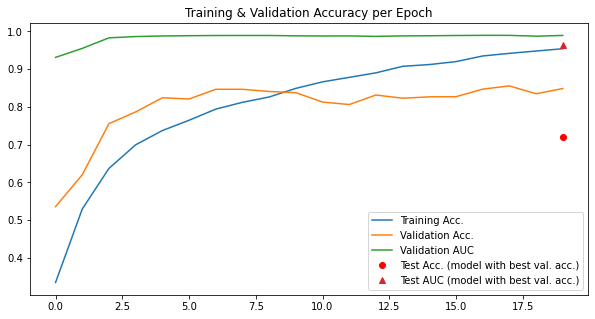

In [20]:
clf = run_classifier_pipeline(
    "organsmnist", info_flags, organsmnist_noWRS_noGDA,
    DA_technique=DA_technique
)

### 3.2. Training on the MedMNIST datasets with WSR and without GDA

In [21]:
# Declares the baseline setup to save the related model
DA_technique="_noGDA"

#### PathMNIST

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.69it/s]


train -- accuracy: 0.6606
val -- accuracy: 0.7762,  AUC: 0.9733
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.99it/s]


train -- accuracy: 0.8346
val -- accuracy: 0.8413,  AUC: 0.986
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.72it/s]


train -- accuracy: 0.875
val -- accuracy: 0.8747,  AUC: 0.9917
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.82it/s]


train -- accuracy: 0.8947
val -- accuracy: 0.8757,  AUC: 0.9909
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.52it/s]


train -- accuracy: 0.9117
val -- accuracy: 0.9181,  AUC: 0.995
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.18it/s]


train -- accuracy: 0.9195
val -- accuracy: 0.9065,  AUC: 0.994
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.95it/s]


train -- accuracy: 0.9295
val -- accuracy: 0.898,  AUC: 0.995
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.34it/s]


train -- accuracy: 0.9351
val -- accuracy: 0.9262,  AUC: 0.9963
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.03it/s]


train -- accuracy: 0.9405
val -- accuracy: 0.936,  AUC: 0.9968
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.10it/s]


train -- accuracy: 0.9452
val -- accuracy: 0.9314,  AUC: 0.9964
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.50it/s]


train -- accuracy: 0.9473
val -- accuracy: 0.9367,  AUC: 0.9969
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.22it/s]


train -- accuracy: 0.9504
val -- accuracy: 0.9274,  AUC: 0.9967
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 58.21it/s]


train -- accuracy: 0.9572
val -- accuracy: 0.9267,  AUC: 0.9963
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.47it/s]


train -- accuracy: 0.9584
val -- accuracy: 0.9188,  AUC: 0.9958
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.06it/s]


train -- accuracy: 0.9568
val -- accuracy: 0.9364,  AUC: 0.9969
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.20it/s]


train -- accuracy: 0.9629
val -- accuracy: 0.9409,  AUC: 0.9973
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.52it/s]


train -- accuracy: 0.9654
val -- accuracy: 0.9423,  AUC: 0.9972
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.70it/s]


train -- accuracy: 0.9675
val -- accuracy: 0.9486,  AUC: 0.9977
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.67it/s]


train -- accuracy: 0.9697
val -- accuracy: 0.9428,  AUC: 0.997
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [00:24<00:00, 57.45it/s]


train -- accuracy: 0.9715
val -- accuracy: 0.9269,  AUC: 0.9969
test -- accuracy: 0.7993,  AUC: 0.9667


<Figure size 720x720 with 0 Axes>

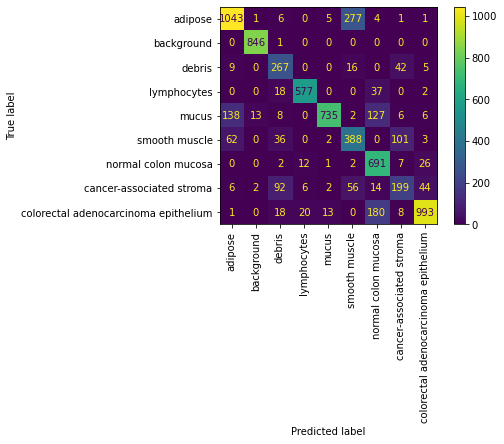

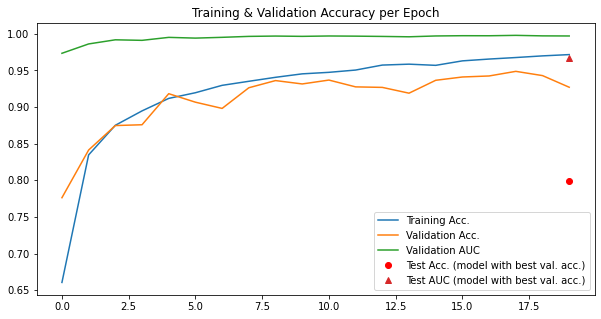

In [22]:
clf = run_classifier_pipeline(
    "pathmnist", info_flags, pathmnist_noGDA,
    DA_technique=DA_technique
)

#### DermaMNIST

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 59.04it/s]


train -- accuracy: 0.3114
val -- accuracy: 0.4407,  AUC: 0.8019
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.57it/s]


train -- accuracy: 0.4737
val -- accuracy: 0.4975,  AUC: 0.8571
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 59.50it/s]


train -- accuracy: 0.5143
val -- accuracy: 0.5025,  AUC: 0.8725
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.06it/s]


train -- accuracy: 0.5764
val -- accuracy: 0.5204,  AUC: 0.8839
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.84it/s]


train -- accuracy: 0.6429
val -- accuracy: 0.5045,  AUC: 0.8762
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.59it/s]


train -- accuracy: 0.6787
val -- accuracy: 0.5693,  AUC: 0.8841
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.45it/s]


train -- accuracy: 0.7445
val -- accuracy: 0.5753,  AUC: 0.8892
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.85it/s]


train -- accuracy: 0.7828
val -- accuracy: 0.65,  AUC: 0.89
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.22it/s]


train -- accuracy: 0.8065
val -- accuracy: 0.6002,  AUC: 0.8914
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 59.48it/s]


train -- accuracy: 0.8333
val -- accuracy: 0.6042,  AUC: 0.896
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 60.26it/s]


train -- accuracy: 0.8536
val -- accuracy: 0.67,  AUC: 0.9011
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.45it/s]


train -- accuracy: 0.885
val -- accuracy: 0.5693,  AUC: 0.8801
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 59.67it/s]


train -- accuracy: 0.8981
val -- accuracy: 0.6102,  AUC: 0.8952
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.19it/s]


train -- accuracy: 0.9031
val -- accuracy: 0.663,  AUC: 0.8827
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.42it/s]


train -- accuracy: 0.9184
val -- accuracy: 0.673,  AUC: 0.8964
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 56.73it/s]


train -- accuracy: 0.9298
val -- accuracy: 0.6082,  AUC: 0.8751
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.54it/s]


train -- accuracy: 0.9341
val -- accuracy: 0.65,  AUC: 0.8758
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 57.55it/s]


train -- accuracy: 0.9395
val -- accuracy: 0.675,  AUC: 0.8906
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.11it/s]


train -- accuracy: 0.9475
val -- accuracy: 0.6979,  AUC: 0.882
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:01<00:00, 58.12it/s]


train -- accuracy: 0.9536
val -- accuracy: 0.7079,  AUC: 0.8877
test -- accuracy: 0.6943,  AUC: 0.8962


<Figure size 720x720 with 0 Axes>

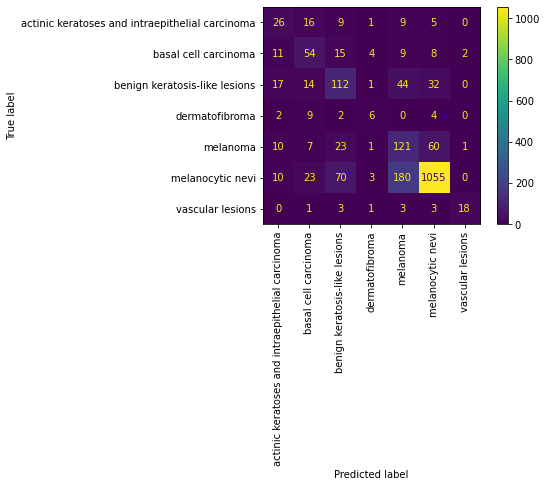

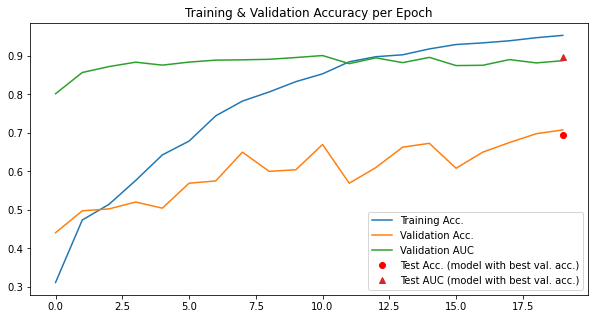

In [23]:
clf = run_classifier_pipeline(
    "dermamnist", info_flags, dermamnist_noGDA,
    DA_technique=DA_technique
)

#### OctMNIST

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.41it/s]


train -- accuracy: 0.683
val -- accuracy: 0.5712,  AUC: 0.9276
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.54it/s]


train -- accuracy: 0.8093
val -- accuracy: 0.7855,  AUC: 0.9588
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.19it/s]


train -- accuracy: 0.8424
val -- accuracy: 0.8262,  AUC: 0.9626
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.25it/s]


train -- accuracy: 0.8672
val -- accuracy: 0.8224,  AUC: 0.9462
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.42it/s]


train -- accuracy: 0.8856
val -- accuracy: 0.8299,  AUC: 0.9618
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.47it/s]


train -- accuracy: 0.8996
val -- accuracy: 0.8505,  AUC: 0.9663
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 61.82it/s]


train -- accuracy: 0.9107
val -- accuracy: 0.878,  AUC: 0.9661
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.02it/s]


train -- accuracy: 0.923
val -- accuracy: 0.856,  AUC: 0.9674
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.85it/s]


train -- accuracy: 0.9329
val -- accuracy: 0.8632,  AUC: 0.9629
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.31it/s]


train -- accuracy: 0.9428
val -- accuracy: 0.8775,  AUC: 0.9675
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.03it/s]


train -- accuracy: 0.9494
val -- accuracy: 0.8945,  AUC: 0.9666
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.41it/s]


train -- accuracy: 0.9531
val -- accuracy: 0.8563,  AUC: 0.9669
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 62.65it/s]


train -- accuracy: 0.9578
val -- accuracy: 0.9021,  AUC: 0.9696
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:23<00:00, 63.65it/s]


train -- accuracy: 0.9606
val -- accuracy: 0.8872,  AUC: 0.9603
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.39it/s]


train -- accuracy: 0.959
val -- accuracy: 0.9,  AUC: 0.971
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:24<00:00, 63.19it/s]


train -- accuracy: 0.9685
val -- accuracy: 0.8508,  AUC: 0.9642
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:23<00:00, 63.58it/s]


train -- accuracy: 0.9694
val -- accuracy: 0.8911,  AUC: 0.9702
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:23<00:00, 63.93it/s]


train -- accuracy: 0.9729
val -- accuracy: 0.8932,  AUC: 0.9676
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:23<00:00, 64.43it/s]


train -- accuracy: 0.9757
val -- accuracy: 0.9093,  AUC: 0.9718
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:23<00:00, 64.93it/s]


train -- accuracy: 0.9766
val -- accuracy: 0.9034,  AUC: 0.969
test -- accuracy: 0.766,  AUC: 0.9429


<Figure size 720x720 with 0 Axes>

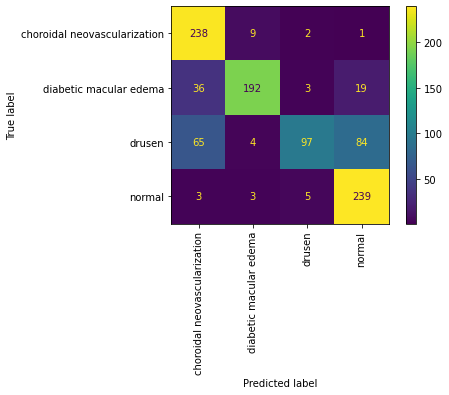

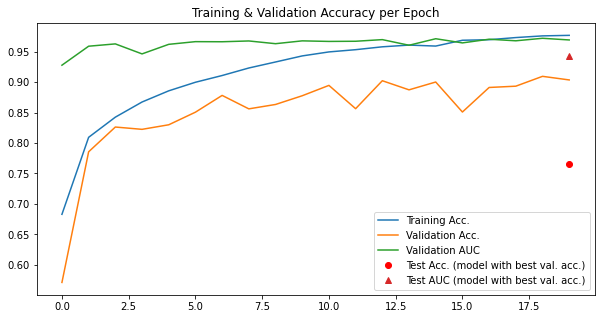

In [24]:
clf = run_classifier_pipeline(
    "octmnist", info_flags, octmnist_noGDA,
    DA_technique=DA_technique
)

#### PneumoniaMNIST

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 65.13it/s]


train -- accuracy: 0.761
val -- accuracy: 0.9122,  AUC: 0.9715
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 62.94it/s]


train -- accuracy: 0.9427
val -- accuracy: 0.9485,  AUC: 0.9891
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 63.36it/s]


train -- accuracy: 0.9565
val -- accuracy: 0.9485,  AUC: 0.9918
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.45it/s]


train -- accuracy: 0.969
val -- accuracy: 0.9695,  AUC: 0.9961
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.41it/s]


train -- accuracy: 0.976
val -- accuracy: 0.9714,  AUC: 0.9969
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 65.10it/s]


train -- accuracy: 0.9785
val -- accuracy: 0.9656,  AUC: 0.9967
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.04it/s]


train -- accuracy: 0.9839
val -- accuracy: 0.9771,  AUC: 0.9969
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 59.39it/s]


train -- accuracy: 0.989
val -- accuracy: 0.9695,  AUC: 0.9978
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.18it/s]


train -- accuracy: 0.993
val -- accuracy: 0.9714,  AUC: 0.9974
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.95it/s]


train -- accuracy: 0.9955
val -- accuracy: 0.979,  AUC: 0.9975
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 63.48it/s]


train -- accuracy: 0.9921
val -- accuracy: 0.9637,  AUC: 0.9968
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.98it/s]


train -- accuracy: 0.996
val -- accuracy: 0.9656,  AUC: 0.9973
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.70it/s]


train -- accuracy: 0.9983
val -- accuracy: 0.9752,  AUC: 0.998
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.06it/s]


train -- accuracy: 0.9996
val -- accuracy: 0.9847,  AUC: 0.9983
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 62.53it/s]


train -- accuracy: 0.9992
val -- accuracy: 0.9809,  AUC: 0.9981
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 63.99it/s]


train -- accuracy: 1.0
val -- accuracy: 0.9828,  AUC: 0.998
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.01it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9828,  AUC: 0.9981
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.77it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9847,  AUC: 0.998
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 64.55it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9828,  AUC: 0.9979
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:01<00:00, 63.76it/s]


train -- accuracy: 1.0
val -- accuracy: 0.9752,  AUC: 0.9979
test -- accuracy: 0.8798,  AUC: 0.9607


<Figure size 720x720 with 0 Axes>

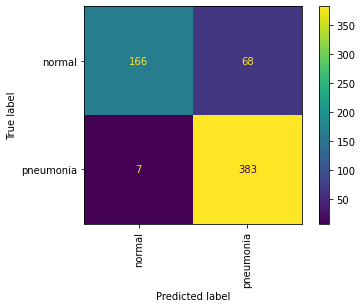

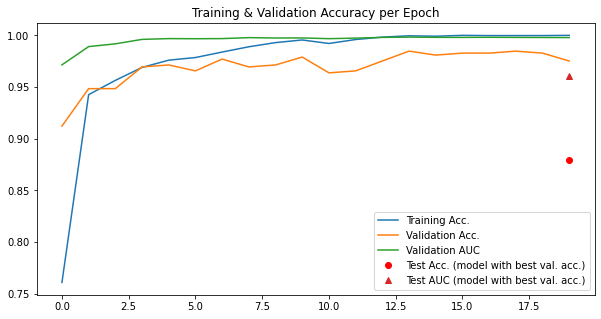

In [25]:
clf = run_classifier_pipeline(
    "pneumoniamnist", info_flags, pneumoniamnist_noGDA,
    DA_technique=DA_technique
)

#### BreastMNIST

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 67.24it/s]


train -- accuracy: 0.5183
val -- accuracy: 0.2692,  AUC: 0.6165
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 67.12it/s]


train -- accuracy: 0.5531
val -- accuracy: 0.2692,  AUC: 0.6533
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 66.72it/s]


train -- accuracy: 0.6575
val -- accuracy: 0.2949,  AUC: 0.7135
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 64.71it/s]


train -- accuracy: 0.7143
val -- accuracy: 0.6154,  AUC: 0.7527
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 67.22it/s]


train -- accuracy: 0.7198
val -- accuracy: 0.6923,  AUC: 0.7786
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 62.05it/s]


train -- accuracy: 0.7344
val -- accuracy: 0.6923,  AUC: 0.7886
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 63.14it/s]


train -- accuracy: 0.7546
val -- accuracy: 0.7051,  AUC: 0.7962
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 65.90it/s]


train -- accuracy: 0.7491
val -- accuracy: 0.7308,  AUC: 0.8137
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 65.78it/s]


train -- accuracy: 0.7711
val -- accuracy: 0.7564,  AUC: 0.8279
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 66.53it/s]


train -- accuracy: 0.7802
val -- accuracy: 0.7692,  AUC: 0.8212
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 66.95it/s]


train -- accuracy: 0.7674
val -- accuracy: 0.7564,  AUC: 0.8371
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 65.45it/s]


train -- accuracy: 0.8004
val -- accuracy: 0.7821,  AUC: 0.8521
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 67.64it/s]


train -- accuracy: 0.8223
val -- accuracy: 0.7821,  AUC: 0.8513
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 66.61it/s]


train -- accuracy: 0.8553
val -- accuracy: 0.7949,  AUC: 0.8596
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 66.69it/s]


train -- accuracy: 0.8626
val -- accuracy: 0.7949,  AUC: 0.8789
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 66.66it/s]


train -- accuracy: 0.8571
val -- accuracy: 0.7949,  AUC: 0.8947
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 67.04it/s]


train -- accuracy: 0.8846
val -- accuracy: 0.8462,  AUC: 0.8872
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 64.77it/s]


train -- accuracy: 0.8883
val -- accuracy: 0.7179,  AUC: 0.9081
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 66.54it/s]


train -- accuracy: 0.9139
val -- accuracy: 0.8462,  AUC: 0.8931
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 63.92it/s]


train -- accuracy: 0.9322
val -- accuracy: 0.859,  AUC: 0.9256
test -- accuracy: 0.8462,  AUC: 0.8645


<Figure size 720x720 with 0 Axes>

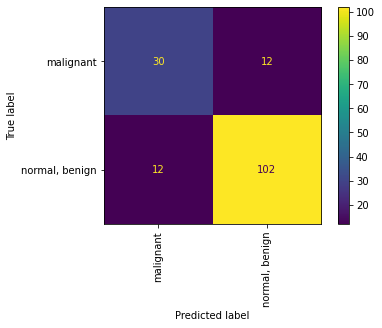

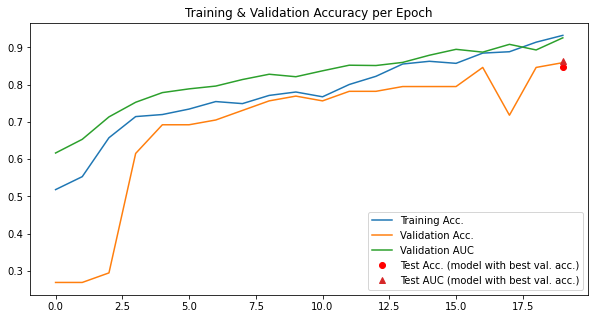

In [26]:
clf = run_classifier_pipeline(
    "breastmnist", info_flags, breastmnist_noGDA,
    DA_technique=DA_technique
)

#### OrganAMNIST

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.85it/s]


train -- accuracy: 0.5842
val -- accuracy: 0.8877,  AUC: 0.9929
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.88it/s]


train -- accuracy: 0.8662
val -- accuracy: 0.933,  AUC: 0.9978
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.36it/s]


train -- accuracy: 0.9325
val -- accuracy: 0.9578,  AUC: 0.9987
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.42it/s]


train -- accuracy: 0.9531
val -- accuracy: 0.9586,  AUC: 0.9991
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 64.66it/s]


train -- accuracy: 0.9681
val -- accuracy: 0.9578,  AUC: 0.9991
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 64.13it/s]


train -- accuracy: 0.9753
val -- accuracy: 0.9613,  AUC: 0.9993
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.18it/s]


train -- accuracy: 0.982
val -- accuracy: 0.9633,  AUC: 0.9995
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.26it/s]


train -- accuracy: 0.9876
val -- accuracy: 0.9658,  AUC: 0.9995
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.30it/s]


train -- accuracy: 0.9896
val -- accuracy: 0.9681,  AUC: 0.9996
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.76it/s]


train -- accuracy: 0.9912
val -- accuracy: 0.9684,  AUC: 0.9995
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.63it/s]


train -- accuracy: 0.9924
val -- accuracy: 0.9695,  AUC: 0.9995
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.46it/s]


train -- accuracy: 0.9942
val -- accuracy: 0.971,  AUC: 0.9997
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.57it/s]


train -- accuracy: 0.995
val -- accuracy: 0.9701,  AUC: 0.9997
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.08it/s]


train -- accuracy: 0.9955
val -- accuracy: 0.9695,  AUC: 0.9996
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.24it/s]


train -- accuracy: 0.9966
val -- accuracy: 0.9663,  AUC: 0.9996
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.22it/s]


train -- accuracy: 0.9968
val -- accuracy: 0.9698,  AUC: 0.9997
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 61.93it/s]


train -- accuracy: 0.9975
val -- accuracy: 0.9684,  AUC: 0.9997
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.50it/s]


train -- accuracy: 0.9967
val -- accuracy: 0.9653,  AUC: 0.9995
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 63.23it/s]


train -- accuracy: 0.998
val -- accuracy: 0.972,  AUC: 0.9997
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:08<00:00, 62.28it/s]


train -- accuracy: 0.9981
val -- accuracy: 0.9712,  AUC: 0.9997
test -- accuracy: 0.8849,  AUC: 0.9914


<Figure size 720x720 with 0 Axes>

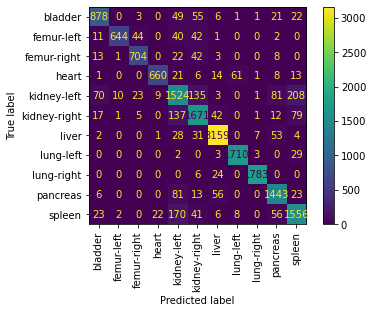

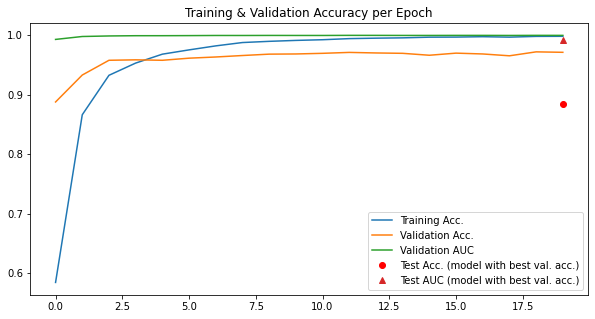

In [27]:
clf = run_classifier_pipeline(
    "organamnist", info_flags, organamnist_noGDA,
    DA_technique=DA_technique
)

#### OrganCMNIST

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.03it/s]


train -- accuracy: 0.4055
val -- accuracy: 0.6798,  AUC: 0.9614
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.29it/s]


train -- accuracy: 0.6657
val -- accuracy: 0.8441,  AUC: 0.9899
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.16it/s]


train -- accuracy: 0.7985
val -- accuracy: 0.9202,  AUC: 0.9963
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.83it/s]


train -- accuracy: 0.8538
val -- accuracy: 0.9206,  AUC: 0.9963
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.48it/s]


train -- accuracy: 0.8855
val -- accuracy: 0.9419,  AUC: 0.9973
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.25it/s]


train -- accuracy: 0.898
val -- accuracy: 0.9419,  AUC: 0.9977
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 61.55it/s]


train -- accuracy: 0.9173
val -- accuracy: 0.9473,  AUC: 0.9979
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.32it/s]


train -- accuracy: 0.9328
val -- accuracy: 0.9352,  AUC: 0.9977
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.37it/s]


train -- accuracy: 0.9386
val -- accuracy: 0.9511,  AUC: 0.9984
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.79it/s]


train -- accuracy: 0.9457
val -- accuracy: 0.9528,  AUC: 0.9984
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.77it/s]


train -- accuracy: 0.9605
val -- accuracy: 0.9532,  AUC: 0.9985
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.70it/s]


train -- accuracy: 0.9555
val -- accuracy: 0.954,  AUC: 0.9984
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 62.29it/s]


train -- accuracy: 0.9638
val -- accuracy: 0.9465,  AUC: 0.9983
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.99it/s]


train -- accuracy: 0.9709
val -- accuracy: 0.9561,  AUC: 0.9986
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.07it/s]


train -- accuracy: 0.9725
val -- accuracy: 0.9624,  AUC: 0.9987
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 62.97it/s]


train -- accuracy: 0.9771
val -- accuracy: 0.9594,  AUC: 0.9986
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 63.87it/s]


train -- accuracy: 0.9814
val -- accuracy: 0.9553,  AUC: 0.9986
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 61.70it/s]


train -- accuracy: 0.9835
val -- accuracy: 0.962,  AUC: 0.9989
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 61.83it/s]


train -- accuracy: 0.9857
val -- accuracy: 0.9553,  AUC: 0.9985
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:03<00:00, 64.92it/s]


train -- accuracy: 0.9889
val -- accuracy: 0.9586,  AUC: 0.9987
test -- accuracy: 0.8632,  AUC: 0.9874


<Figure size 720x720 with 0 Axes>

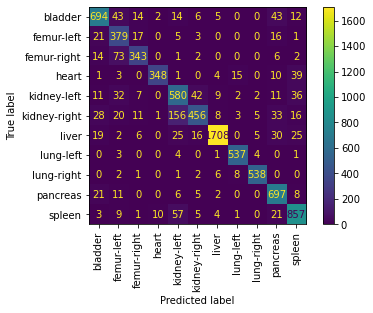

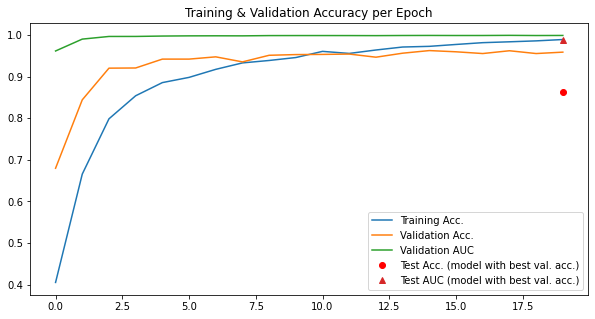

In [28]:
clf = run_classifier_pipeline(
    "organcmnist", info_flags, organcmnist_noGDA,
    DA_technique=DA_technique
)

#### OrganSMNIST

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.13it/s]


train -- accuracy: 0.2851
val -- accuracy: 0.5918,  AUC: 0.925
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.62it/s]


train -- accuracy: 0.5168
val -- accuracy: 0.6264,  AUC: 0.9592
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.02it/s]


train -- accuracy: 0.6259
val -- accuracy: 0.7749,  AUC: 0.9802
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.14it/s]


train -- accuracy: 0.6887
val -- accuracy: 0.8181,  AUC: 0.9859
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 65.01it/s]


train -- accuracy: 0.7302
val -- accuracy: 0.77,  AUC: 0.9842
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.35it/s]


train -- accuracy: 0.7592
val -- accuracy: 0.8373,  AUC: 0.988
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.46it/s]


train -- accuracy: 0.7858
val -- accuracy: 0.8475,  AUC: 0.989
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.41it/s]


train -- accuracy: 0.8046
val -- accuracy: 0.8471,  AUC: 0.9903
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.32it/s]


train -- accuracy: 0.828
val -- accuracy: 0.8352,  AUC: 0.9909
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.65it/s]


train -- accuracy: 0.8504
val -- accuracy: 0.8238,  AUC: 0.9906
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.09it/s]


train -- accuracy: 0.8617
val -- accuracy: 0.8609,  AUC: 0.9914
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.58it/s]


train -- accuracy: 0.885
val -- accuracy: 0.8271,  AUC: 0.9911
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.13it/s]


train -- accuracy: 0.8968
val -- accuracy: 0.8458,  AUC: 0.9898
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 64.51it/s]


train -- accuracy: 0.9045
val -- accuracy: 0.8691,  AUC: 0.9911
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.90it/s]


train -- accuracy: 0.9107
val -- accuracy: 0.8556,  AUC: 0.9906
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.82it/s]


train -- accuracy: 0.917
val -- accuracy: 0.8617,  AUC: 0.9909
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 61.61it/s]


train -- accuracy: 0.9354
val -- accuracy: 0.8642,  AUC: 0.9909
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 60.45it/s]


train -- accuracy: 0.9368
val -- accuracy: 0.8683,  AUC: 0.9913
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 61.00it/s]


train -- accuracy: 0.9498
val -- accuracy: 0.8687,  AUC: 0.9915
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:03<00:00, 63.10it/s]


train -- accuracy: 0.9516
val -- accuracy: 0.8524,  AUC: 0.991
test -- accuracy: 0.7194,  AUC: 0.9642


<Figure size 720x720 with 0 Axes>

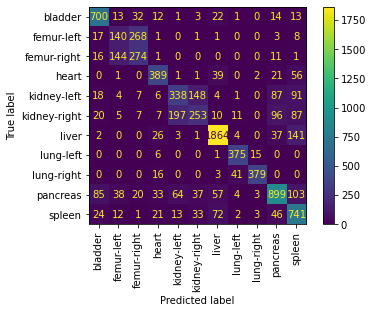

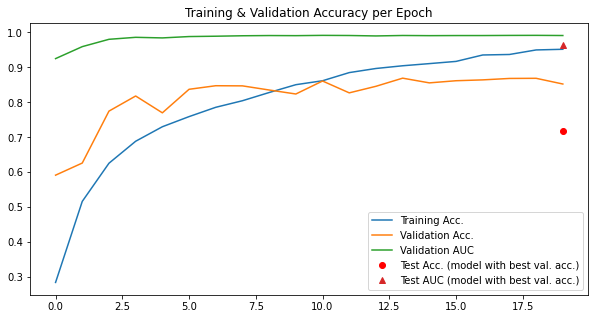

In [29]:
clf = run_classifier_pipeline(
    "organsmnist", info_flags, organsmnist_noGDA,
    DA_technique=DA_technique
)

### 3.3. Training on the MedMNIST datasets with WSR and GDA

In [12]:
# Declares the baseline setup to save the related model
DA_technique="_WSR_GDA"

#### PathMNIST

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [02:10<00:00, 10.79it/s]


train -- accuracy: 0.5707
val -- accuracy: 0.6276,  AUC: 0.9538
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:56<00:00, 12.09it/s]


train -- accuracy: 0.7555
val -- accuracy: 0.8044,  AUC: 0.9773
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:57<00:00, 11.98it/s]


train -- accuracy: 0.8124
val -- accuracy: 0.823,  AUC: 0.9824
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:53<00:00, 12.40it/s]


train -- accuracy: 0.8432
val -- accuracy: 0.8145,  AUC: 0.9839
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:45<00:00, 13.31it/s]


train -- accuracy: 0.8581
val -- accuracy: 0.8394,  AUC: 0.988
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:44<00:00, 13.44it/s]


train -- accuracy: 0.8722
val -- accuracy: 0.8604,  AUC: 0.9894
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:56<00:00, 12.11it/s]


train -- accuracy: 0.8798
val -- accuracy: 0.8749,  AUC: 0.9912
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:58<00:00, 11.88it/s]


train -- accuracy: 0.8892
val -- accuracy: 0.8604,  AUC: 0.9884
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:57<00:00, 11.99it/s]


train -- accuracy: 0.8954
val -- accuracy: 0.8814,  AUC: 0.9923
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:57<00:00, 11.95it/s]


train -- accuracy: 0.8979
val -- accuracy: 0.8915,  AUC: 0.9927
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:58<00:00, 11.88it/s]


train -- accuracy: 0.9019
val -- accuracy: 0.9036,  AUC: 0.9932
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [02:00<00:00, 11.63it/s]


train -- accuracy: 0.9057
val -- accuracy: 0.8515,  AUC: 0.991
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [02:05<00:00, 11.17it/s]


train -- accuracy: 0.9074
val -- accuracy: 0.9083,  AUC: 0.9946
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [02:02<00:00, 11.48it/s]


train -- accuracy: 0.9104
val -- accuracy: 0.9074,  AUC: 0.995
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [02:01<00:00, 11.61it/s]


train -- accuracy: 0.9128
val -- accuracy: 0.8994,  AUC: 0.9943
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [02:19<00:00, 10.06it/s]


train -- accuracy: 0.9141
val -- accuracy: 0.8917,  AUC: 0.9929
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [02:33<00:00,  9.15it/s]


train -- accuracy: 0.9193
val -- accuracy: 0.8741,  AUC: 0.9926
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [02:19<00:00, 10.09it/s]


train -- accuracy: 0.9201
val -- accuracy: 0.9071,  AUC: 0.9938
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:55<00:00, 12.19it/s]


train -- accuracy: 0.9223
val -- accuracy: 0.921,  AUC: 0.9953
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:59<00:00, 11.78it/s]


train -- accuracy: 0.9237
val -- accuracy: 0.9218,  AUC: 0.9957
test -- accuracy: 0.8829,  AUC: 0.9914


<Figure size 720x720 with 0 Axes>

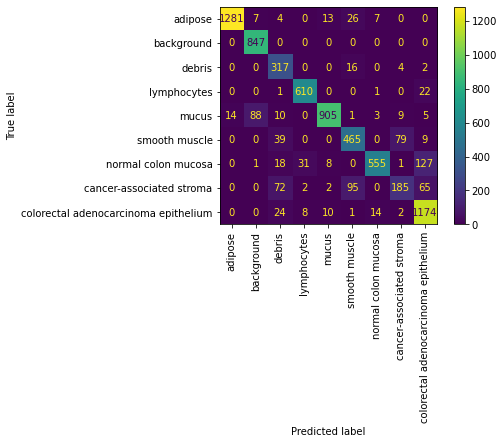

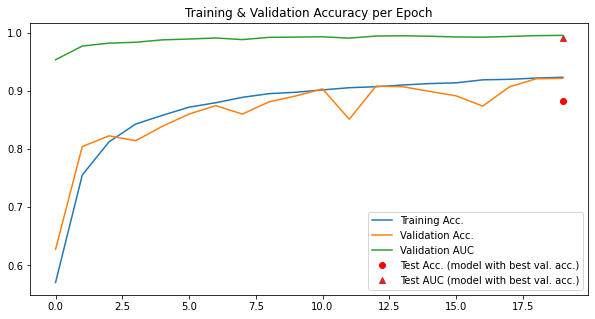

In [13]:
clf = run_classifier_pipeline(
    "pathmnist", info_flags, pathmnist_WSR_GDA,
    DA_technique=DA_technique
)

#### DermaMNIST

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:11<00:00,  9.72it/s]


train -- accuracy: 0.2208
val -- accuracy: 0.5125,  AUC: 0.8022
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:10<00:00, 10.32it/s]


train -- accuracy: 0.3237
val -- accuracy: 0.5733,  AUC: 0.8416
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:10<00:00, 10.29it/s]


train -- accuracy: 0.3939
val -- accuracy: 0.5364,  AUC: 0.8554
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:10<00:00, 10.21it/s]


train -- accuracy: 0.4461
val -- accuracy: 0.4656,  AUC: 0.8334
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:11<00:00,  9.37it/s]


train -- accuracy: 0.4613
val -- accuracy: 0.5234,  AUC: 0.8652
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:10<00:00, 10.18it/s]


train -- accuracy: 0.5002
val -- accuracy: 0.654,  AUC: 0.8882
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:12<00:00,  8.88it/s]


train -- accuracy: 0.527
val -- accuracy: 0.6251,  AUC: 0.8855
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:12<00:00,  8.54it/s]


train -- accuracy: 0.5526
val -- accuracy: 0.4945,  AUC: 0.8599
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:11<00:00,  9.82it/s]


train -- accuracy: 0.5864
val -- accuracy: 0.6062,  AUC: 0.8809
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:11<00:00,  9.29it/s]


train -- accuracy: 0.6105
val -- accuracy: 0.5713,  AUC: 0.8861
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:11<00:00,  9.54it/s]


train -- accuracy: 0.6332
val -- accuracy: 0.4726,  AUC: 0.854
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:12<00:00,  8.92it/s]


train -- accuracy: 0.6529
val -- accuracy: 0.654,  AUC: 0.88
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:12<00:00,  9.13it/s]


train -- accuracy: 0.6708
val -- accuracy: 0.6421,  AUC: 0.8786
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:12<00:00,  8.75it/s]


train -- accuracy: 0.7046
val -- accuracy: 0.6879,  AUC: 0.9087
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:09<00:00, 11.19it/s]


train -- accuracy: 0.7006
val -- accuracy: 0.6092,  AUC: 0.8797
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:09<00:00, 11.62it/s]


train -- accuracy: 0.7186
val -- accuracy: 0.5474,  AUC: 0.8623
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:09<00:00, 11.46it/s]


train -- accuracy: 0.7493
val -- accuracy: 0.6082,  AUC: 0.8834
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:09<00:00, 11.30it/s]


train -- accuracy: 0.7521
val -- accuracy: 0.668,  AUC: 0.8883
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:12<00:00,  8.87it/s]


train -- accuracy: 0.7687
val -- accuracy: 0.5543,  AUC: 0.8608
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:10<00:00, 10.81it/s]


train -- accuracy: 0.7799
val -- accuracy: 0.6251,  AUC: 0.884
test -- accuracy: 0.6439,  AUC: 0.8943


<Figure size 720x720 with 0 Axes>

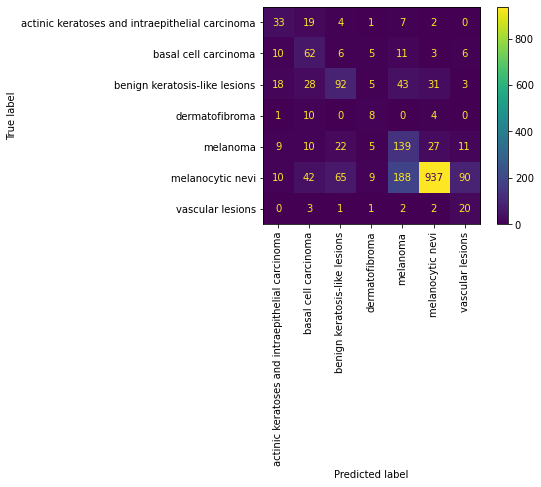

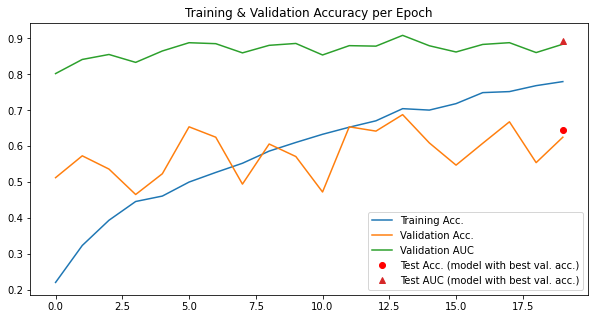

In [14]:
clf = run_classifier_pipeline(
    "dermamnist", info_flags, dermamnist_WSR_GDA,
    DA_technique=DA_technique
)

#### OctMNIST

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:51<00:00, 29.50it/s]


train -- accuracy: 0.6672
val -- accuracy: 0.6484,  AUC: 0.9234
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:50<00:00, 30.42it/s]


train -- accuracy: 0.7855
val -- accuracy: 0.8684,  AUC: 0.9527
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:48<00:00, 31.24it/s]


train -- accuracy: 0.8131
val -- accuracy: 0.7959,  AUC: 0.956
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:49<00:00, 31.06it/s]


train -- accuracy: 0.8311
val -- accuracy: 0.6084,  AUC: 0.9544
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:49<00:00, 31.02it/s]


train -- accuracy: 0.8417
val -- accuracy: 0.8643,  AUC: 0.9638
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:48<00:00, 31.44it/s]


train -- accuracy: 0.8526
val -- accuracy: 0.8227,  AUC: 0.9619
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:48<00:00, 31.31it/s]


train -- accuracy: 0.8593
val -- accuracy: 0.851,  AUC: 0.9635
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:45<00:00, 33.50it/s]


train -- accuracy: 0.8683
val -- accuracy: 0.8758,  AUC: 0.9672
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.33it/s]


train -- accuracy: 0.8742
val -- accuracy: 0.88,  AUC: 0.9677
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.24it/s]


train -- accuracy: 0.8812
val -- accuracy: 0.8655,  AUC: 0.9677
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.16it/s]


train -- accuracy: 0.8888
val -- accuracy: 0.8564,  AUC: 0.9691
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.03it/s]


train -- accuracy: 0.8915
val -- accuracy: 0.8882,  AUC: 0.9691
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 34.77it/s]


train -- accuracy: 0.896
val -- accuracy: 0.8326,  AUC: 0.9684
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.19it/s]


train -- accuracy: 0.9022
val -- accuracy: 0.8735,  AUC: 0.9678
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.18it/s]


train -- accuracy: 0.9037
val -- accuracy: 0.8081,  AUC: 0.9632
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:44<00:00, 34.62it/s]


train -- accuracy: 0.9085
val -- accuracy: 0.8307,  AUC: 0.9677
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:42<00:00, 35.88it/s]


train -- accuracy: 0.9132
val -- accuracy: 0.8786,  AUC: 0.9703
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.15it/s]


train -- accuracy: 0.9156
val -- accuracy: 0.8539,  AUC: 0.9709
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 34.68it/s]


train -- accuracy: 0.9209
val -- accuracy: 0.8796,  AUC: 0.9714
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:42<00:00, 35.51it/s]


train -- accuracy: 0.9238
val -- accuracy: 0.8972,  AUC: 0.9724
test -- accuracy: 0.742,  AUC: 0.9298


<Figure size 720x720 with 0 Axes>

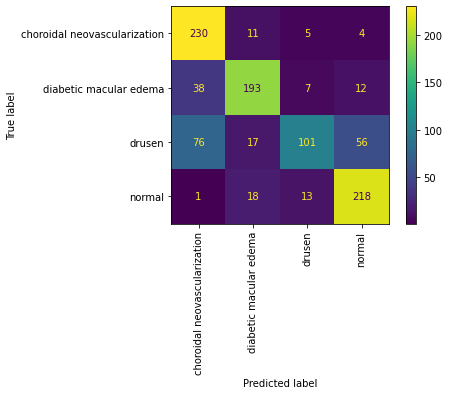

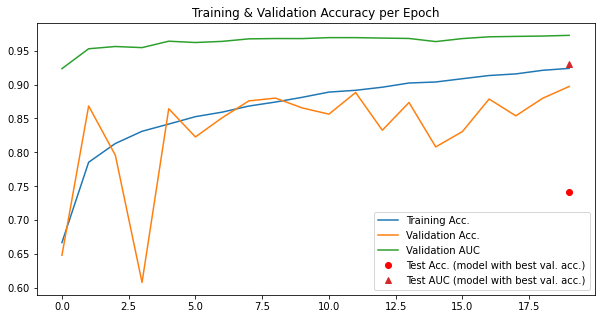

In [15]:
clf = run_classifier_pipeline(
    "octmnist", info_flags, octmnist_WSR_GDA,
    DA_technique=DA_technique
)

#### PneumoniaMNIST

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 34.37it/s]


train -- accuracy: 0.7593
val -- accuracy: 0.9179,  AUC: 0.9641
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 34.86it/s]


train -- accuracy: 0.9331
val -- accuracy: 0.9561,  AUC: 0.9863
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 34.45it/s]


train -- accuracy: 0.9376
val -- accuracy: 0.9485,  AUC: 0.9914
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 34.93it/s]


train -- accuracy: 0.9494
val -- accuracy: 0.9427,  AUC: 0.9921
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.32it/s]


train -- accuracy: 0.9552
val -- accuracy: 0.9618,  AUC: 0.9948
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 34.84it/s]


train -- accuracy: 0.9592
val -- accuracy: 0.9637,  AUC: 0.995
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.48it/s]


train -- accuracy: 0.9696
val -- accuracy: 0.9676,  AUC: 0.9949
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.45it/s]


train -- accuracy: 0.9679
val -- accuracy: 0.9733,  AUC: 0.9967
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.31it/s]


train -- accuracy: 0.9732
val -- accuracy: 0.9714,  AUC: 0.9967
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.32it/s]


train -- accuracy: 0.9754
val -- accuracy: 0.9618,  AUC: 0.9958
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.33it/s]


train -- accuracy: 0.9783
val -- accuracy: 0.9752,  AUC: 0.9966
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.93it/s]


train -- accuracy: 0.9768
val -- accuracy: 0.9714,  AUC: 0.9965
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.41it/s]


train -- accuracy: 0.9807
val -- accuracy: 0.9676,  AUC: 0.9954
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.59it/s]


train -- accuracy: 0.9832
val -- accuracy: 0.9561,  AUC: 0.997
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.84it/s]


train -- accuracy: 0.9832
val -- accuracy: 0.979,  AUC: 0.9963
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.61it/s]


train -- accuracy: 0.9847
val -- accuracy: 0.9676,  AUC: 0.9961
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.48it/s]


train -- accuracy: 0.9862
val -- accuracy: 0.9771,  AUC: 0.9968
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.28it/s]


train -- accuracy: 0.9873
val -- accuracy: 0.9695,  AUC: 0.996
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.20it/s]


train -- accuracy: 0.9887
val -- accuracy: 0.9771,  AUC: 0.9973
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.12it/s]


train -- accuracy: 0.9911
val -- accuracy: 0.9752,  AUC: 0.9971
test -- accuracy: 0.9038,  AUC: 0.9666


<Figure size 720x720 with 0 Axes>

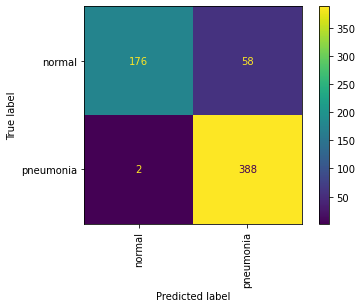

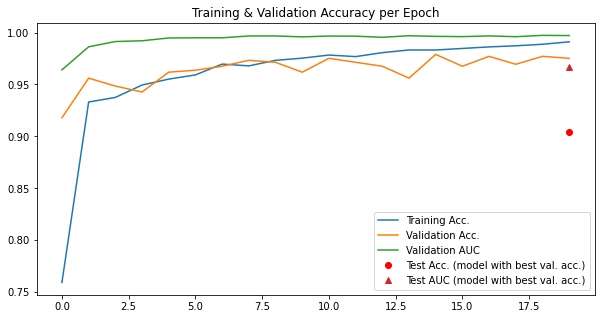

In [16]:
clf = run_classifier_pipeline(
    "pneumoniamnist", info_flags, pneumoniamnist_WSR_GDA,
    DA_technique=DA_technique
)

#### BreastMNIST

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 31.63it/s]


train -- accuracy: 0.4799
val -- accuracy: 0.7308,  AUC: 0.2765
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 36.30it/s]


train -- accuracy: 0.5861
val -- accuracy: 0.7308,  AUC: 0.2556
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 36.82it/s]


train -- accuracy: 0.6593
val -- accuracy: 0.4872,  AUC: 0.406
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 34.48it/s]


train -- accuracy: 0.6429
val -- accuracy: 0.4103,  AUC: 0.7226
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 35.43it/s]


train -- accuracy: 0.7216
val -- accuracy: 0.6026,  AUC: 0.7794
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.63it/s]


train -- accuracy: 0.6868
val -- accuracy: 0.641,  AUC: 0.7803
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.23it/s]


train -- accuracy: 0.6832
val -- accuracy: 0.6667,  AUC: 0.7753
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 33.40it/s]


train -- accuracy: 0.6557
val -- accuracy: 0.6795,  AUC: 0.7836
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 36.82it/s]


train -- accuracy: 0.7363
val -- accuracy: 0.6667,  AUC: 0.7845
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.55it/s]


train -- accuracy: 0.707
val -- accuracy: 0.5641,  AUC: 0.797
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 35.39it/s]


train -- accuracy: 0.7161
val -- accuracy: 0.6282,  AUC: 0.8045
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 36.16it/s]


train -- accuracy: 0.7509
val -- accuracy: 0.6923,  AUC: 0.8003
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.07it/s]


train -- accuracy: 0.7015
val -- accuracy: 0.6667,  AUC: 0.8154
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.21it/s]


train -- accuracy: 0.7234
val -- accuracy: 0.7051,  AUC: 0.8179
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 34.86it/s]


train -- accuracy: 0.7601
val -- accuracy: 0.6667,  AUC: 0.8179
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.14it/s]


train -- accuracy: 0.7418
val -- accuracy: 0.7949,  AUC: 0.8396
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 36.98it/s]


train -- accuracy: 0.7839
val -- accuracy: 0.7949,  AUC: 0.858
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 34.46it/s]


train -- accuracy: 0.8187
val -- accuracy: 0.6538,  AUC: 0.8396
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 35.15it/s]


train -- accuracy: 0.8223
val -- accuracy: 0.7436,  AUC: 0.8371
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 36.59it/s]


train -- accuracy: 0.8077
val -- accuracy: 0.6795,  AUC: 0.858
test -- accuracy: 0.6795,  AUC: 0.8302


<Figure size 720x720 with 0 Axes>

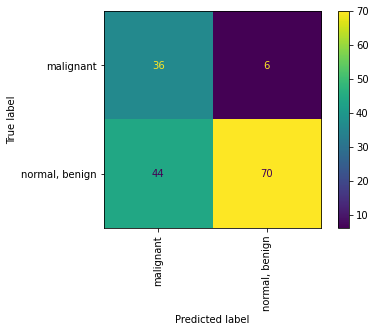

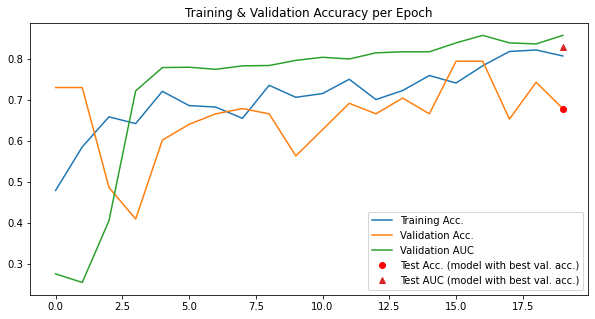

In [17]:
clf = run_classifier_pipeline(
    "breastmnist", info_flags, breastmnist_WSR_GDA,
    DA_technique=DA_technique
)

#### OrganAMNIST

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 33.99it/s]


train -- accuracy: 0.5626
val -- accuracy: 0.8698,  AUC: 0.9903
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.07it/s]


train -- accuracy: 0.8314
val -- accuracy: 0.884,  AUC: 0.9948
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.28it/s]


train -- accuracy: 0.8811
val -- accuracy: 0.9382,  AUC: 0.9979
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.62it/s]


train -- accuracy: 0.9108
val -- accuracy: 0.9393,  AUC: 0.9976
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.08it/s]


train -- accuracy: 0.9249
val -- accuracy: 0.9365,  AUC: 0.9979
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.08it/s]


train -- accuracy: 0.9371
val -- accuracy: 0.9455,  AUC: 0.9982
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.11it/s]


train -- accuracy: 0.9483
val -- accuracy: 0.9499,  AUC: 0.998
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.44it/s]


train -- accuracy: 0.9552
val -- accuracy: 0.9553,  AUC: 0.9984
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.56it/s]


train -- accuracy: 0.9604
val -- accuracy: 0.9579,  AUC: 0.9988
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.47it/s]


train -- accuracy: 0.965
val -- accuracy: 0.9559,  AUC: 0.9989
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.03it/s]


train -- accuracy: 0.9696
val -- accuracy: 0.9613,  AUC: 0.9989
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.20it/s]


train -- accuracy: 0.9714
val -- accuracy: 0.9584,  AUC: 0.9987
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.47it/s]


train -- accuracy: 0.976
val -- accuracy: 0.9592,  AUC: 0.9988
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.57it/s]


train -- accuracy: 0.9774
val -- accuracy: 0.9502,  AUC: 0.9988
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.15it/s]


train -- accuracy: 0.9815
val -- accuracy: 0.9525,  AUC: 0.9987
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.43it/s]


train -- accuracy: 0.98
val -- accuracy: 0.9599,  AUC: 0.9991
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.47it/s]


train -- accuracy: 0.9828
val -- accuracy: 0.9561,  AUC: 0.999
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.45it/s]


train -- accuracy: 0.9844
val -- accuracy: 0.9604,  AUC: 0.9991
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.67it/s]


train -- accuracy: 0.9857
val -- accuracy: 0.9559,  AUC: 0.9989
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.59it/s]


train -- accuracy: 0.9874
val -- accuracy: 0.9633,  AUC: 0.9993
test -- accuracy: 0.8743,  AUC: 0.9885


<Figure size 720x720 with 0 Axes>

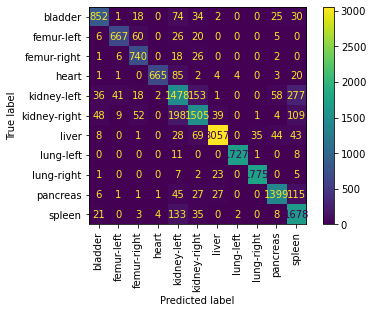

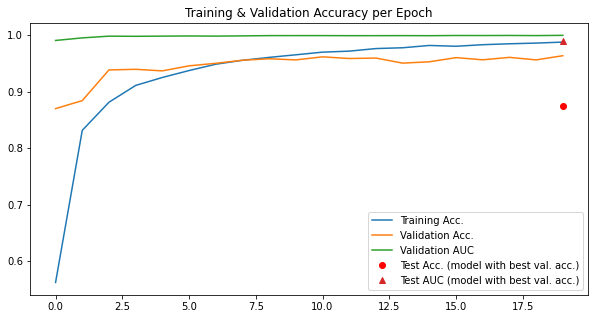

In [18]:
clf = run_classifier_pipeline(
    "organamnist", info_flags, organamnist_WSR_GDA,
    DA_technique=DA_technique
)

#### OrganCMNIST

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.83it/s]


train -- accuracy: 0.3038
val -- accuracy: 0.5635,  AUC: 0.9003
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.71it/s]


train -- accuracy: 0.5475
val -- accuracy: 0.7722,  AUC: 0.9692
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.06it/s]


train -- accuracy: 0.6843
val -- accuracy: 0.8336,  AUC: 0.9844
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:06<00:00, 33.43it/s]


train -- accuracy: 0.7592
val -- accuracy: 0.8917,  AUC: 0.9908
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.14it/s]


train -- accuracy: 0.7924
val -- accuracy: 0.9147,  AUC: 0.9939
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.86it/s]


train -- accuracy: 0.8222
val -- accuracy: 0.9331,  AUC: 0.9956
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.66it/s]


train -- accuracy: 0.8422
val -- accuracy: 0.936,  AUC: 0.9961
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.38it/s]


train -- accuracy: 0.852
val -- accuracy: 0.931,  AUC: 0.9959
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.53it/s]


train -- accuracy: 0.8713
val -- accuracy: 0.9402,  AUC: 0.9967
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.07it/s]


train -- accuracy: 0.8795
val -- accuracy: 0.9277,  AUC: 0.9956
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.57it/s]


train -- accuracy: 0.8943
val -- accuracy: 0.9427,  AUC: 0.9971
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.59it/s]


train -- accuracy: 0.8995
val -- accuracy: 0.9415,  AUC: 0.9971
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.81it/s]


train -- accuracy: 0.9042
val -- accuracy: 0.9427,  AUC: 0.9974
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.56it/s]


train -- accuracy: 0.9048
val -- accuracy: 0.9356,  AUC: 0.9964
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.07it/s]


train -- accuracy: 0.9208
val -- accuracy: 0.9256,  AUC: 0.9972
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.54it/s]


train -- accuracy: 0.9171
val -- accuracy: 0.9469,  AUC: 0.997
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.21it/s]


train -- accuracy: 0.9235
val -- accuracy: 0.9498,  AUC: 0.9975
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.96it/s]


train -- accuracy: 0.9365
val -- accuracy: 0.9457,  AUC: 0.997
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.44it/s]


train -- accuracy: 0.9392
val -- accuracy: 0.954,  AUC: 0.9977
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 36.06it/s]


train -- accuracy: 0.9442
val -- accuracy: 0.9344,  AUC: 0.9965
test -- accuracy: 0.8166,  AUC: 0.983


<Figure size 720x720 with 0 Axes>

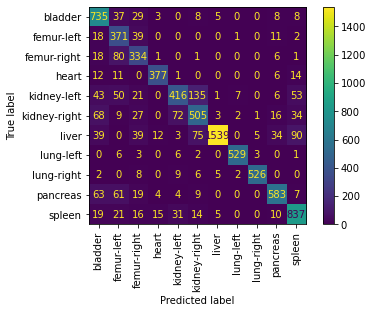

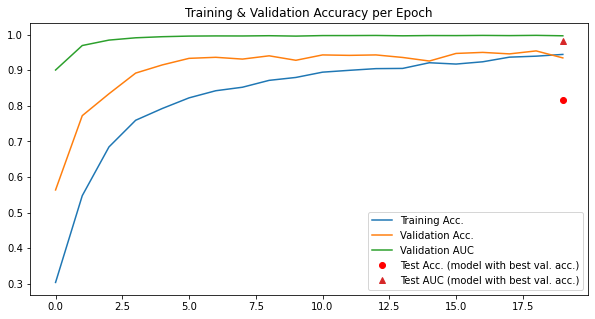

In [19]:
clf = run_classifier_pipeline(
    "organcmnist", info_flags, organcmnist_WSR_GDA,
    DA_technique=DA_technique
)

#### OrganSMNIST

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.02it/s]


train -- accuracy: 0.282
val -- accuracy: 0.3793,  AUC: 0.8808
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.96it/s]


train -- accuracy: 0.4339
val -- accuracy: 0.5734,  AUC: 0.9244
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 33.26it/s]


train -- accuracy: 0.5214
val -- accuracy: 0.5934,  AUC: 0.9549
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.22it/s]


train -- accuracy: 0.5891
val -- accuracy: 0.6664,  AUC: 0.9688
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.85it/s]


train -- accuracy: 0.6435
val -- accuracy: 0.7378,  AUC: 0.9799
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.79it/s]


train -- accuracy: 0.6708
val -- accuracy: 0.7732,  AUC: 0.9828
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.26it/s]


train -- accuracy: 0.6879
val -- accuracy: 0.7794,  AUC: 0.9838
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.03it/s]


train -- accuracy: 0.7058
val -- accuracy: 0.8185,  AUC: 0.9861
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.00it/s]


train -- accuracy: 0.7318
val -- accuracy: 0.7924,  AUC: 0.9845
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.62it/s]


train -- accuracy: 0.7437
val -- accuracy: 0.7561,  AUC: 0.9831
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.32it/s]


train -- accuracy: 0.7554
val -- accuracy: 0.8201,  AUC: 0.986
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.18it/s]


train -- accuracy: 0.7623
val -- accuracy: 0.8144,  AUC: 0.9874
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.41it/s]


train -- accuracy: 0.7801
val -- accuracy: 0.8083,  AUC: 0.987
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.95it/s]


train -- accuracy: 0.7834
val -- accuracy: 0.8046,  AUC: 0.9873
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.52it/s]


train -- accuracy: 0.802
val -- accuracy: 0.803,  AUC: 0.9876
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.05it/s]


train -- accuracy: 0.8052
val -- accuracy: 0.7892,  AUC: 0.9874
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.74it/s]


train -- accuracy: 0.8155
val -- accuracy: 0.81,  AUC: 0.9883
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.18it/s]


train -- accuracy: 0.8303
val -- accuracy: 0.8189,  AUC: 0.9866
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.18it/s]


train -- accuracy: 0.8326
val -- accuracy: 0.8263,  AUC: 0.987
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.04it/s]


train -- accuracy: 0.8369
val -- accuracy: 0.7741,  AUC: 0.9868
test -- accuracy: 0.6395,  AUC: 0.9527


<Figure size 720x720 with 0 Axes>

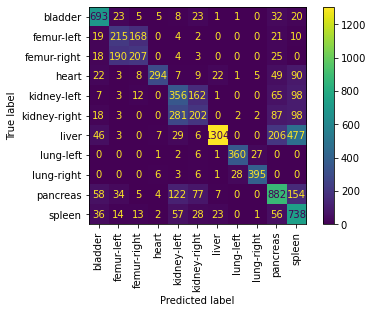

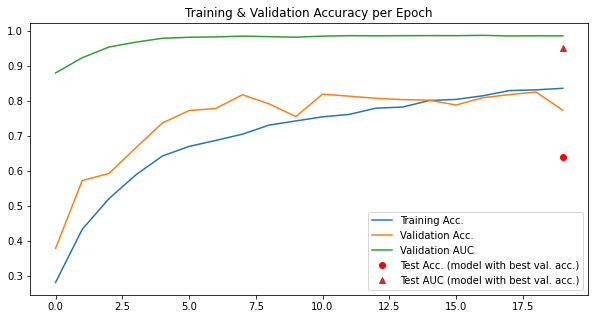

In [20]:
clf = run_classifier_pipeline(
    "organsmnist", info_flags, organsmnist_WSR_GDA,
    DA_technique=DA_technique
)

### 3.4. Training on the MedMNIST datasets with GDA but without WSR

In [21]:
# Declares the baseline setup to save the related model
DA_technique="_noWSR_GDA"

#### PathMNIST

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:50<00:00, 12.76it/s]


train -- accuracy: 0.5606
val -- accuracy: 0.6587,  AUC: 0.946
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:50<00:00, 12.68it/s]


train -- accuracy: 0.7383
val -- accuracy: 0.7494,  AUC: 0.9669
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:53<00:00, 12.43it/s]


train -- accuracy: 0.7974
val -- accuracy: 0.8084,  AUC: 0.9811
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:52<00:00, 12.55it/s]


train -- accuracy: 0.8325
val -- accuracy: 0.8275,  AUC: 0.9841
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:51<00:00, 12.56it/s]


train -- accuracy: 0.851
val -- accuracy: 0.8298,  AUC: 0.9852
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:50<00:00, 12.75it/s]


train -- accuracy: 0.8616
val -- accuracy: 0.8635,  AUC: 0.9888
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:53<00:00, 12.45it/s]


train -- accuracy: 0.8741
val -- accuracy: 0.8817,  AUC: 0.9912
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:52<00:00, 12.52it/s]


train -- accuracy: 0.8827
val -- accuracy: 0.8729,  AUC: 0.9901
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:51<00:00, 12.65it/s]


train -- accuracy: 0.8887
val -- accuracy: 0.8993,  AUC: 0.9929
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:51<00:00, 12.60it/s]


train -- accuracy: 0.8942
val -- accuracy: 0.8713,  AUC: 0.9914
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:51<00:00, 12.62it/s]


train -- accuracy: 0.8974
val -- accuracy: 0.8943,  AUC: 0.9934
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:51<00:00, 12.62it/s]


train -- accuracy: 0.9031
val -- accuracy: 0.8937,  AUC: 0.9935
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:51<00:00, 12.67it/s]


train -- accuracy: 0.9089
val -- accuracy: 0.8958,  AUC: 0.9926
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:51<00:00, 12.65it/s]


train -- accuracy: 0.9115
val -- accuracy: 0.9017,  AUC: 0.9942
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:51<00:00, 12.67it/s]


train -- accuracy: 0.9155
val -- accuracy: 0.8973,  AUC: 0.9943
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:52<00:00, 12.53it/s]


train -- accuracy: 0.918
val -- accuracy: 0.909,  AUC: 0.9947
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:50<00:00, 12.70it/s]


train -- accuracy: 0.9186
val -- accuracy: 0.9199,  AUC: 0.9952
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:50<00:00, 12.69it/s]


train -- accuracy: 0.921
val -- accuracy: 0.8932,  AUC: 0.9936
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:51<00:00, 12.58it/s]


train -- accuracy: 0.924
val -- accuracy: 0.9232,  AUC: 0.9961
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1407/1407 [01:53<00:00, 12.42it/s]


train -- accuracy: 0.9264
val -- accuracy: 0.9226,  AUC: 0.9962
test -- accuracy: 0.8797,  AUC: 0.9894


<Figure size 720x720 with 0 Axes>

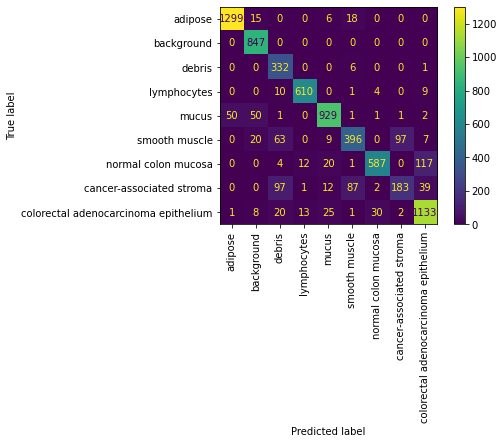

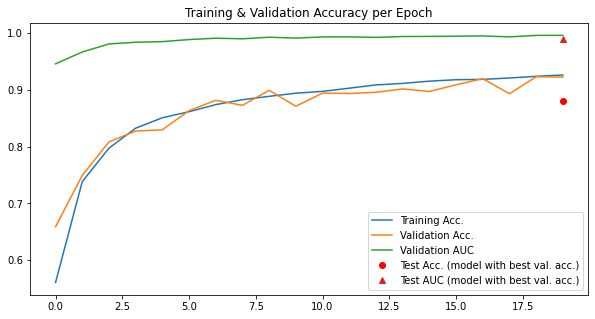

In [22]:
clf = run_classifier_pipeline(
    "pathmnist", info_flags, pathmnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### DermaMNIST

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.48it/s]


train -- accuracy: 0.2242
val -- accuracy: 0.4487,  AUC: 0.7696
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.40it/s]


train -- accuracy: 0.3357
val -- accuracy: 0.5394,  AUC: 0.8056
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.36it/s]


train -- accuracy: 0.3849
val -- accuracy: 0.5563,  AUC: 0.8414
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.54it/s]


train -- accuracy: 0.4284
val -- accuracy: 0.6082,  AUC: 0.8528
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.54it/s]


train -- accuracy: 0.4688
val -- accuracy: 0.5803,  AUC: 0.8701
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.45it/s]


train -- accuracy: 0.5008
val -- accuracy: 0.5613,  AUC: 0.8628
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:09<00:00, 12.14it/s]


train -- accuracy: 0.5376
val -- accuracy: 0.5892,  AUC: 0.8659
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.33it/s]


train -- accuracy: 0.5653
val -- accuracy: 0.6122,  AUC: 0.87
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.39it/s]


train -- accuracy: 0.5928
val -- accuracy: 0.5842,  AUC: 0.8822
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:11<00:00,  9.21it/s]


train -- accuracy: 0.619
val -- accuracy: 0.6351,  AUC: 0.8916
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:09<00:00, 12.22it/s]


train -- accuracy: 0.6508
val -- accuracy: 0.5633,  AUC: 0.8738
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.27it/s]


train -- accuracy: 0.6673
val -- accuracy: 0.6421,  AUC: 0.869
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:09<00:00, 12.08it/s]


train -- accuracy: 0.6947
val -- accuracy: 0.6032,  AUC: 0.8877
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:09<00:00, 11.88it/s]


train -- accuracy: 0.7107
val -- accuracy: 0.5952,  AUC: 0.8863
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.43it/s]


train -- accuracy: 0.7256
val -- accuracy: 0.6241,  AUC: 0.8912
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.43it/s]


train -- accuracy: 0.7434
val -- accuracy: 0.682,  AUC: 0.8887
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.64it/s]


train -- accuracy: 0.7631
val -- accuracy: 0.6132,  AUC: 0.8841
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.68it/s]


train -- accuracy: 0.7572
val -- accuracy: 0.5703,  AUC: 0.8771
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.71it/s]


train -- accuracy: 0.7889
val -- accuracy: 0.681,  AUC: 0.8907
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 110/110 [00:08<00:00, 12.54it/s]


train -- accuracy: 0.7949
val -- accuracy: 0.654,  AUC: 0.8989
test -- accuracy: 0.6653,  AUC: 0.8997


<Figure size 720x720 with 0 Axes>

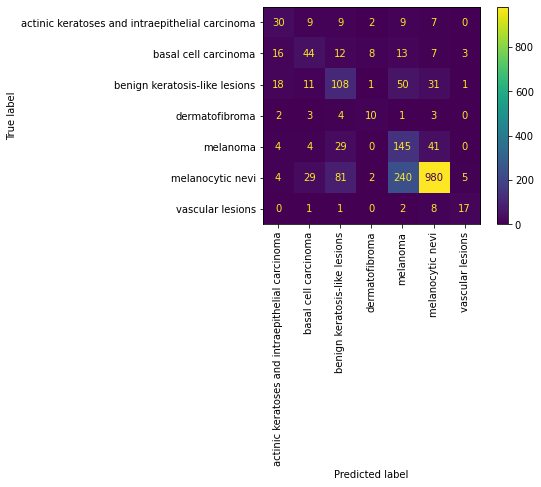

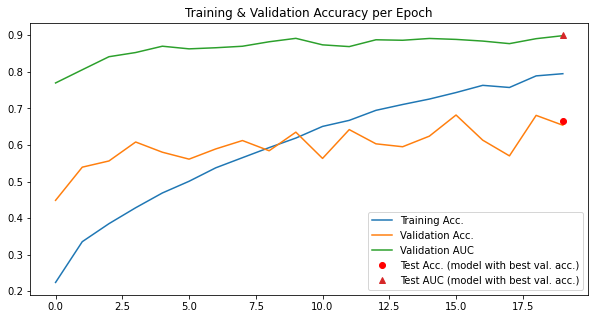

In [23]:
clf = run_classifier_pipeline(
    "dermamnist", info_flags, dermamnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### OctMNIST

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:42<00:00, 35.46it/s]


train -- accuracy: 0.6695
val -- accuracy: 0.7867,  AUC: 0.9459
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.22it/s]


train -- accuracy: 0.7807
val -- accuracy: 0.7885,  AUC: 0.9543
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.33it/s]


train -- accuracy: 0.8121
val -- accuracy: 0.8061,  AUC: 0.9565
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.27it/s]


train -- accuracy: 0.8303
val -- accuracy: 0.8138,  AUC: 0.9575
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 34.67it/s]


train -- accuracy: 0.8415
val -- accuracy: 0.8597,  AUC: 0.9636
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.07it/s]


train -- accuracy: 0.8499
val -- accuracy: 0.831,  AUC: 0.9636
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 34.64it/s]


train -- accuracy: 0.8588
val -- accuracy: 0.822,  AUC: 0.9644
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.39it/s]


train -- accuracy: 0.868
val -- accuracy: 0.885,  AUC: 0.9676
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.34it/s]


train -- accuracy: 0.8727
val -- accuracy: 0.8773,  AUC: 0.9675
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 34.77it/s]


train -- accuracy: 0.8775
val -- accuracy: 0.8867,  AUC: 0.9673
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.32it/s]


train -- accuracy: 0.8861
val -- accuracy: 0.871,  AUC: 0.9687
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 34.95it/s]


train -- accuracy: 0.8895
val -- accuracy: 0.8786,  AUC: 0.9695
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:42<00:00, 35.63it/s]


train -- accuracy: 0.894
val -- accuracy: 0.8648,  AUC: 0.9702
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:42<00:00, 35.71it/s]


train -- accuracy: 0.9007
val -- accuracy: 0.8783,  AUC: 0.968
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 34.98it/s]


train -- accuracy: 0.9017
val -- accuracy: 0.887,  AUC: 0.9686
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.30it/s]


train -- accuracy: 0.9081
val -- accuracy: 0.8447,  AUC: 0.9682
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.30it/s]


train -- accuracy: 0.9102
val -- accuracy: 0.8841,  AUC: 0.9699
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 34.85it/s]


train -- accuracy: 0.9151
val -- accuracy: 0.8705,  AUC: 0.9698
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.42it/s]


train -- accuracy: 0.9193
val -- accuracy: 0.8977,  AUC: 0.9683
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1524/1524 [00:43<00:00, 35.35it/s]


train -- accuracy: 0.9208
val -- accuracy: 0.8859,  AUC: 0.968
test -- accuracy: 0.688,  AUC: 0.9154


<Figure size 720x720 with 0 Axes>

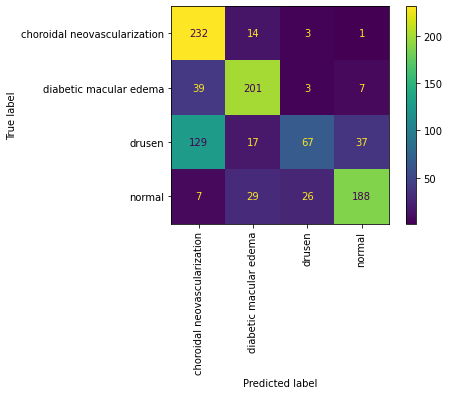

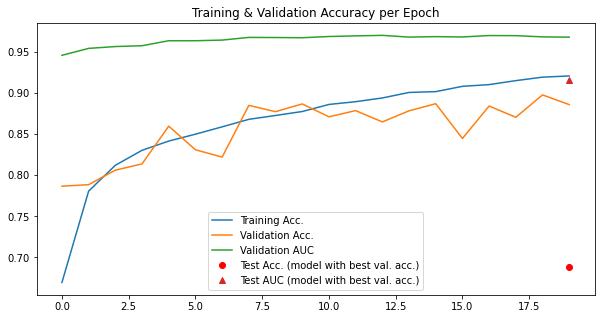

In [24]:
clf = run_classifier_pipeline(
    "octmnist", info_flags, octmnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### PneumoniaMNIST

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.32it/s]


train -- accuracy: 0.7676
val -- accuracy: 0.9351,  AUC: 0.9781
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.54it/s]


train -- accuracy: 0.9284
val -- accuracy: 0.9485,  AUC: 0.9869
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.47it/s]


train -- accuracy: 0.941
val -- accuracy: 0.9599,  AUC: 0.991
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.06it/s]


train -- accuracy: 0.9469
val -- accuracy: 0.9504,  AUC: 0.992
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.33it/s]


train -- accuracy: 0.9575
val -- accuracy: 0.9561,  AUC: 0.9943
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 34.47it/s]


train -- accuracy: 0.9609
val -- accuracy: 0.9656,  AUC: 0.9941
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.17it/s]


train -- accuracy: 0.9652
val -- accuracy: 0.9618,  AUC: 0.9941
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.23it/s]


train -- accuracy: 0.9715
val -- accuracy: 0.9656,  AUC: 0.9946
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 34.80it/s]


train -- accuracy: 0.9675
val -- accuracy: 0.9218,  AUC: 0.9944
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.44it/s]


train -- accuracy: 0.9673
val -- accuracy: 0.9618,  AUC: 0.9944
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.07it/s]


train -- accuracy: 0.9745
val -- accuracy: 0.9637,  AUC: 0.9949
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.64it/s]


train -- accuracy: 0.9775
val -- accuracy: 0.958,  AUC: 0.9955
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.36it/s]


train -- accuracy: 0.9798
val -- accuracy: 0.9695,  AUC: 0.9957
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.96it/s]


train -- accuracy: 0.9845
val -- accuracy: 0.9656,  AUC: 0.9947
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.02it/s]


train -- accuracy: 0.9839
val -- accuracy: 0.9618,  AUC: 0.9948
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.13it/s]


train -- accuracy: 0.987
val -- accuracy: 0.9618,  AUC: 0.994
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.11it/s]


train -- accuracy: 0.9873
val -- accuracy: 0.9695,  AUC: 0.9936
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.51it/s]


train -- accuracy: 0.9911
val -- accuracy: 0.9637,  AUC: 0.9942
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 35.88it/s]


train -- accuracy: 0.9902
val -- accuracy: 0.9599,  AUC: 0.9945
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 74/74 [00:02<00:00, 36.25it/s]


train -- accuracy: 0.9917
val -- accuracy: 0.9656,  AUC: 0.9953
test -- accuracy: 0.8638,  AUC: 0.9574


<Figure size 720x720 with 0 Axes>

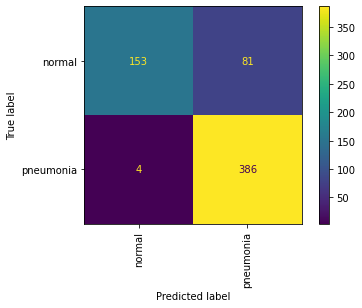

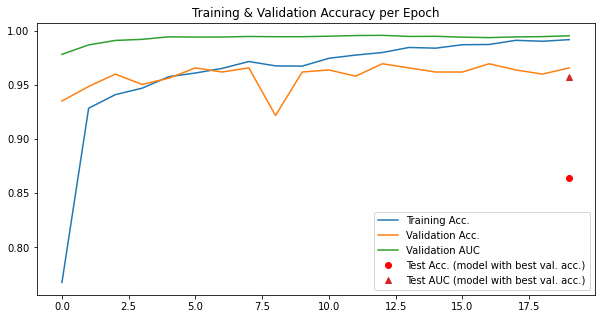

In [25]:
clf = run_classifier_pipeline(
    "pneumoniamnist", info_flags, pneumoniamnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### BreastMNIST

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 34.78it/s]


train -- accuracy: 0.4799
val -- accuracy: 0.2692,  AUC: 0.4403
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.16it/s]


train -- accuracy: 0.5861
val -- accuracy: 0.3077,  AUC: 0.4315
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 35.48it/s]


train -- accuracy: 0.5989
val -- accuracy: 0.3718,  AUC: 0.6282
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.30it/s]


train -- accuracy: 0.6722
val -- accuracy: 0.6154,  AUC: 0.7368
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 36.83it/s]


train -- accuracy: 0.6648
val -- accuracy: 0.7436,  AUC: 0.7444
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 34.74it/s]


train -- accuracy: 0.652
val -- accuracy: 0.7308,  AUC: 0.7469
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 36.04it/s]


train -- accuracy: 0.685
val -- accuracy: 0.6667,  AUC: 0.7452
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.77it/s]


train -- accuracy: 0.6996
val -- accuracy: 0.6795,  AUC: 0.7385
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 38.28it/s]


train -- accuracy: 0.7271
val -- accuracy: 0.6795,  AUC: 0.7444
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 35.37it/s]


train -- accuracy: 0.7088
val -- accuracy: 0.7051,  AUC: 0.7477
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 38.09it/s]


train -- accuracy: 0.7198
val -- accuracy: 0.6795,  AUC: 0.7519
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.76it/s]


train -- accuracy: 0.7161
val -- accuracy: 0.7051,  AUC: 0.7636
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 36.03it/s]


train -- accuracy: 0.7143
val -- accuracy: 0.7308,  AUC: 0.7778
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 38.39it/s]


train -- accuracy: 0.7289
val -- accuracy: 0.7436,  AUC: 0.797
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 38.17it/s]


train -- accuracy: 0.7582
val -- accuracy: 0.641,  AUC: 0.8062
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.38it/s]


train -- accuracy: 0.7527
val -- accuracy: 0.6795,  AUC: 0.8037
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 37.21it/s]


train -- accuracy: 0.7436
val -- accuracy: 0.7564,  AUC: 0.8287
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 38.31it/s]


train -- accuracy: 0.7784
val -- accuracy: 0.6667,  AUC: 0.8304
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 39.46it/s]


train -- accuracy: 0.7637
val -- accuracy: 0.5897,  AUC: 0.812
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 35.57it/s]


train -- accuracy: 0.7546
val -- accuracy: 0.7692,  AUC: 0.8571
test -- accuracy: 0.7821,  AUC: 0.8214


<Figure size 720x720 with 0 Axes>

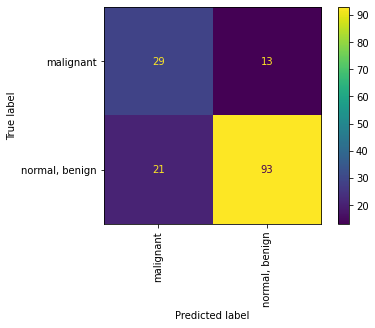

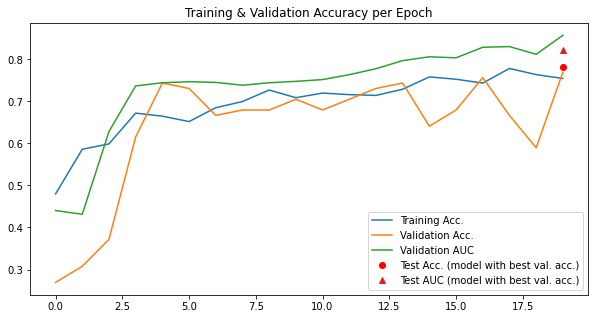

In [26]:
clf = run_classifier_pipeline(
    "breastmnist", info_flags, breastmnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### OrganAMNIST

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.89it/s]


train -- accuracy: 0.5426
val -- accuracy: 0.839,  AUC: 0.9852
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.39it/s]


train -- accuracy: 0.8162
val -- accuracy: 0.9066,  AUC: 0.9947
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.47it/s]


train -- accuracy: 0.8718
val -- accuracy: 0.919,  AUC: 0.9964
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.68it/s]


train -- accuracy: 0.9034
val -- accuracy: 0.9379,  AUC: 0.9975
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.60it/s]


train -- accuracy: 0.9173
val -- accuracy: 0.9465,  AUC: 0.9977
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.70it/s]


train -- accuracy: 0.9331
val -- accuracy: 0.9499,  AUC: 0.9981
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.79it/s]


train -- accuracy: 0.9444
val -- accuracy: 0.955,  AUC: 0.9988
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.17it/s]


train -- accuracy: 0.9512
val -- accuracy: 0.9485,  AUC: 0.9983
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.16it/s]


train -- accuracy: 0.9565
val -- accuracy: 0.9623,  AUC: 0.999
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.96it/s]


train -- accuracy: 0.9634
val -- accuracy: 0.9587,  AUC: 0.9991
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.43it/s]


train -- accuracy: 0.9665
val -- accuracy: 0.9518,  AUC: 0.999
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.29it/s]


train -- accuracy: 0.9687
val -- accuracy: 0.9542,  AUC: 0.9989
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.25it/s]


train -- accuracy: 0.974
val -- accuracy: 0.9587,  AUC: 0.999
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.16it/s]


train -- accuracy: 0.9773
val -- accuracy: 0.9629,  AUC: 0.9992
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.69it/s]


train -- accuracy: 0.9792
val -- accuracy: 0.9509,  AUC: 0.9988
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.98it/s]


train -- accuracy: 0.9795
val -- accuracy: 0.9613,  AUC: 0.9992
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 35.03it/s]


train -- accuracy: 0.9822
val -- accuracy: 0.9623,  AUC: 0.9992
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.83it/s]


train -- accuracy: 0.9846
val -- accuracy: 0.9533,  AUC: 0.9991
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 33.82it/s]


train -- accuracy: 0.9853
val -- accuracy: 0.9612,  AUC: 0.9991
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 541/541 [00:15<00:00, 34.86it/s]


train -- accuracy: 0.9853
val -- accuracy: 0.9547,  AUC: 0.999
test -- accuracy: 0.8703,  AUC: 0.9887


<Figure size 720x720 with 0 Axes>

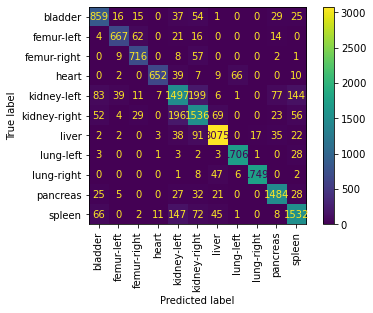

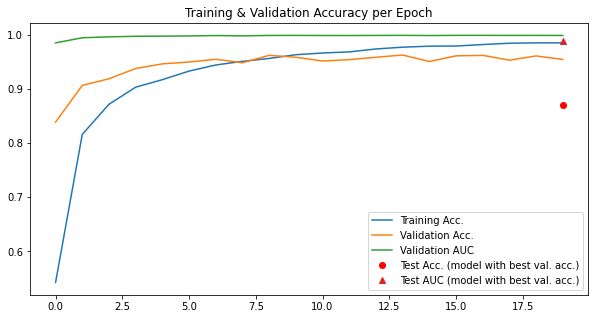

In [27]:
clf = run_classifier_pipeline(
    "organamnist", info_flags, organamnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### OrganCMNIST

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.16it/s]


train -- accuracy: 0.3578
val -- accuracy: 0.6472,  AUC: 0.9149
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.59it/s]


train -- accuracy: 0.5805
val -- accuracy: 0.8027,  AUC: 0.9786
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.62it/s]


train -- accuracy: 0.7063
val -- accuracy: 0.8637,  AUC: 0.9894
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.70it/s]


train -- accuracy: 0.7678
val -- accuracy: 0.9089,  AUC: 0.9943
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:06<00:00, 32.34it/s]


train -- accuracy: 0.8091
val -- accuracy: 0.9327,  AUC: 0.9961
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.58it/s]


train -- accuracy: 0.8244
val -- accuracy: 0.926,  AUC: 0.9949
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.82it/s]


train -- accuracy: 0.8435
val -- accuracy: 0.9051,  AUC: 0.996
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.62it/s]


train -- accuracy: 0.8646
val -- accuracy: 0.9461,  AUC: 0.9972
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.03it/s]


train -- accuracy: 0.8708
val -- accuracy: 0.9331,  AUC: 0.9966
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.82it/s]


train -- accuracy: 0.8838
val -- accuracy: 0.9402,  AUC: 0.9972
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.51it/s]


train -- accuracy: 0.8917
val -- accuracy: 0.939,  AUC: 0.9969
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.73it/s]


train -- accuracy: 0.9035
val -- accuracy: 0.9093,  AUC: 0.9958
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.91it/s]


train -- accuracy: 0.9051
val -- accuracy: 0.9344,  AUC: 0.9967
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:06<00:00, 33.09it/s]


train -- accuracy: 0.9152
val -- accuracy: 0.9515,  AUC: 0.9974
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.42it/s]


train -- accuracy: 0.9166
val -- accuracy: 0.9444,  AUC: 0.9971
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.63it/s]


train -- accuracy: 0.9255
val -- accuracy: 0.9452,  AUC: 0.9972
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 34.56it/s]


train -- accuracy: 0.931
val -- accuracy: 0.9273,  AUC: 0.9969
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.12it/s]


train -- accuracy: 0.9355
val -- accuracy: 0.9515,  AUC: 0.9974
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.61it/s]


train -- accuracy: 0.9451
val -- accuracy: 0.9448,  AUC: 0.9969
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 204/204 [00:05<00:00, 35.59it/s]


train -- accuracy: 0.9403
val -- accuracy: 0.9327,  AUC: 0.997
test -- accuracy: 0.8319,  AUC: 0.9835


<Figure size 720x720 with 0 Axes>

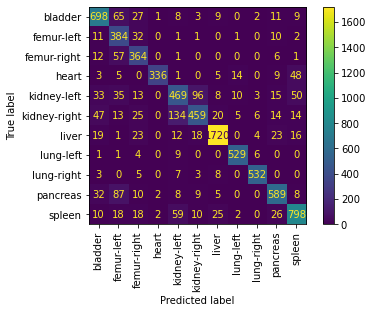

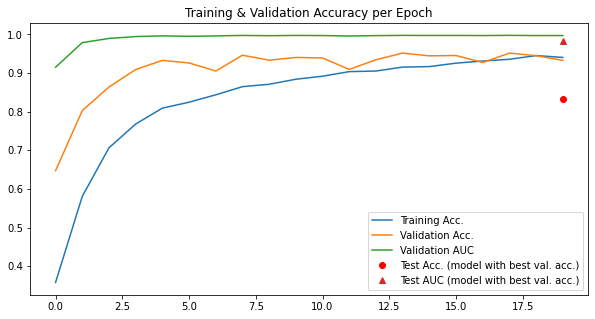

In [28]:
clf = run_classifier_pipeline(
    "organcmnist", info_flags, organcmnist_noWSR_GDA,
    DA_technique=DA_technique
)

#### OrganSMNIST

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.36it/s]


train -- accuracy: 0.2423
val -- accuracy: 0.314,  AUC: 0.8796
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.39it/s]


train -- accuracy: 0.4189
val -- accuracy: 0.544,  AUC: 0.9084
Epoch 2



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.86it/s]


train -- accuracy: 0.5119
val -- accuracy: 0.6293,  AUC: 0.9499
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.50it/s]


train -- accuracy: 0.5865
val -- accuracy: 0.6684,  AUC: 0.9657
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.83it/s]


train -- accuracy: 0.6219
val -- accuracy: 0.7202,  AUC: 0.9751
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.91it/s]


train -- accuracy: 0.6568
val -- accuracy: 0.761,  AUC: 0.9798
Epoch 6



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.04it/s]


train -- accuracy: 0.6745
val -- accuracy: 0.7508,  AUC: 0.9819
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.07it/s]


train -- accuracy: 0.7044
val -- accuracy: 0.7761,  AUC: 0.9828
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.13it/s]


train -- accuracy: 0.7196
val -- accuracy: 0.7867,  AUC: 0.9847
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.15it/s]


train -- accuracy: 0.7346
val -- accuracy: 0.7981,  AUC: 0.9853
Epoch 10



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.65it/s]


train -- accuracy: 0.7473
val -- accuracy: 0.7945,  AUC: 0.9853
Epoch 11



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 32.46it/s]


train -- accuracy: 0.7659
val -- accuracy: 0.8051,  AUC: 0.9849
Epoch 12



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.86it/s]


train -- accuracy: 0.7691
val -- accuracy: 0.8165,  AUC: 0.9866
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.21it/s]


train -- accuracy: 0.7831
val -- accuracy: 0.8124,  AUC: 0.9865
Epoch 14



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.18it/s]


train -- accuracy: 0.798
val -- accuracy: 0.8116,  AUC: 0.9857
Epoch 15



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.21it/s]


train -- accuracy: 0.8024
val -- accuracy: 0.8091,  AUC: 0.9859
Epoch 16



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 34.51it/s]


train -- accuracy: 0.8125
val -- accuracy: 0.8361,  AUC: 0.9888
Epoch 17



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.34it/s]


train -- accuracy: 0.8177
val -- accuracy: 0.8271,  AUC: 0.9884
Epoch 18



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.51it/s]


train -- accuracy: 0.8258
val -- accuracy: 0.759,  AUC: 0.9855
Epoch 19



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 218/218 [00:06<00:00, 35.62it/s]


train -- accuracy: 0.8343
val -- accuracy: 0.8132,  AUC: 0.9863
test -- accuracy: 0.6864,  AUC: 0.9542


<Figure size 720x720 with 0 Axes>

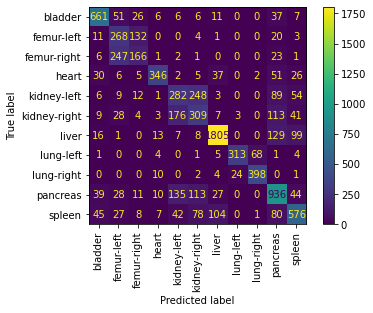

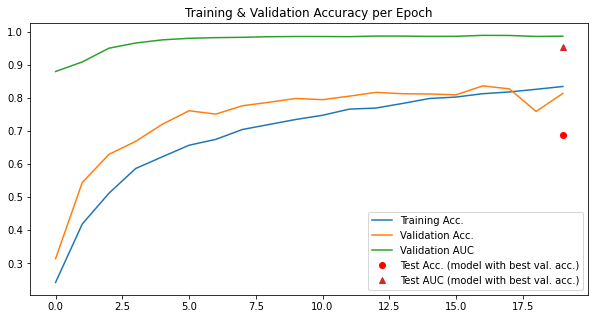

In [29]:
clf = run_classifier_pipeline(
    "organsmnist", info_flags, organsmnist_noWSR_GDA,
    DA_technique=DA_technique
)

## 4. Training a Conditional Variational Autoencoder 

We train a Conditional Variational Autoencoder for data augmentation for each of the datasets. 

For each dataset, we then retrain the underlying baseline classifier.

In [12]:
# Declares the Conditional VAE's hyperparameters
latent_dims = 150
epochs = 200

### PathMNIST

#### Training the Conditional VAE

In [31]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pathmnist"
base_dataset = pathmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 3, 28, 28])
Forward pass test:  True
{'loss': tensor(26135.4980, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(26135.4082, grad_fn=<MseLossBackward>), 'KLD': tensor(-18.0081, grad_fn=<NegBackward>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 78.56070144933416
Validation set loss: 61.878848
Train epoch 2 -- average loss: 59.140029300238865
Validation set loss: 56.053766
Train epoch 3 -- average loss: 53.67366504402149
Validation set loss: 51.036159
Train epoch 4 -- average loss: 49.50042732883397
Validation set loss: 47.898431
Train epoch 5 -- average loss: 46.96846417864882
Validation set loss: 45.04989
Train epoch 6 -- average loss: 45.331653317078846
Validation set loss: 43.465347
Train epoch 7 -- average loss: 43.57910336108254
Validation set loss: 41.993328
Train epoch 8 -- average loss: 42.32346364306187
Validation set loss: 4

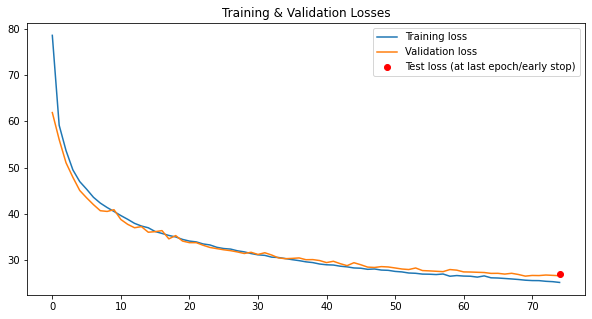

In [32]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [33]:
# Fetches the generated VAE Model model to import
model_path = f"models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 3599 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 96.21it/s]


train -- accuracy: 0.6601
val -- accuracy: 0.7696,  AUC: 0.9755
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 94.76it/s]


train -- accuracy: 0.818
val -- accuracy: 0.8171,  AUC: 0.9835
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 97.54it/s]


train -- accuracy: 0.8599
val -- accuracy: 0.8495,  AUC: 0.989
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 97.12it/s]


train -- accuracy: 0.8817
val -- accuracy: 0.8999,  AUC: 0.994
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 95.64it/s]


train -- accuracy: 0.8968
val -- accuracy: 0.8642,  AUC: 0.9918
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 93.98it/s]


train -- accuracy: 0.9078
val -- accuracy: 0.8721,  AUC: 0.9919
Epoch 6



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 96.30it/s]


train -- accuracy: 0.9176
val -- accuracy: 0.912,  AUC: 0.9953
Epoch 7



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 94.73it/s]


train -- accuracy: 0.9226
val -- accuracy: 0.9293,  AUC: 0.996
Epoch 8



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 93.44it/s]


train -- accuracy: 0.9293
val -- accuracy: 0.9329,  AUC: 0.9969
Epoch 9



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 94.17it/s]


train -- accuracy: 0.9335
val -- accuracy: 0.9283,  AUC: 0.9967
Epoch 10



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 95.00it/s]


train -- accuracy: 0.9383
val -- accuracy: 0.9352,  AUC: 0.9969
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 93.14it/s]


train -- accuracy: 0.9433
val -- accuracy: 0.9273,  AUC: 0.9966
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 92.86it/s]


train -- accuracy: 0.9446
val -- accuracy: 0.9455,  AUC: 0.9972
Epoch 13



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 94.25it/s]


train -- accuracy: 0.949
val -- accuracy: 0.9337,  AUC: 0.9971
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 93.07it/s]


train -- accuracy: 0.951
val -- accuracy: 0.9521,  AUC: 0.9978
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 94.22it/s]


train -- accuracy: 0.9536
val -- accuracy: 0.9391,  AUC: 0.9972
Epoch 16



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 93.59it/s]


train -- accuracy: 0.9574
val -- accuracy: 0.943,  AUC: 0.9974
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 92.80it/s]


train -- accuracy: 0.9586
val -- accuracy: 0.9325,  AUC: 0.9972
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 95.03it/s]


train -- accuracy: 0.9606
val -- accuracy: 0.9441,  AUC: 0.9977
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 92.13it/s]


train -- accuracy: 0.964
val -- accuracy: 0.949,  AUC: 0.9978
test -- accuracy: 0.8749,  AUC: 0.9811


<Figure size 720x720 with 0 Axes>

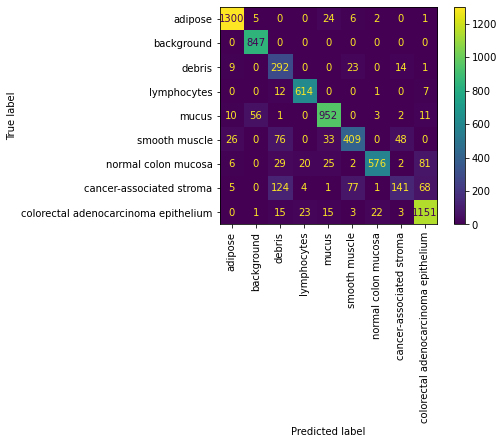

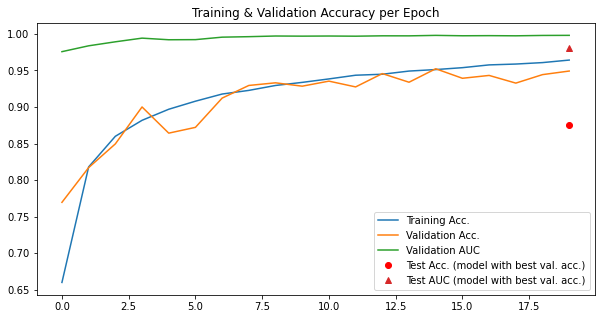

In [34]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [35]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 96.09it/s]


train -- accuracy: 0.6687
val -- accuracy: 0.7409,  AUC: 0.969
Epoch 1



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 94.01it/s]


train -- accuracy: 0.8305
val -- accuracy: 0.8315,  AUC: 0.9831
Epoch 2



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 94.80it/s]


train -- accuracy: 0.8673
val -- accuracy: 0.8624,  AUC: 0.9902
Epoch 3



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 97.95it/s]


train -- accuracy: 0.8895
val -- accuracy: 0.8987,  AUC: 0.9929
Epoch 4



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 98.14it/s]


train -- accuracy: 0.9032
val -- accuracy: 0.875,  AUC: 0.9916
Epoch 5



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 94.63it/s]


train -- accuracy: 0.9154
val -- accuracy: 0.9125,  AUC: 0.9945
Epoch 6



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 100.25it/s]


train -- accuracy: 0.9215
val -- accuracy: 0.9209,  AUC: 0.9957
Epoch 7



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 100.49it/s]


train -- accuracy: 0.9269
val -- accuracy: 0.9303,  AUC: 0.9964
Epoch 8



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 100.05it/s]


train -- accuracy: 0.9344
val -- accuracy: 0.9281,  AUC: 0.9961
Epoch 9



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 100.75it/s]


train -- accuracy: 0.938
val -- accuracy: 0.9263,  AUC: 0.9968
Epoch 10



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 100.13it/s]


train -- accuracy: 0.9432
val -- accuracy: 0.9079,  AUC: 0.9955
Epoch 11



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 99.88it/s]


train -- accuracy: 0.9451
val -- accuracy: 0.9283,  AUC: 0.9967
Epoch 12



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 96.20it/s]


train -- accuracy: 0.9501
val -- accuracy: 0.9293,  AUC: 0.9967
Epoch 13



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 100.39it/s]


train -- accuracy: 0.9541
val -- accuracy: 0.9406,  AUC: 0.9971
Epoch 14



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 98.58it/s]


train -- accuracy: 0.9563
val -- accuracy: 0.9253,  AUC: 0.9962
Epoch 15



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 99.99it/s]


train -- accuracy: 0.9591
val -- accuracy: 0.9348,  AUC: 0.9972
Epoch 16



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 100.44it/s]


train -- accuracy: 0.9612
val -- accuracy: 0.9375,  AUC: 0.9972
Epoch 17



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:14<00:00, 99.52it/s]


train -- accuracy: 0.9643
val -- accuracy: 0.9261,  AUC: 0.9958
Epoch 18



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 95.53it/s]


train -- accuracy: 0.9657
val -- accuracy: 0.9271,  AUC: 0.9962
Epoch 19



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1463/1463 [00:15<00:00, 96.92it/s]


train -- accuracy: 0.969
val -- accuracy: 0.9189,  AUC: 0.9959
test -- accuracy: 0.8616,  AUC: 0.9795


<Figure size 720x720 with 0 Axes>

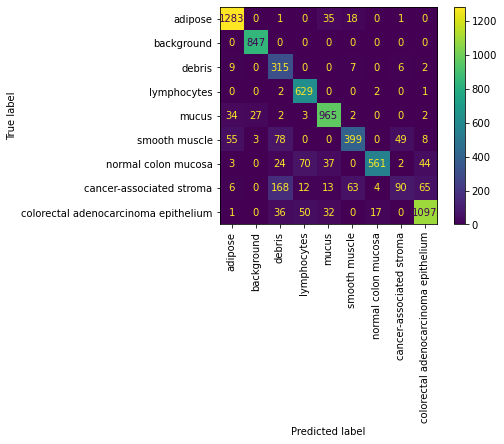

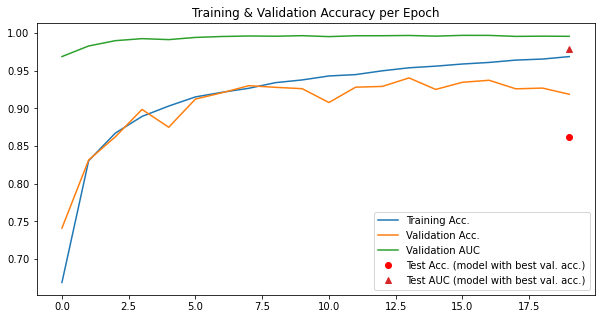

In [36]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### DermaMNIST

#### Training the Conditional VAE

In [37]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "dermamnist"
base_dataset = dermamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 3, 28, 28])
Forward pass test:  True
{'loss': tensor(27148.3770, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(27148.2793, grad_fn=<MseLossBackward>), 'KLD': tensor(-19.6918, grad_fn=<NegBackward>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 101.18495166245584
Validation set loss: 78.681531
Train epoch 2 -- average loss: 53.949758214720546
Validation set loss: 51.155228
Train epoch 3 -- average loss: 40.0898199526478
Validation set loss: 32.556334
Train epoch 4 -- average loss: 32.889547115830595
Validation set loss: 37.201974
Train epoch 5 -- average loss: 29.261201166300218
Validation set loss: 27.064115
Train epoch 6 -- average loss: 27.46072087615231
Validation set loss: 26.040958
Train epoch 7 -- average loss: 26.260258740631578
Validation set loss: 22.711276
Train epoch 8 -- average loss: 24.456448284555847
Validation set los

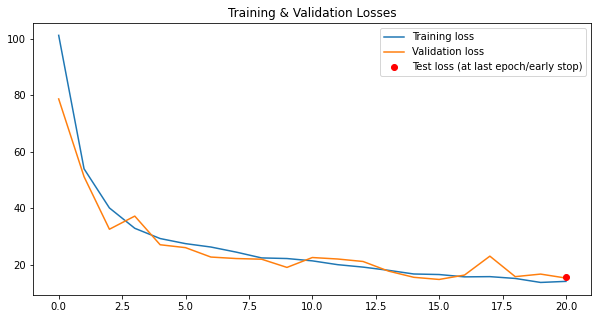

In [38]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [39]:
# Fetches the generated VAE Model model to import
model_path = f"models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 700 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 101.05it/s]


train -- accuracy: 0.5886
val -- accuracy: 0.669,  AUC: 0.8239
Epoch 1



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 99.20it/s]


train -- accuracy: 0.6279
val -- accuracy: 0.68,  AUC: 0.8616
Epoch 2



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 100.52it/s]


train -- accuracy: 0.6464
val -- accuracy: 0.6879,  AUC: 0.8746
Epoch 3



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 99.83it/s]


train -- accuracy: 0.6589
val -- accuracy: 0.6999,  AUC: 0.8746
Epoch 4



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 99.21it/s]


train -- accuracy: 0.6712
val -- accuracy: 0.7119,  AUC: 0.8876
Epoch 5



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 98.87it/s]


train -- accuracy: 0.6886
val -- accuracy: 0.7168,  AUC: 0.8781
Epoch 6



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 101.16it/s]


train -- accuracy: 0.6968
val -- accuracy: 0.7168,  AUC: 0.8853
Epoch 7



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 99.23it/s]


train -- accuracy: 0.7074
val -- accuracy: 0.7258,  AUC: 0.9011
Epoch 8



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 95.97it/s]


train -- accuracy: 0.7117
val -- accuracy: 0.7418,  AUC: 0.9018
Epoch 9



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 99.20it/s]


train -- accuracy: 0.7165
val -- accuracy: 0.7448,  AUC: 0.9055
Epoch 10



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 101.67it/s]


train -- accuracy: 0.7293
val -- accuracy: 0.7527,  AUC: 0.9087
Epoch 11



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 102.11it/s]


train -- accuracy: 0.7317
val -- accuracy: 0.7398,  AUC: 0.9088
Epoch 12



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 101.53it/s]


train -- accuracy: 0.7382
val -- accuracy: 0.7388,  AUC: 0.9075
Epoch 13



100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 97.66it/s]


train -- accuracy: 0.753
val -- accuracy: 0.7438,  AUC: 0.911
Epoch 14



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 100.79it/s]


train -- accuracy: 0.7591
val -- accuracy: 0.7428,  AUC: 0.9016
Epoch 15



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 100.49it/s]


train -- accuracy: 0.7646
val -- accuracy: 0.7318,  AUC: 0.9089
Epoch 16



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 102.43it/s]


train -- accuracy: 0.7781
val -- accuracy: 0.7348,  AUC: 0.9025
Epoch 17



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 100.29it/s]


train -- accuracy: 0.793
val -- accuracy: 0.7358,  AUC: 0.9033
Epoch 18



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 102.56it/s]


train -- accuracy: 0.7921
val -- accuracy: 0.7318,  AUC: 0.9014
Epoch 19



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 102.20it/s]


train -- accuracy: 0.8161
val -- accuracy: 0.7468,  AUC: 0.9063
test -- accuracy: 0.7471,  AUC: 0.9032


<Figure size 720x720 with 0 Axes>

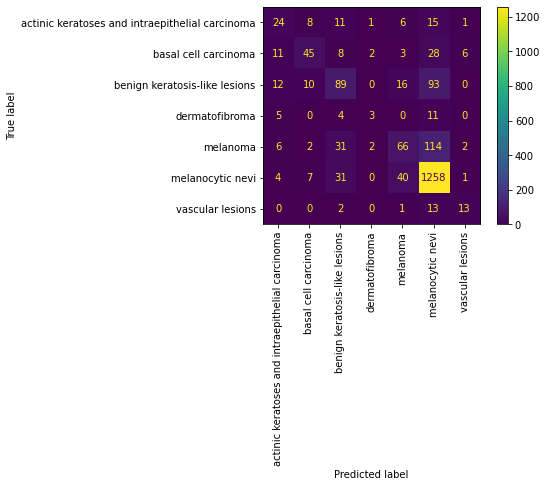

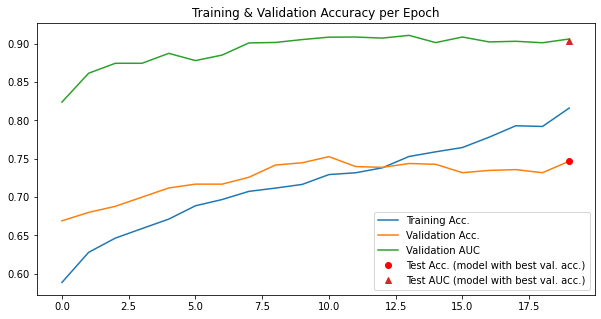

In [40]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [41]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 106.63it/s]


train -- accuracy: 0.3126
val -- accuracy: 0.5553,  AUC: 0.8497
Epoch 1



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 110.26it/s]


train -- accuracy: 0.4339
val -- accuracy: 0.5085,  AUC: 0.8663
Epoch 2



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 108.00it/s]


train -- accuracy: 0.5081
val -- accuracy: 0.5384,  AUC: 0.8781
Epoch 3



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 105.54it/s]


train -- accuracy: 0.5582
val -- accuracy: 0.6341,  AUC: 0.8925
Epoch 4



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 107.68it/s]


train -- accuracy: 0.5943
val -- accuracy: 0.5773,  AUC: 0.8924
Epoch 5



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 111.27it/s]


train -- accuracy: 0.6462
val -- accuracy: 0.4676,  AUC: 0.8576
Epoch 6



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 111.72it/s]


train -- accuracy: 0.704
val -- accuracy: 0.5623,  AUC: 0.8816
Epoch 7



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 108.09it/s]


train -- accuracy: 0.7588
val -- accuracy: 0.7218,  AUC: 0.9123
Epoch 8



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 109.91it/s]


train -- accuracy: 0.7866
val -- accuracy: 0.6152,  AUC: 0.8957
Epoch 9



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 111.45it/s]


train -- accuracy: 0.8312
val -- accuracy: 0.6371,  AUC: 0.8964
Epoch 10



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 108.60it/s]


train -- accuracy: 0.8542
val -- accuracy: 0.656,  AUC: 0.8932
Epoch 11



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 104.12it/s]


train -- accuracy: 0.87
val -- accuracy: 0.661,  AUC: 0.8933
Epoch 12



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 110.37it/s]


train -- accuracy: 0.8953
val -- accuracy: 0.6231,  AUC: 0.8823
Epoch 13



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 108.76it/s]


train -- accuracy: 0.9155
val -- accuracy: 0.7049,  AUC: 0.9004
Epoch 14



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 108.63it/s]


train -- accuracy: 0.9137
val -- accuracy: 0.7049,  AUC: 0.8908
Epoch 15



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 111.48it/s]


train -- accuracy: 0.9297
val -- accuracy: 0.6351,  AUC: 0.9008
Epoch 16



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 111.16it/s]


train -- accuracy: 0.9415
val -- accuracy: 0.6401,  AUC: 0.8874
Epoch 17



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 111.55it/s]


train -- accuracy: 0.9425
val -- accuracy: 0.6421,  AUC: 0.8731
Epoch 18



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 110.24it/s]


train -- accuracy: 0.9467
val -- accuracy: 0.669,  AUC: 0.8898
Epoch 19



100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 121/121 [00:01<00:00, 110.75it/s]


train -- accuracy: 0.9609
val -- accuracy: 0.7198,  AUC: 0.9041
test -- accuracy: 0.7302,  AUC: 0.9021


<Figure size 720x720 with 0 Axes>

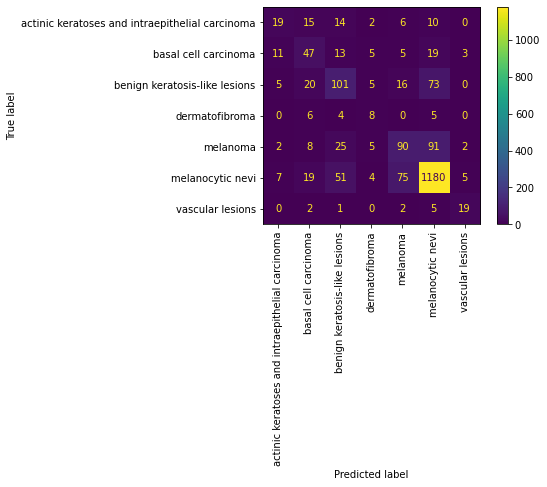

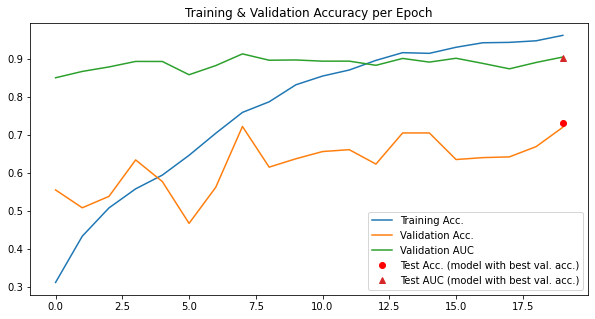

In [42]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### OctMNIST

#### Training the Conditional VAE

In [43]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "octmnist"
base_dataset = octmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(8955.3066, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8955.2139, grad_fn=<MseLossBackward>), 'KLD': tensor(-18.5677, grad_fn=<NegBackward>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 17.312155423773444
Validation set loss: 6.726041
Train epoch 2 -- average loss: 7.049885920354529
Validation set loss: 5.928398
Train epoch 3 -- average loss: 5.288755593855133
Validation set loss: 4.049714
Train epoch 4 -- average loss: 4.493984811109863
Validation set loss: 3.492971
Train epoch 5 -- average loss: 3.8335832454374152
Validation set loss: 3.409915
Train epoch 6 -- average loss: 3.4971819283105527
Validation set loss: 2.868931
Train epoch 7 -- average loss: 3.2083501123607405
Validation set loss: 3.090886
Train epoch 8 -- average loss: 2.9625996051827737
Validation set loss: 2.5536

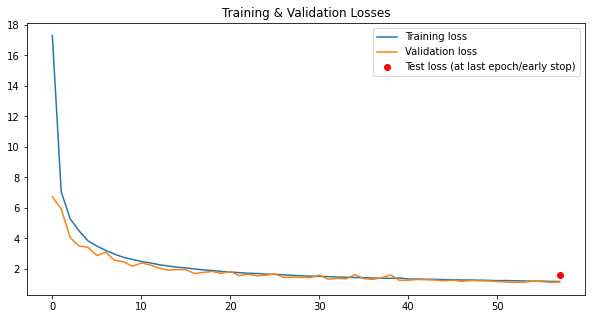

In [44]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [45]:
# Fetches the generated VAE Model model to import
model_path = f"models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 3899 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:15<00:00, 104.57it/s]


train -- accuracy: 0.7823
val -- accuracy: 0.8345,  AUC: 0.9154
Epoch 1



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 107.45it/s]


train -- accuracy: 0.8458
val -- accuracy: 0.8617,  AUC: 0.9487
Epoch 2



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 110.98it/s]


train -- accuracy: 0.8672
val -- accuracy: 0.878,  AUC: 0.9527
Epoch 3



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.74it/s]


train -- accuracy: 0.8803
val -- accuracy: 0.8816,  AUC: 0.9578
Epoch 4



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 112.29it/s]


train -- accuracy: 0.8893
val -- accuracy: 0.8697,  AUC: 0.9605
Epoch 5



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 112.43it/s]


train -- accuracy: 0.8975
val -- accuracy: 0.8963,  AUC: 0.9643
Epoch 6



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.89it/s]


train -- accuracy: 0.9049
val -- accuracy: 0.8811,  AUC: 0.9596
Epoch 7



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 112.16it/s]


train -- accuracy: 0.9121
val -- accuracy: 0.8913,  AUC: 0.9643
Epoch 8



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 108.03it/s]


train -- accuracy: 0.9179
val -- accuracy: 0.9025,  AUC: 0.968
Epoch 9



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.67it/s]


train -- accuracy: 0.9223
val -- accuracy: 0.9002,  AUC: 0.9661
Epoch 10



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.82it/s]


train -- accuracy: 0.9276
val -- accuracy: 0.8988,  AUC: 0.968
Epoch 11



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.40it/s]


train -- accuracy: 0.9314
val -- accuracy: 0.9065,  AUC: 0.9702
Epoch 12



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 112.10it/s]


train -- accuracy: 0.9355
val -- accuracy: 0.9078,  AUC: 0.9695
Epoch 13



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 112.01it/s]


train -- accuracy: 0.9404
val -- accuracy: 0.9089,  AUC: 0.9696
Epoch 14



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.79it/s]


train -- accuracy: 0.9436
val -- accuracy: 0.9071,  AUC: 0.9689
Epoch 15



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 112.16it/s]


train -- accuracy: 0.9482
val -- accuracy: 0.9052,  AUC: 0.9705
Epoch 16



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.93it/s]


train -- accuracy: 0.9506
val -- accuracy: 0.9125,  AUC: 0.9691
Epoch 17



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.94it/s]


train -- accuracy: 0.9538
val -- accuracy: 0.9134,  AUC: 0.9704
Epoch 18



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 109.09it/s]


train -- accuracy: 0.9562
val -- accuracy: 0.9135,  AUC: 0.9693
Epoch 19



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 110.39it/s]


train -- accuracy: 0.9583
val -- accuracy: 0.9084,  AUC: 0.9705
test -- accuracy: 0.725,  AUC: 0.9353


<Figure size 720x720 with 0 Axes>

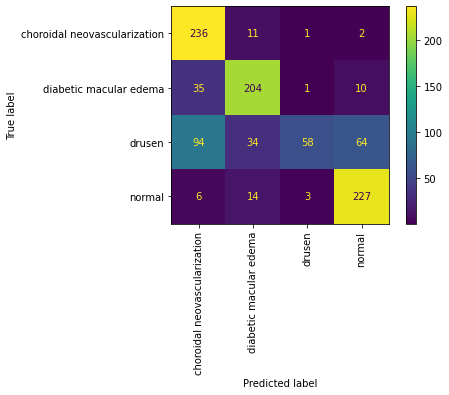

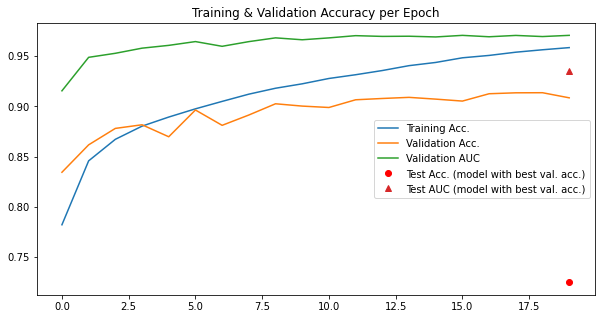

In [46]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [47]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 109.68it/s]


train -- accuracy: 0.6832
val -- accuracy: 0.7371,  AUC: 0.9308
Epoch 1



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.71it/s]


train -- accuracy: 0.8028
val -- accuracy: 0.8506,  AUC: 0.9576
Epoch 2



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 113.01it/s]


train -- accuracy: 0.8383
val -- accuracy: 0.874,  AUC: 0.9634
Epoch 3



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.98it/s]


train -- accuracy: 0.8642
val -- accuracy: 0.8793,  AUC: 0.9617
Epoch 4



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 112.86it/s]


train -- accuracy: 0.8796
val -- accuracy: 0.7618,  AUC: 0.9599
Epoch 5



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 112.89it/s]


train -- accuracy: 0.896
val -- accuracy: 0.8429,  AUC: 0.9611
Epoch 6



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 112.55it/s]


train -- accuracy: 0.9066
val -- accuracy: 0.8712,  AUC: 0.9672
Epoch 7



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:15<00:00, 104.11it/s]


train -- accuracy: 0.9181
val -- accuracy: 0.875,  AUC: 0.9644
Epoch 8



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 106.03it/s]


train -- accuracy: 0.9267
val -- accuracy: 0.8803,  AUC: 0.9628
Epoch 9



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 107.12it/s]


train -- accuracy: 0.9345
val -- accuracy: 0.8978,  AUC: 0.9675
Epoch 10



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 107.17it/s]


train -- accuracy: 0.9428
val -- accuracy: 0.8669,  AUC: 0.9641
Epoch 11



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 107.51it/s]


train -- accuracy: 0.9471
val -- accuracy: 0.883,  AUC: 0.9633
Epoch 12



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 111.60it/s]


train -- accuracy: 0.9498
val -- accuracy: 0.8958,  AUC: 0.9654
Epoch 13



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 109.94it/s]


train -- accuracy: 0.9558
val -- accuracy: 0.8714,  AUC: 0.9665
Epoch 14



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 109.85it/s]


train -- accuracy: 0.9597
val -- accuracy: 0.8793,  AUC: 0.9656
Epoch 15



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 113.04it/s]


train -- accuracy: 0.9616
val -- accuracy: 0.8624,  AUC: 0.9634
Epoch 16



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 108.59it/s]


train -- accuracy: 0.9648
val -- accuracy: 0.8936,  AUC: 0.9642
Epoch 17



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 108.33it/s]


train -- accuracy: 0.9675
val -- accuracy: 0.8993,  AUC: 0.9668
Epoch 18



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 110.87it/s]


train -- accuracy: 0.9708
val -- accuracy: 0.9002,  AUC: 0.9656
Epoch 19



100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1584/1584 [00:14<00:00, 106.74it/s]


train -- accuracy: 0.974
val -- accuracy: 0.8981,  AUC: 0.9666
test -- accuracy: 0.741,  AUC: 0.9199


<Figure size 720x720 with 0 Axes>

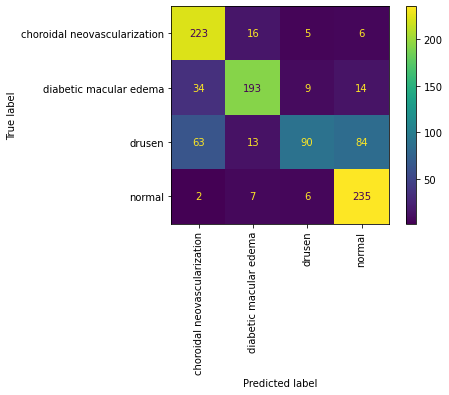

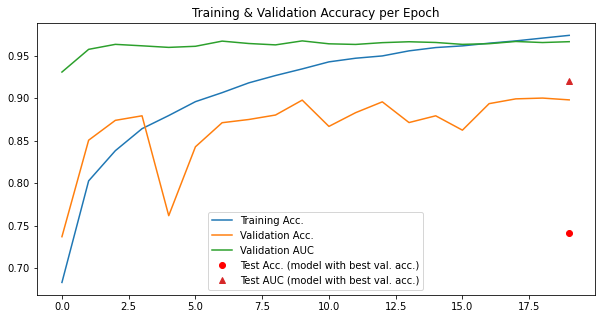

In [48]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### PneumoniaMNIST

#### Training the Conditional VAE

In [13]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pneumoniamnist"
base_dataset = pneumoniamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(8597.0596, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8596.9629, grad_fn=<MseLossBackward>), 'KLD': tensor(-19.4253, grad_fn=<NegBackward>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 45.943598848535736
Validation set loss: 34.409689
Train epoch 2 -- average loss: 29.26584052877499
Validation set loss: 22.719185
Train epoch 3 -- average loss: 22.047216605005776
Validation set loss: 16.852601
Train epoch 4 -- average loss: 15.452789189963394
Validation set loss: 12.346047
Train epoch 5 -- average loss: 12.515995968775721
Validation set loss: 10.982889
Train epoch 6 -- average loss: 11.064259213923192
Validation set loss: 8.945304
Train epoch 7 -- average loss: 9.23635776101682
Validation set loss: 9.146536
Train epoch 8 -- average loss: 8.721736755630376
Validation set loss: 7.

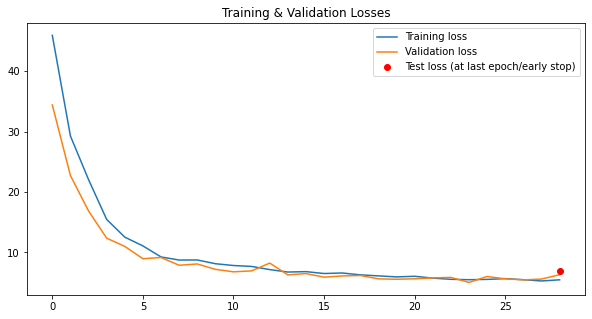

In [14]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [15]:
# Fetches the generated VAE Model model to import
model_path = f"models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 470 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 108.79it/s]


train -- accuracy: 0.8594
val -- accuracy: 0.9122,  AUC: 0.9807
Epoch 1



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 107.83it/s]


train -- accuracy: 0.9477
val -- accuracy: 0.9561,  AUC: 0.9913
Epoch 2



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 113.82it/s]


train -- accuracy: 0.9608
val -- accuracy: 0.9618,  AUC: 0.994
Epoch 3



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 116.01it/s]


train -- accuracy: 0.9658
val -- accuracy: 0.9618,  AUC: 0.9942
Epoch 4



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 121.01it/s]


train -- accuracy: 0.9706
val -- accuracy: 0.9523,  AUC: 0.9954
Epoch 5



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 110.18it/s]


train -- accuracy: 0.9774
val -- accuracy: 0.958,  AUC: 0.9956
Epoch 6



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 112.45it/s]


train -- accuracy: 0.9784
val -- accuracy: 0.9695,  AUC: 0.9954
Epoch 7



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.46it/s]


train -- accuracy: 0.9805
val -- accuracy: 0.9695,  AUC: 0.9965
Epoch 8



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.53it/s]


train -- accuracy: 0.9874
val -- accuracy: 0.9695,  AUC: 0.9958
Epoch 9



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.26it/s]


train -- accuracy: 0.9873
val -- accuracy: 0.9714,  AUC: 0.9957
Epoch 10



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.80it/s]


train -- accuracy: 0.9927
val -- accuracy: 0.9656,  AUC: 0.9964
Epoch 11



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 119.89it/s]


train -- accuracy: 0.9954
val -- accuracy: 0.9618,  AUC: 0.9959
Epoch 12



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.48it/s]


train -- accuracy: 0.9965
val -- accuracy: 0.9733,  AUC: 0.9963
Epoch 13



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.27it/s]


train -- accuracy: 0.9985
val -- accuracy: 0.9771,  AUC: 0.9963
Epoch 14



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.25it/s]


train -- accuracy: 0.9986
val -- accuracy: 0.9733,  AUC: 0.9962
Epoch 15



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 116.54it/s]


train -- accuracy: 0.9994
val -- accuracy: 0.9733,  AUC: 0.9963
Epoch 16



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 119.70it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9733,  AUC: 0.9967
Epoch 17



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 120.06it/s]


train -- accuracy: 0.9996
val -- accuracy: 0.9733,  AUC: 0.9964
Epoch 18



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 119.28it/s]


train -- accuracy: 0.9994
val -- accuracy: 0.9733,  AUC: 0.9965
Epoch 19



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 120.33it/s]


train -- accuracy: 0.9996
val -- accuracy: 0.9714,  AUC: 0.9961
test -- accuracy: 0.8638,  AUC: 0.9681


<Figure size 720x720 with 0 Axes>

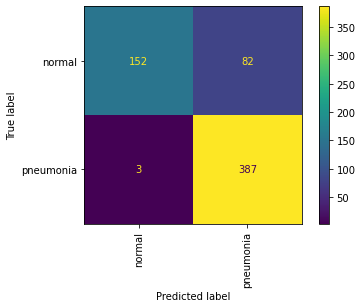

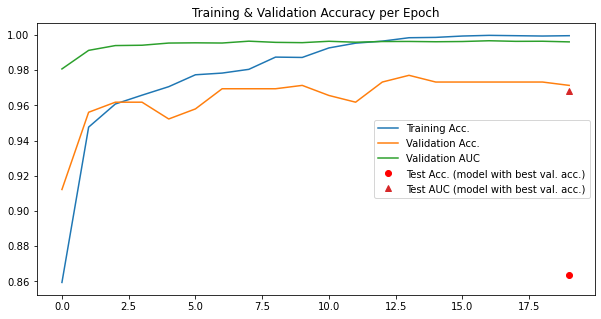

In [16]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [17]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.93it/s]


train -- accuracy: 0.7978
val -- accuracy: 0.9198,  AUC: 0.9756
Epoch 1



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.28it/s]


train -- accuracy: 0.9378
val -- accuracy: 0.9504,  AUC: 0.9883
Epoch 2



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.85it/s]


train -- accuracy: 0.9504
val -- accuracy: 0.958,  AUC: 0.9932
Epoch 3



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 119.38it/s]


train -- accuracy: 0.962
val -- accuracy: 0.9141,  AUC: 0.9949
Epoch 4



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.65it/s]


train -- accuracy: 0.9726
val -- accuracy: 0.9618,  AUC: 0.9964
Epoch 5



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.66it/s]


train -- accuracy: 0.9757
val -- accuracy: 0.9733,  AUC: 0.9967
Epoch 6



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 119.22it/s]


train -- accuracy: 0.9815
val -- accuracy: 0.9637,  AUC: 0.9979
Epoch 7



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 119.30it/s]


train -- accuracy: 0.9867
val -- accuracy: 0.9752,  AUC: 0.9965
Epoch 8



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 120.27it/s]


train -- accuracy: 0.9898
val -- accuracy: 0.9752,  AUC: 0.9975
Epoch 9



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.68it/s]


train -- accuracy: 0.9938
val -- accuracy: 0.9809,  AUC: 0.9977
Epoch 10



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.06it/s]


train -- accuracy: 0.9946
val -- accuracy: 0.9771,  AUC: 0.9976
Epoch 11



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 116.07it/s]


train -- accuracy: 0.9975
val -- accuracy: 0.9695,  AUC: 0.9974
Epoch 12



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.20it/s]


train -- accuracy: 0.9979
val -- accuracy: 0.9752,  AUC: 0.9974
Epoch 13



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.05it/s]


train -- accuracy: 0.9981
val -- accuracy: 0.9752,  AUC: 0.9967
Epoch 14



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 115.21it/s]


train -- accuracy: 0.9983
val -- accuracy: 0.9771,  AUC: 0.9968
Epoch 15



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 114.01it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.979,  AUC: 0.9974
Epoch 16



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 109.14it/s]


train -- accuracy: 0.9994
val -- accuracy: 0.979,  AUC: 0.9969
Epoch 17



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 113.20it/s]


train -- accuracy: 1.0
val -- accuracy: 0.9714,  AUC: 0.9972
Epoch 18



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 111.48it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9752,  AUC: 0.9973
Epoch 19



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 113.86it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9771,  AUC: 0.9971
test -- accuracy: 0.8478,  AUC: 0.953


<Figure size 720x720 with 0 Axes>

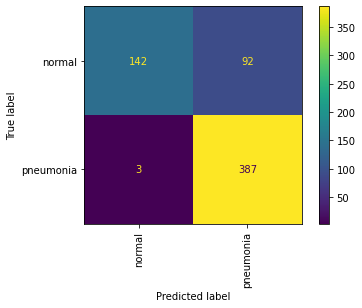

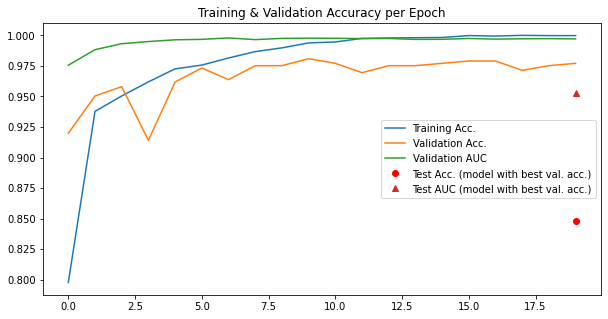

In [18]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### BreastMNIST

#### Training the Conditional VAE

In [19]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "breastmnist"
base_dataset = breastmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(8785.6611, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8785.5645, grad_fn=<MseLossBackward>), 'KLD': tensor(-19.2531, grad_fn=<NegBackward>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 127.57177331945398
Validation set loss: 156.100996
Train epoch 2 -- average loss: 78.90787357987065
Validation set loss: 125.610924
Train epoch 3 -- average loss: 74.50848902887478
Validation set loss: 91.992277
Train epoch 4 -- average loss: 78.54026174021291
Validation set loss: 77.676777
Train epoch 5 -- average loss: 74.73017184638279
Validation set loss: 76.401391
Train epoch 6 -- average loss: 75.25891783997253
Validation set loss: 77.975302
Train epoch 7 -- average loss: 78.76103819682922
Validation set loss: 80.918691
Train epoch 8 -- average loss: 72.85543387276786
Validation set loss: 7

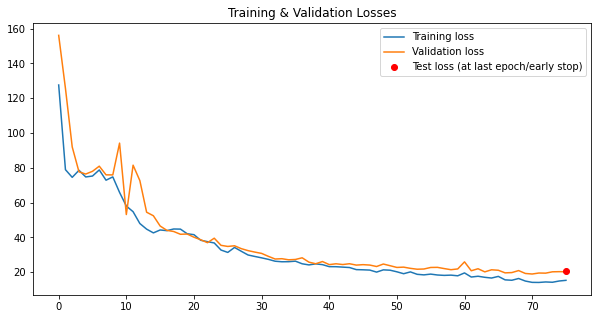

In [20]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [21]:
# Fetches the generated VAE Model model to import
model_path = f"models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 54 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.53it/s]


train -- accuracy: 0.3567
val -- accuracy: 0.2692,  AUC: 0.4478
Epoch 1



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 124.49it/s]

train -- accuracy: 0.7417


val -- accuracy: 0.7308,  AUC: 0.6533
Epoch 2



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 124.05it/s]


train -- accuracy: 0.7417
val -- accuracy: 0.7308,  AUC: 0.7419
Epoch 3



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 124.25it/s]


train -- accuracy: 0.7417
val -- accuracy: 0.7308,  AUC: 0.731
Epoch 4



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.48it/s]


train -- accuracy: 0.7417
val -- accuracy: 0.7308,  AUC: 0.7544
Epoch 5



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.25it/s]


train -- accuracy: 0.7417
val -- accuracy: 0.7308,  AUC: 0.7536
Epoch 6



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.89it/s]


train -- accuracy: 0.7417
val -- accuracy: 0.7308,  AUC: 0.7652
Epoch 7



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.60it/s]


train -- accuracy: 0.7417
val -- accuracy: 0.7308,  AUC: 0.7753
Epoch 8



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.70it/s]


train -- accuracy: 0.7433
val -- accuracy: 0.7308,  AUC: 0.7861
Epoch 9



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 123.03it/s]


train -- accuracy: 0.7617
val -- accuracy: 0.7308,  AUC: 0.7937
Epoch 10



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 123.11it/s]


train -- accuracy: 0.7717
val -- accuracy: 0.7564,  AUC: 0.8062
Epoch 11



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 124.01it/s]


train -- accuracy: 0.7817
val -- accuracy: 0.7949,  AUC: 0.8112
Epoch 12



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 123.52it/s]


train -- accuracy: 0.8
val -- accuracy: 0.7821,  AUC: 0.8237
Epoch 13



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 123.88it/s]


train -- accuracy: 0.8183
val -- accuracy: 0.7949,  AUC: 0.8371
Epoch 14



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.32it/s]


train -- accuracy: 0.8417
val -- accuracy: 0.8077,  AUC: 0.848
Epoch 15



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.77it/s]


train -- accuracy: 0.8467
val -- accuracy: 0.8333,  AUC: 0.853
Epoch 16



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.70it/s]


train -- accuracy: 0.8833
val -- accuracy: 0.8846,  AUC: 0.8571
Epoch 17



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 123.25it/s]


train -- accuracy: 0.8583
val -- accuracy: 0.8333,  AUC: 0.8655
Epoch 18



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 123.19it/s]


train -- accuracy: 0.8933
val -- accuracy: 0.8846,  AUC: 0.8672
Epoch 19



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.98it/s]


train -- accuracy: 0.905
val -- accuracy: 0.8974,  AUC: 0.8697
test -- accuracy: 0.7885,  AUC: 0.8749


<Figure size 720x720 with 0 Axes>

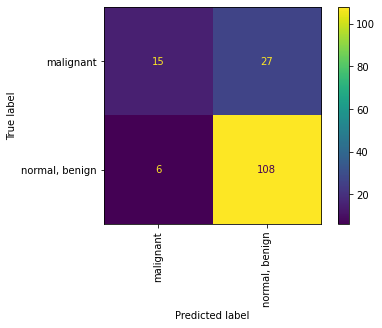

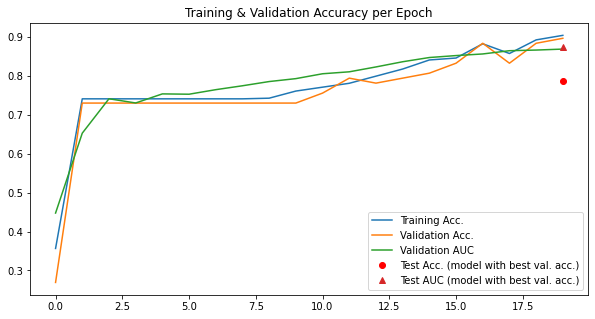

In [22]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [23]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 120.94it/s]


train -- accuracy: 0.4733
val -- accuracy: 0.7051,  AUC: 0.3567
Epoch 1



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 123.09it/s]

train -- accuracy: 0.545


val -- accuracy: 0.5769,  AUC: 0.5113
Epoch 2



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 123.16it/s]


train -- accuracy: 0.71
val -- accuracy: 0.6795,  AUC: 0.7335
Epoch 3



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.61it/s]

train -- accuracy: 0.7233


val -- accuracy: 0.7308,  AUC: 0.7761
Epoch 4



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.09it/s]


train -- accuracy: 0.755
val -- accuracy: 0.6795,  AUC: 0.7753
Epoch 5



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 123.07it/s]

train -- accuracy: 0.7417


val -- accuracy: 0.7179,  AUC: 0.7736
Epoch 6



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 120.81it/s]


train -- accuracy: 0.7367
val -- accuracy: 0.7436,  AUC: 0.7845
Epoch 7



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.47it/s]

train -- accuracy: 0.7217


val -- accuracy: 0.7308,  AUC: 0.7987
Epoch 8



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.80it/s]


train -- accuracy: 0.7583
val -- accuracy: 0.7564,  AUC: 0.8104
Epoch 9



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.02it/s]

train -- accuracy: 0.7633


val -- accuracy: 0.7692,  AUC: 0.8104
Epoch 10



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.59it/s]


train -- accuracy: 0.79
val -- accuracy: 0.7564,  AUC: 0.8145
Epoch 11



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.67it/s]

train -- accuracy: 0.7867


val -- accuracy: 0.7692,  AUC: 0.8279
Epoch 12



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.36it/s]


train -- accuracy: 0.7917
val -- accuracy: 0.7821,  AUC: 0.8379
Epoch 13



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.77it/s]

train -- accuracy: 0.8083


val -- accuracy: 0.7821,  AUC: 0.8354
Epoch 14



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 120.13it/s]


train -- accuracy: 0.8333
val -- accuracy: 0.8205,  AUC: 0.8588
Epoch 15



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.50it/s]

train -- accuracy: 0.8633


val -- accuracy: 0.8077,  AUC: 0.848
Epoch 16



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.62it/s]


train -- accuracy: 0.8917
val -- accuracy: 0.7821,  AUC: 0.8897
Epoch 17



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.30it/s]

train -- accuracy: 0.9183


val -- accuracy: 0.8205,  AUC: 0.8772
Epoch 18



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.53it/s]


train -- accuracy: 0.93
val -- accuracy: 0.8077,  AUC: 0.8772
Epoch 19



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.70it/s]

train -- accuracy: 0.9417


val -- accuracy: 0.8462,  AUC: 0.8772
test -- accuracy: 0.8269,  AUC: 0.8569


<Figure size 720x720 with 0 Axes>

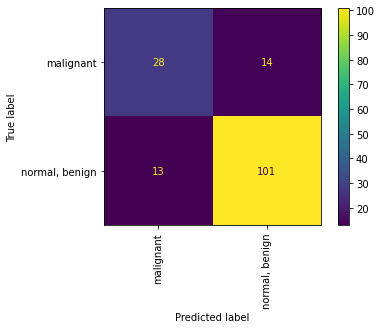

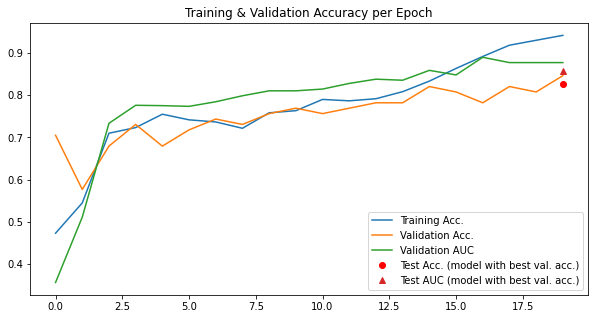

In [24]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### OrganaMNIST

#### Training the Conditional VAE

In [25]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organamnist"
base_dataset = organamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(8645.7256, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8645.6309, grad_fn=<MseLossBackward>), 'KLD': tensor(-18.8771, grad_fn=<NegBackward>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 104.64963996370726
Validation set loss: 84.015754
Train epoch 2 -- average loss: 68.54333410668183
Validation set loss: 75.916622
Train epoch 3 -- average loss: 58.46796272926245
Validation set loss: 67.29154
Train epoch 4 -- average loss: 53.8591451911025
Validation set loss: 65.336915
Train epoch 5 -- average loss: 50.15259788753443
Validation set loss: 63.536702
Train epoch 6 -- average loss: 47.384368194900425
Validation set loss: 62.538457
Train epoch 7 -- average loss: 45.297034332804
Validation set loss: 64.854653
Train epoch 8 -- average loss: 43.883771957971526
Validation set loss: 60.96

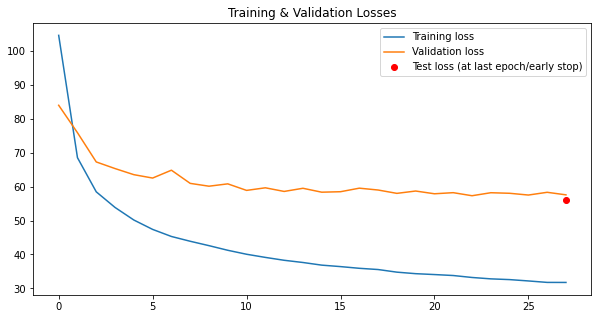

In [26]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [27]:
# Fetches the generated VAE Model model to import
model_path = f"models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 5
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1729 (5% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.65it/s]


train -- accuracy: 0.5647
val -- accuracy: 0.8701,  AUC: 0.9953
Epoch 1



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.76it/s]


train -- accuracy: 0.8506
val -- accuracy: 0.9277,  AUC: 0.9978
Epoch 2



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.32it/s]


train -- accuracy: 0.9133
val -- accuracy: 0.9559,  AUC: 0.9988
Epoch 3



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.98it/s]


train -- accuracy: 0.9418
val -- accuracy: 0.9609,  AUC: 0.9993
Epoch 4



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.74it/s]


train -- accuracy: 0.9565
val -- accuracy: 0.9606,  AUC: 0.9992
Epoch 5



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.71it/s]


train -- accuracy: 0.9689
val -- accuracy: 0.9613,  AUC: 0.9994
Epoch 6



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.95it/s]


train -- accuracy: 0.9769
val -- accuracy: 0.9635,  AUC: 0.9993
Epoch 7



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.11it/s]


train -- accuracy: 0.9826
val -- accuracy: 0.966,  AUC: 0.9996
Epoch 8



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.03it/s]


train -- accuracy: 0.9874
val -- accuracy: 0.9683,  AUC: 0.9996
Epoch 9



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.50it/s]


train -- accuracy: 0.9899
val -- accuracy: 0.9675,  AUC: 0.9996
Epoch 10



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.33it/s]


train -- accuracy: 0.9931
val -- accuracy: 0.9658,  AUC: 0.9996
Epoch 11



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.56it/s]


train -- accuracy: 0.9939
val -- accuracy: 0.9689,  AUC: 0.9996
Epoch 12



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.31it/s]


train -- accuracy: 0.9952
val -- accuracy: 0.9747,  AUC: 0.9997
Epoch 13



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 118.87it/s]


train -- accuracy: 0.9962
val -- accuracy: 0.9707,  AUC: 0.9997
Epoch 14



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.71it/s]


train -- accuracy: 0.997
val -- accuracy: 0.9743,  AUC: 0.9998
Epoch 15



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.26it/s]


train -- accuracy: 0.9974
val -- accuracy: 0.9715,  AUC: 0.9997
Epoch 16



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.95it/s]


train -- accuracy: 0.9979
val -- accuracy: 0.9681,  AUC: 0.9996
Epoch 17



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.49it/s]


train -- accuracy: 0.9984
val -- accuracy: 0.9709,  AUC: 0.9997
Epoch 18



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.18it/s]


train -- accuracy: 0.9986
val -- accuracy: 0.973,  AUC: 0.9997
Epoch 19



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.35it/s]


train -- accuracy: 0.9984
val -- accuracy: 0.9695,  AUC: 0.9995
test -- accuracy: 0.8787,  AUC: 0.99


<Figure size 720x720 with 0 Axes>

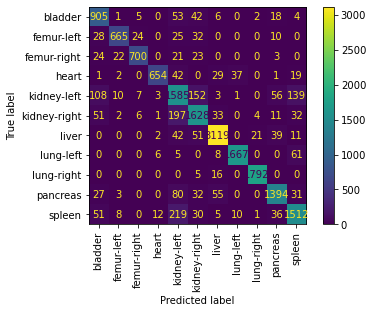

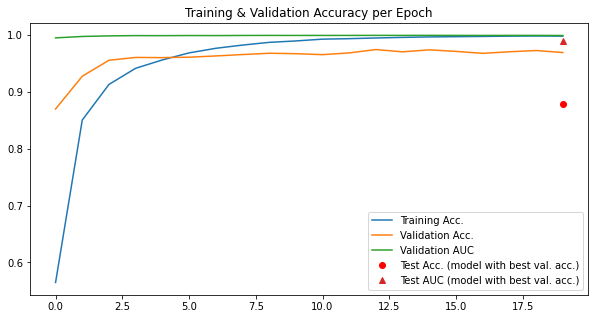

In [28]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [29]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.98it/s]


train -- accuracy: 0.5836
val -- accuracy: 0.9065,  AUC: 0.9948
Epoch 1



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.39it/s]


train -- accuracy: 0.8647
val -- accuracy: 0.949,  AUC: 0.9983
Epoch 2



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.12it/s]


train -- accuracy: 0.921
val -- accuracy: 0.9596,  AUC: 0.9989
Epoch 3



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.81it/s]


train -- accuracy: 0.9476
val -- accuracy: 0.965,  AUC: 0.9993
Epoch 4



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.94it/s]


train -- accuracy: 0.9634
val -- accuracy: 0.9596,  AUC: 0.9991
Epoch 5



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.33it/s]


train -- accuracy: 0.972
val -- accuracy: 0.9606,  AUC: 0.999
Epoch 6



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.16it/s]


train -- accuracy: 0.9775
val -- accuracy: 0.9666,  AUC: 0.9992
Epoch 7



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.12it/s]


train -- accuracy: 0.9824
val -- accuracy: 0.9629,  AUC: 0.9993
Epoch 8



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.37it/s]


train -- accuracy: 0.9862
val -- accuracy: 0.9698,  AUC: 0.9994
Epoch 9



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.89it/s]


train -- accuracy: 0.9887
val -- accuracy: 0.9681,  AUC: 0.9995
Epoch 10



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.89it/s]


train -- accuracy: 0.9909
val -- accuracy: 0.9712,  AUC: 0.9994
Epoch 11



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.45it/s]


train -- accuracy: 0.9937
val -- accuracy: 0.9712,  AUC: 0.9995
Epoch 12



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 119.52it/s]


train -- accuracy: 0.9939
val -- accuracy: 0.9713,  AUC: 0.9996
Epoch 13



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.36it/s]


train -- accuracy: 0.995
val -- accuracy: 0.9721,  AUC: 0.9995
Epoch 14



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.40it/s]


train -- accuracy: 0.9952
val -- accuracy: 0.9695,  AUC: 0.9994
Epoch 15



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.33it/s]


train -- accuracy: 0.9968
val -- accuracy: 0.9715,  AUC: 0.9996
Epoch 16



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 121.14it/s]


train -- accuracy: 0.9972
val -- accuracy: 0.971,  AUC: 0.9995
Epoch 17



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.14it/s]


train -- accuracy: 0.9976
val -- accuracy: 0.9713,  AUC: 0.9996
Epoch 18



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.13it/s]


train -- accuracy: 0.9968
val -- accuracy: 0.9709,  AUC: 0.9994
Epoch 19



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 120.20it/s]


train -- accuracy: 0.998
val -- accuracy: 0.9724,  AUC: 0.9996
test -- accuracy: 0.8857,  AUC: 0.9915


<Figure size 720x720 with 0 Axes>

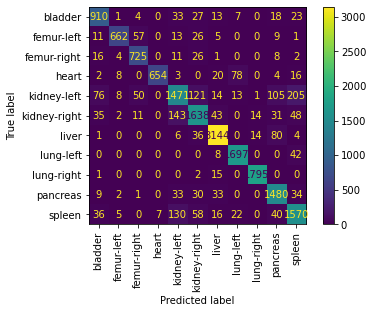

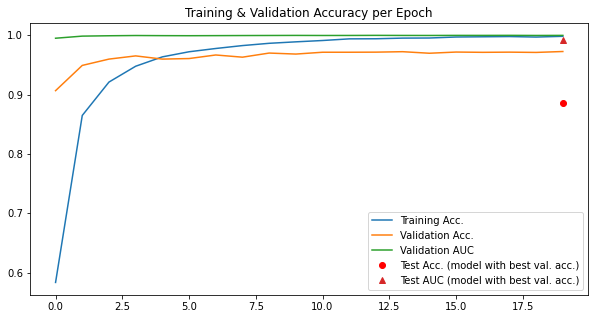

In [30]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### OrgancMNIST

#### Training the Conditional VAE

In [31]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organcmnist"
base_dataset = organcmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(8723.3154, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8723.2236, grad_fn=<MseLossBackward>), 'KLD': tensor(-18.3969, grad_fn=<NegBackward>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 130.05508298903246
Validation set loss: 102.097575
Train epoch 2 -- average loss: 85.40558463228666
Validation set loss: 85.695473
Train epoch 3 -- average loss: 73.91890244234526
Validation set loss: 79.184981
Train epoch 4 -- average loss: 67.28785974121094
Validation set loss: 71.636755
Train epoch 5 -- average loss: 62.465029864971456
Validation set loss: 68.650253
Train epoch 6 -- average loss: 59.18352190223107
Validation set loss: 66.29277
Train epoch 7 -- average loss: 56.392809955303484
Validation set loss: 65.10446
Train epoch 8 -- average loss: 54.85188520695613
Validation set loss: 64

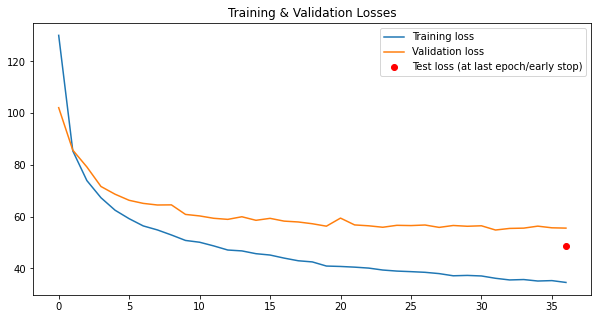

In [32]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [33]:
# Fetches the generated VAE Model model to import
model_path = f"models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1300 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.57it/s]


train -- accuracy: 0.378
val -- accuracy: 0.6589,  AUC: 0.9574
Epoch 1



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.25it/s]


train -- accuracy: 0.6555
val -- accuracy: 0.8491,  AUC: 0.9917
Epoch 2



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.42it/s]


train -- accuracy: 0.7733
val -- accuracy: 0.9118,  AUC: 0.9952
Epoch 3



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.62it/s]


train -- accuracy: 0.8234
val -- accuracy: 0.921,  AUC: 0.9976
Epoch 4



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 121.62it/s]


train -- accuracy: 0.8478
val -- accuracy: 0.9281,  AUC: 0.9976
Epoch 5



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.07it/s]


train -- accuracy: 0.8736
val -- accuracy: 0.9243,  AUC: 0.998
Epoch 6



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.10it/s]


train -- accuracy: 0.8911
val -- accuracy: 0.9381,  AUC: 0.9982
Epoch 7



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.17it/s]


train -- accuracy: 0.9005
val -- accuracy: 0.9511,  AUC: 0.9987
Epoch 8



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.36it/s]


train -- accuracy: 0.9135
val -- accuracy: 0.9461,  AUC: 0.9986
Epoch 9



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.12it/s]


train -- accuracy: 0.9257
val -- accuracy: 0.9528,  AUC: 0.9989
Epoch 10



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.01it/s]


train -- accuracy: 0.9369
val -- accuracy: 0.9511,  AUC: 0.9984
Epoch 11



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.73it/s]


train -- accuracy: 0.9438
val -- accuracy: 0.954,  AUC: 0.999
Epoch 12



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.87it/s]


train -- accuracy: 0.9553
val -- accuracy: 0.9486,  AUC: 0.9986
Epoch 13



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.36it/s]


train -- accuracy: 0.9613
val -- accuracy: 0.9503,  AUC: 0.9987
Epoch 14



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.96it/s]


train -- accuracy: 0.9696
val -- accuracy: 0.9599,  AUC: 0.9987
Epoch 15



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 120.01it/s]


train -- accuracy: 0.9722
val -- accuracy: 0.9477,  AUC: 0.9984
Epoch 16



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.64it/s]


train -- accuracy: 0.9778
val -- accuracy: 0.9594,  AUC: 0.999
Epoch 17



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.87it/s]


train -- accuracy: 0.9824
val -- accuracy: 0.9653,  AUC: 0.9992
Epoch 18



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.85it/s]


train -- accuracy: 0.9843
val -- accuracy: 0.9561,  AUC: 0.9986
Epoch 19



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.81it/s]


train -- accuracy: 0.9874
val -- accuracy: 0.9603,  AUC: 0.9987
test -- accuracy: 0.8659,  AUC: 0.9866


<Figure size 720x720 with 0 Axes>

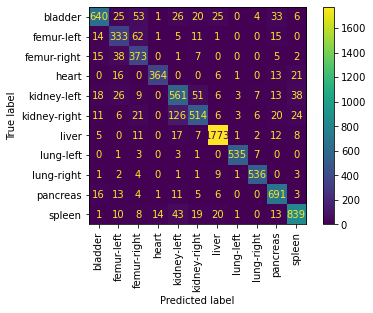

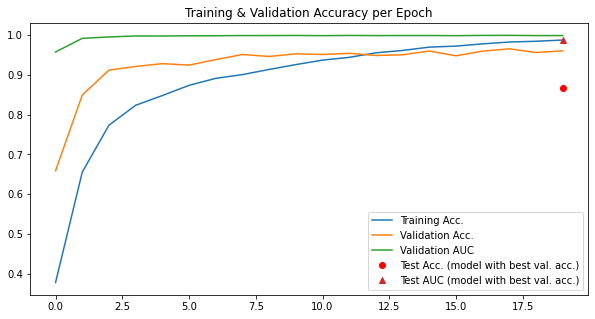

In [34]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [35]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.29it/s]


train -- accuracy: 0.3664
val -- accuracy: 0.7111,  AUC: 0.9677
Epoch 1



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.42it/s]


train -- accuracy: 0.6576
val -- accuracy: 0.87,  AUC: 0.9932
Epoch 2



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.41it/s]


train -- accuracy: 0.7716
val -- accuracy: 0.9277,  AUC: 0.9965
Epoch 3



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.49it/s]


train -- accuracy: 0.8138
val -- accuracy: 0.9352,  AUC: 0.998
Epoch 4



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.26it/s]


train -- accuracy: 0.8443
val -- accuracy: 0.9264,  AUC: 0.9982
Epoch 5



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.44it/s]


train -- accuracy: 0.8686
val -- accuracy: 0.9574,  AUC: 0.9989
Epoch 6



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.74it/s]


train -- accuracy: 0.8891
val -- accuracy: 0.9511,  AUC: 0.9988
Epoch 7



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.32it/s]


train -- accuracy: 0.9027
val -- accuracy: 0.9528,  AUC: 0.9989
Epoch 8



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.31it/s]


train -- accuracy: 0.915
val -- accuracy: 0.9457,  AUC: 0.9989
Epoch 9



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.26it/s]


train -- accuracy: 0.9243
val -- accuracy: 0.9561,  AUC: 0.9992
Epoch 10



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.45it/s]


train -- accuracy: 0.9352
val -- accuracy: 0.9628,  AUC: 0.9994
Epoch 11



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.47it/s]


train -- accuracy: 0.9437
val -- accuracy: 0.9548,  AUC: 0.9992
Epoch 12



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.22it/s]


train -- accuracy: 0.9524
val -- accuracy: 0.954,  AUC: 0.9991
Epoch 13



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.03it/s]


train -- accuracy: 0.9636
val -- accuracy: 0.9477,  AUC: 0.999
Epoch 14



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.66it/s]


train -- accuracy: 0.9724
val -- accuracy: 0.9574,  AUC: 0.9992
Epoch 15



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.68it/s]


train -- accuracy: 0.9724
val -- accuracy: 0.9523,  AUC: 0.999
Epoch 16



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 122.99it/s]


train -- accuracy: 0.9755
val -- accuracy: 0.9578,  AUC: 0.9993
Epoch 17



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.05it/s]


train -- accuracy: 0.982
val -- accuracy: 0.9557,  AUC: 0.9992
Epoch 18



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.66it/s]


train -- accuracy: 0.9862
val -- accuracy: 0.9519,  AUC: 0.9993
Epoch 19



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 123.14it/s]


train -- accuracy: 0.9863
val -- accuracy: 0.9578,  AUC: 0.9993
test -- accuracy: 0.8607,  AUC: 0.9853


<Figure size 720x720 with 0 Axes>

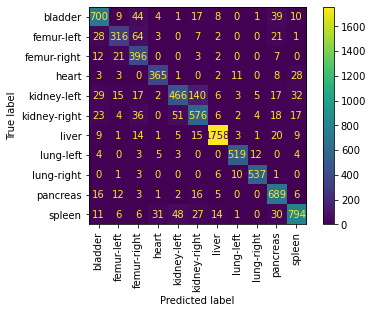

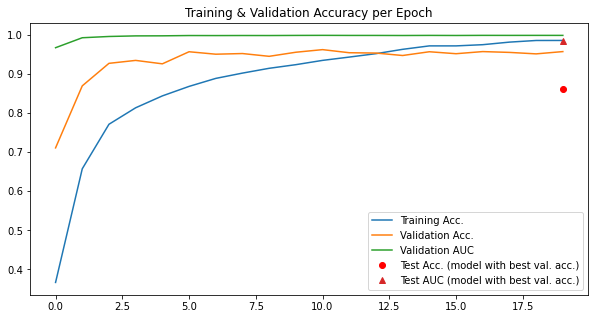

In [36]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

### OrgansMNIST

#### Training the Conditional VAE

In [37]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organsmnist"
base_dataset = organsmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Conditional Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(9099.3945, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(9099.2998, grad_fn=<MseLossBackward>), 'KLD': tensor(-18.9616, grad_fn=<NegBackward>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 124.473836146263
Validation set loss: 94.839337
Train epoch 2 -- average loss: 84.58341141513293
Validation set loss: 79.472965
Train epoch 3 -- average loss: 71.78990912854756
Validation set loss: 72.387707
Train epoch 4 -- average loss: 65.5693248688576
Validation set loss: 67.174858
Train epoch 5 -- average loss: 61.24633790813868
Validation set loss: 68.110543
Train epoch 6 -- average loss: 57.03051221894055
Validation set loss: 63.828637
Train epoch 7 -- average loss: 54.912346352532055
Validation set loss: 61.190493
Train epoch 8 -- average loss: 52.22687671283738
Validation set loss: 60.66

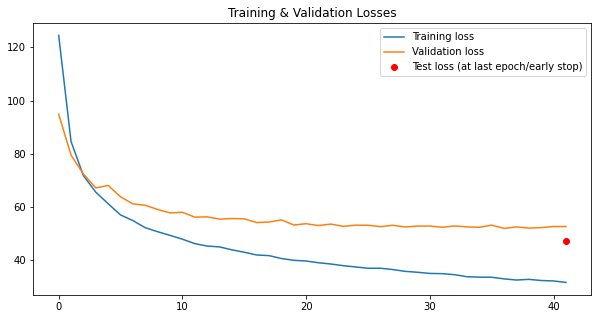

In [38]:
# Runs the conditional VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader, n_channels, latent_dims,  
    n_classes=n_classes, epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="CondVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [39]:
# Fetches the generated VAE Model model to import
model_path = f"models/CondVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1394 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.10it/s]


train -- accuracy: 0.3251
val -- accuracy: 0.447,  AUC: 0.928
Epoch 1



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.09it/s]


train -- accuracy: 0.5278
val -- accuracy: 0.6272,  AUC: 0.9697
Epoch 2



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.92it/s]


train -- accuracy: 0.642
val -- accuracy: 0.7329,  AUC: 0.9776
Epoch 3



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.18it/s]


train -- accuracy: 0.7007
val -- accuracy: 0.8148,  AUC: 0.9853
Epoch 4



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.42it/s]


train -- accuracy: 0.7343
val -- accuracy: 0.8291,  AUC: 0.9869
Epoch 5



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.27it/s]


train -- accuracy: 0.767
val -- accuracy: 0.8267,  AUC: 0.9878
Epoch 6



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.63it/s]


train -- accuracy: 0.7902
val -- accuracy: 0.8177,  AUC: 0.9875
Epoch 7



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.20it/s]


train -- accuracy: 0.8147
val -- accuracy: 0.8369,  AUC: 0.9889
Epoch 8



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.25it/s]


train -- accuracy: 0.8302
val -- accuracy: 0.8479,  AUC: 0.9895
Epoch 9



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.53it/s]


train -- accuracy: 0.8455
val -- accuracy: 0.8601,  AUC: 0.9898
Epoch 10



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.73it/s]


train -- accuracy: 0.866
val -- accuracy: 0.8503,  AUC: 0.9899
Epoch 11



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.23it/s]


train -- accuracy: 0.8801
val -- accuracy: 0.8377,  AUC: 0.9891
Epoch 12



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.15it/s]


train -- accuracy: 0.8996
val -- accuracy: 0.8422,  AUC: 0.9901
Epoch 13



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.22it/s]


train -- accuracy: 0.9123
val -- accuracy: 0.8499,  AUC: 0.9895
Epoch 14



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.85it/s]


train -- accuracy: 0.9193
val -- accuracy: 0.8034,  AUC: 0.9884
Epoch 15



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.02it/s]


train -- accuracy: 0.9311
val -- accuracy: 0.8462,  AUC: 0.9903
Epoch 16



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.19it/s]


train -- accuracy: 0.939
val -- accuracy: 0.8711,  AUC: 0.9909
Epoch 17



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.32it/s]


train -- accuracy: 0.9433
val -- accuracy: 0.8605,  AUC: 0.9906
Epoch 18



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.18it/s]


train -- accuracy: 0.9509
val -- accuracy: 0.8548,  AUC: 0.9898
Epoch 19



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.39it/s]


train -- accuracy: 0.955
val -- accuracy: 0.8577,  AUC: 0.9906
test -- accuracy: 0.7098,  AUC: 0.9601


<Figure size 720x720 with 0 Axes>

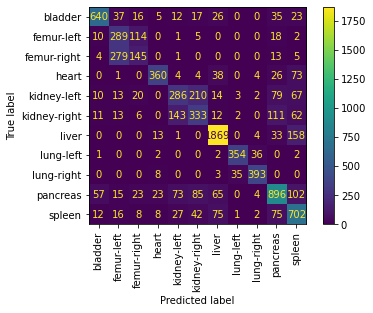

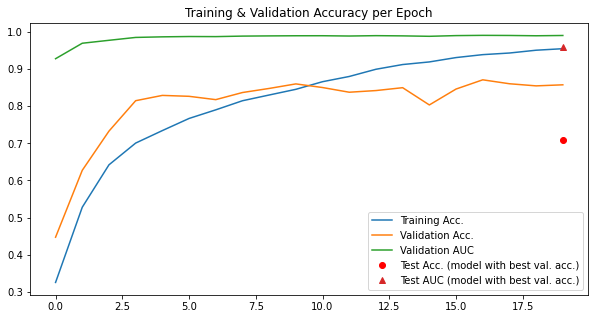

In [40]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [41]:
# Creates the augmented dataloader
condVAE_loader = generate_augmented_dataset_condVAE(
    n_channels, n_classes, latent_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.33it/s]


train -- accuracy: 0.2909
val -- accuracy: 0.4947,  AUC: 0.928
Epoch 1



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.19it/s]


train -- accuracy: 0.5155
val -- accuracy: 0.6929,  AUC: 0.9659
Epoch 2



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 122.16it/s]


train -- accuracy: 0.6116
val -- accuracy: 0.7626,  AUC: 0.9807
Epoch 3



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 124.42it/s]


train -- accuracy: 0.6737
val -- accuracy: 0.7565,  AUC: 0.9851
Epoch 4



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 124.10it/s]


train -- accuracy: 0.7155
val -- accuracy: 0.7818,  AUC: 0.9847
Epoch 5



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.31it/s]


train -- accuracy: 0.756
val -- accuracy: 0.8385,  AUC: 0.9889
Epoch 6



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.74it/s]


train -- accuracy: 0.7847
val -- accuracy: 0.8438,  AUC: 0.9896
Epoch 7



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 124.23it/s]


train -- accuracy: 0.7968
val -- accuracy: 0.8332,  AUC: 0.9893
Epoch 8



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.10it/s]


train -- accuracy: 0.8156
val -- accuracy: 0.843,  AUC: 0.9903
Epoch 9



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.45it/s]


train -- accuracy: 0.8445
val -- accuracy: 0.8515,  AUC: 0.9896
Epoch 10



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.75it/s]


train -- accuracy: 0.8641
val -- accuracy: 0.8124,  AUC: 0.9893
Epoch 11



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 124.01it/s]


train -- accuracy: 0.8782
val -- accuracy: 0.8177,  AUC: 0.9894
Epoch 12



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.96it/s]


train -- accuracy: 0.8962
val -- accuracy: 0.8524,  AUC: 0.9896
Epoch 13



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.41it/s]


train -- accuracy: 0.9109
val -- accuracy: 0.8442,  AUC: 0.9897
Epoch 14



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.82it/s]


train -- accuracy: 0.9262
val -- accuracy: 0.8418,  AUC: 0.9896
Epoch 15



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.33it/s]


train -- accuracy: 0.9354
val -- accuracy: 0.8487,  AUC: 0.9893
Epoch 16



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 124.01it/s]


train -- accuracy: 0.944
val -- accuracy: 0.8471,  AUC: 0.9892
Epoch 17



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.75it/s]


train -- accuracy: 0.9525
val -- accuracy: 0.8422,  AUC: 0.9885
Epoch 18



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.11it/s]


train -- accuracy: 0.9614
val -- accuracy: 0.8161,  AUC: 0.988
Epoch 19



100%|████████████████████████████████████████| 240/240 [00:01<00:00, 123.29it/s]


train -- accuracy: 0.9697
val -- accuracy: 0.856,  AUC: 0.9893
test -- accuracy: 0.7157,  AUC: 0.9601


<Figure size 720x720 with 0 Axes>

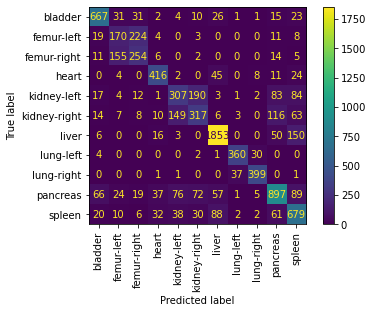

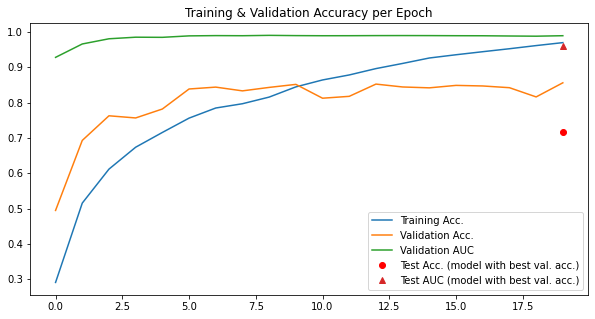

In [42]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, condVAE_loader)

## 5. Training a Joint Variational Autoencoder 

We train a Joint Variational Autoencoder for data augmentation for each of the datasets. 

For each dataset, we then retrain the underlying baseline classifier.

In [43]:
# Declares the Joint VAE's hyperparameters
latent_dims = 100
categorical_dims = 50
epochs = 200

### PathMNIST

#### Training the Joint VAE

In [44]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pathmnist"
base_dataset = pathmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 3, 28, 28])
Forward pass test:  True
{'loss': tensor(808762., grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(26958.6719, grad_fn=<MseLossBackward>), 'Capacity_Loss': tensor(379.0168, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 2262.988771115522
Validation set loss: 2073.231423
Train epoch 2 -- average loss: 1694.1355885782423
Validation set loss: 1587.782442
Train epoch 3 -- average loss: 1533.5623685705475
Validation set loss: 1421.136572
Train epoch 4 -- average loss: 1424.3463416299405
Validation set loss: 1355.23649
Train epoch 5 -- average loss: 1359.6952514946845
Validation set loss: 1310.02733
Train epoch 6 -- average loss: 1304.6183819324262
Validation set loss: 1292.486467
Train epoch 7 -- average loss: 1270.3891114127641
Validation set loss: 1240.988119
Train epoch 8 -- average loss: 1233.7464019668234
Va

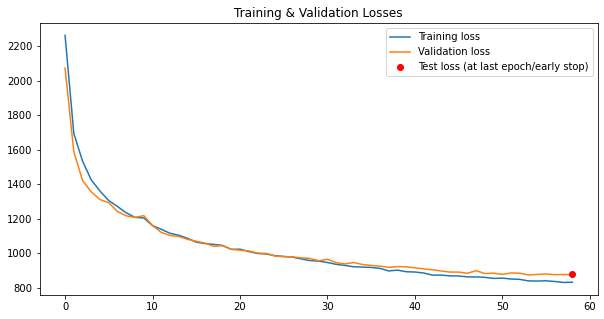

In [45]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [46]:
# Fetches the generated VAE Model model to import
model_path = f"models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 3599 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.89it/s]


train -- accuracy: 0.4172
val -- accuracy: 0.7545,  AUC: 0.9713
Epoch 1



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.93it/s]


train -- accuracy: 0.4859
val -- accuracy: 0.7741,  AUC: 0.9842
Epoch 2



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.5051
val -- accuracy: 0.8762,  AUC: 0.9904
Epoch 3



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.87it/s]


train -- accuracy: 0.5184
val -- accuracy: 0.9027,  AUC: 0.993
Epoch 4



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.91it/s]


train -- accuracy: 0.5271
val -- accuracy: 0.9177,  AUC: 0.9952
Epoch 5



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.89it/s]


train -- accuracy: 0.531
val -- accuracy: 0.8981,  AUC: 0.9941
Epoch 6



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.5354
val -- accuracy: 0.9141,  AUC: 0.9953
Epoch 7



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.5396
val -- accuracy: 0.9191,  AUC: 0.9964
Epoch 8



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.91it/s]


train -- accuracy: 0.5415
val -- accuracy: 0.9379,  AUC: 0.9969
Epoch 9



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.92it/s]


train -- accuracy: 0.5442
val -- accuracy: 0.9018,  AUC: 0.9946
Epoch 10



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.5458
val -- accuracy: 0.931,  AUC: 0.9969
Epoch 11



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.5484
val -- accuracy: 0.9021,  AUC: 0.9948
Epoch 12



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.87it/s]


train -- accuracy: 0.5501
val -- accuracy: 0.9371,  AUC: 0.997
Epoch 13



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.88it/s]


train -- accuracy: 0.5517
val -- accuracy: 0.9354,  AUC: 0.9968
Epoch 14



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.5531
val -- accuracy: 0.9171,  AUC: 0.9954
Epoch 15



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.87it/s]


train -- accuracy: 0.5547
val -- accuracy: 0.9378,  AUC: 0.9973
Epoch 16



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.87it/s]


train -- accuracy: 0.5552
val -- accuracy: 0.9408,  AUC: 0.9975
Epoch 17



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.5563
val -- accuracy: 0.9463,  AUC: 0.9976
Epoch 18



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.92it/s]


train -- accuracy: 0.5582
val -- accuracy: 0.9413,  AUC: 0.9975
Epoch 19



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.89it/s]


train -- accuracy: 0.5588
val -- accuracy: 0.9364,  AUC: 0.9971
test -- accuracy: 0.8508,  AUC: 0.979


<Figure size 720x720 with 0 Axes>

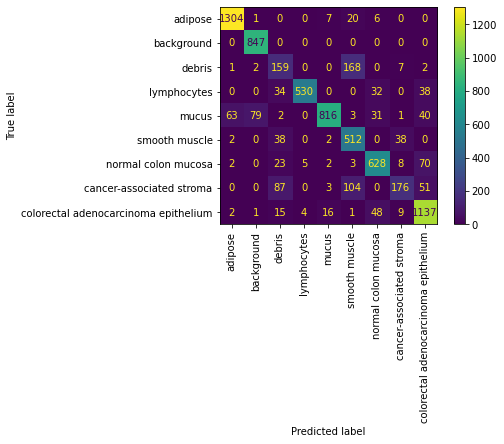

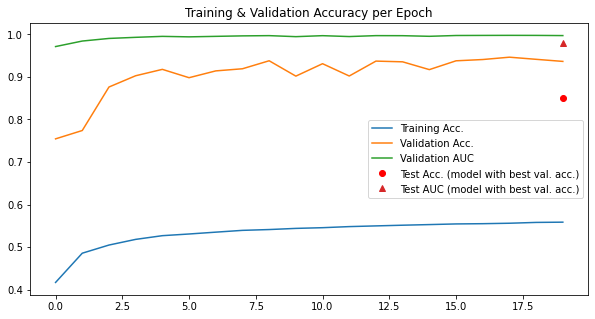

In [47]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [48]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.89it/s]


train -- accuracy: 0.3888
val -- accuracy: 0.7709,  AUC: 0.9739
Epoch 1



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.91it/s]


train -- accuracy: 0.4716
val -- accuracy: 0.8059,  AUC: 0.9834
Epoch 2



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.88it/s]


train -- accuracy: 0.4923
val -- accuracy: 0.8533,  AUC: 0.9893
Epoch 3



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.88it/s]


train -- accuracy: 0.5038
val -- accuracy: 0.8657,  AUC: 0.9904
Epoch 4



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.91it/s]


train -- accuracy: 0.5116
val -- accuracy: 0.867,  AUC: 0.9899
Epoch 5



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.88it/s]


train -- accuracy: 0.5173
val -- accuracy: 0.9262,  AUC: 0.9958
Epoch 6



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.86it/s]


train -- accuracy: 0.5212
val -- accuracy: 0.9175,  AUC: 0.9956
Epoch 7



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.524
val -- accuracy: 0.9334,  AUC: 0.9964
Epoch 8



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.89it/s]


train -- accuracy: 0.5279
val -- accuracy: 0.9258,  AUC: 0.9959
Epoch 9



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.88it/s]


train -- accuracy: 0.5304
val -- accuracy: 0.9133,  AUC: 0.995
Epoch 10



100%|███████████████████████████████████████| 2813/2813 [04:19<00:00, 10.86it/s]


train -- accuracy: 0.5317
val -- accuracy: 0.9204,  AUC: 0.9962
Epoch 11



100%|███████████████████████████████████████| 2813/2813 [04:17<00:00, 10.90it/s]


train -- accuracy: 0.5348
val -- accuracy: 0.9468,  AUC: 0.9973
Epoch 12



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.87it/s]


train -- accuracy: 0.5362
val -- accuracy: 0.9374,  AUC: 0.9971
Epoch 13



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.5387
val -- accuracy: 0.944,  AUC: 0.9973
Epoch 14



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.88it/s]


train -- accuracy: 0.5391
val -- accuracy: 0.9253,  AUC: 0.9965
Epoch 15



100%|███████████████████████████████████████| 2813/2813 [04:19<00:00, 10.83it/s]


train -- accuracy: 0.5372
val -- accuracy: 0.9358,  AUC: 0.9967
Epoch 16



100%|███████████████████████████████████████| 2813/2813 [04:19<00:00, 10.85it/s]


train -- accuracy: 0.54
val -- accuracy: 0.9327,  AUC: 0.9968
Epoch 17



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.5427
val -- accuracy: 0.9354,  AUC: 0.9969
Epoch 18



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.87it/s]


train -- accuracy: 0.5427
val -- accuracy: 0.9369,  AUC: 0.9971
Epoch 19



100%|███████████████████████████████████████| 2813/2813 [04:18<00:00, 10.90it/s]


train -- accuracy: 0.5452
val -- accuracy: 0.9382,  AUC: 0.9971
test -- accuracy: 0.7481,  AUC: 0.9612


<Figure size 720x720 with 0 Axes>

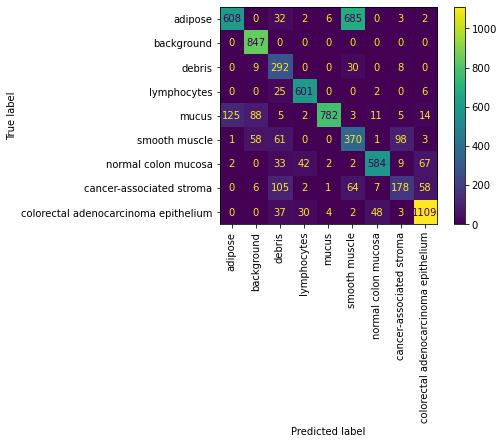

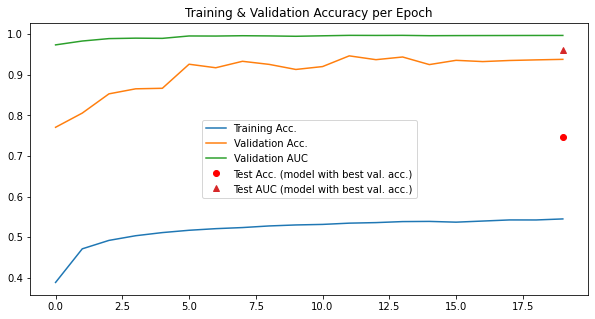

In [49]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### DermaMNIST

#### Training the Joint VAE

In [50]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "dermamnist"
base_dataset = dermamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 3, 28, 28])
Forward pass test:  True
{'loss': tensor(768699.6875, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(25623.2598, grad_fn=<MseLossBackward>), 'Capacity_Loss': tensor(376.5434, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 2913.353803562509
Validation set loss: 2197.333102
Train epoch 2 -- average loss: 1454.8052126444984
Validation set loss: 1106.122729
Train epoch 3 -- average loss: 1031.5617423870772
Validation set loss: 1100.960716
Train epoch 4 -- average loss: 906.1593345270801
Validation set loss: 840.228798
Train epoch 5 -- average loss: 851.8372369817682
Validation set loss: 774.769161
Train epoch 6 -- average loss: 817.7945926841016
Validation set loss: 733.464139
Train epoch 7 -- average loss: 728.8795164099294
Validation set loss: 679.040509
Train epoch 8 -- average loss: 671.0794517982018
Valid

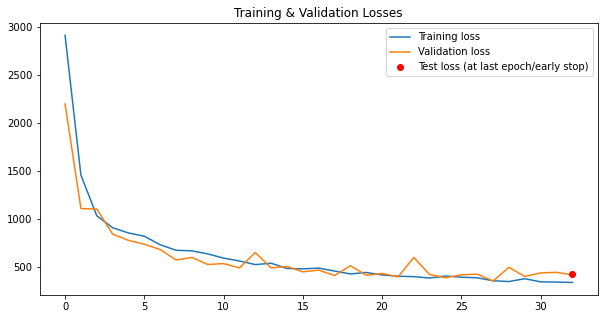

In [51]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [52]:
# Fetches the generated VAE Model model to import
model_path = f"models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 700 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.87it/s]


train -- accuracy: 0.6491
val -- accuracy: 0.669,  AUC: 0.8244
Epoch 1



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.85it/s]


train -- accuracy: 0.6698
val -- accuracy: 0.669,  AUC: 0.8637
Epoch 2



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.82it/s]


train -- accuracy: 0.6708
val -- accuracy: 0.67,  AUC: 0.8634
Epoch 3



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.85it/s]


train -- accuracy: 0.6757
val -- accuracy: 0.676,  AUC: 0.8681
Epoch 4



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.94it/s]


train -- accuracy: 0.6801
val -- accuracy: 0.681,  AUC: 0.88
Epoch 5



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.94it/s]


train -- accuracy: 0.6842
val -- accuracy: 0.683,  AUC: 0.8687
Epoch 6



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.86it/s]


train -- accuracy: 0.6887
val -- accuracy: 0.7109,  AUC: 0.8791
Epoch 7



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.91it/s]


train -- accuracy: 0.6919
val -- accuracy: 0.7089,  AUC: 0.8807
Epoch 8



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.84it/s]


train -- accuracy: 0.6942
val -- accuracy: 0.7109,  AUC: 0.8887
Epoch 9



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.91it/s]


train -- accuracy: 0.6975
val -- accuracy: 0.7059,  AUC: 0.8915
Epoch 10



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.93it/s]


train -- accuracy: 0.7009
val -- accuracy: 0.7188,  AUC: 0.8929
Epoch 11



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.91it/s]


train -- accuracy: 0.6994
val -- accuracy: 0.7298,  AUC: 0.8961
Epoch 12



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.87it/s]


train -- accuracy: 0.7052
val -- accuracy: 0.7338,  AUC: 0.8946
Epoch 13



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.76it/s]


train -- accuracy: 0.7073
val -- accuracy: 0.7288,  AUC: 0.8992
Epoch 14



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.89it/s]


train -- accuracy: 0.7092
val -- accuracy: 0.7149,  AUC: 0.8971
Epoch 15



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.89it/s]


train -- accuracy: 0.7086
val -- accuracy: 0.7408,  AUC: 0.9022
Epoch 16



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.90it/s]


train -- accuracy: 0.7149
val -- accuracy: 0.7338,  AUC: 0.8982
Epoch 17



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.93it/s]


train -- accuracy: 0.7192
val -- accuracy: 0.7288,  AUC: 0.9036
Epoch 18



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.83it/s]


train -- accuracy: 0.7194
val -- accuracy: 0.7488,  AUC: 0.9042
Epoch 19



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.91it/s]


train -- accuracy: 0.7261
val -- accuracy: 0.7198,  AUC: 0.905
test -- accuracy: 0.7322,  AUC: 0.9034


<Figure size 720x720 with 0 Axes>

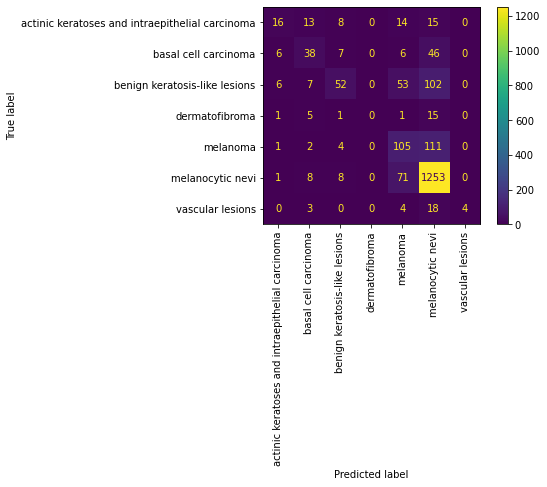

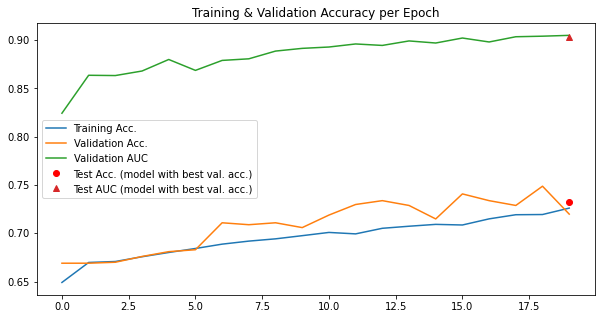

In [53]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [54]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.72it/s]


train -- accuracy: 0.2398
val -- accuracy: 0.4835,  AUC: 0.8311
Epoch 1



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.86it/s]


train -- accuracy: 0.3056
val -- accuracy: 0.5035,  AUC: 0.8567
Epoch 2



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.94it/s]


train -- accuracy: 0.3411
val -- accuracy: 0.5364,  AUC: 0.8768
Epoch 3



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.80it/s]


train -- accuracy: 0.3636
val -- accuracy: 0.4875,  AUC: 0.8653
Epoch 4



100%|█████████████████████████████████████████| 219/219 [00:19<00:00, 10.97it/s]


train -- accuracy: 0.3954
val -- accuracy: 0.5434,  AUC: 0.8725
Epoch 5



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.74it/s]


train -- accuracy: 0.4062
val -- accuracy: 0.5464,  AUC: 0.8693
Epoch 6



100%|█████████████████████████████████████████| 219/219 [00:19<00:00, 10.99it/s]


train -- accuracy: 0.4304
val -- accuracy: 0.5593,  AUC: 0.8905
Epoch 7



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.94it/s]


train -- accuracy: 0.448
val -- accuracy: 0.6072,  AUC: 0.8887
Epoch 8



100%|█████████████████████████████████████████| 219/219 [00:19<00:00, 10.98it/s]


train -- accuracy: 0.4596
val -- accuracy: 0.6211,  AUC: 0.8711
Epoch 9



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.61it/s]


train -- accuracy: 0.468
val -- accuracy: 0.5942,  AUC: 0.8939
Epoch 10



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.70it/s]


train -- accuracy: 0.4774
val -- accuracy: 0.6072,  AUC: 0.8599
Epoch 11



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.90it/s]


train -- accuracy: 0.4914
val -- accuracy: 0.6839,  AUC: 0.8746
Epoch 12



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.70it/s]


train -- accuracy: 0.4951
val -- accuracy: 0.6231,  AUC: 0.8746
Epoch 13



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.93it/s]


train -- accuracy: 0.5169
val -- accuracy: 0.6431,  AUC: 0.8581
Epoch 14



100%|█████████████████████████████████████████| 219/219 [00:19<00:00, 10.97it/s]


train -- accuracy: 0.5233
val -- accuracy: 0.662,  AUC: 0.899
Epoch 15



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.92it/s]


train -- accuracy: 0.5278
val -- accuracy: 0.5593,  AUC: 0.8748
Epoch 16



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.73it/s]


train -- accuracy: 0.527
val -- accuracy: 0.6849,  AUC: 0.8745
Epoch 17



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.86it/s]


train -- accuracy: 0.534
val -- accuracy: 0.6181,  AUC: 0.8734
Epoch 18



100%|█████████████████████████████████████████| 219/219 [00:19<00:00, 11.00it/s]


train -- accuracy: 0.5482
val -- accuracy: 0.6869,  AUC: 0.867
Epoch 19



100%|█████████████████████████████████████████| 219/219 [00:20<00:00, 10.74it/s]


train -- accuracy: 0.5402
val -- accuracy: 0.665,  AUC: 0.8688
test -- accuracy: 0.6638,  AUC: 0.8868


<Figure size 720x720 with 0 Axes>

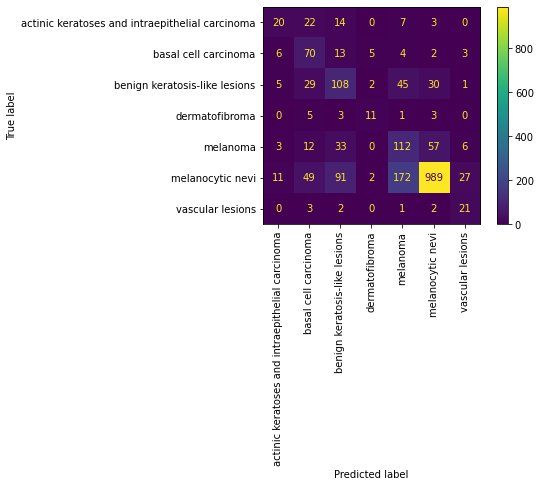

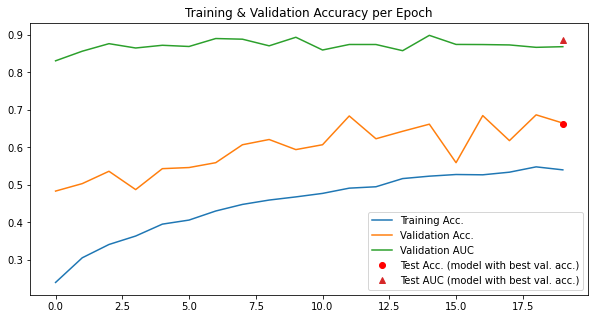

In [55]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### OctMNIST

#### Training the Joint VAE

In [56]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "octmnist"
base_dataset = octmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(257011.9062, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8566.9980, grad_fn=<MseLossBackward>), 'Capacity_Loss': tensor(394.1151, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 604.8288209824898
Validation set loss: 236.461846
Train epoch 2 -- average loss: 216.03649633976156
Validation set loss: 166.501074
Train epoch 3 -- average loss: 161.99286208321098
Validation set loss: 116.28905
Train epoch 4 -- average loss: 131.11122141413006
Validation set loss: 111.933508
Train epoch 5 -- average loss: 116.51364495057969
Validation set loss: 92.999365
Train epoch 6 -- average loss: 102.29819121594069
Validation set loss: 101.8565
Train epoch 7 -- average loss: 95.10101313788485
Validation set loss: 83.202755
Train epoch 8 -- average loss: 88.31220119904486
Validation 

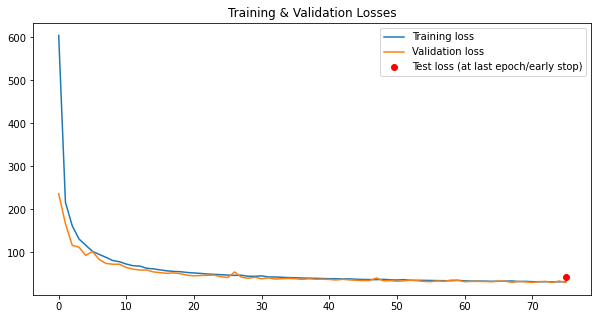

In [57]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [58]:
# Fetches the generated VAE Model model to import
model_path = f"models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 3899 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|███████████████████████████████████████| 3047/3047 [04:36<00:00, 11.00it/s]


train -- accuracy: 0.6253
val -- accuracy: 0.8514,  AUC: 0.9326
Epoch 1



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.96it/s]


train -- accuracy: 0.6662
val -- accuracy: 0.8703,  AUC: 0.9455
Epoch 2



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.99it/s]


train -- accuracy: 0.6767
val -- accuracy: 0.85,  AUC: 0.9529
Epoch 3



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.98it/s]


train -- accuracy: 0.6841
val -- accuracy: 0.8955,  AUC: 0.9652
Epoch 4



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.99it/s]


train -- accuracy: 0.6883
val -- accuracy: 0.8994,  AUC: 0.9678
Epoch 5



100%|███████████████████████████████████████| 3047/3047 [04:38<00:00, 10.96it/s]


train -- accuracy: 0.6923
val -- accuracy: 0.9071,  AUC: 0.969
Epoch 6



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.99it/s]


train -- accuracy: 0.6956
val -- accuracy: 0.8736,  AUC: 0.9625
Epoch 7



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.98it/s]


train -- accuracy: 0.6982
val -- accuracy: 0.9107,  AUC: 0.9721
Epoch 8



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.97it/s]


train -- accuracy: 0.7015
val -- accuracy: 0.9152,  AUC: 0.9728
Epoch 9



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.98it/s]


train -- accuracy: 0.7033
val -- accuracy: 0.9123,  AUC: 0.9727
Epoch 10



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.99it/s]


train -- accuracy: 0.7054
val -- accuracy: 0.9192,  AUC: 0.9737
Epoch 11



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.98it/s]


train -- accuracy: 0.7082
val -- accuracy: 0.9159,  AUC: 0.9732
Epoch 12



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.99it/s]


train -- accuracy: 0.7102
val -- accuracy: 0.9167,  AUC: 0.9742
Epoch 13



100%|███████████████████████████████████████| 3047/3047 [04:37<00:00, 10.98it/s]


train -- accuracy: 0.711
val -- accuracy: 0.9165,  AUC: 0.9733
Epoch 14



100%|███████████████████████████████████████| 3047/3047 [04:40<00:00, 10.86it/s]


train -- accuracy: 0.7128
val -- accuracy: 0.9183,  AUC: 0.9755
Epoch 15



100%|███████████████████████████████████████| 3047/3047 [04:59<00:00, 10.17it/s]


train -- accuracy: 0.7153
val -- accuracy: 0.9136,  AUC: 0.9727
Epoch 16



100%|███████████████████████████████████████| 3047/3047 [05:05<00:00,  9.97it/s]


train -- accuracy: 0.716
val -- accuracy: 0.9145,  AUC: 0.975
Epoch 17



100%|███████████████████████████████████████| 3047/3047 [04:58<00:00, 10.22it/s]


train -- accuracy: 0.7179
val -- accuracy: 0.9157,  AUC: 0.9725
Epoch 18



100%|███████████████████████████████████████| 3047/3047 [05:17<00:00,  9.59it/s]


train -- accuracy: 0.7184
val -- accuracy: 0.9201,  AUC: 0.9737
Epoch 19



100%|███████████████████████████████████████| 3047/3047 [05:14<00:00,  9.70it/s]


train -- accuracy: 0.7199
val -- accuracy: 0.9214,  AUC: 0.9753
test -- accuracy: 0.73,  AUC: 0.932


<Figure size 720x720 with 0 Axes>

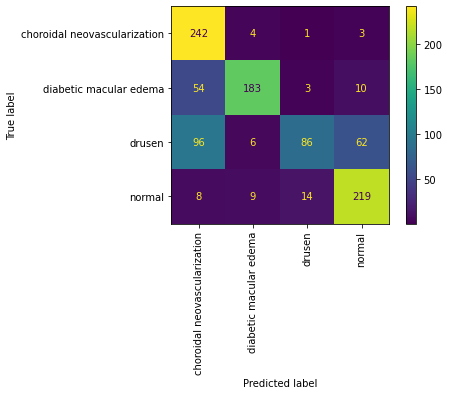

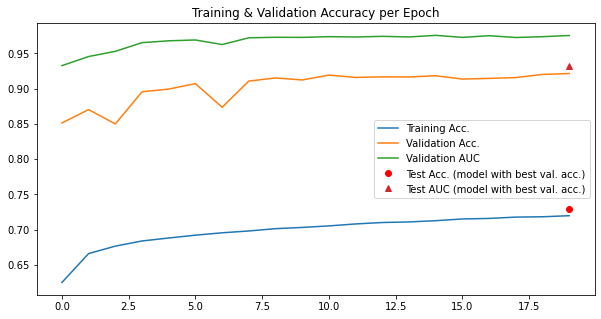

In [59]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [60]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|███████████████████████████████████████| 3047/3047 [05:19<00:00,  9.53it/s]


train -- accuracy: 0.4611
val -- accuracy: 0.8147,  AUC: 0.9389
Epoch 1



100%|███████████████████████████████████████| 3047/3047 [04:56<00:00, 10.28it/s]


train -- accuracy: 0.5229
val -- accuracy: 0.8241,  AUC: 0.9584
Epoch 2



100%|███████████████████████████████████████| 3047/3047 [04:42<00:00, 10.78it/s]


train -- accuracy: 0.542
val -- accuracy: 0.8286,  AUC: 0.9636
Epoch 3



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.83it/s]


train -- accuracy: 0.5568
val -- accuracy: 0.8864,  AUC: 0.968
Epoch 4



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.81it/s]


train -- accuracy: 0.5653
val -- accuracy: 0.8797,  AUC: 0.9685
Epoch 5



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.83it/s]


train -- accuracy: 0.575
val -- accuracy: 0.8547,  AUC: 0.9704
Epoch 6



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.84it/s]


train -- accuracy: 0.5808
val -- accuracy: 0.8778,  AUC: 0.9699
Epoch 7



100%|███████████████████████████████████████| 3047/3047 [04:42<00:00, 10.78it/s]


train -- accuracy: 0.5881
val -- accuracy: 0.8583,  AUC: 0.9685
Epoch 8



100%|███████████████████████████████████████| 3047/3047 [04:40<00:00, 10.85it/s]


train -- accuracy: 0.5931
val -- accuracy: 0.8878,  AUC: 0.9705
Epoch 9



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.83it/s]


train -- accuracy: 0.5957
val -- accuracy: 0.8958,  AUC: 0.9706
Epoch 10



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.82it/s]


train -- accuracy: 0.6009
val -- accuracy: 0.9044,  AUC: 0.9713
Epoch 11



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.84it/s]


train -- accuracy: 0.6042
val -- accuracy: 0.8941,  AUC: 0.9708
Epoch 12



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.84it/s]


train -- accuracy: 0.6062
val -- accuracy: 0.9005,  AUC: 0.9712
Epoch 13



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.83it/s]


train -- accuracy: 0.6069
val -- accuracy: 0.9069,  AUC: 0.9735
Epoch 14



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.81it/s]


train -- accuracy: 0.6082
val -- accuracy: 0.9096,  AUC: 0.9721
Epoch 15



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.81it/s]


train -- accuracy: 0.6115
val -- accuracy: 0.9085,  AUC: 0.972
Epoch 16



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.84it/s]


train -- accuracy: 0.6121
val -- accuracy: 0.8991,  AUC: 0.9695
Epoch 17



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.81it/s]


train -- accuracy: 0.6124
val -- accuracy: 0.8985,  AUC: 0.9718
Epoch 18



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.81it/s]


train -- accuracy: 0.6129
val -- accuracy: 0.905,  AUC: 0.9717
Epoch 19



100%|███████████████████████████████████████| 3047/3047 [04:41<00:00, 10.82it/s]


train -- accuracy: 0.6145
val -- accuracy: 0.9148,  AUC: 0.9729
test -- accuracy: 0.723,  AUC: 0.937


<Figure size 720x720 with 0 Axes>

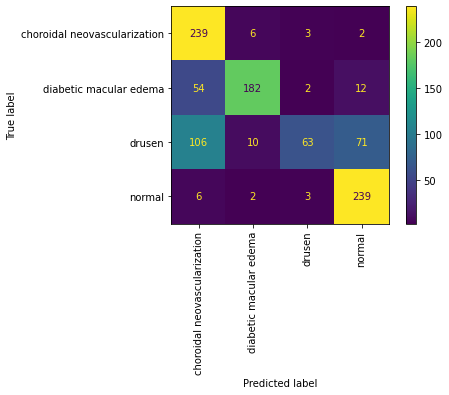

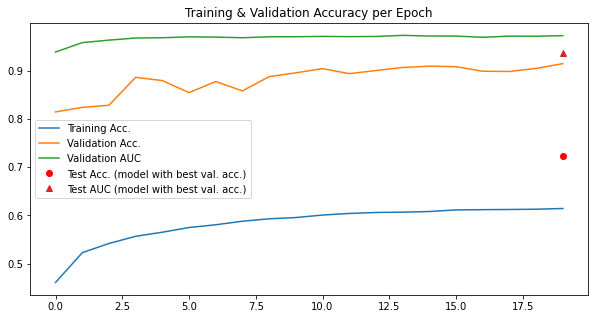

In [61]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### PneumoniaMNIST

#### Training the Joint VAE

In [62]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pneumoniamnist"
base_dataset = pneumoniamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(257855.5938, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8595.1270, grad_fn=<MseLossBackward>), 'Capacity_Loss': tensor(357.7968, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 1306.422536274692
Validation set loss: 619.731114
Train epoch 2 -- average loss: 529.5331382006027
Validation set loss: 386.517938
Train epoch 3 -- average loss: 393.288204170428
Validation set loss: 334.87928
Train epoch 4 -- average loss: 317.5484723890851
Validation set loss: 284.747096
Train epoch 5 -- average loss: 285.15611994377923
Validation set loss: 235.25729
Train epoch 6 -- average loss: 263.98739906641623
Validation set loss: 237.725204
Train epoch 7 -- average loss: 243.2670283418848
Validation set loss: 229.668014
Train epoch 8 -- average loss: 243.36724080853068
Validation 

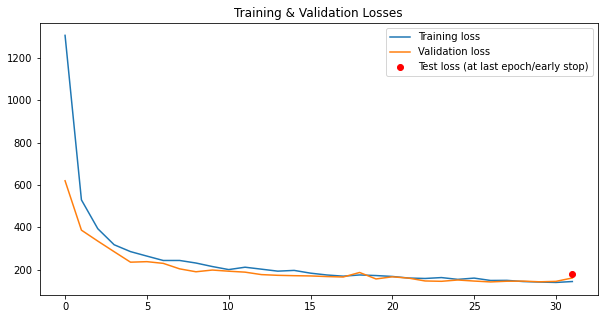

In [63]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [64]:
# Fetches the generated VAE Model model to import
model_path = f"models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 470 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.94it/s]


train -- accuracy: 0.7746
val -- accuracy: 0.8969,  AUC: 0.9807
Epoch 1



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.91it/s]


train -- accuracy: 0.8267
val -- accuracy: 0.9485,  AUC: 0.9852
Epoch 2



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.89it/s]


train -- accuracy: 0.8334
val -- accuracy: 0.9523,  AUC: 0.9877
Epoch 3



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.84it/s]


train -- accuracy: 0.8435
val -- accuracy: 0.9504,  AUC: 0.9911
Epoch 4



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.92it/s]


train -- accuracy: 0.8471
val -- accuracy: 0.9599,  AUC: 0.9927
Epoch 5



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.89it/s]


train -- accuracy: 0.8503
val -- accuracy: 0.9618,  AUC: 0.9922
Epoch 6



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.89it/s]


train -- accuracy: 0.8552
val -- accuracy: 0.9637,  AUC: 0.9952
Epoch 7



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.92it/s]


train -- accuracy: 0.8572
val -- accuracy: 0.9599,  AUC: 0.9953
Epoch 8



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.93it/s]


train -- accuracy: 0.8584
val -- accuracy: 0.9542,  AUC: 0.9931
Epoch 9



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.91it/s]


train -- accuracy: 0.8598
val -- accuracy: 0.9656,  AUC: 0.9955
Epoch 10



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.89it/s]


train -- accuracy: 0.8633
val -- accuracy: 0.9542,  AUC: 0.996
Epoch 11



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.93it/s]


train -- accuracy: 0.8631
val -- accuracy: 0.9695,  AUC: 0.9961
Epoch 12



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.90it/s]


train -- accuracy: 0.8663
val -- accuracy: 0.9752,  AUC: 0.9968
Epoch 13



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.85it/s]


train -- accuracy: 0.8657
val -- accuracy: 0.979,  AUC: 0.9979
Epoch 14



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.94it/s]


train -- accuracy: 0.8676
val -- accuracy: 0.9771,  AUC: 0.9978
Epoch 15



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.93it/s]


train -- accuracy: 0.868
val -- accuracy: 0.9771,  AUC: 0.9973
Epoch 16



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.87it/s]


train -- accuracy: 0.8675
val -- accuracy: 0.9695,  AUC: 0.9968
Epoch 17



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.89it/s]


train -- accuracy: 0.8702
val -- accuracy: 0.9695,  AUC: 0.9971
Epoch 18



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.90it/s]


train -- accuracy: 0.8701
val -- accuracy: 0.9847,  AUC: 0.9974
Epoch 19



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.94it/s]


train -- accuracy: 0.8698
val -- accuracy: 0.9866,  AUC: 0.9978
test -- accuracy: 0.8558,  AUC: 0.9352


<Figure size 720x720 with 0 Axes>

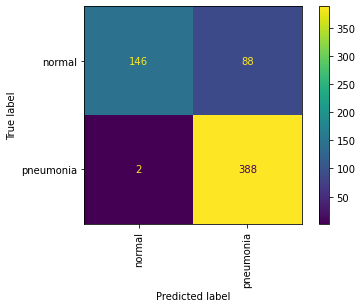

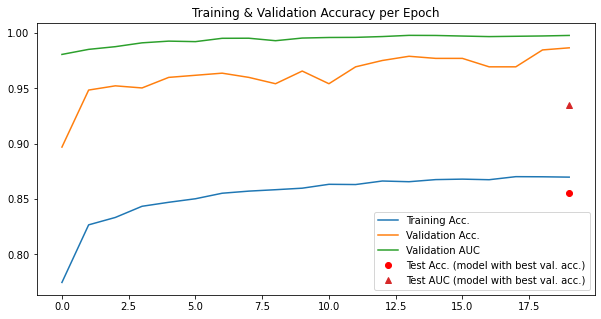

In [65]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [66]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.86it/s]


train -- accuracy: 0.6645
val -- accuracy: 0.9294,  AUC: 0.984
Epoch 1



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.66it/s]


train -- accuracy: 0.7162
val -- accuracy: 0.9084,  AUC: 0.9868
Epoch 2



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.90it/s]


train -- accuracy: 0.7258
val -- accuracy: 0.9504,  AUC: 0.9886
Epoch 3



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.90it/s]


train -- accuracy: 0.7245
val -- accuracy: 0.9695,  AUC: 0.9915
Epoch 4



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.87it/s]


train -- accuracy: 0.7244
val -- accuracy: 0.9752,  AUC: 0.9946
Epoch 5



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.73it/s]


train -- accuracy: 0.7282
val -- accuracy: 0.9656,  AUC: 0.9943
Epoch 6



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.91it/s]


train -- accuracy: 0.7395
val -- accuracy: 0.9561,  AUC: 0.9954
Epoch 7



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.73it/s]


train -- accuracy: 0.7297
val -- accuracy: 0.9656,  AUC: 0.9958
Epoch 8



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.95it/s]


train -- accuracy: 0.7334
val -- accuracy: 0.9714,  AUC: 0.9968
Epoch 9



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.89it/s]


train -- accuracy: 0.7394
val -- accuracy: 0.9561,  AUC: 0.9926
Epoch 10



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 11.06it/s]


train -- accuracy: 0.7435
val -- accuracy: 0.9656,  AUC: 0.9956
Epoch 11



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 11.10it/s]


train -- accuracy: 0.7499
val -- accuracy: 0.9752,  AUC: 0.9971
Epoch 12



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.81it/s]


train -- accuracy: 0.7433
val -- accuracy: 0.9752,  AUC: 0.9971
Epoch 13



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.76it/s]


train -- accuracy: 0.7413
val -- accuracy: 0.9733,  AUC: 0.9977
Epoch 14



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.79it/s]


train -- accuracy: 0.7421
val -- accuracy: 0.9733,  AUC: 0.9967
Epoch 15



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.87it/s]


train -- accuracy: 0.7481
val -- accuracy: 0.9676,  AUC: 0.9975
Epoch 16



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.97it/s]


train -- accuracy: 0.7514
val -- accuracy: 0.9809,  AUC: 0.9945
Epoch 17



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.83it/s]


train -- accuracy: 0.7426
val -- accuracy: 0.9809,  AUC: 0.9968
Epoch 18



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.80it/s]


train -- accuracy: 0.7524
val -- accuracy: 0.979,  AUC: 0.997
Epoch 19



100%|█████████████████████████████████████████| 148/148 [00:13<00:00, 10.92it/s]


train -- accuracy: 0.7495
val -- accuracy: 0.9733,  AUC: 0.9967
test -- accuracy: 0.8942,  AUC: 0.9477


<Figure size 720x720 with 0 Axes>

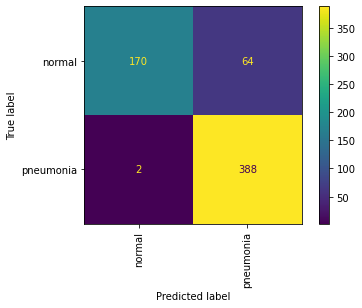

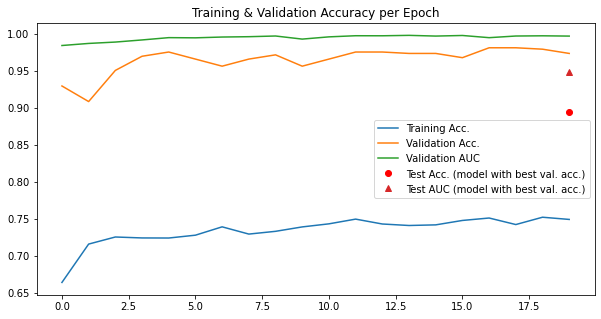

In [67]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### BreastMNIST

#### Training the Joint VAE

In [68]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "breastmnist"
base_dataset = breastmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(256601.9688, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8553.3340, grad_fn=<MseLossBackward>), 'Capacity_Loss': tensor(389.4135, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 3484.373819539835
Validation set loss: 4256.346204
Train epoch 2 -- average loss: 1666.4763907967033
Validation set loss: 3966.068409
Train epoch 3 -- average loss: 1356.413125286172
Validation set loss: 1720.116762
Train epoch 4 -- average loss: 1187.7559023008241
Validation set loss: 1142.395608
Train epoch 5 -- average loss: 1051.9605225503662
Validation set loss: 989.797576
Train epoch 6 -- average loss: 950.878434065934
Validation set loss: 920.282252
Train epoch 7 -- average loss: 886.5987615899726
Validation set loss: 884.95956
Train epoch 8 -- average loss: 841.6085021749084
Valida

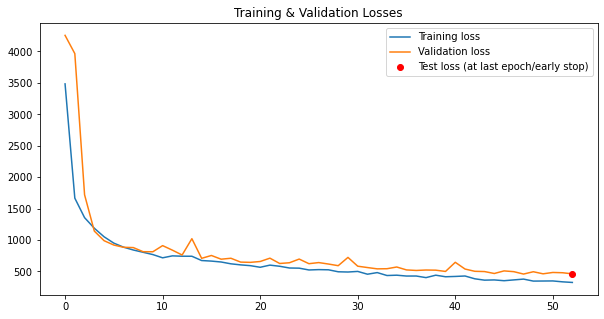

In [69]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [70]:
# Fetches the generated VAE Model model to import
model_path = f"models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 54 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.32it/s]


train -- accuracy: 0.696
val -- accuracy: 0.7308,  AUC: 0.6683
Epoch 1



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.50it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7308,  AUC: 0.6959
Epoch 2



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.40it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7308,  AUC: 0.7318
Epoch 3



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.37it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7308,  AUC: 0.7694
Epoch 4



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.38it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7308,  AUC: 0.7753
Epoch 5



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.42it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7308,  AUC: 0.7853
Epoch 6



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.37it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7308,  AUC: 0.7886
Epoch 7



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.41it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7308,  AUC: 0.797
Epoch 8



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.39it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7308,  AUC: 0.8062
Epoch 9



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.46it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7308,  AUC: 0.8145
Epoch 10



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.36it/s]


train -- accuracy: 0.7308
val -- accuracy: 0.7308,  AUC: 0.8296
Epoch 11



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.47it/s]


train -- accuracy: 0.7317
val -- accuracy: 0.7308,  AUC: 0.8287
Epoch 12



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.38it/s]


train -- accuracy: 0.7335
val -- accuracy: 0.7308,  AUC: 0.8388
Epoch 13



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.38it/s]


train -- accuracy: 0.7372
val -- accuracy: 0.7436,  AUC: 0.8421
Epoch 14



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.48it/s]


train -- accuracy: 0.739
val -- accuracy: 0.7308,  AUC: 0.8555
Epoch 15



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.43it/s]


train -- accuracy: 0.7399
val -- accuracy: 0.7436,  AUC: 0.8521
Epoch 16



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.39it/s]


train -- accuracy: 0.7473
val -- accuracy: 0.7821,  AUC: 0.8563
Epoch 17



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.37it/s]


train -- accuracy: 0.761
val -- accuracy: 0.7821,  AUC: 0.8563
Epoch 18



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.47it/s]


train -- accuracy: 0.7729
val -- accuracy: 0.8205,  AUC: 0.8655
Epoch 19



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.43it/s]


train -- accuracy: 0.7921
val -- accuracy: 0.7949,  AUC: 0.8647
test -- accuracy: 0.7756,  AUC: 0.8402


<Figure size 720x720 with 0 Axes>

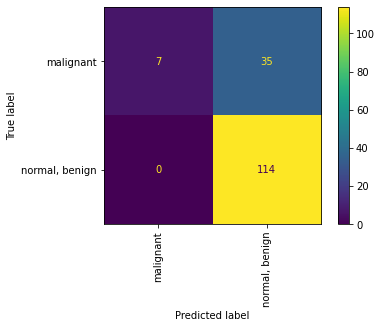

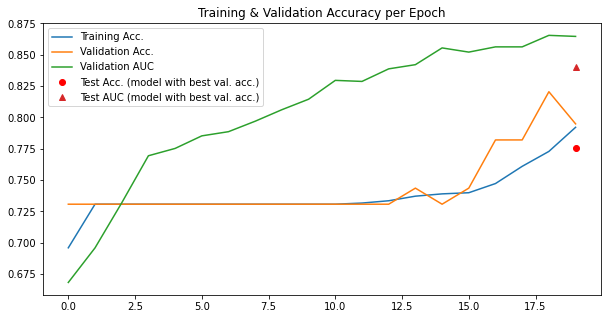

In [71]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [72]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.43it/s]


train -- accuracy: 0.4936
val -- accuracy: 0.6026,  AUC: 0.5397
Epoch 1



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.34it/s]


train -- accuracy: 0.5321
val -- accuracy: 0.6282,  AUC: 0.7469
Epoch 2



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.75it/s]


train -- accuracy: 0.6419
val -- accuracy: 0.7179,  AUC: 0.7987
Epoch 3



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 12.03it/s]


train -- accuracy: 0.619
val -- accuracy: 0.7564,  AUC: 0.8246
Epoch 4



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.77it/s]


train -- accuracy: 0.6419
val -- accuracy: 0.7692,  AUC: 0.8237
Epoch 5



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 12.08it/s]


train -- accuracy: 0.6456
val -- accuracy: 0.7821,  AUC: 0.8262
Epoch 6



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.58it/s]


train -- accuracy: 0.6465
val -- accuracy: 0.7179,  AUC: 0.8454
Epoch 7



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.48it/s]


train -- accuracy: 0.6438
val -- accuracy: 0.7821,  AUC: 0.8421
Epoch 8



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.54it/s]


train -- accuracy: 0.6465
val -- accuracy: 0.7949,  AUC: 0.8454
Epoch 9



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.05it/s]


train -- accuracy: 0.6502
val -- accuracy: 0.7949,  AUC: 0.8563
Epoch 10



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.63it/s]


train -- accuracy: 0.6749
val -- accuracy: 0.7949,  AUC: 0.8588
Epoch 11



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.85it/s]


train -- accuracy: 0.6877
val -- accuracy: 0.8205,  AUC: 0.8755
Epoch 12



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.71it/s]


train -- accuracy: 0.6786
val -- accuracy: 0.7821,  AUC: 0.878
Epoch 13



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.65it/s]


train -- accuracy: 0.6896
val -- accuracy: 0.859,  AUC: 0.9014
Epoch 14



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.19it/s]


train -- accuracy: 0.6987
val -- accuracy: 0.8718,  AUC: 0.9006
Epoch 15



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.00it/s]


train -- accuracy: 0.6923
val -- accuracy: 0.7949,  AUC: 0.8864
Epoch 16



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.88it/s]


train -- accuracy: 0.7289
val -- accuracy: 0.7821,  AUC: 0.8906
Epoch 17



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.14it/s]


train -- accuracy: 0.7079
val -- accuracy: 0.8205,  AUC: 0.8931
Epoch 18



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.31it/s]


train -- accuracy: 0.6841
val -- accuracy: 0.8205,  AUC: 0.8622
Epoch 19



100%|███████████████████████████████████████████| 18/18 [00:01<00:00, 11.47it/s]

train -- accuracy: 0.7198
val -- accuracy: 0.8333,  AUC: 0.8972
test -- accuracy: 0.8013,  AUC: 0.8693


<Figure size 720x720 with 0 Axes>

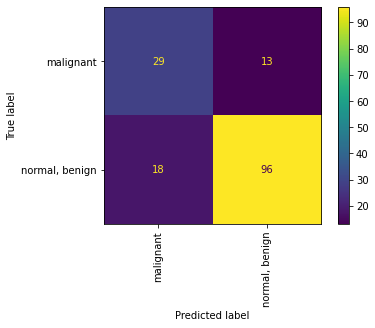

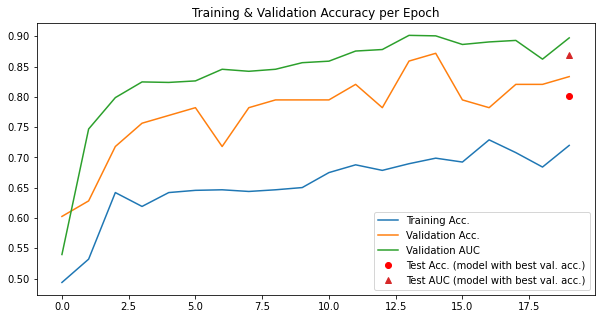

In [73]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### OrganaMNIST

#### Training the Joint VAE

In [74]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organamnist"
base_dataset = organamnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(283930., grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(9464.2676, grad_fn=<MseLossBackward>), 'Capacity_Loss': tensor(392.9321, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 3065.7760992759754
Validation set loss: 2455.924977
Train epoch 2 -- average loss: 2003.3358936717418
Validation set loss: 2127.960026
Train epoch 3 -- average loss: 1730.6649814249515
Validation set loss: 2028.614136
Train epoch 4 -- average loss: 1578.3111896141486
Validation set loss: 1887.00017
Train epoch 5 -- average loss: 1494.5320268219905
Validation set loss: 1886.420147
Train epoch 6 -- average loss: 1415.504350632392
Validation set loss: 1830.90806
Train epoch 7 -- average loss: 1347.461891159976
Validation set loss: 1810.040598
Train epoch 8 -- average loss: 1308.83884744784
Valida

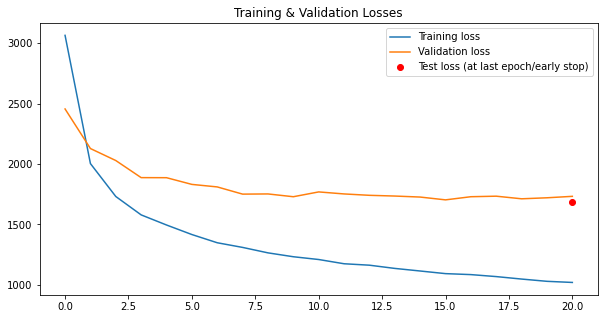

In [75]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [76]:
# Fetches the generated VAE Model model to import
model_path = f"models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 5
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1729 (5% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.83it/s]


train -- accuracy: 0.3712
val -- accuracy: 0.8365,  AUC: 0.986
Epoch 1



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.83it/s]


train -- accuracy: 0.5027
val -- accuracy: 0.9267,  AUC: 0.9964
Epoch 2



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.84it/s]


train -- accuracy: 0.5383
val -- accuracy: 0.9467,  AUC: 0.9988
Epoch 3



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.82it/s]


train -- accuracy: 0.5542
val -- accuracy: 0.9555,  AUC: 0.9989
Epoch 4



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.83it/s]


train -- accuracy: 0.5657
val -- accuracy: 0.9584,  AUC: 0.9993
Epoch 5



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.82it/s]


train -- accuracy: 0.5706
val -- accuracy: 0.9527,  AUC: 0.9992
Epoch 6



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.81it/s]


train -- accuracy: 0.5748
val -- accuracy: 0.964,  AUC: 0.9995
Epoch 7



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.82it/s]


train -- accuracy: 0.5793
val -- accuracy: 0.965,  AUC: 0.9995
Epoch 8



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.82it/s]


train -- accuracy: 0.5811
val -- accuracy: 0.9676,  AUC: 0.9995
Epoch 9



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.82it/s]


train -- accuracy: 0.583
val -- accuracy: 0.9618,  AUC: 0.9994
Epoch 10



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.83it/s]


train -- accuracy: 0.5839
val -- accuracy: 0.9652,  AUC: 0.9996
Epoch 11



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.81it/s]


train -- accuracy: 0.5849
val -- accuracy: 0.9676,  AUC: 0.9996
Epoch 12



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.82it/s]


train -- accuracy: 0.586
val -- accuracy: 0.9676,  AUC: 0.9995
Epoch 13



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.83it/s]


train -- accuracy: 0.5862
val -- accuracy: 0.971,  AUC: 0.9995
Epoch 14



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.80it/s]


train -- accuracy: 0.5869
val -- accuracy: 0.9704,  AUC: 0.9994
Epoch 15



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.83it/s]


train -- accuracy: 0.5871
val -- accuracy: 0.9704,  AUC: 0.9995
Epoch 16



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.81it/s]


train -- accuracy: 0.5875
val -- accuracy: 0.9693,  AUC: 0.9995
Epoch 17



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.82it/s]


train -- accuracy: 0.5876
val -- accuracy: 0.9666,  AUC: 0.9995
Epoch 18



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.80it/s]


train -- accuracy: 0.5875
val -- accuracy: 0.9649,  AUC: 0.9994
Epoch 19



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.83it/s]


train -- accuracy: 0.5879
val -- accuracy: 0.9695,  AUC: 0.9996
test -- accuracy: 0.8808,  AUC: 0.9898


<Figure size 720x720 with 0 Axes>

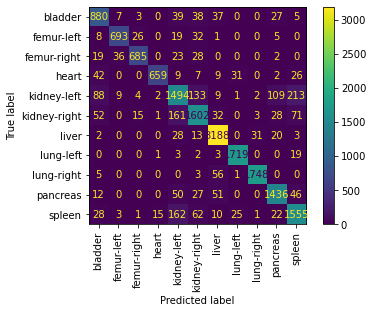

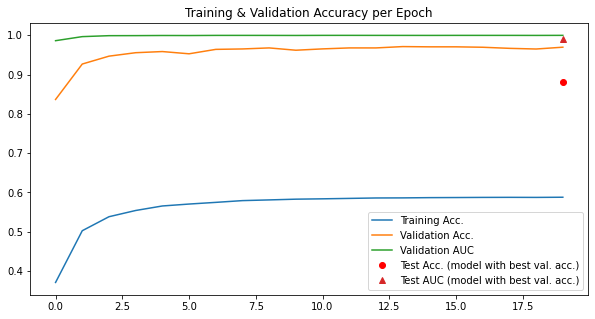

In [77]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [78]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.84it/s]


train -- accuracy: 0.3508
val -- accuracy: 0.8863,  AUC: 0.9921
Epoch 1



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.85it/s]


train -- accuracy: 0.4771
val -- accuracy: 0.9393,  AUC: 0.9979
Epoch 2



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.76it/s]


train -- accuracy: 0.5014
val -- accuracy: 0.9536,  AUC: 0.9984
Epoch 3



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.80it/s]


train -- accuracy: 0.5151
val -- accuracy: 0.943,  AUC: 0.9984
Epoch 4



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.82it/s]


train -- accuracy: 0.5238
val -- accuracy: 0.9663,  AUC: 0.9991
Epoch 5



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.81it/s]


train -- accuracy: 0.5287
val -- accuracy: 0.9636,  AUC: 0.9991
Epoch 6



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.75it/s]


train -- accuracy: 0.531
val -- accuracy: 0.9655,  AUC: 0.9989
Epoch 7



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.80it/s]


train -- accuracy: 0.5354
val -- accuracy: 0.9689,  AUC: 0.9992
Epoch 8



100%|███████████████████████████████████████| 1081/1081 [01:41<00:00, 10.69it/s]


train -- accuracy: 0.5346
val -- accuracy: 0.9676,  AUC: 0.9993
Epoch 9



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.81it/s]


train -- accuracy: 0.5392
val -- accuracy: 0.97,  AUC: 0.9993
Epoch 10



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.82it/s]


train -- accuracy: 0.5419
val -- accuracy: 0.969,  AUC: 0.9993
Epoch 11



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.80it/s]


train -- accuracy: 0.5419
val -- accuracy: 0.9559,  AUC: 0.9989
Epoch 12



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.82it/s]


train -- accuracy: 0.5424
val -- accuracy: 0.9656,  AUC: 0.9991
Epoch 13



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.78it/s]


train -- accuracy: 0.5421
val -- accuracy: 0.9658,  AUC: 0.9991
Epoch 14



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.84it/s]


train -- accuracy: 0.5434
val -- accuracy: 0.9664,  AUC: 0.9992
Epoch 15



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.81it/s]


train -- accuracy: 0.5437
val -- accuracy: 0.9667,  AUC: 0.9993
Epoch 16



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.84it/s]


train -- accuracy: 0.5447
val -- accuracy: 0.9681,  AUC: 0.9993
Epoch 17



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.78it/s]


train -- accuracy: 0.5431
val -- accuracy: 0.9663,  AUC: 0.9991
Epoch 18



100%|███████████████████████████████████████| 1081/1081 [01:39<00:00, 10.91it/s]


train -- accuracy: 0.5487
val -- accuracy: 0.9673,  AUC: 0.9991
Epoch 19



100%|███████████████████████████████████████| 1081/1081 [01:40<00:00, 10.75it/s]


train -- accuracy: 0.5407
val -- accuracy: 0.9689,  AUC: 0.9993
test -- accuracy: 0.8833,  AUC: 0.9906


<Figure size 720x720 with 0 Axes>

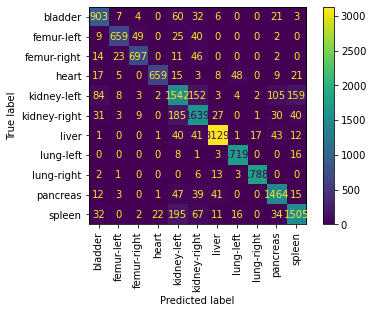

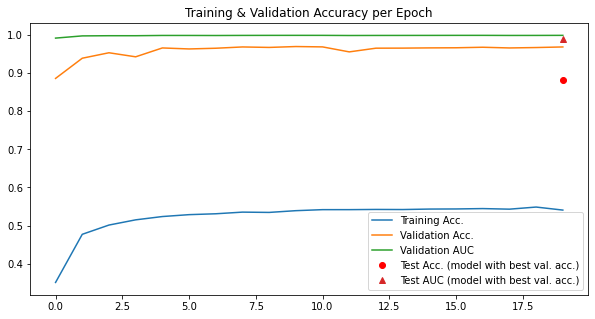

In [79]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### OrgancMNIST

#### Training the Joint VAE

In [80]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organcmnist"
base_dataset = organcmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(271060.9062, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(9035.2998, grad_fn=<MseLossBackward>), 'Capacity_Loss': tensor(378.7268, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 4317.1855210336535
Validation set loss: 3316.683444
Train epoch 2 -- average loss: 2798.82791796875
Validation set loss: 2772.534836
Train epoch 3 -- average loss: 2376.2570599459136
Validation set loss: 2588.626852
Train epoch 4 -- average loss: 2139.9788138521635
Validation set loss: 2247.640901
Train epoch 5 -- average loss: 2020.4926045673076
Validation set loss: 2219.45266
Train epoch 6 -- average loss: 1880.839583533654
Validation set loss: 2187.922329
Train epoch 7 -- average loss: 1806.3087841045674
Validation set loss: 2033.994769
Train epoch 8 -- average loss: 1722.6685110426683


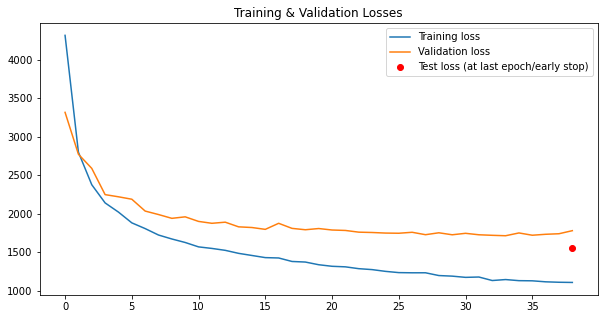

In [81]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [82]:
# Fetches the generated VAE Model model to import
model_path = f"models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1300 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.86it/s]


train -- accuracy: 0.2989
val -- accuracy: 0.6225,  AUC: 0.9614
Epoch 1



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.86it/s]


train -- accuracy: 0.4118
val -- accuracy: 0.7437,  AUC: 0.9826
Epoch 2



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.86it/s]


train -- accuracy: 0.496
val -- accuracy: 0.8901,  AUC: 0.9928
Epoch 3



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.85it/s]


train -- accuracy: 0.5291
val -- accuracy: 0.9126,  AUC: 0.996
Epoch 4



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.84it/s]


train -- accuracy: 0.5457
val -- accuracy: 0.9181,  AUC: 0.9963
Epoch 5



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.84it/s]


train -- accuracy: 0.5585
val -- accuracy: 0.9398,  AUC: 0.9973
Epoch 6



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.86it/s]


train -- accuracy: 0.5642
val -- accuracy: 0.9411,  AUC: 0.9973
Epoch 7



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.82it/s]


train -- accuracy: 0.5724
val -- accuracy: 0.9427,  AUC: 0.9975
Epoch 8



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.87it/s]


train -- accuracy: 0.5766
val -- accuracy: 0.9431,  AUC: 0.9982
Epoch 9



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.88it/s]


train -- accuracy: 0.5823
val -- accuracy: 0.9465,  AUC: 0.9982
Epoch 10



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.85it/s]


train -- accuracy: 0.5847
val -- accuracy: 0.9582,  AUC: 0.9988
Epoch 11



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.88it/s]


train -- accuracy: 0.5879
val -- accuracy: 0.9532,  AUC: 0.9987
Epoch 12



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.83it/s]


train -- accuracy: 0.5907
val -- accuracy: 0.9523,  AUC: 0.9985
Epoch 13



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.83it/s]


train -- accuracy: 0.5943
val -- accuracy: 0.9419,  AUC: 0.998
Epoch 14



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.88it/s]


train -- accuracy: 0.598
val -- accuracy: 0.9477,  AUC: 0.9984
Epoch 15



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.85it/s]


train -- accuracy: 0.5982
val -- accuracy: 0.9565,  AUC: 0.9987
Epoch 16



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.85it/s]


train -- accuracy: 0.6
val -- accuracy: 0.9569,  AUC: 0.9985
Epoch 17



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.85it/s]


train -- accuracy: 0.6024
val -- accuracy: 0.9594,  AUC: 0.9989
Epoch 18



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.87it/s]


train -- accuracy: 0.6026
val -- accuracy: 0.9574,  AUC: 0.9987
Epoch 19



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.88it/s]


train -- accuracy: 0.6047
val -- accuracy: 0.9544,  AUC: 0.9986
test -- accuracy: 0.8587,  AUC: 0.9843


<Figure size 720x720 with 0 Axes>

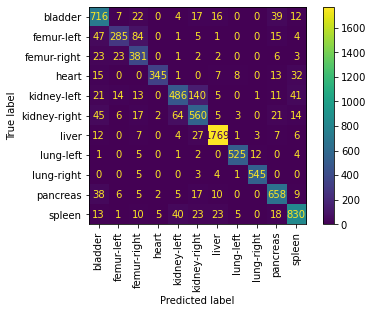

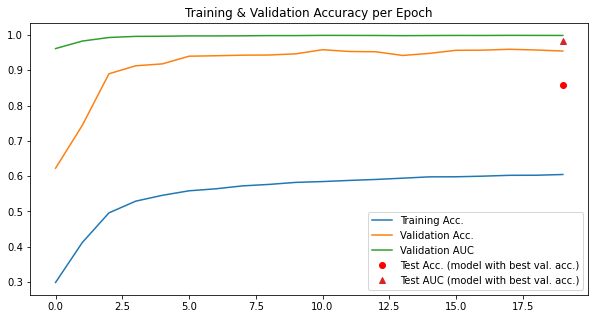

In [83]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [84]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.78it/s]


train -- accuracy: 0.2706
val -- accuracy: 0.7224,  AUC: 0.9582
Epoch 1



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.83it/s]


train -- accuracy: 0.3852
val -- accuracy: 0.8424,  AUC: 0.9879
Epoch 2



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.77it/s]


train -- accuracy: 0.441
val -- accuracy: 0.903,  AUC: 0.9932
Epoch 3



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.89it/s]


train -- accuracy: 0.4631
val -- accuracy: 0.9231,  AUC: 0.9957
Epoch 4



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.77it/s]


train -- accuracy: 0.4767
val -- accuracy: 0.9164,  AUC: 0.996
Epoch 5



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.90it/s]


train -- accuracy: 0.4939
val -- accuracy: 0.9369,  AUC: 0.997
Epoch 6



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.86it/s]


train -- accuracy: 0.4963
val -- accuracy: 0.9323,  AUC: 0.9973
Epoch 7



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.88it/s]


train -- accuracy: 0.5053
val -- accuracy: 0.9335,  AUC: 0.9975
Epoch 8



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.80it/s]


train -- accuracy: 0.5057
val -- accuracy: 0.9352,  AUC: 0.9978
Epoch 9



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.76it/s]


train -- accuracy: 0.507
val -- accuracy: 0.9406,  AUC: 0.9981
Epoch 10



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.72it/s]


train -- accuracy: 0.5118
val -- accuracy: 0.9377,  AUC: 0.9976
Epoch 11



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.73it/s]


train -- accuracy: 0.5153
val -- accuracy: 0.9394,  AUC: 0.9977
Epoch 12



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.79it/s]


train -- accuracy: 0.5214
val -- accuracy: 0.9365,  AUC: 0.9977
Epoch 13



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.80it/s]


train -- accuracy: 0.525
val -- accuracy: 0.9385,  AUC: 0.9979
Epoch 14



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.72it/s]


train -- accuracy: 0.5241
val -- accuracy: 0.9365,  AUC: 0.9977
Epoch 15



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.89it/s]


train -- accuracy: 0.5335
val -- accuracy: 0.9473,  AUC: 0.9979
Epoch 16



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.79it/s]


train -- accuracy: 0.5303
val -- accuracy: 0.9398,  AUC: 0.9979
Epoch 17



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.78it/s]


train -- accuracy: 0.5336
val -- accuracy: 0.9348,  AUC: 0.998
Epoch 18



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.76it/s]


train -- accuracy: 0.5344
val -- accuracy: 0.9457,  AUC: 0.9979
Epoch 19



100%|█████████████████████████████████████████| 407/407 [00:37<00:00, 10.80it/s]


train -- accuracy: 0.5375
val -- accuracy: 0.9419,  AUC: 0.998
test -- accuracy: 0.8527,  AUC: 0.9854


<Figure size 720x720 with 0 Axes>

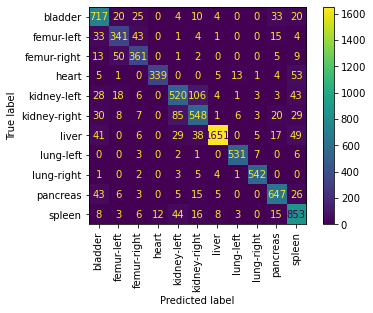

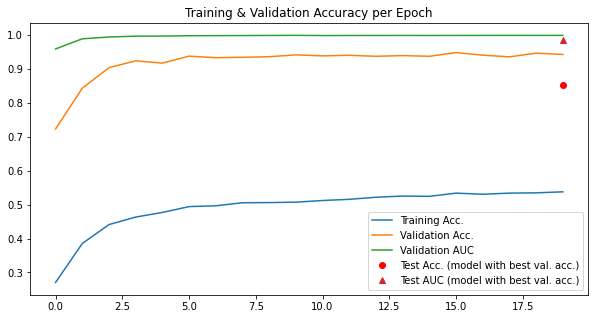

In [85]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

### OrgansMNIST

#### Training the Joint VAE

In [86]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organsmnist"
base_dataset = organsmnist_noWRS_noGDA

# Retrieves the dataset parameters
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3]
val_loader = base_dataset[5]
test_loader = base_dataset[4]

Testing Joint Variational Autoencoder:
Clearing CUDA Pytorch Cache
Model Output size: torch.Size([10, 1, 28, 28])
Forward pass test:  True
{'loss': tensor(251039.6875, grad_fn=<AddBackward0>), 'Reconstruction_Loss': tensor(8367.9229, grad_fn=<MseLossBackward>), 'Capacity_Loss': tensor(398.6797, grad_fn=<AddBackward0>)}
Loss test:  True
Cuda device:  cuda
Training phase:
Train epoch 1 -- average loss: 3572.500124417145
Validation set loss: 2732.211517
Train epoch 2 -- average loss: 2392.418255694046
Validation set loss: 2366.393696
Train epoch 3 -- average loss: 2055.826065391858
Validation set loss: 2099.21807
Train epoch 4 -- average loss: 1895.6876759774032
Validation set loss: 2033.213445
Train epoch 5 -- average loss: 1748.2257162392395
Validation set loss: 1909.392545
Train epoch 6 -- average loss: 1658.188864665531
Validation set loss: 1861.780724
Train epoch 7 -- average loss: 1594.444318283716
Validation set loss: 1788.440795
Train epoch 8 -- average loss: 1590.2977022058824
Va

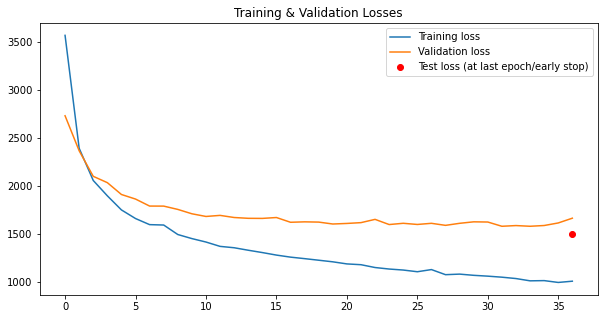

In [87]:
# Runs the Joint VAE
_, _, _, _ = run_encoder_pipeline(
    train_loader, val_loader, test_loader,  n_channels, 
    latent_dims, categorical_dims=categorical_dims,
    epochs=epochs, name_dataset=name_dataset, 
    output_intermediary_info=False, model_type="JointVAE"
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [88]:
# Fetches the generated VAE Model model to import
model_path = f"models/JointVAE/{name_dataset}/"
model = [x for x in os.listdir(model_path) if x[-4:]==".pth"][-1]
model_path += model

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=False
)

Number of generated images: 1394 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.83it/s]


train -- accuracy: 0.2911
val -- accuracy: 0.4735,  AUC: 0.9235
Epoch 1



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.80it/s]


train -- accuracy: 0.3853
val -- accuracy: 0.5983,  AUC: 0.9595
Epoch 2



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.81it/s]


train -- accuracy: 0.449
val -- accuracy: 0.7084,  AUC: 0.9745
Epoch 3



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.81it/s]


train -- accuracy: 0.4796
val -- accuracy: 0.7614,  AUC: 0.9816
Epoch 4



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.82it/s]


train -- accuracy: 0.495
val -- accuracy: 0.8046,  AUC: 0.9834
Epoch 5



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.84it/s]


train -- accuracy: 0.5101
val -- accuracy: 0.794,  AUC: 0.984
Epoch 6



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.83it/s]


train -- accuracy: 0.5228
val -- accuracy: 0.7826,  AUC: 0.9869
Epoch 7



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.82it/s]


train -- accuracy: 0.5333
val -- accuracy: 0.856,  AUC: 0.9897
Epoch 8



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.83it/s]


train -- accuracy: 0.544
val -- accuracy: 0.8462,  AUC: 0.9896
Epoch 9



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.84it/s]


train -- accuracy: 0.5529
val -- accuracy: 0.8426,  AUC: 0.9899
Epoch 10



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.81it/s]


train -- accuracy: 0.5595
val -- accuracy: 0.8487,  AUC: 0.9888
Epoch 11



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.84it/s]


train -- accuracy: 0.5651
val -- accuracy: 0.8654,  AUC: 0.9908
Epoch 12



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.80it/s]


train -- accuracy: 0.5718
val -- accuracy: 0.8613,  AUC: 0.9901
Epoch 13



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.80it/s]


train -- accuracy: 0.5779
val -- accuracy: 0.8736,  AUC: 0.9908
Epoch 14



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.83it/s]


train -- accuracy: 0.5811
val -- accuracy: 0.852,  AUC: 0.99
Epoch 15



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.83it/s]


train -- accuracy: 0.5857
val -- accuracy: 0.8683,  AUC: 0.9906
Epoch 16



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.82it/s]


train -- accuracy: 0.5916
val -- accuracy: 0.8532,  AUC: 0.9899
Epoch 17



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.84it/s]


train -- accuracy: 0.5943
val -- accuracy: 0.8483,  AUC: 0.9896
Epoch 18



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.82it/s]


train -- accuracy: 0.5959
val -- accuracy: 0.8467,  AUC: 0.9896
Epoch 19



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.80it/s]


train -- accuracy: 0.5989
val -- accuracy: 0.8458,  AUC: 0.9885
test -- accuracy: 0.6966,  AUC: 0.9586


<Figure size 720x720 with 0 Axes>

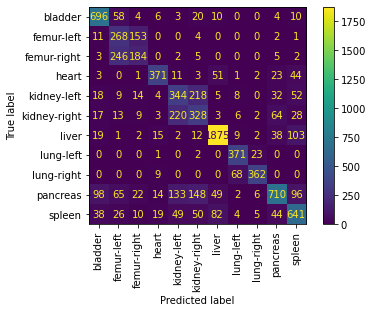

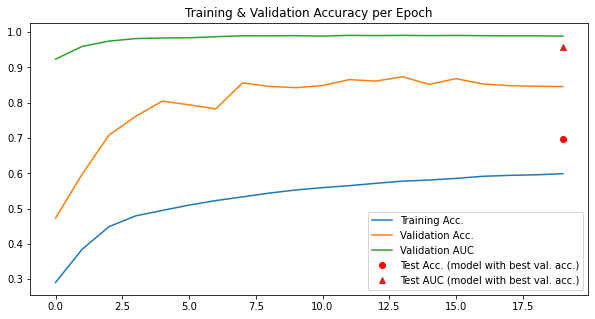

In [89]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [90]:
# Creates the augmented dataloader
jointVAE_loader = generate_augmented_dataset_jointVAE(
    n_channels, latent_dims, categorical_dims, model_path, 
    base_dataset[0], 64, test_loader, val_loader, 
    n_generated_images, weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.88it/s]


train -- accuracy: 0.2159
val -- accuracy: 0.5909,  AUC: 0.9208
Epoch 1



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.82it/s]


train -- accuracy: 0.3039
val -- accuracy: 0.6892,  AUC: 0.9537
Epoch 2



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.84it/s]


train -- accuracy: 0.3519
val -- accuracy: 0.7724,  AUC: 0.9759
Epoch 3



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.84it/s]


train -- accuracy: 0.3818
val -- accuracy: 0.7708,  AUC: 0.9801
Epoch 4



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.88it/s]


train -- accuracy: 0.4051
val -- accuracy: 0.7586,  AUC: 0.9829
Epoch 5



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.79it/s]


train -- accuracy: 0.4165
val -- accuracy: 0.8409,  AUC: 0.9882
Epoch 6



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.75it/s]


train -- accuracy: 0.4249
val -- accuracy: 0.7798,  AUC: 0.9866
Epoch 7



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.86it/s]


train -- accuracy: 0.4399
val -- accuracy: 0.8503,  AUC: 0.989
Epoch 8



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.65it/s]


train -- accuracy: 0.453
val -- accuracy: 0.8446,  AUC: 0.9892
Epoch 9



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.79it/s]


train -- accuracy: 0.4589
val -- accuracy: 0.8577,  AUC: 0.9904
Epoch 10



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.83it/s]


train -- accuracy: 0.4659
val -- accuracy: 0.8352,  AUC: 0.9899
Epoch 11



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.88it/s]


train -- accuracy: 0.4765
val -- accuracy: 0.8467,  AUC: 0.9906
Epoch 12



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.85it/s]


train -- accuracy: 0.4826
val -- accuracy: 0.8715,  AUC: 0.9904
Epoch 13



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.84it/s]


train -- accuracy: 0.4903
val -- accuracy: 0.8597,  AUC: 0.9902
Epoch 14



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.84it/s]


train -- accuracy: 0.491
val -- accuracy: 0.8487,  AUC: 0.9903
Epoch 15



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.82it/s]


train -- accuracy: 0.4991
val -- accuracy: 0.8675,  AUC: 0.9902
Epoch 16



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.86it/s]


train -- accuracy: 0.5093
val -- accuracy: 0.8707,  AUC: 0.991
Epoch 17



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.81it/s]


train -- accuracy: 0.5109
val -- accuracy: 0.8515,  AUC: 0.9902
Epoch 18



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.75it/s]


train -- accuracy: 0.5137
val -- accuracy: 0.8389,  AUC: 0.9905
Epoch 19



100%|█████████████████████████████████████████| 436/436 [00:40<00:00, 10.73it/s]


train -- accuracy: 0.5172
val -- accuracy: 0.865,  AUC: 0.9907
test -- accuracy: 0.6886,  AUC: 0.956


<Figure size 720x720 with 0 Axes>

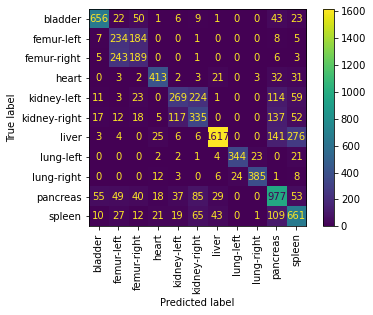

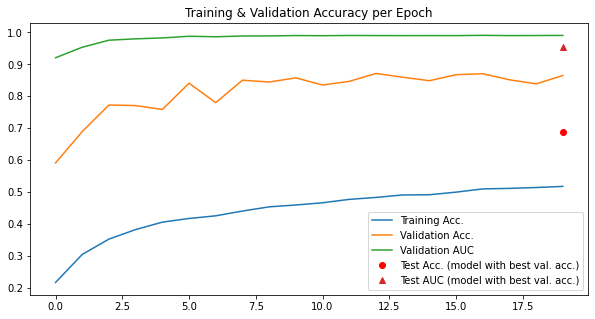

In [91]:
# Runs the classifier again 
clf = run_classifier_pipeline(name_dataset, info_flags, jointVAE_loader)

## 6. Training a Conditional Generative Adversarial Network 

We train a Conditional Generative Adversarial Network Autoencoder for data augmentation for each of the datasets. 

For each dataset, we then retrain the underlying baseline classifier.

In [92]:
# Declares the number of epochs and the model's latent dimensions
latent_dims = 128
epochs = 100

### PathMNIST

#### Training the Conditional GAN

In [93]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pathmnist"
base_dataset = pathmnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Epoch 1 of 100


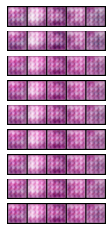

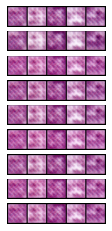

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 81.45954203605652 , Gen Loss: 3.1665535829370195 Disc Loss: 0.3257727904226299
Epoch 2 of 100


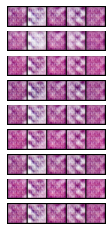

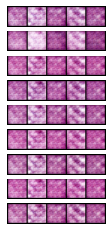

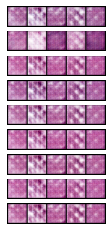

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 82.05914497375488 , Gen Loss: 3.5568903756833636 Disc Loss: 0.38428908472320994
Epoch 3 of 100


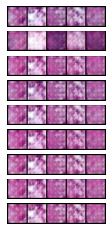

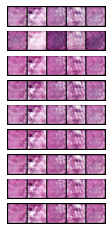

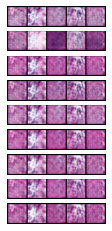

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 81.95454287528992 , Gen Loss: 1.6515572567114094 Disc Loss: 0.4535445064919552
Epoch 4 of 100


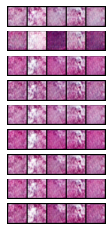

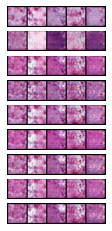

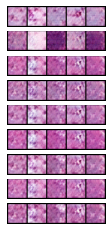

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_4.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_4.pth
Epoch: 4, Duration: 81.86242270469666 , Gen Loss: 1.6872168276923418 Disc Loss: 0.4290339119238633
Epoch 5 of 100


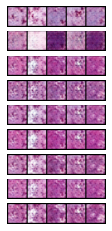

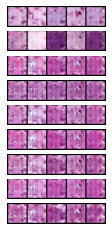

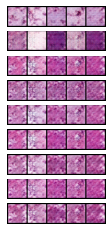

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 82.02887916564941 , Gen Loss: 1.8175148062136095 Disc Loss: 0.40606401083103694
Epoch 6 of 100


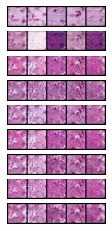

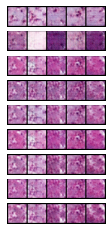

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 81.71557140350342 , Gen Loss: 1.8085315944597538 Disc Loss: 0.3978667281045824
Epoch 7 of 100


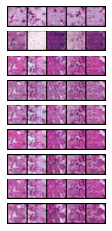

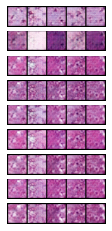

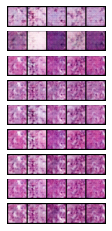

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 82.63158965110779 , Gen Loss: 1.862979847715454 Disc Loss: 0.38543674857771454
Epoch 8 of 100


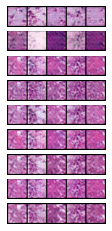

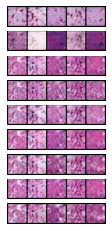

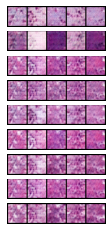

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_8.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_8.pth
Epoch: 8, Duration: 82.22926211357117 , Gen Loss: 1.8986105979710208 Disc Loss: 0.3811799621649851
Epoch 9 of 100


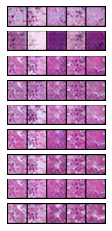

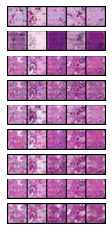

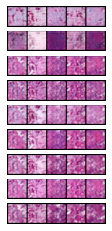

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_9.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_9.pth
Epoch: 9, Duration: 82.02432560920715 , Gen Loss: 1.9032220876483399 Disc Loss: 0.38027193569714207
Epoch 10 of 100


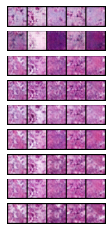

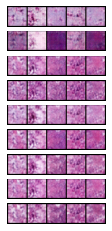

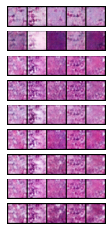

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 81.97506213188171 , Gen Loss: 1.9561188830614693 Disc Loss: 0.3733887304713543
Epoch 11 of 100


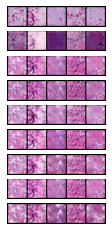

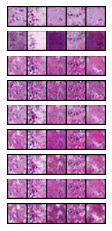

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 81.59835815429688 , Gen Loss: 1.9367546543735277 Disc Loss: 0.3784281471537624
Epoch 12 of 100


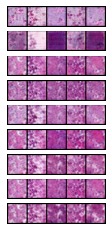

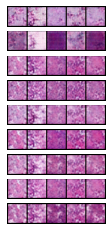

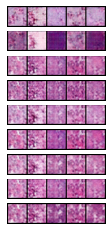

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 81.89212799072266 , Gen Loss: 1.977543272756567 Disc Loss: 0.3736690380683586
Epoch 13 of 100


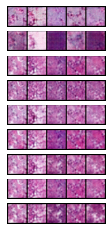

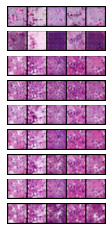

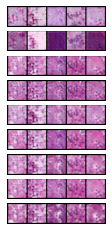

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_13.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_13.pth
Epoch: 13, Duration: 81.92568802833557 , Gen Loss: 2.0007585406573627 Disc Loss: 0.37087928734332637
Epoch 14 of 100


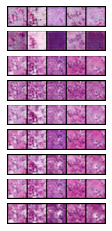

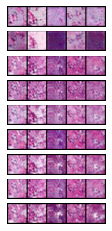

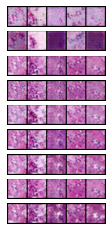

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 82.01161360740662 , Gen Loss: 1.9563437194430864 Disc Loss: 0.3781456693214143
Epoch 15 of 100


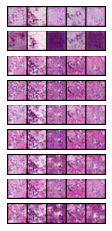

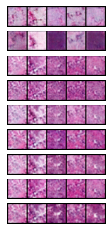

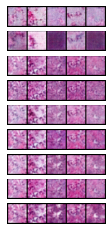

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 82.02199339866638 , Gen Loss: 1.9725484327081204 Disc Loss: 0.36884660151562293
Epoch 16 of 100


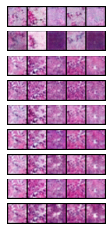

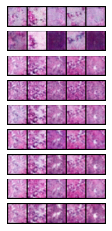

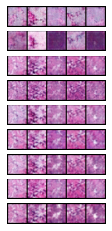

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 81.97151041030884 , Gen Loss: 2.028364107849238 Disc Loss: 0.36337522119038623
Epoch 17 of 100


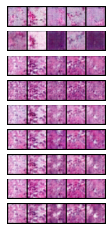

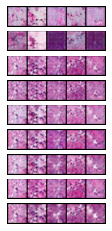

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_17.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_17.pth
Epoch: 17, Duration: 81.49968528747559 , Gen Loss: 2.0547076397839903 Disc Loss: 0.3537353396262056
Epoch 18 of 100


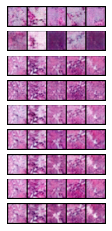

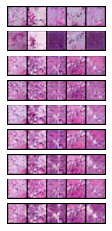

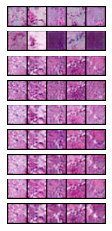

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_18.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_18.pth
Epoch: 18, Duration: 81.99917578697205 , Gen Loss: 2.08870394239744 Disc Loss: 0.3500194843729166
Epoch 19 of 100


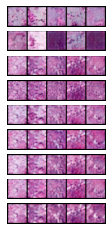

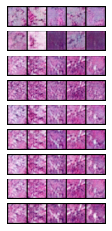

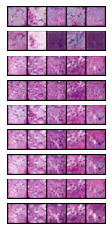

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 81.86967396736145 , Gen Loss: 2.0805139950664473 Disc Loss: 0.34816721020934266
Epoch 20 of 100


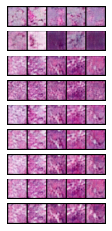

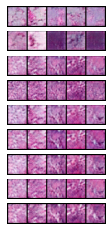

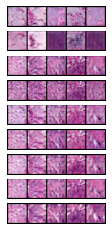

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 81.82054591178894 , Gen Loss: 2.073251345893151 Disc Loss: 0.3505663185724921
Epoch 21 of 100


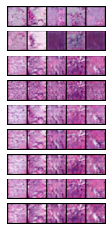

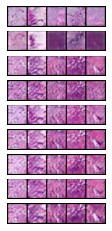

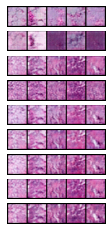

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 81.96624875068665 , Gen Loss: 2.0916203914618428 Disc Loss: 0.3510333098137695
Epoch 22 of 100


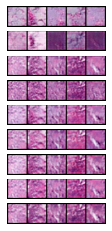

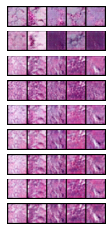

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_22.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_22.pth
Epoch: 22, Duration: 81.66969728469849 , Gen Loss: 2.111055283012578 Disc Loss: 0.35093768924452196
Epoch 23 of 100


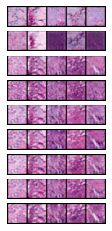

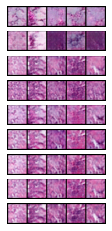

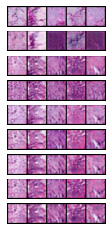

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 81.84365105628967 , Gen Loss: 2.1433070636472733 Disc Loss: 0.3532818472487666
Epoch 24 of 100


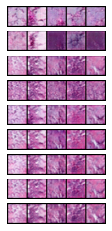

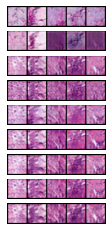

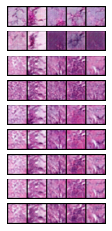

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_24.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_24.pth
Epoch: 24, Duration: 81.92006993293762 , Gen Loss: 2.09942403690164 Disc Loss: 0.3634199931455287
Epoch 25 of 100


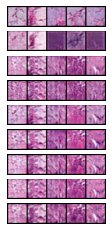

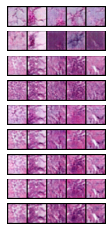

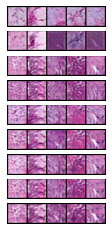

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 81.96955704689026 , Gen Loss: 2.0983330161896085 Disc Loss: 0.3660543767222988
Epoch 26 of 100


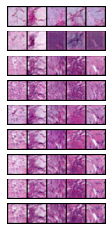

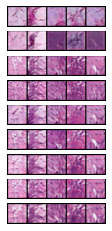

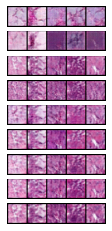

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_26.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_26.pth
Epoch: 26, Duration: 81.90071964263916 , Gen Loss: 2.124256737799458 Disc Loss: 0.367558827267323
Epoch 27 of 100


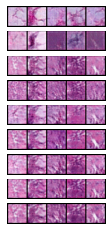

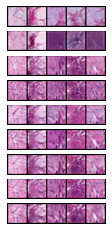

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 81.53042316436768 , Gen Loss: 2.139021456509178 Disc Loss: 0.3733604306024712
Epoch 28 of 100


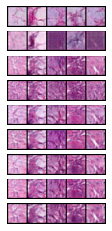

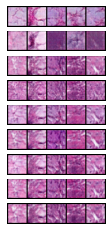

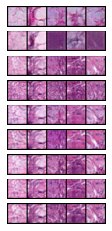

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 81.89347100257874 , Gen Loss: 2.1236396964865105 Disc Loss: 0.37952342152706786
Epoch 29 of 100


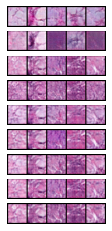

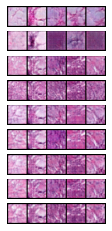

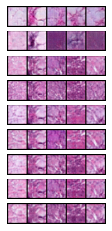

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 81.88316321372986 , Gen Loss: 2.1850478076803412 Disc Loss: 0.37637258704553533
Epoch 30 of 100


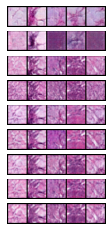

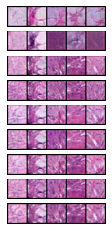

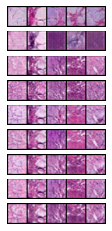

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 81.92262244224548 , Gen Loss: 2.1359701056158054 Disc Loss: 0.3843853129583537
Epoch 31 of 100


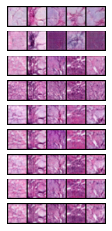

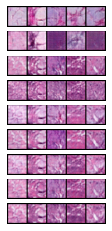

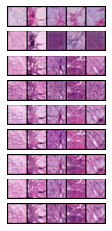

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_31.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_31.pth
Epoch: 31, Duration: 82.61556124687195 , Gen Loss: 2.2428666968531936 Disc Loss: 0.3777909226521179
Epoch 32 of 100


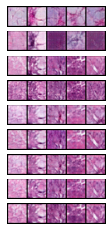

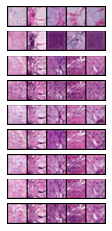

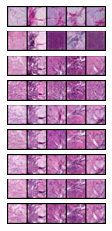

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_32.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_32.pth
Epoch: 32, Duration: 83.17716670036316 , Gen Loss: 2.2520710989932886 Disc Loss: 0.3826564600787813
Epoch 33 of 100


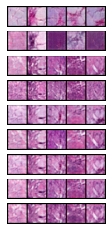

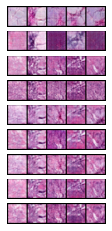

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_33.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_33.pth
Epoch: 33, Duration: 81.69835662841797 , Gen Loss: 2.2897080148006577 Disc Loss: 0.3815235972293213
Epoch 34 of 100


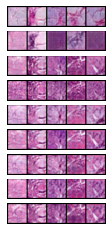

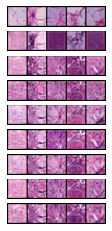

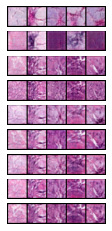

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 82.14932775497437 , Gen Loss: 2.3390424991110716 Disc Loss: 0.37824827804846883
Epoch 35 of 100


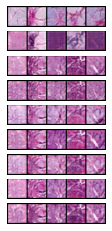

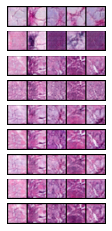

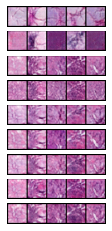

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 82.43347215652466 , Gen Loss: 2.387288219754211 Disc Loss: 0.3764972887683897
Epoch 36 of 100


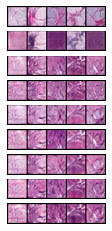

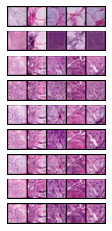

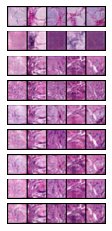

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_36.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_36.pth
Epoch: 36, Duration: 82.04009938240051 , Gen Loss: 2.4058352246210943 Disc Loss: 0.38017974409973776
Epoch 37 of 100


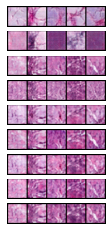

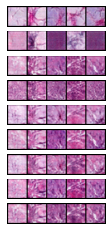

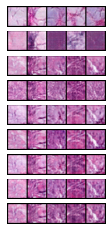

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 82.21668791770935 , Gen Loss: 2.4679572564336194 Disc Loss: 0.37762229536590514
Epoch 38 of 100


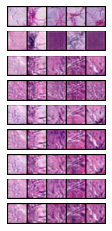

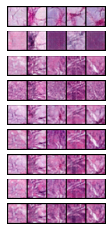

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 81.99141836166382 , Gen Loss: 2.4591271764856217 Disc Loss: 0.38203729193519714
Epoch 39 of 100


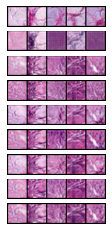

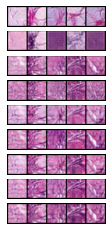

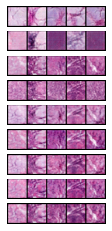

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 81.22789263725281 , Gen Loss: 2.5387885294901995 Disc Loss: 0.3739572019173074
Epoch 40 of 100


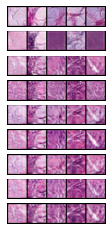

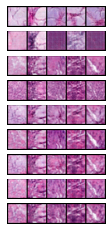

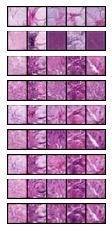

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_40.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_40.pth
Epoch: 40, Duration: 81.04565405845642 , Gen Loss: 2.6010206356393617 Disc Loss: 0.36987828799335526
Epoch 41 of 100


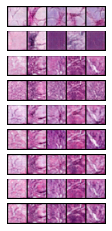

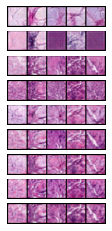

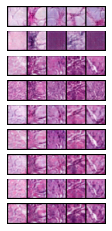

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 81.15349745750427 , Gen Loss: 2.6668459570425354 Disc Loss: 0.37149663248922177
Epoch 42 of 100


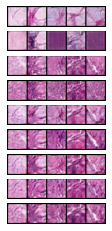

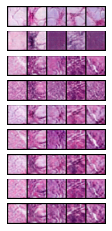

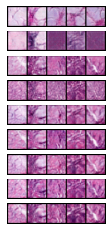

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 81.11571216583252 , Gen Loss: 2.6631766967420774 Disc Loss: 0.3732908962620561
Epoch 43 of 100


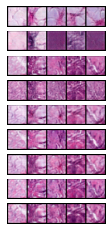

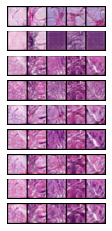

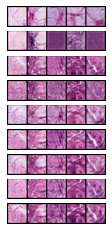

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 81.17608284950256 , Gen Loss: 2.7638450597804347 Disc Loss: 0.36946242749677766
Epoch 44 of 100


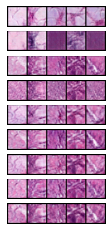

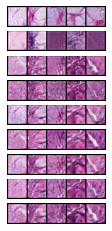

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_44.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_44.pth
Epoch: 44, Duration: 80.7347719669342 , Gen Loss: 2.7006625641695186 Disc Loss: 0.37222214216465177
Epoch 45 of 100


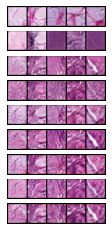

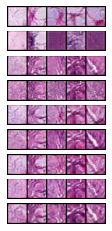

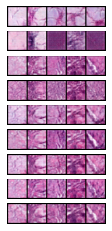

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_45.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_45.pth
Epoch: 45, Duration: 81.04850053787231 , Gen Loss: 2.6730283498711054 Disc Loss: 0.3772037003727943
Epoch 46 of 100


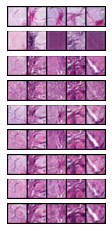

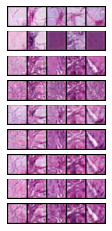

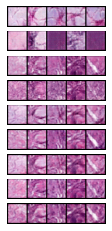

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 81.05697512626648 , Gen Loss: 2.8034803282923684 Disc Loss: 0.36876595557024755
Epoch 47 of 100


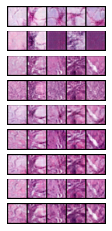

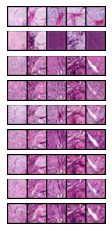

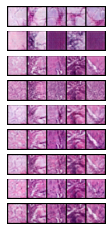

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 81.17785286903381 , Gen Loss: 2.807709509311525 Disc Loss: 0.36956386429674654
Epoch 48 of 100


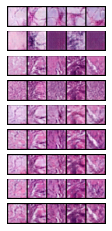

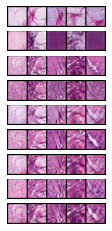

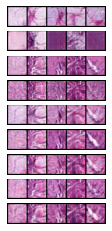

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 80.99405121803284 , Gen Loss: 2.8225705864705097 Disc Loss: 0.3719441350171119
Epoch 49 of 100


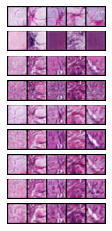

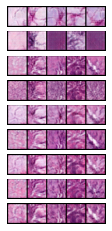

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_49.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_49.pth
Epoch: 49, Duration: 80.77819895744324 , Gen Loss: 2.8894171338170587 Disc Loss: 0.3734728053885728
Epoch 50 of 100


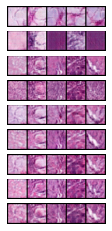

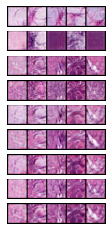

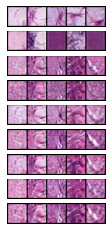

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 81.21535134315491 , Gen Loss: 2.9431259444864217 Disc Loss: 0.3644313445180897
Epoch 51 of 100


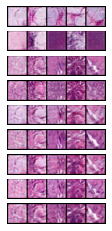

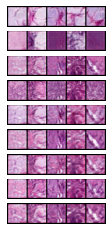

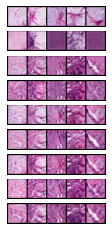

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 81.13130974769592 , Gen Loss: 2.855638201975643 Disc Loss: 0.3709208256478066
Epoch 52 of 100


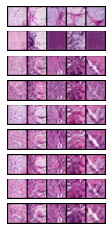

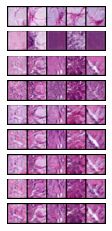

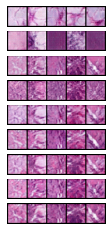

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 81.07161402702332 , Gen Loss: 3.0485497272100983 Disc Loss: 0.36260977918463044
Epoch 53 of 100


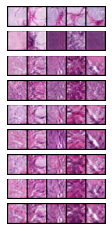

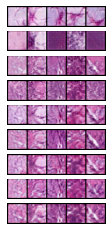

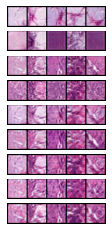

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 81.0831286907196 , Gen Loss: 2.9798685497133204 Disc Loss: 0.3670279877022312
Epoch 54 of 100


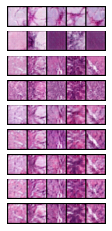

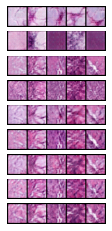

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 80.72299671173096 , Gen Loss: 2.9117248961064934 Disc Loss: 0.3703859928496822
Epoch 55 of 100


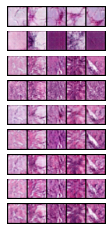

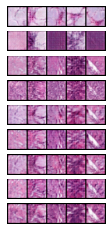

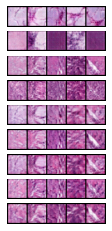

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 81.13054752349854 , Gen Loss: 3.0132422552113427 Disc Loss: 0.3677147369744211
Epoch 56 of 100


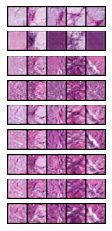

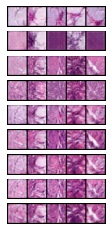

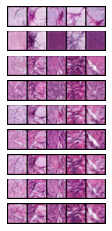

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 81.08954572677612 , Gen Loss: 3.0731532512556115 Disc Loss: 0.36408352089954
Epoch 57 of 100


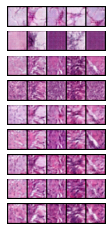

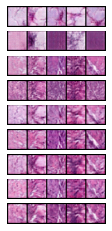

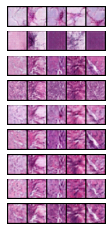

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 81.15980839729309 , Gen Loss: 2.9843986121605406 Disc Loss: 0.369350399948331
Epoch 58 of 100


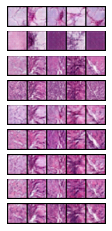

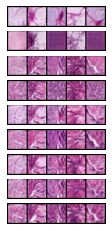

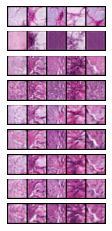

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_58.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_58.pth
Epoch: 58, Duration: 81.08888864517212 , Gen Loss: 2.997578364593982 Disc Loss: 0.3723882085731588
Epoch 59 of 100


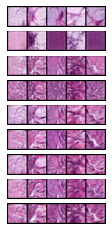

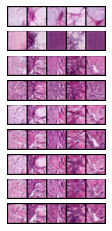

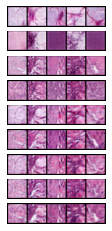

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_59.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_59.pth
Epoch: 59, Duration: 81.16670322418213 , Gen Loss: 2.928116944086404 Disc Loss: 0.37755974918329704
Epoch 60 of 100


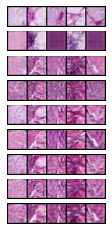

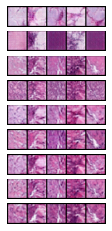

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 80.82834696769714 , Gen Loss: 3.0095584109293747 Disc Loss: 0.3715112598754389
Epoch 61 of 100


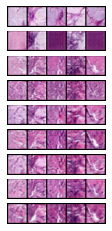

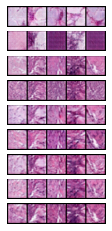

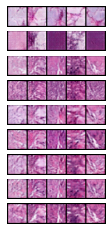

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 81.1209888458252 , Gen Loss: 2.949929371860972 Disc Loss: 0.375811885042113
Epoch 62 of 100


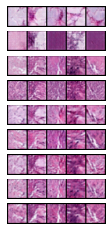

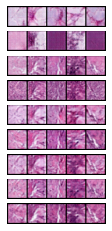

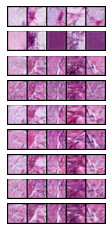

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 81.06916451454163 , Gen Loss: 2.99292885239344 Disc Loss: 0.3701381953781279
Epoch 63 of 100


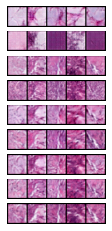

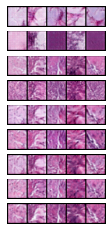

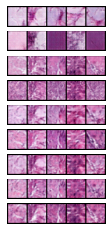

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_63.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_63.pth
Epoch: 63, Duration: 81.04395246505737 , Gen Loss: 2.861057192819681 Disc Loss: 0.3797483013133917
Epoch 64 of 100


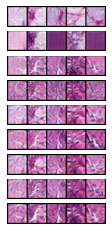

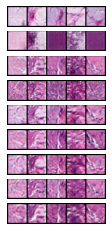

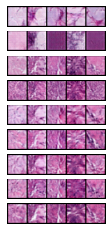

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 81.1203682422638 , Gen Loss: 2.9670728421263166 Disc Loss: 0.3752828250700031
Epoch 65 of 100


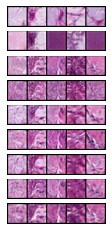

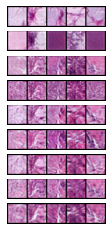

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 80.8218731880188 , Gen Loss: 3.024994513645051 Disc Loss: 0.378452757622561
Epoch 66 of 100


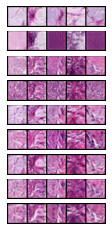

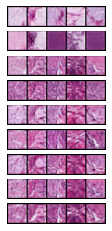

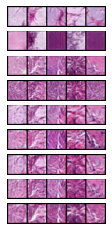

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 80.98426485061646 , Gen Loss: 3.2035663390595137 Disc Loss: 0.3654362936963865
Epoch 67 of 100


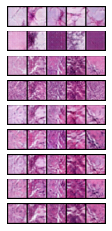

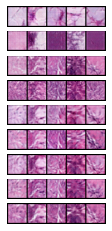

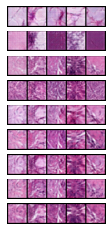

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_67.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_67.pth
Epoch: 67, Duration: 81.11129069328308 , Gen Loss: 3.0529023512156095 Disc Loss: 0.37433278284590427
Epoch 68 of 100


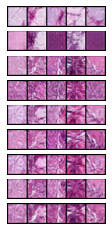

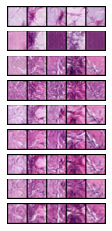

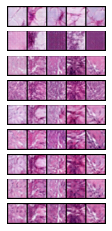

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_68.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_68.pth
Epoch: 68, Duration: 81.08357262611389 , Gen Loss: 2.98715116505178 Disc Loss: 0.3819928455153562
Epoch 69 of 100


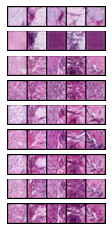

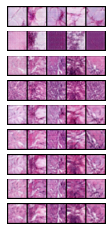

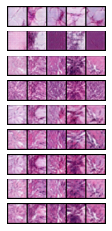

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 81.17686152458191 , Gen Loss: 2.986137578336815 Disc Loss: 0.3808782126427841
Epoch 70 of 100


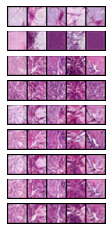

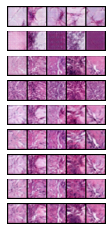

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 80.76874494552612 , Gen Loss: 3.096722007089204 Disc Loss: 0.37624745127561227
Epoch 71 of 100


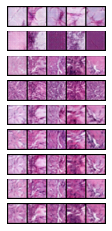

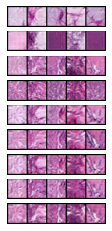

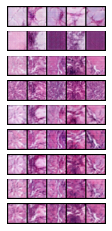

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 81.73371624946594 , Gen Loss: 2.9900492105204677 Disc Loss: 0.38218321855971377
Epoch 72 of 100


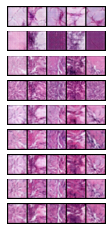

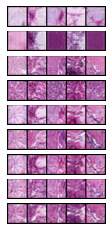

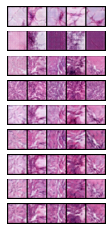

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_72.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_72.pth
Epoch: 72, Duration: 82.213374376297 , Gen Loss: 2.980691502955687 Disc Loss: 0.388216299196631
Epoch 73 of 100


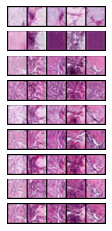

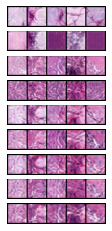

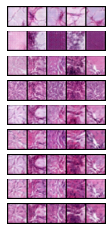

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_73.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_73.pth
Epoch: 73, Duration: 82.19220209121704 , Gen Loss: 3.048034079292413 Disc Loss: 0.37558934910996045
Epoch 74 of 100


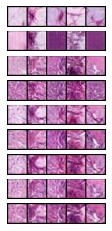

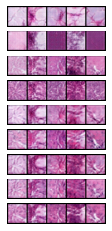

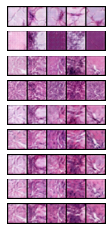

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 82.12788772583008 , Gen Loss: 2.8585023917729675 Disc Loss: 0.3932354024762212
Epoch 75 of 100


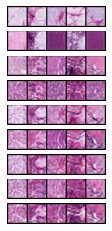

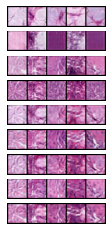

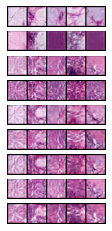

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 82.41511702537537 , Gen Loss: 3.045095754255745 Disc Loss: 0.3782504048791057
Epoch 76 of 100


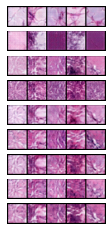

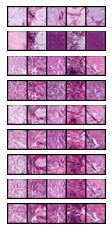

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 81.69054007530212 , Gen Loss: 2.960748255478021 Disc Loss: 0.3858170606193609
Epoch 77 of 100


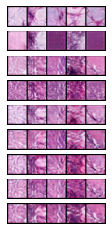

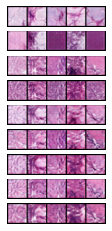

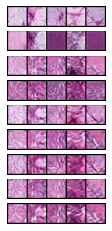

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_77.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_77.pth
Epoch: 77, Duration: 82.26124715805054 , Gen Loss: 2.9930594137517224 Disc Loss: 0.38659691298779947
Epoch 78 of 100


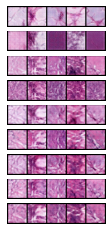

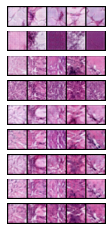

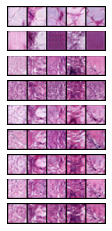

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_78.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_78.pth
Epoch: 78, Duration: 82.21232056617737 , Gen Loss: 3.0250747255433574 Disc Loss: 0.38398850712809457
Epoch 79 of 100


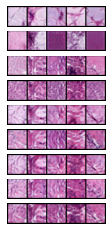

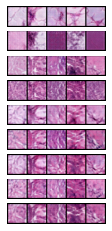

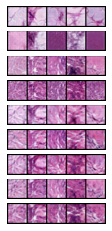

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 81.79789853096008 , Gen Loss: 2.995810230454687 Disc Loss: 0.39244387424163296
Epoch 80 of 100


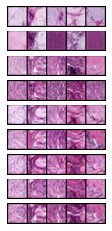

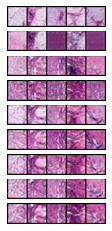

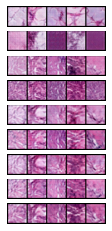

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 81.17678666114807 , Gen Loss: 3.1306738632828126 Disc Loss: 0.37717704988277256
Epoch 81 of 100


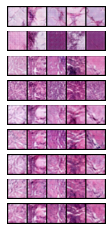

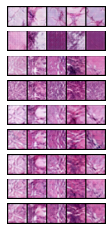

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_81.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_81.pth
Epoch: 81, Duration: 80.87135529518127 , Gen Loss: 3.080814702875683 Disc Loss: 0.3857637596393173
Epoch 82 of 100


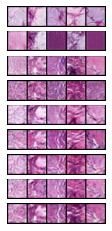

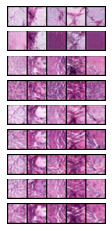

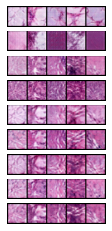

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 81.09449481964111 , Gen Loss: 3.0020431463620607 Disc Loss: 0.38804476379505753
Epoch 83 of 100


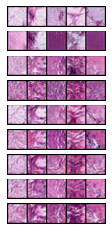

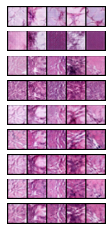

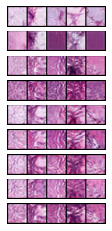

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 81.1133463382721 , Gen Loss: 2.920374586092715 Disc Loss: 0.39405748762445
Epoch 84 of 100


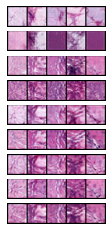

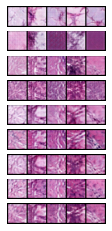

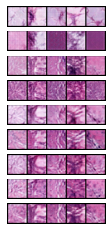

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 81.23004508018494 , Gen Loss: 2.9209103737943907 Disc Loss: 0.3895706562652785
Epoch 85 of 100


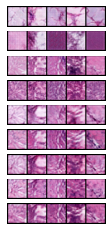

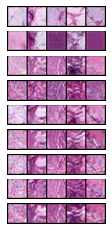

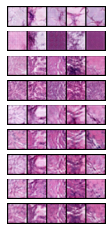

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_85.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_85.pth
Epoch: 85, Duration: 81.03055739402771 , Gen Loss: 2.970331320280901 Disc Loss: 0.3873779806880306
Epoch 86 of 100


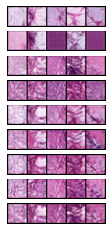

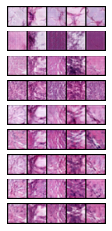

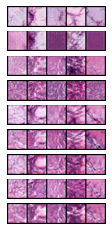

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_86.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_86.pth
Epoch: 86, Duration: 81.06896114349365 , Gen Loss: 2.898567887739455 Disc Loss: 0.3919675075836704
Epoch 87 of 100


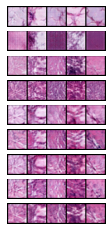

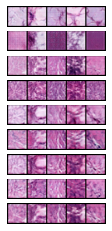

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_87.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_87.pth
Epoch: 87, Duration: 83.37236738204956 , Gen Loss: 2.843222372383217 Disc Loss: 0.39897645624527756
Epoch 88 of 100


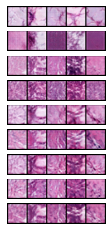

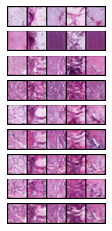

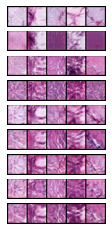

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 88.26353979110718 , Gen Loss: 3.012910296013156 Disc Loss: 0.38578520156451396
Epoch 89 of 100


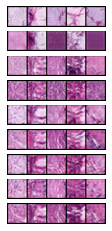

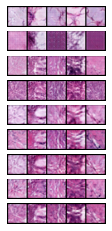

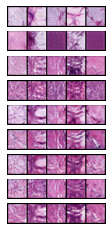

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 87.15366077423096 , Gen Loss: 2.8999505880816927 Disc Loss: 0.3974091556846971
Epoch 90 of 100


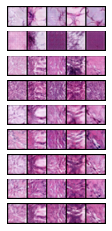

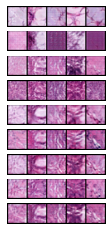

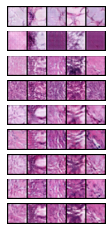

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 84.7993631362915 , Gen Loss: 2.910895692586337 Disc Loss: 0.3931711635100449
Epoch 91 of 100


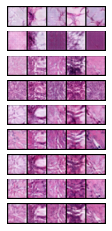

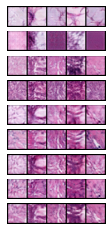

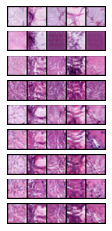

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 86.57684469223022 , Gen Loss: 2.984720848704387 Disc Loss: 0.38929720661196054
Epoch 92 of 100


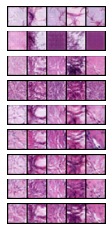

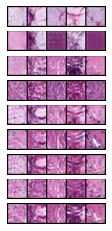

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 85.0275731086731 , Gen Loss: 2.9630362043868614 Disc Loss: 0.3938479731043602
Epoch 93 of 100


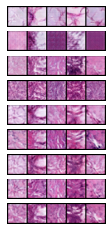

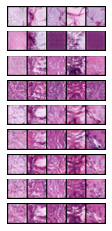

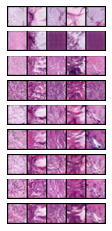

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 82.66223621368408 , Gen Loss: 3.0230079670207566 Disc Loss: 0.3910129512700565
Epoch 94 of 100


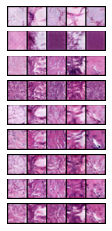

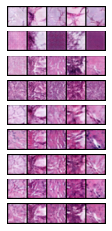

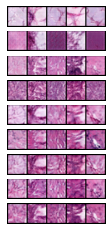

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_94.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_94.pth
Epoch: 94, Duration: 86.0279107093811 , Gen Loss: 2.808226198942175 Disc Loss: 0.4039591863805058
Epoch 95 of 100


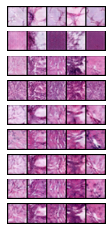

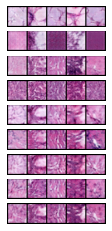

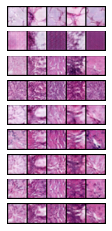

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 82.97569179534912 , Gen Loss: 2.8391984088181696 Disc Loss: 0.40176881125272235
Epoch 96 of 100


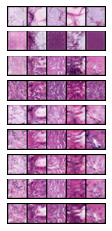

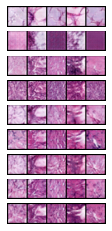

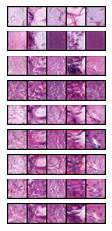

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 84.11329293251038 , Gen Loss: 2.8845427852348995 Disc Loss: 0.39451566771023155
Epoch 97 of 100


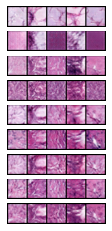

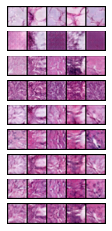

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 86.15853428840637 , Gen Loss: 2.835224621094271 Disc Loss: 0.3997857804096849
Epoch 98 of 100


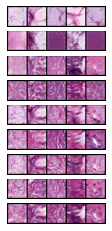

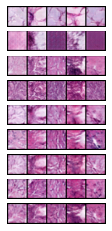

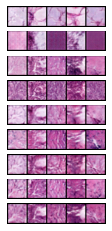

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_98.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_98.pth
Epoch: 98, Duration: 88.93462491035461 , Gen Loss: 2.977675743921952 Disc Loss: 0.3838222236960532
Epoch 99 of 100


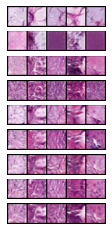

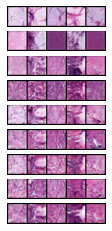

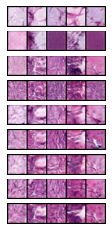

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_99.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_99.pth
Epoch: 99, Duration: 89.28228306770325 , Gen Loss: 2.9529281162496113 Disc Loss: 0.3976490100948931
Epoch 100 of 100


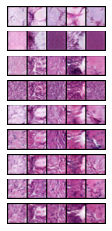

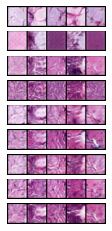

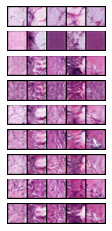

New Generator model saved at trained_models/conditionalGAN/pathmnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/pathmnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 87.25352573394775 , Gen Loss: 2.9289714959553756 Disc Loss: 0.39125336994144183


In [94]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [95]:
# Removes saved intermediary models
model_path = f"models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 3599 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 103.54it/s]


train -- accuracy: 0.668
val -- accuracy: 0.7783,  AUC: 0.9746
Epoch 1



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 103.68it/s]


train -- accuracy: 0.8173
val -- accuracy: 0.8638,  AUC: 0.9881
Epoch 2



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 102.81it/s]


train -- accuracy: 0.8591
val -- accuracy: 0.8523,  AUC: 0.9883
Epoch 3



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 103.12it/s]


train -- accuracy: 0.8828
val -- accuracy: 0.8155,  AUC: 0.9876
Epoch 4



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 100.50it/s]


train -- accuracy: 0.8997
val -- accuracy: 0.9016,  AUC: 0.9941
Epoch 5



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 104.01it/s]


train -- accuracy: 0.9104
val -- accuracy: 0.9163,  AUC: 0.995
Epoch 6



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 101.00it/s]


train -- accuracy: 0.9197
val -- accuracy: 0.9101,  AUC: 0.9944
Epoch 7



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 101.01it/s]


train -- accuracy: 0.9272
val -- accuracy: 0.8939,  AUC: 0.9936
Epoch 8



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 98.75it/s]


train -- accuracy: 0.9339
val -- accuracy: 0.9274,  AUC: 0.9966
Epoch 9



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 97.38it/s]


train -- accuracy: 0.9385
val -- accuracy: 0.9005,  AUC: 0.9948
Epoch 10



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.23it/s]


train -- accuracy: 0.9417
val -- accuracy: 0.9371,  AUC: 0.9966
Epoch 11



100%|███████████████████████████████████████| 1463/1463 [00:16<00:00, 89.47it/s]


train -- accuracy: 0.9477
val -- accuracy: 0.9298,  AUC: 0.9968
Epoch 12



100%|███████████████████████████████████████| 1463/1463 [00:16<00:00, 88.31it/s]


train -- accuracy: 0.9503
val -- accuracy: 0.9324,  AUC: 0.9966
Epoch 13



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.57it/s]


train -- accuracy: 0.9523
val -- accuracy: 0.8956,  AUC: 0.9946
Epoch 14



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.88it/s]


train -- accuracy: 0.9562
val -- accuracy: 0.9216,  AUC: 0.9965
Epoch 15



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.43it/s]


train -- accuracy: 0.9597
val -- accuracy: 0.9363,  AUC: 0.997
Epoch 16



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.54it/s]


train -- accuracy: 0.9621
val -- accuracy: 0.9328,  AUC: 0.9968
Epoch 17



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.96it/s]


train -- accuracy: 0.9642
val -- accuracy: 0.932,  AUC: 0.997
Epoch 18



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.86it/s]


train -- accuracy: 0.9656
val -- accuracy: 0.9464,  AUC: 0.9978
Epoch 19



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.80it/s]


train -- accuracy: 0.9683
val -- accuracy: 0.9358,  AUC: 0.9968
test -- accuracy: 0.8552,  AUC: 0.9776


<Figure size 720x720 with 0 Axes>

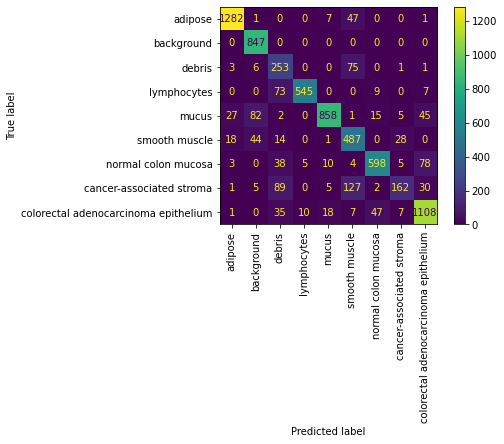

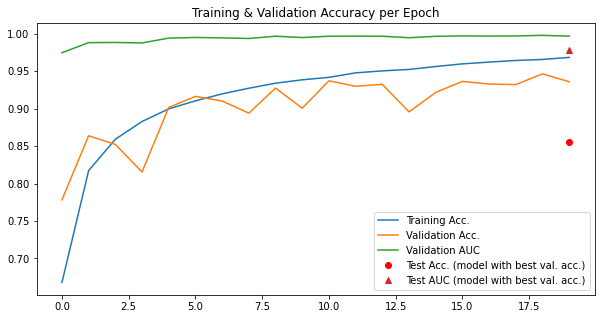

In [96]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [97]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PathMNIST",
  "description": "The PathMNIST is based on a prior study for predicting survival from colorectal cancer histology slides, providing a dataset (NCT-CRC-HE-100K) of 100,000 non-overlapping image patches from hematoxylin & eosin stained histological images, and a test dataset (CRC-VAL-HE-7K) of 7,180 image patches from a different clinical center. The dataset is comprised of 9 types of tissues, resulting in a multi-class classification task. We resize the source images of 3\u00d7224\u00d7224 into 3\u00d728\u00d728, and split NCT-CRC-HE-100K into training and validation set with a ratio of 9:1. The CRC-VAL-HE-7K is treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/pathmnist.npz?download=1",
  "MD5": "a8b06965200029087d5bd730944a56c1",
  "task": "multi-class",
  "label": {
    "0": "adipose",
    "1": "background",
    "2": "debris",
    "3": "lymphocytes",
    "4": "mucus",
    "5": "smooth muscle",
    "6": "normal colon mucosa"

100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.88it/s]


train -- accuracy: 0.6828
val -- accuracy: 0.721,  AUC: 0.9702
Epoch 1



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 92.96it/s]


train -- accuracy: 0.8215
val -- accuracy: 0.8528,  AUC: 0.9866
Epoch 2



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 102.44it/s]


train -- accuracy: 0.8672
val -- accuracy: 0.8587,  AUC: 0.9891
Epoch 3



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 103.13it/s]


train -- accuracy: 0.8928
val -- accuracy: 0.8996,  AUC: 0.9937
Epoch 4



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 103.67it/s]


train -- accuracy: 0.9056
val -- accuracy: 0.9133,  AUC: 0.9949
Epoch 5



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 103.66it/s]


train -- accuracy: 0.9175
val -- accuracy: 0.9105,  AUC: 0.9948
Epoch 6



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 103.33it/s]


train -- accuracy: 0.9237
val -- accuracy: 0.9299,  AUC: 0.9962
Epoch 7



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 103.71it/s]


train -- accuracy: 0.9298
val -- accuracy: 0.9166,  AUC: 0.9956
Epoch 8



100%|██████████████████████████████████████| 1463/1463 [00:14<00:00, 103.10it/s]


train -- accuracy: 0.9363
val -- accuracy: 0.9296,  AUC: 0.9963
Epoch 9



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.35it/s]


train -- accuracy: 0.9415
val -- accuracy: 0.9359,  AUC: 0.9967
Epoch 10



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 92.11it/s]


train -- accuracy: 0.9469
val -- accuracy: 0.9316,  AUC: 0.9966
Epoch 11



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 99.98it/s]


train -- accuracy: 0.9484
val -- accuracy: 0.9387,  AUC: 0.997
Epoch 12



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 99.10it/s]


train -- accuracy: 0.9524
val -- accuracy: 0.9313,  AUC: 0.9964
Epoch 13



100%|███████████████████████████████████████| 1463/1463 [00:14<00:00, 98.19it/s]


train -- accuracy: 0.9538
val -- accuracy: 0.9209,  AUC: 0.9957
Epoch 14



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.16it/s]


train -- accuracy: 0.9585
val -- accuracy: 0.9378,  AUC: 0.997
Epoch 15



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 93.36it/s]


train -- accuracy: 0.9614
val -- accuracy: 0.9407,  AUC: 0.9968
Epoch 16



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 94.80it/s]


train -- accuracy: 0.962
val -- accuracy: 0.9147,  AUC: 0.996
Epoch 17



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 95.51it/s]


train -- accuracy: 0.965
val -- accuracy: 0.9385,  AUC: 0.9971
Epoch 18



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 96.92it/s]


train -- accuracy: 0.9658
val -- accuracy: 0.9451,  AUC: 0.9973
Epoch 19



100%|███████████████████████████████████████| 1463/1463 [00:15<00:00, 97.02it/s]


train -- accuracy: 0.9677
val -- accuracy: 0.929,  AUC: 0.9965
test -- accuracy: 0.7954,  AUC: 0.9628


<Figure size 720x720 with 0 Axes>

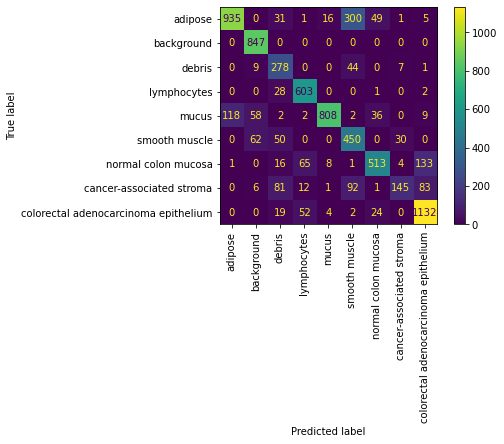

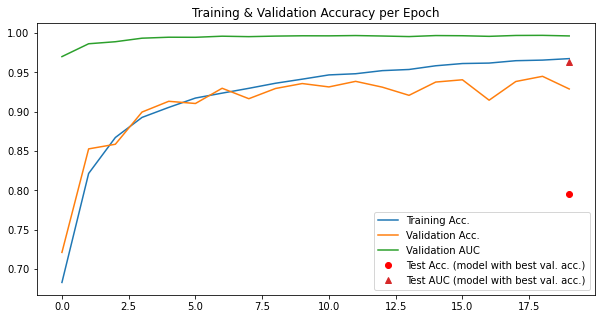

In [98]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### DermaMNIST

#### Training the Conditional GAN

In [99]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "dermamnist"
base_dataset = dermamnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 6.660140514373779 , Gen Loss: 2.8939983008063366 Disc Loss: 0.19835061701691167
Epoch 2 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 6.62632417678833 , Gen Loss: 2.0765467791137433 Disc Loss: 0.36599965324853717
Epoch 3 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 6.698148727416992 , Gen Loss: 2.0894445955829886 Disc Loss: 0.3369251075375517
Epoch 4 of 100
New Generator model saved at trained_model

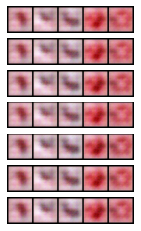

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 6.850727319717407 , Gen Loss: 1.7242116142785786 Disc Loss: 0.4144960438556979
Epoch 6 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 6.637577772140503 , Gen Loss: 1.7362645724810903 Disc Loss: 0.38559072763174324
Epoch 7 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 6.44428014755249 , Gen Loss: 1.7781261707042957 Disc Loss: 0.396863564727683
Epoch 8 of 100
New Generator model saved at trained_models/conditionalGAN/

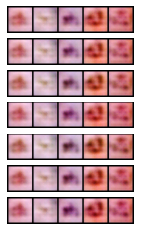

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 7.300746202468872 , Gen Loss: 1.6498572576976596 Disc Loss: 0.4205652745691808
Epoch 11 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 6.810624837875366 , Gen Loss: 1.675209416699372 Disc Loss: 0.4343719199327458
Epoch 12 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 6.637933731079102 , Gen Loss: 1.5569512797470386 Disc Loss: 0.46053911211556303
Epoch 13 of 100
New Generator model saved at trained_models/co

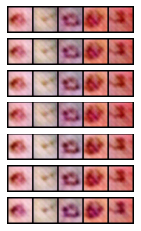

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 7.075786113739014 , Gen Loss: 1.4708989392304124 Disc Loss: 0.49291734353815825
Epoch 15 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 6.756487131118774 , Gen Loss: 1.3198843567147138 Disc Loss: 0.5087062769819466
Epoch 16 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 6.84285831451416 , Gen Loss: 1.2539757954099473 Disc Loss: 0.5131930360376231
Epoch 17 of 100
New Generator model saved at trained_models/co

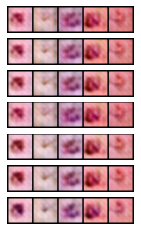

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 6.883136510848999 , Gen Loss: 1.2408268349953617 Disc Loss: 0.5164231694644641
Epoch 20 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 6.519824981689453 , Gen Loss: 1.2254858701566291 Disc Loss: 0.5067246857495183
Epoch 21 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 6.453734397888184 , Gen Loss: 1.2537324561599115 Disc Loss: 0.5159881970707864
Epoch 22 of 100
New Generator model saved at trained_models/co

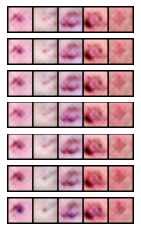

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 6.940830230712891 , Gen Loss: 1.247799354663194 Disc Loss: 0.5277442981126017
Epoch 24 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_24.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_24.pth
Epoch: 24, Duration: 6.770571947097778 , Gen Loss: 1.2315959709932924 Disc Loss: 0.5423358031477451
Epoch 25 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 6.535362005233765 , Gen Loss: 1.2118839586752532 Disc Loss: 0.5309799714794134
Epoch 26 of 100
New Generator model saved at trained_models/con

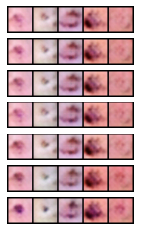

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 6.955645799636841 , Gen Loss: 1.150968242137327 Disc Loss: 0.5606178489479271
Epoch 29 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 6.398331880569458 , Gen Loss: 1.13441420465695 Disc Loss: 0.5648996650670758
Epoch 30 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 6.398169040679932 , Gen Loss: 1.140328073154524 Disc Loss: 0.5514470183834023
Epoch 31 of 100
New Generator model saved at trained_models/condit

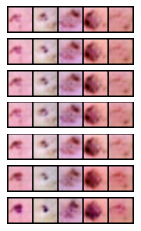

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_32.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_32.pth
Epoch: 32, Duration: 6.585652828216553 , Gen Loss: 1.1107412397869987 Disc Loss: 0.554583634836146
Epoch 33 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_33.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_33.pth
Epoch: 33, Duration: 6.388559341430664 , Gen Loss: 1.1290870820028187 Disc Loss: 0.5500651692057942
Epoch 34 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 6.318257570266724 , Gen Loss: 1.1244508142527117 Disc Loss: 0.5552992278368952
Epoch 35 of 100
New Generator model saved at trained_models/con

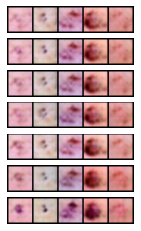

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 6.593457937240601 , Gen Loss: 1.1479163972188526 Disc Loss: 0.5533955790303446
Epoch 38 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 6.323033571243286 , Gen Loss: 1.1358276210396747 Disc Loss: 0.5515173651683138
Epoch 39 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 6.320805072784424 , Gen Loss: 1.170112811295847 Disc Loss: 0.5611040744969317
Epoch 40 of 100
New Generator model saved at trained_models/con

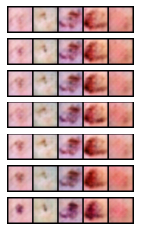

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 6.577807426452637 , Gen Loss: 1.1827356516251606 Disc Loss: 0.5389266495223527
Epoch 42 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 6.315292119979858 , Gen Loss: 1.1936151181407877 Disc Loss: 0.5469790393758027
Epoch 43 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 6.320523500442505 , Gen Loss: 1.1961169410946197 Disc Loss: 0.5379655918857927
Epoch 44 of 100
New Generator model saved at trained_models/co

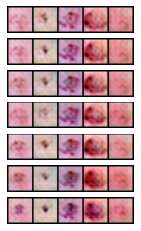

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 6.806200265884399 , Gen Loss: 1.2122452045722134 Disc Loss: 0.5268098949042029
Epoch 47 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 6.651057243347168 , Gen Loss: 1.221217259303197 Disc Loss: 0.514008870593692
Epoch 48 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 6.63384222984314 , Gen Loss: 1.215775296132439 Disc Loss: 0.5218064232084879
Epoch 49 of 100
New Generator model saved at trained_models/condit

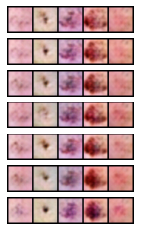

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 6.8736982345581055 , Gen Loss: 1.2153797653239617 Disc Loss: 0.5212227783377337
Epoch 51 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 6.62882399559021 , Gen Loss: 1.2455910440006421 Disc Loss: 0.5166217710860568
Epoch 52 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 6.57737398147583 , Gen Loss: 1.2478134309886542 Disc Loss: 0.5169137851545775
Epoch 53 of 100
New Generator model saved at trained_models/con

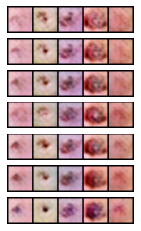

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 6.935758590698242 , Gen Loss: 1.2875067176127444 Disc Loss: 0.49659450482553164
Epoch 56 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 6.5901477336883545 , Gen Loss: 1.2436386158484374 Disc Loss: 0.5079983841493328
Epoch 57 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 6.601764917373657 , Gen Loss: 1.267275414317825 Disc Loss: 0.514179075667636
Epoch 58 of 100
New Generator model saved at trained_models/co

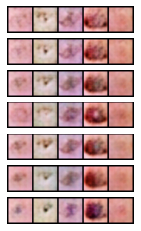

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 7.053947448730469 , Gen Loss: 1.3192828376980164 Disc Loss: 0.4991480687281469
Epoch 61 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 6.71979832649231 , Gen Loss: 1.3079150202476095 Disc Loss: 0.49287323307273084
Epoch 62 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 6.628613710403442 , Gen Loss: 1.3068620832292708 Disc Loss: 0.4851119165432782
Epoch 63 of 100
New Generator model saved at trained_models/co

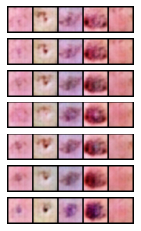

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 6.9596638679504395 , Gen Loss: 1.3182590289175111 Disc Loss: 0.47839433864126946
Epoch 65 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 6.686133146286011 , Gen Loss: 1.3616824024190095 Disc Loss: 0.4757495573622806
Epoch 66 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 6.695058822631836 , Gen Loss: 1.3525182964357072 Disc Loss: 0.4765306888981554
Epoch 67 of 100
New Generator model saved at trained_models/

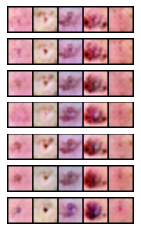

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 6.759677886962891 , Gen Loss: 1.3931337914317825 Disc Loss: 0.4622152401170258
Epoch 70 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 6.4332897663116455 , Gen Loss: 1.423627014726345 Disc Loss: 0.4562920687013879
Epoch 71 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 6.498993158340454 , Gen Loss: 1.4250796636399314 Disc Loss: 0.45678749264128726
Epoch 72 of 100
New Generator model saved at trained_models/c

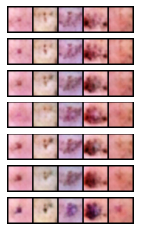

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_73.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_73.pth
Epoch: 73, Duration: 6.956158638000488 , Gen Loss: 1.4386396248840445 Disc Loss: 0.4460360719080027
Epoch 74 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 6.39464545249939 , Gen Loss: 1.436378214419509 Disc Loss: 0.4478986415370344
Epoch 75 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 6.353136777877808 , Gen Loss: 1.4466168597027973 Disc Loss: 0.45607796221635505
Epoch 76 of 100
New Generator model saved at trained_models/con

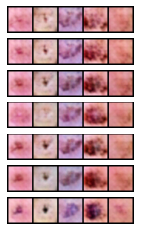

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_78.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_78.pth
Epoch: 78, Duration: 6.900943279266357 , Gen Loss: 1.5235091359533324 Disc Loss: 0.434949084119006
Epoch 79 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 6.5796239376068115 , Gen Loss: 1.5278453410428856 Disc Loss: 0.42551254549022405
Epoch 80 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 6.348512887954712 , Gen Loss: 1.5074105581918082 Disc Loss: 0.42026792961502785
Epoch 81 of 100
New Generator model saved at trained_models/

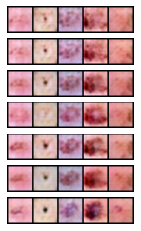

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 6.952880620956421 , Gen Loss: 1.5642377990313259 Disc Loss: 0.40905808755976164
Epoch 83 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 6.4877612590789795 , Gen Loss: 1.5445921266233766 Disc Loss: 0.4106163089143
Epoch 84 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 6.353005647659302 , Gen Loss: 1.5772069727147853 Disc Loss: 0.41008736659545814
Epoch 85 of 100
New Generator model saved at trained_models/co

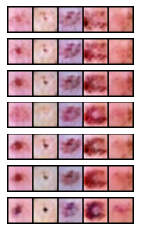

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_87.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_87.pth
Epoch: 87, Duration: 6.670669794082642 , Gen Loss: 1.6139645789478378 Disc Loss: 0.3996928364604146
Epoch 88 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 6.699910879135132 , Gen Loss: 1.5767876097117168 Disc Loss: 0.39598480481572
Epoch 89 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 6.462842702865601 , Gen Loss: 1.6119505494505495 Disc Loss: 0.38804060058245327
Epoch 90 of 100
New Generator model saved at trained_models/con

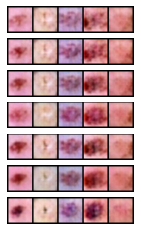

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 6.651928424835205 , Gen Loss: 1.6374961534001713 Disc Loss: 0.3808212574256101
Epoch 92 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 6.384123802185059 , Gen Loss: 1.6542655168492222 Disc Loss: 0.3821655116646746
Epoch 93 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 6.3820836544036865 , Gen Loss: 1.7374462869719567 Disc Loss: 0.37286802901339733
Epoch 94 of 100
New Generator model saved at trained_models/

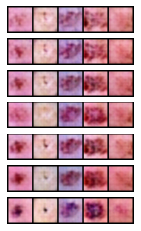

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 6.72853684425354 , Gen Loss: 1.72386848642429 Disc Loss: 0.37183554447784356
Epoch 97 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 6.380762100219727 , Gen Loss: 1.719209222696946 Disc Loss: 0.37179885544143354
Epoch 98 of 100
New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_98.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_98.pth
Epoch: 98, Duration: 6.382418632507324 , Gen Loss: 1.7806054157895677 Disc Loss: 0.3574444877109498
Epoch 99 of 100
New Generator model saved at trained_models/cond

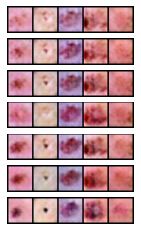

New Generator model saved at trained_models/conditionalGAN/dermamnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/dermamnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 6.650652170181274 , Gen Loss: 1.790701764753104 Disc Loss: 0.3571653653266377


In [100]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [101]:
# Removes saved intermediary models
model_path = f"models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 700 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|████████████████████████████████████████| 121/121 [00:01<00:00, 100.51it/s]


train -- accuracy: 0.6115
val -- accuracy: 0.669,  AUC: 0.8382
Epoch 1



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.74it/s]


train -- accuracy: 0.6276
val -- accuracy: 0.6879,  AUC: 0.8662
Epoch 2



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 103.33it/s]


train -- accuracy: 0.6473
val -- accuracy: 0.6999,  AUC: 0.8861
Epoch 3



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 104.06it/s]


train -- accuracy: 0.6585
val -- accuracy: 0.7079,  AUC: 0.8929
Epoch 4



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 96.54it/s]


train -- accuracy: 0.675
val -- accuracy: 0.7218,  AUC: 0.9016
Epoch 5



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 94.76it/s]


train -- accuracy: 0.6922
val -- accuracy: 0.7318,  AUC: 0.9028
Epoch 6



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 101.19it/s]


train -- accuracy: 0.7021
val -- accuracy: 0.7368,  AUC: 0.9027
Epoch 7



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 98.91it/s]


train -- accuracy: 0.7123
val -- accuracy: 0.7238,  AUC: 0.9093
Epoch 8



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 97.77it/s]


train -- accuracy: 0.7234
val -- accuracy: 0.7059,  AUC: 0.9114
Epoch 9



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 97.91it/s]


train -- accuracy: 0.7256
val -- accuracy: 0.7398,  AUC: 0.9111
Epoch 10



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 92.04it/s]


train -- accuracy: 0.7362
val -- accuracy: 0.7358,  AUC: 0.9132
Epoch 11



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 98.20it/s]


train -- accuracy: 0.7489
val -- accuracy: 0.7079,  AUC: 0.9126
Epoch 12



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 101.57it/s]


train -- accuracy: 0.7536
val -- accuracy: 0.7218,  AUC: 0.911
Epoch 13



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 100.67it/s]


train -- accuracy: 0.7675
val -- accuracy: 0.7308,  AUC: 0.9094
Epoch 14



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 98.24it/s]


train -- accuracy: 0.7806
val -- accuracy: 0.7547,  AUC: 0.9159
Epoch 15



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 97.88it/s]


train -- accuracy: 0.7908
val -- accuracy: 0.7358,  AUC: 0.916
Epoch 16



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 99.37it/s]


train -- accuracy: 0.8039
val -- accuracy: 0.7159,  AUC: 0.9062
Epoch 17



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 99.59it/s]


train -- accuracy: 0.8246
val -- accuracy: 0.7248,  AUC: 0.9086
Epoch 18



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.64it/s]


train -- accuracy: 0.8413
val -- accuracy: 0.7557,  AUC: 0.9066
Epoch 19



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 100.73it/s]


train -- accuracy: 0.8488
val -- accuracy: 0.7188,  AUC: 0.9046
test -- accuracy: 0.7167,  AUC: 0.9013


<Figure size 720x720 with 0 Axes>

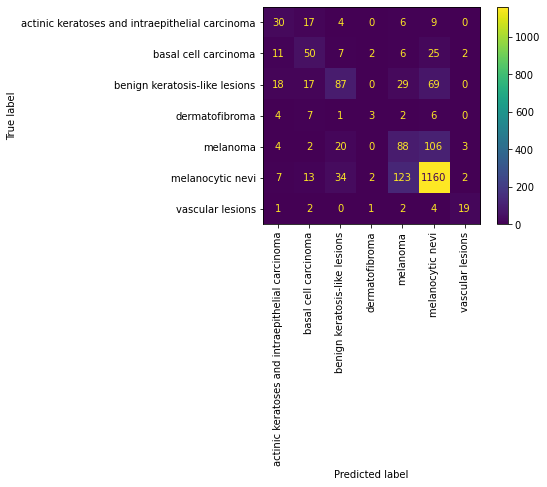

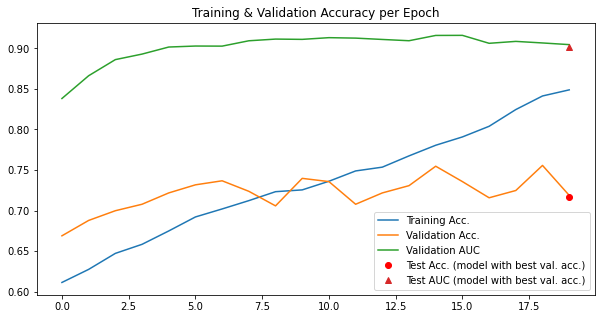

In [102]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [103]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "DermaMNIST",
  "description": "The DermaMNIST is based on the HAM10000, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. The dataset consists of 10,015 dermatoscopic images categorized as 7 different diseases, formulized as a multi-class classification task. We split the images into training, validation and test set with a ratio of 7:1:2. The source images of 3\u00d7600\u00d7450 are resized into 3\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/dermamnist.npz?download=1",
  "MD5": "0744692d530f8e62ec473284d019b0c7",
  "task": "multi-class",
  "label": {
    "0": "actinic keratoses and intraepithelial carcinoma",
    "1": "basal cell carcinoma",
    "2": "benign keratosis-like lesions",
    "3": "dermatofibroma",
    "4": "melanoma",
    "5": "melanocytic nevi",
    "6": "vascular lesions"
  },
  "n_channels": 3,
  "n_samples": {
    "train": 7007,
    "val": 1003,
    "test": 2005
  },
  "license": "CC B

100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 97.55it/s]


train -- accuracy: 0.3354
val -- accuracy: 0.5194,  AUC: 0.8267
Epoch 1



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 103.78it/s]


train -- accuracy: 0.4537
val -- accuracy: 0.5174,  AUC: 0.8587
Epoch 2



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 101.21it/s]


train -- accuracy: 0.521
val -- accuracy: 0.4666,  AUC: 0.8513
Epoch 3



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 101.19it/s]


train -- accuracy: 0.5743
val -- accuracy: 0.4566,  AUC: 0.8572
Epoch 4



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 96.32it/s]


train -- accuracy: 0.6346
val -- accuracy: 0.5842,  AUC: 0.8814
Epoch 5



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 91.85it/s]


train -- accuracy: 0.6708
val -- accuracy: 0.5693,  AUC: 0.8772
Epoch 6



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 83.54it/s]


train -- accuracy: 0.727
val -- accuracy: 0.5194,  AUC: 0.8533
Epoch 7



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 89.95it/s]


train -- accuracy: 0.7667
val -- accuracy: 0.5643,  AUC: 0.876
Epoch 8



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 94.20it/s]


train -- accuracy: 0.7958
val -- accuracy: 0.5474,  AUC: 0.8963
Epoch 9



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 92.61it/s]


train -- accuracy: 0.8391
val -- accuracy: 0.5633,  AUC: 0.8947
Epoch 10



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 103.44it/s]


train -- accuracy: 0.8562
val -- accuracy: 0.5872,  AUC: 0.8951
Epoch 11



100%|█████████████████████████████████████████| 121/121 [00:01<00:00, 99.50it/s]


train -- accuracy: 0.8706
val -- accuracy: 0.5763,  AUC: 0.8828
Epoch 12



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 104.34it/s]


train -- accuracy: 0.8871
val -- accuracy: 0.5972,  AUC: 0.8945
Epoch 13



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 104.12it/s]


train -- accuracy: 0.9009
val -- accuracy: 0.666,  AUC: 0.8978
Epoch 14



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 102.61it/s]


train -- accuracy: 0.9137
val -- accuracy: 0.656,  AUC: 0.8997
Epoch 15



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 103.91it/s]


train -- accuracy: 0.9206
val -- accuracy: 0.674,  AUC: 0.899
Epoch 16



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 104.37it/s]


train -- accuracy: 0.9227
val -- accuracy: 0.6919,  AUC: 0.8999
Epoch 17



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 105.61it/s]


train -- accuracy: 0.9372
val -- accuracy: 0.657,  AUC: 0.8863
Epoch 18



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 103.76it/s]


train -- accuracy: 0.9437
val -- accuracy: 0.67,  AUC: 0.8913
Epoch 19



100%|████████████████████████████████████████| 121/121 [00:01<00:00, 104.47it/s]


train -- accuracy: 0.9458
val -- accuracy: 0.6849,  AUC: 0.8886
test -- accuracy: 0.6893,  AUC: 0.8854


<Figure size 720x720 with 0 Axes>

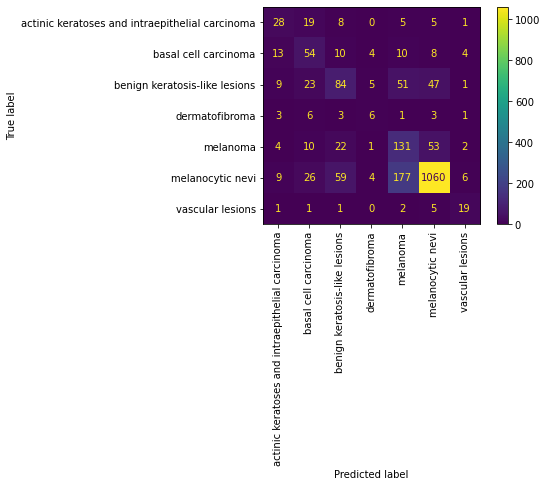

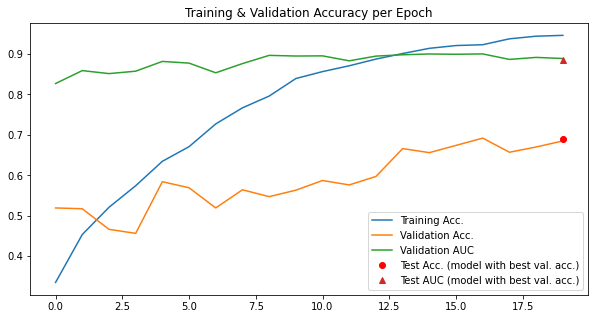

In [104]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### OctMNIST

#### Training the Conditional GAN

In [105]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "octmnist"
base_dataset = octmnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Epoch 1 of 100


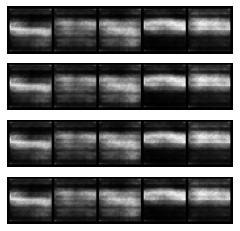

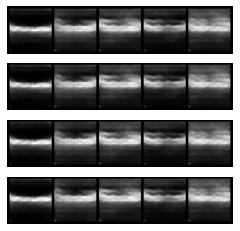

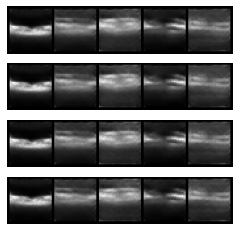

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 84.3183524608612 , Gen Loss: 9.022036608635883 Disc Loss: 0.12732441651299795
Epoch 2 of 100


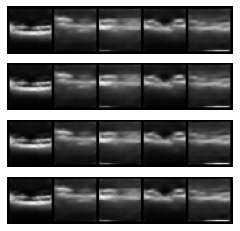

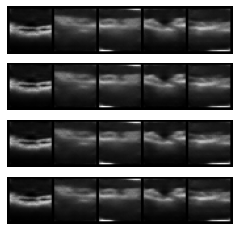

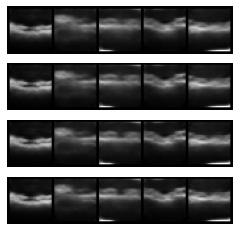

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 85.34000205993652 , Gen Loss: 8.99348115452876 Disc Loss: 0.17319119590390553
Epoch 3 of 100


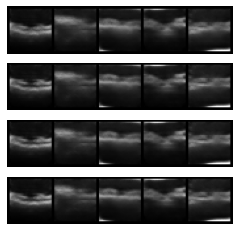

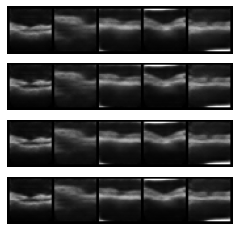

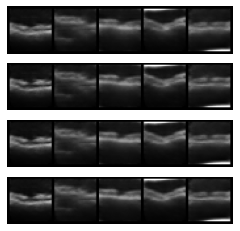

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 84.38813042640686 , Gen Loss: 6.521378761143654 Disc Loss: 0.2561731509420171
Epoch 4 of 100


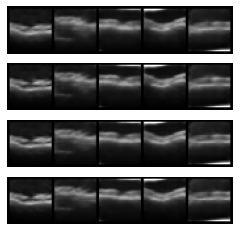

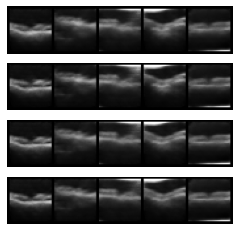

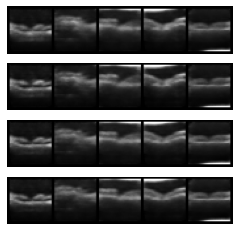

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_4.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_4.pth
Epoch: 4, Duration: 82.84878087043762 , Gen Loss: 3.729481057069873 Disc Loss: 0.3442818562327523
Epoch 5 of 100


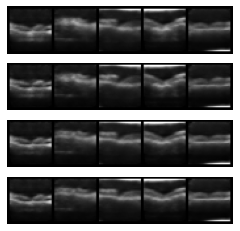

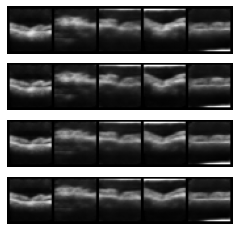

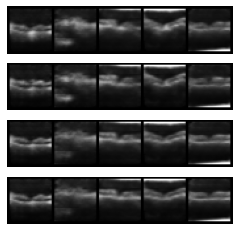

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 82.22726035118103 , Gen Loss: 2.8195747458374796 Disc Loss: 0.3964580667106087
Epoch 6 of 100


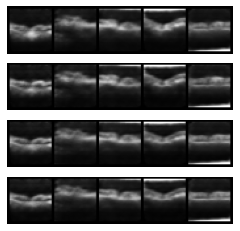

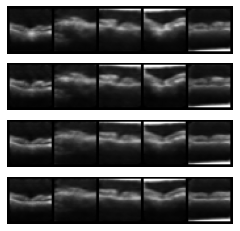

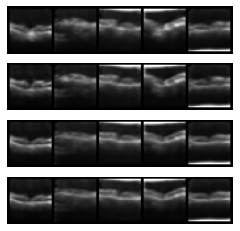

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 82.18662548065186 , Gen Loss: 2.208631266862952 Disc Loss: 0.4450320652564195
Epoch 7 of 100


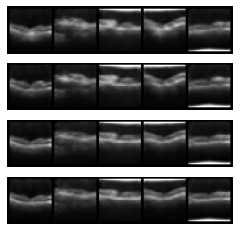

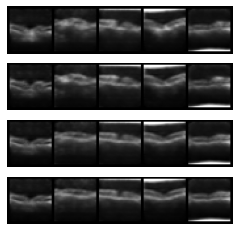

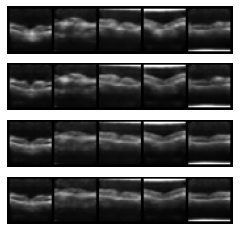

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 82.27912974357605 , Gen Loss: 2.046140531869056 Disc Loss: 0.46220133980323563
Epoch 8 of 100


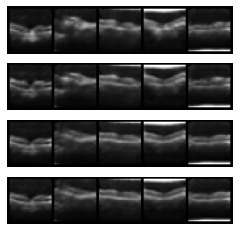

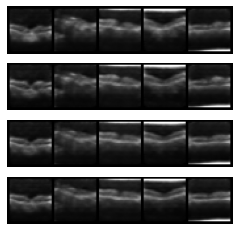

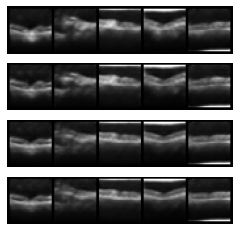

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_8.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_8.pth
Epoch: 8, Duration: 82.21815729141235 , Gen Loss: 1.930913510366548 Disc Loss: 0.4758541999010023
Epoch 9 of 100


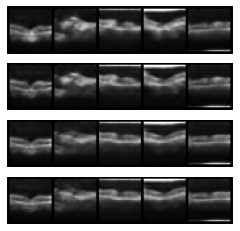

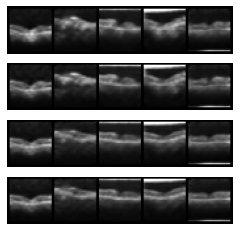

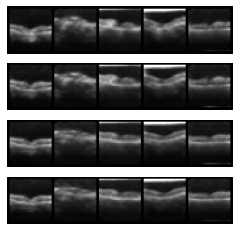

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_9.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_9.pth
Epoch: 9, Duration: 82.18625593185425 , Gen Loss: 1.8612841041989392 Disc Loss: 0.49048505512838925
Epoch 10 of 100


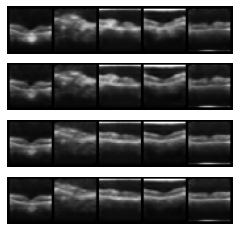

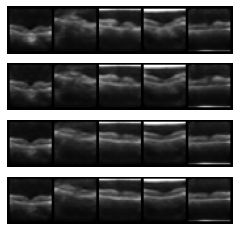

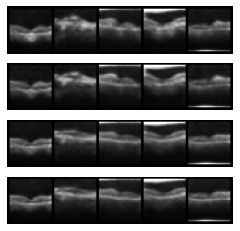

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 82.3385500907898 , Gen Loss: 1.8133085240620865 Disc Loss: 0.4982701848897689
Epoch 11 of 100


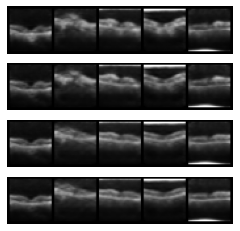

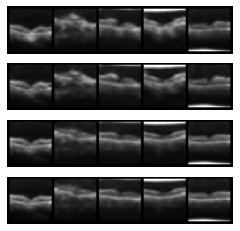

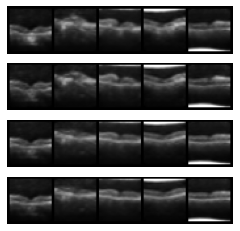

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 82.23869848251343 , Gen Loss: 1.7915841685730993 Disc Loss: 0.5021503069313786
Epoch 12 of 100


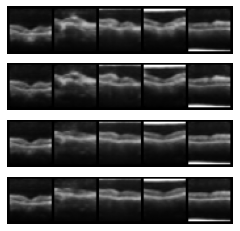

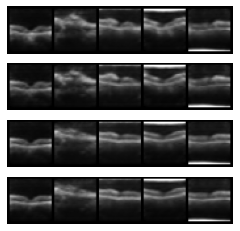

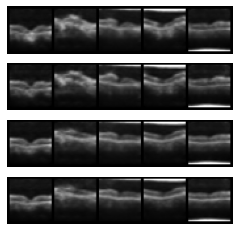

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 82.16191172599792 , Gen Loss: 1.763242867548242 Disc Loss: 0.5097554663536014
Epoch 13 of 100


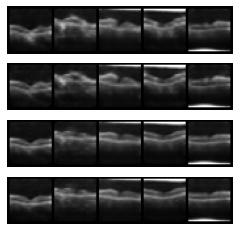

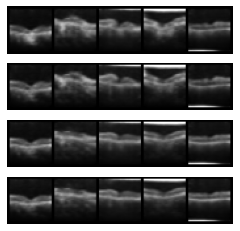

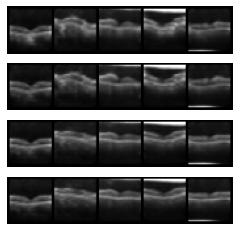

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_13.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_13.pth
Epoch: 13, Duration: 82.28955936431885 , Gen Loss: 1.7059974724806877 Disc Loss: 0.5131720575751203
Epoch 14 of 100


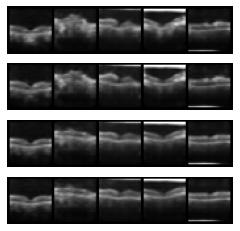

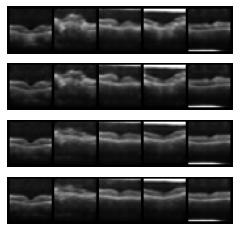

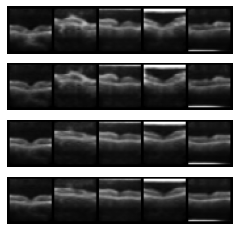

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 82.22647881507874 , Gen Loss: 1.6227390499810213 Disc Loss: 0.5191467843055285
Epoch 15 of 100


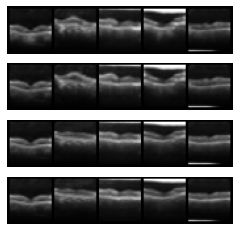

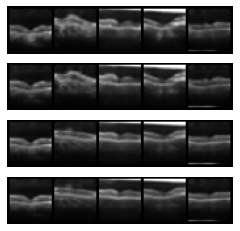

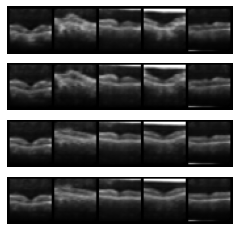

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 82.1899824142456 , Gen Loss: 1.6422608025482934 Disc Loss: 0.5162499070293505
Epoch 16 of 100


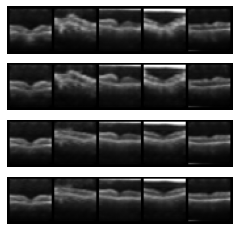

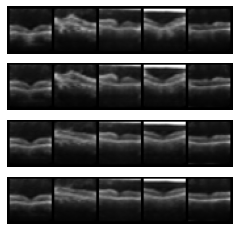

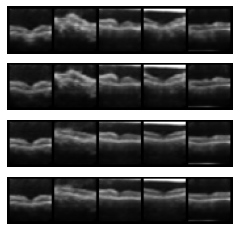

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 82.22147154808044 , Gen Loss: 1.7258638576279532 Disc Loss: 0.5067493485642767
Epoch 17 of 100


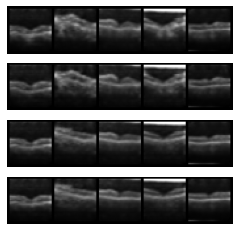

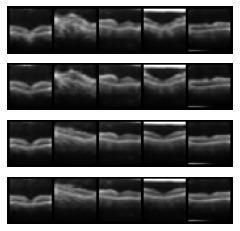

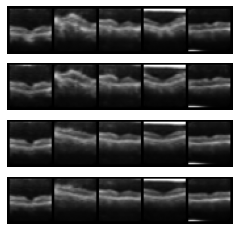

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_17.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_17.pth
Epoch: 17, Duration: 82.27972388267517 , Gen Loss: 1.7173269078859628 Disc Loss: 0.5038523109938755
Epoch 18 of 100


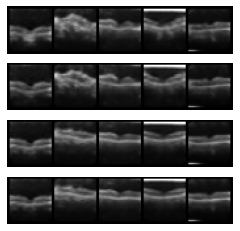

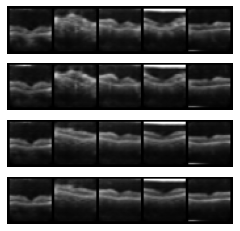

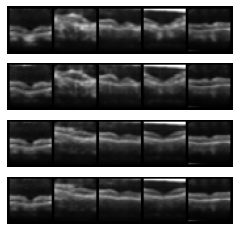

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_18.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_18.pth
Epoch: 18, Duration: 82.13408470153809 , Gen Loss: 1.6270806190178195 Disc Loss: 0.5050089941088667
Epoch 19 of 100


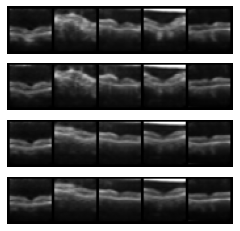

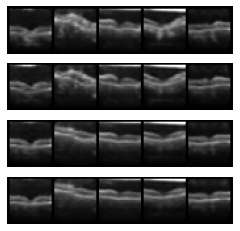

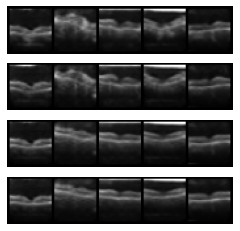

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 82.30928778648376 , Gen Loss: 1.7115681776213876 Disc Loss: 0.4976296091000954
Epoch 20 of 100


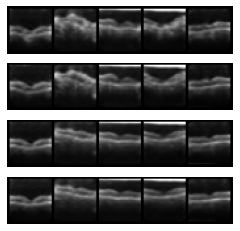

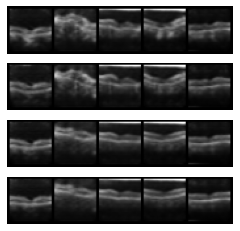

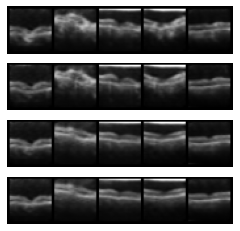

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 82.19583749771118 , Gen Loss: 1.78513136432184 Disc Loss: 0.4855949191860644
Epoch 21 of 100


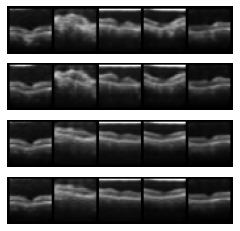

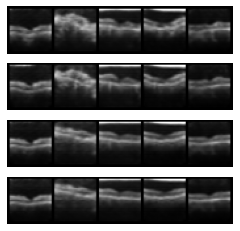

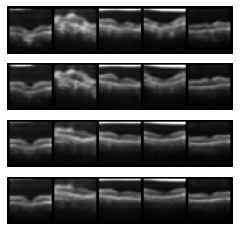

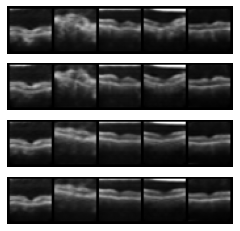

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 82.46971607208252 , Gen Loss: 1.6143933312473713 Disc Loss: 0.49494772645085505
Epoch 22 of 100


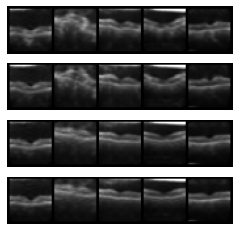

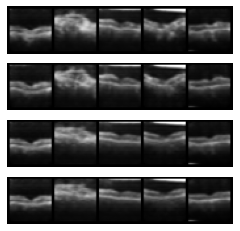

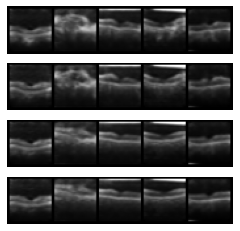

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_22.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_22.pth
Epoch: 22, Duration: 82.23706722259521 , Gen Loss: 1.7810550822245248 Disc Loss: 0.4745493648501698
Epoch 23 of 100


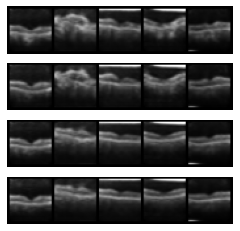

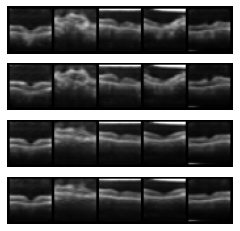

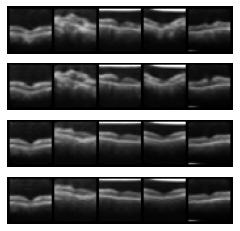

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 82.20301389694214 , Gen Loss: 1.7120638073596848 Disc Loss: 0.47556502912225446
Epoch 24 of 100


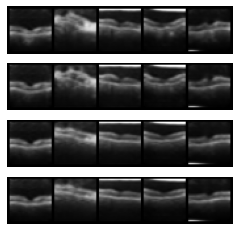

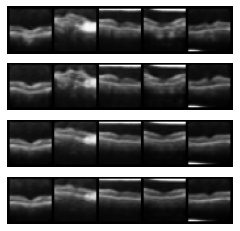

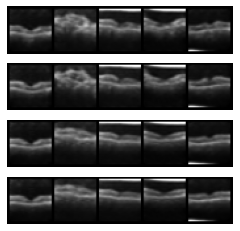

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_24.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_24.pth
Epoch: 24, Duration: 82.23108291625977 , Gen Loss: 1.831853443632857 Disc Loss: 0.466398363524216
Epoch 25 of 100


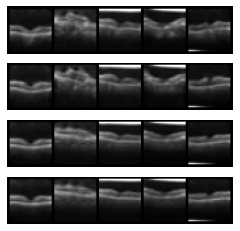

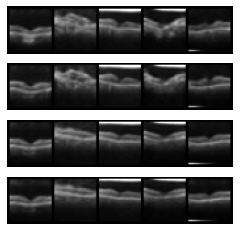

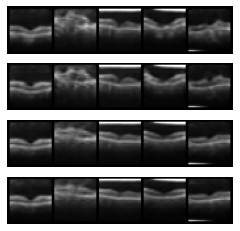

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 82.27648329734802 , Gen Loss: 1.8143291173815361 Disc Loss: 0.4662532972521723
Epoch 26 of 100


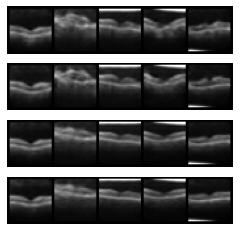

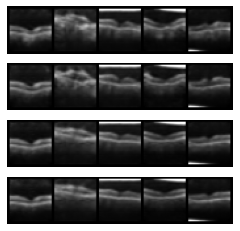

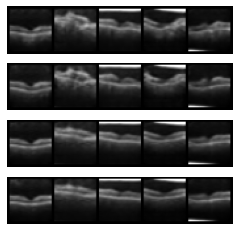

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_26.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_26.pth
Epoch: 26, Duration: 82.22447681427002 , Gen Loss: 1.8242718474614525 Disc Loss: 0.4639318361639156
Epoch 27 of 100


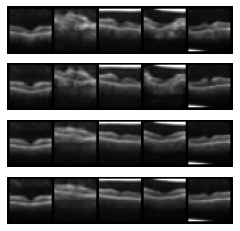

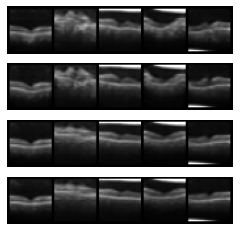

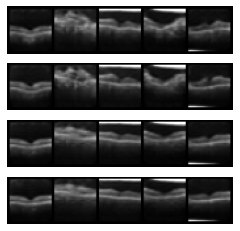

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 82.21500325202942 , Gen Loss: 2.055804830883183 Disc Loss: 0.4449320416611098
Epoch 28 of 100


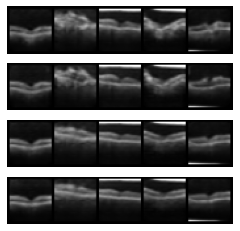

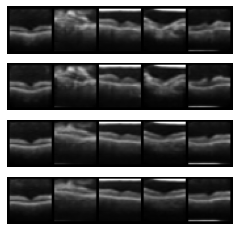

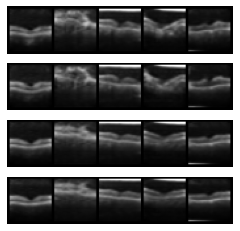

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 82.24683547019958 , Gen Loss: 1.9913304869353796 Disc Loss: 0.44899602117679044
Epoch 29 of 100


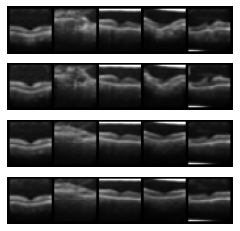

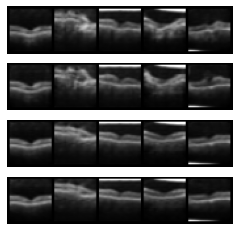

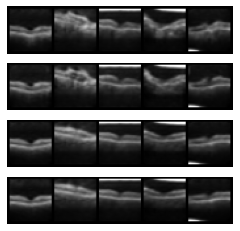

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 82.25080752372742 , Gen Loss: 1.9373037998707388 Disc Loss: 0.452739572540189
Epoch 30 of 100


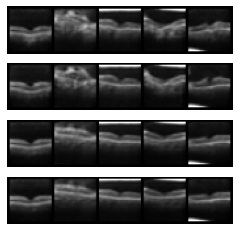

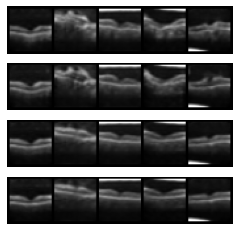

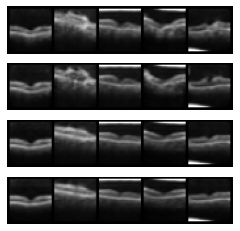

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 82.30028939247131 , Gen Loss: 2.0000852765267703 Disc Loss: 0.4471190158960575
Epoch 31 of 100


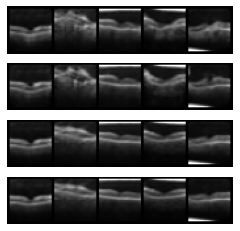

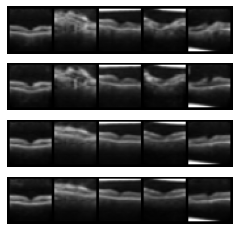

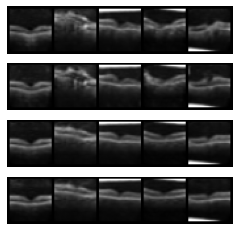

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_31.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_31.pth
Epoch: 31, Duration: 82.23271226882935 , Gen Loss: 1.952831180688778 Disc Loss: 0.4486910213434964
Epoch 32 of 100


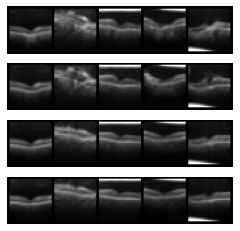

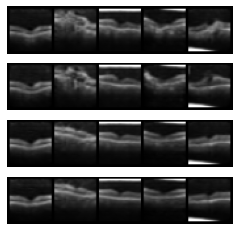

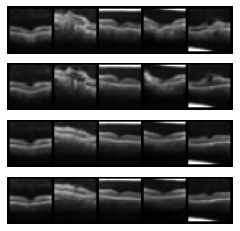

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_32.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_32.pth
Epoch: 32, Duration: 82.1264750957489 , Gen Loss: 2.1934661509894644 Disc Loss: 0.4322015946710506
Epoch 33 of 100


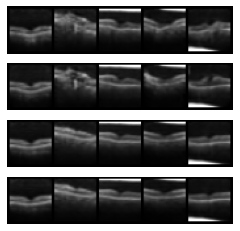

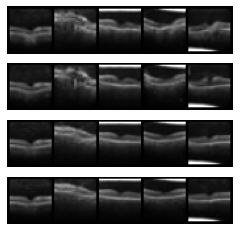

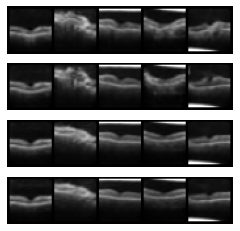

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_33.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_33.pth
Epoch: 33, Duration: 82.18244624137878 , Gen Loss: 2.1110093599002844 Disc Loss: 0.4399589534582517
Epoch 34 of 100


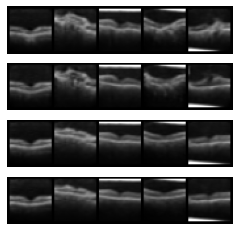

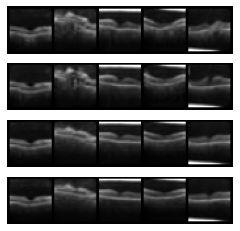

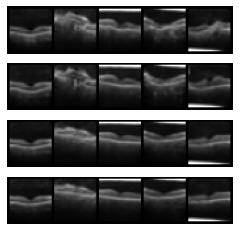

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 82.1667902469635 , Gen Loss: 2.079914685002616 Disc Loss: 0.4436040440950173
Epoch 35 of 100


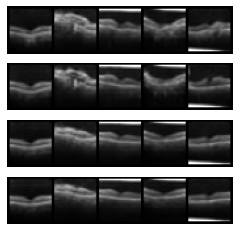

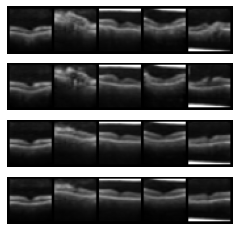

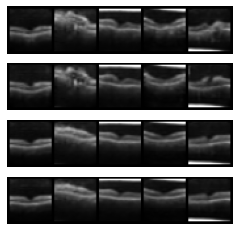

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 82.30774164199829 , Gen Loss: 1.9539200593473331 Disc Loss: 0.4527493905613632
Epoch 36 of 100


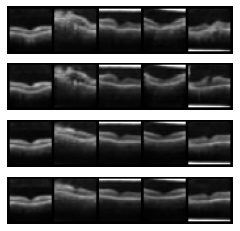

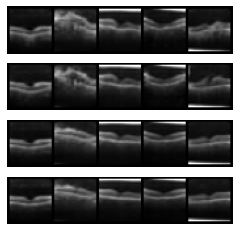

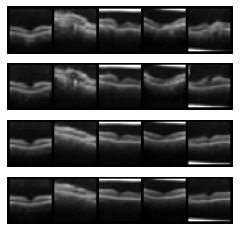

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_36.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_36.pth
Epoch: 36, Duration: 82.2534019947052 , Gen Loss: 2.0374360746637667 Disc Loss: 0.4434666719456897
Epoch 37 of 100


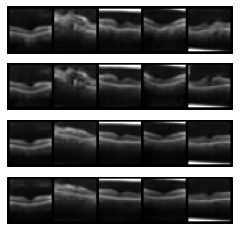

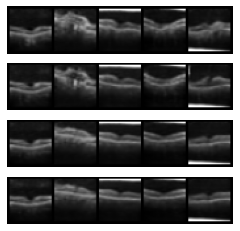

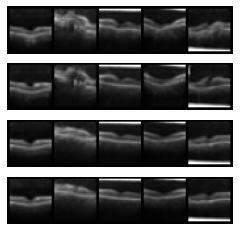

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 82.2924108505249 , Gen Loss: 2.0981721970310945 Disc Loss: 0.4415832148224709
Epoch 38 of 100


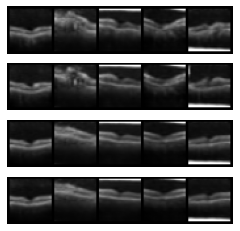

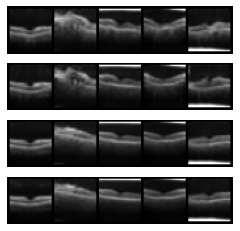

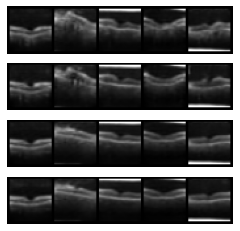

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 82.2444999217987 , Gen Loss: 2.147973528370795 Disc Loss: 0.43677358665377475
Epoch 39 of 100


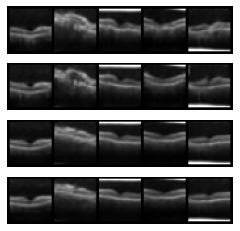

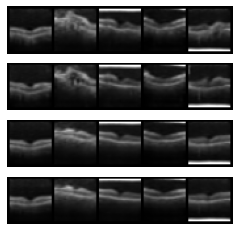

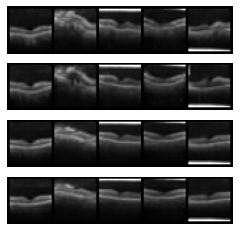

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 82.20702266693115 , Gen Loss: 2.1562033543810335 Disc Loss: 0.4368549760456313
Epoch 40 of 100


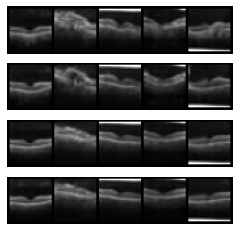

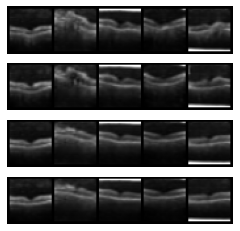

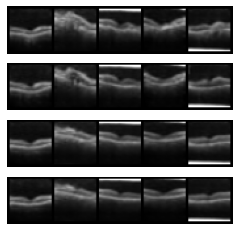

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_40.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_40.pth
Epoch: 40, Duration: 82.2045521736145 , Gen Loss: 2.332137645290684 Disc Loss: 0.43093434861557084
Epoch 41 of 100


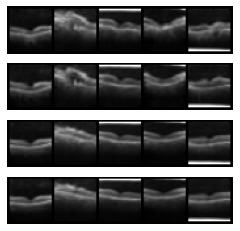

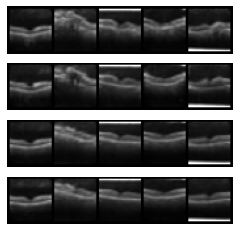

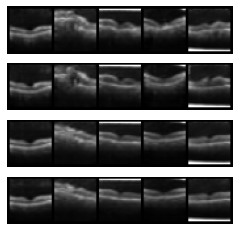

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 82.20388889312744 , Gen Loss: 2.2275376499071577 Disc Loss: 0.43182362089262083
Epoch 42 of 100


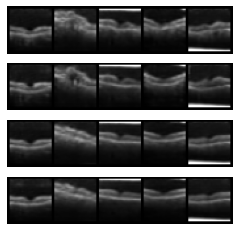

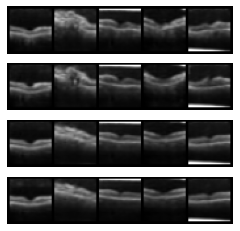

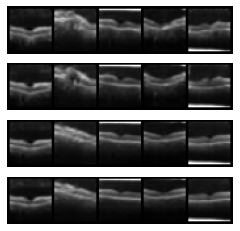

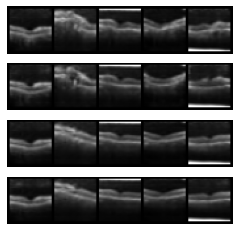

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 82.45377683639526 , Gen Loss: 2.4515355224822266 Disc Loss: 0.4215173435143675
Epoch 43 of 100


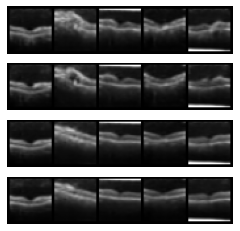

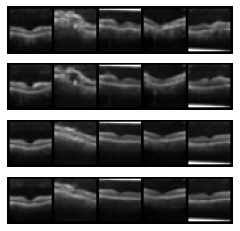

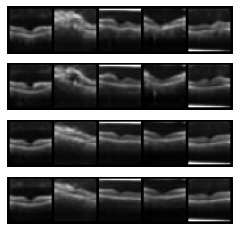

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 82.30187225341797 , Gen Loss: 2.4418011748925386 Disc Loss: 0.42337815907855186
Epoch 44 of 100


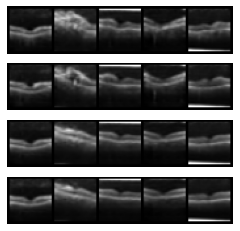

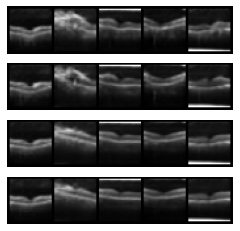

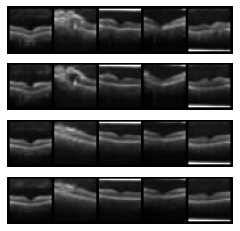

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_44.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_44.pth
Epoch: 44, Duration: 82.1385338306427 , Gen Loss: 2.3893674918185828 Disc Loss: 0.4259825394708495
Epoch 45 of 100


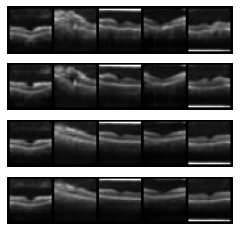

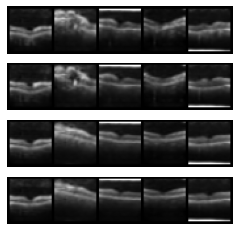

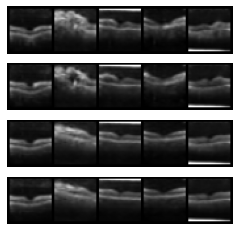

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_45.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_45.pth
Epoch: 45, Duration: 82.14187836647034 , Gen Loss: 2.482724931265837 Disc Loss: 0.42061628961190844
Epoch 46 of 100


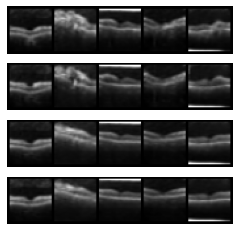

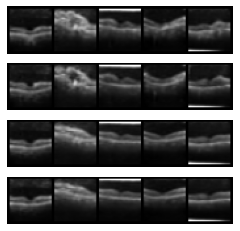

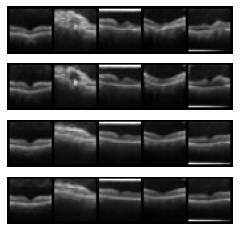

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 82.28679299354553 , Gen Loss: 2.5154020307354554 Disc Loss: 0.41867989532146044
Epoch 47 of 100


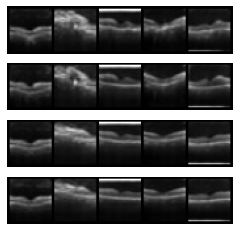

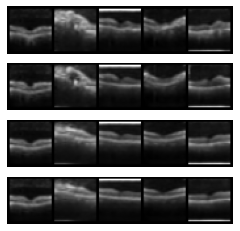

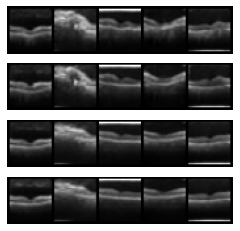

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 82.20668339729309 , Gen Loss: 2.6162144339177447 Disc Loss: 0.42161496269632837
Epoch 48 of 100


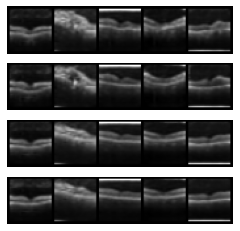

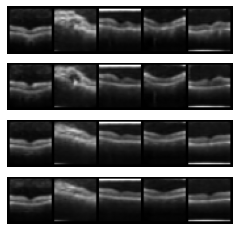

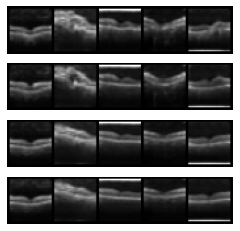

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 82.12802410125732 , Gen Loss: 2.52714390317716 Disc Loss: 0.4158863677457246
Epoch 49 of 100


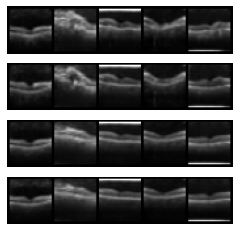

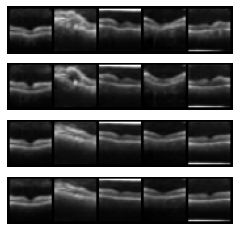

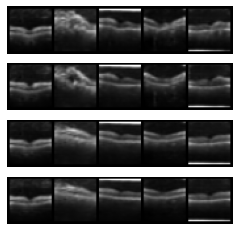

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_49.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_49.pth
Epoch: 49, Duration: 82.19634103775024 , Gen Loss: 2.9193114144875203 Disc Loss: 0.40551180502836565
Epoch 50 of 100


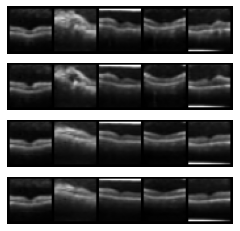

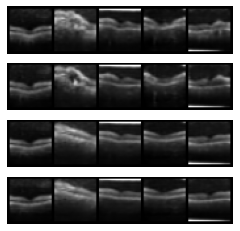

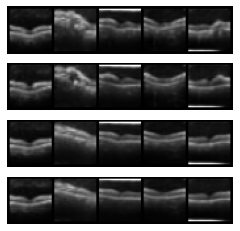

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 82.24003839492798 , Gen Loss: 2.68365117540548 Disc Loss: 0.4134533418780841
Epoch 51 of 100


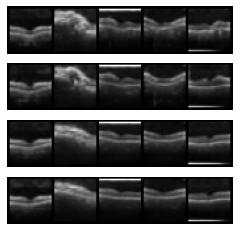

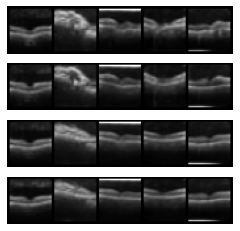

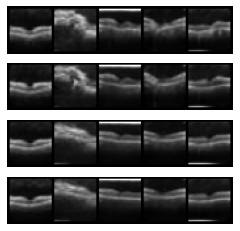

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 82.31615042686462 , Gen Loss: 2.475004680591319 Disc Loss: 0.4258714155005796
Epoch 52 of 100


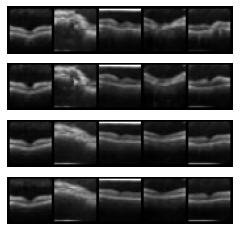

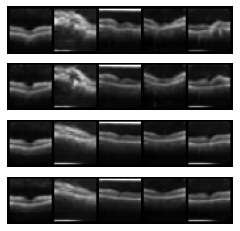

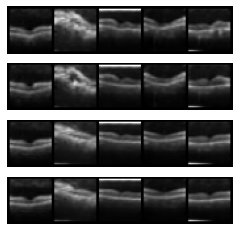

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 82.27399611473083 , Gen Loss: 2.7175423433220143 Disc Loss: 0.4135550886362937
Epoch 53 of 100


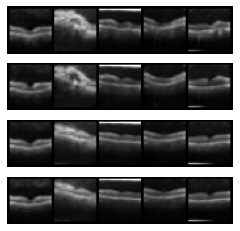

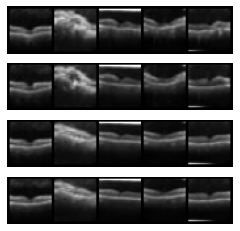

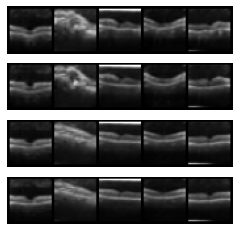

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 82.21543788909912 , Gen Loss: 2.7755787903813207 Disc Loss: 0.41175666759851043
Epoch 54 of 100


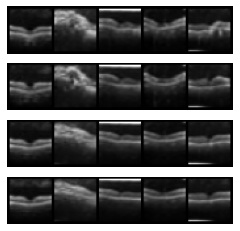

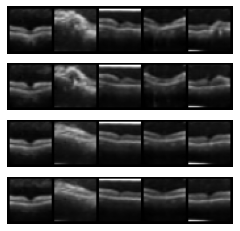

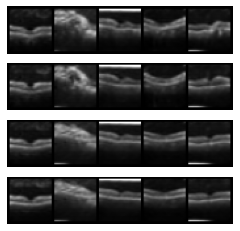

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 82.21309471130371 , Gen Loss: 2.828520125260318 Disc Loss: 0.407273318321245
Epoch 55 of 100


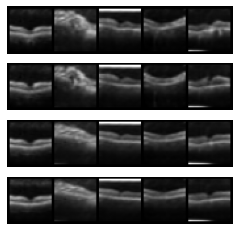

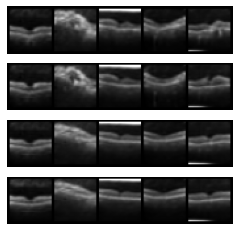

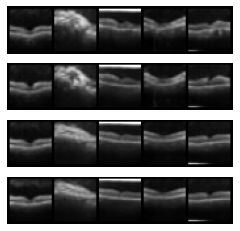

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 82.22510385513306 , Gen Loss: 2.977131784933882 Disc Loss: 0.40476599608112684
Epoch 56 of 100


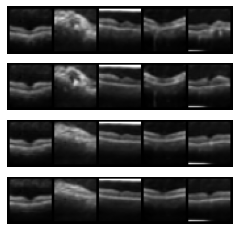

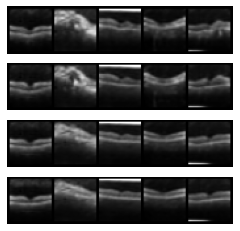

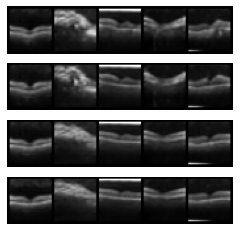

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 82.14302182197571 , Gen Loss: 2.668510744842373 Disc Loss: 0.41932367699559897
Epoch 57 of 100


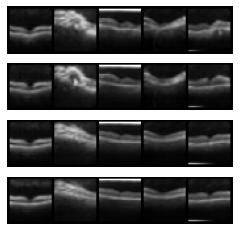

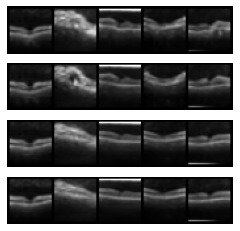

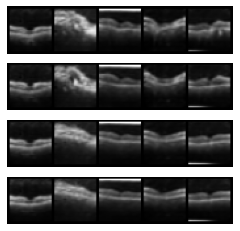

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 82.26556873321533 , Gen Loss: 2.6151314861454495 Disc Loss: 0.4283494038978426
Epoch 58 of 100


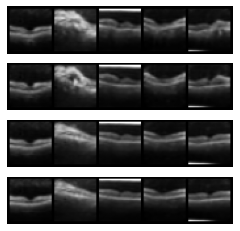

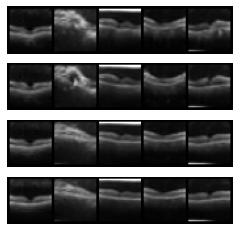

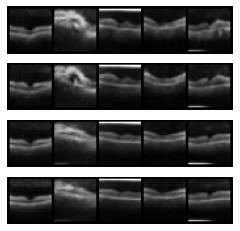

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_58.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_58.pth
Epoch: 58, Duration: 82.25554060935974 , Gen Loss: 3.0116774341639565 Disc Loss: 0.3998321398894098
Epoch 59 of 100


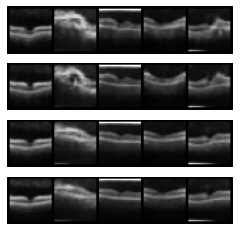

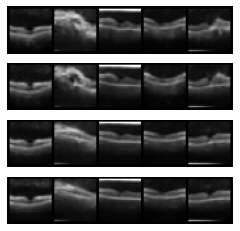

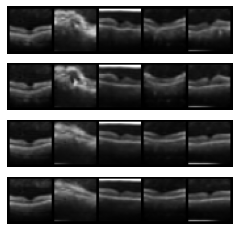

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_59.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_59.pth
Epoch: 59, Duration: 82.2105360031128 , Gen Loss: 2.9235742790607016 Disc Loss: 0.4162324029001713
Epoch 60 of 100


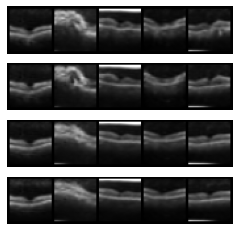

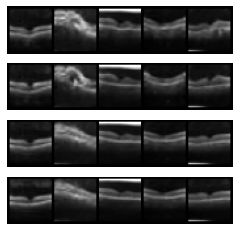

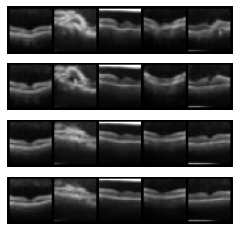

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 82.17753028869629 , Gen Loss: 2.8540107538188497 Disc Loss: 0.41377020348389876
Epoch 61 of 100


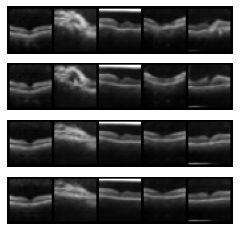

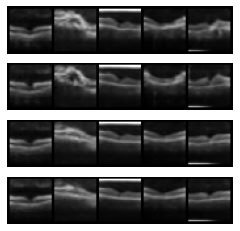

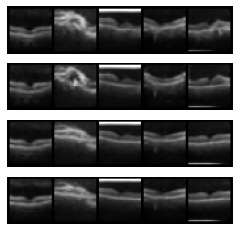

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 82.23453569412231 , Gen Loss: 2.6911771494814163 Disc Loss: 0.41624530658514314
Epoch 62 of 100


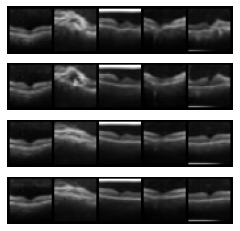

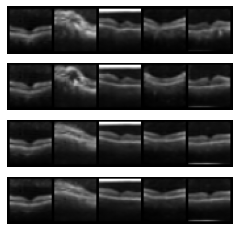

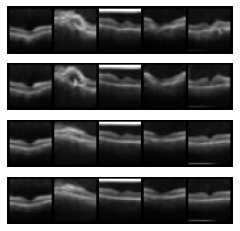

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 82.17621922492981 , Gen Loss: 2.6763664441355397 Disc Loss: 0.42505335393220967
Epoch 63 of 100


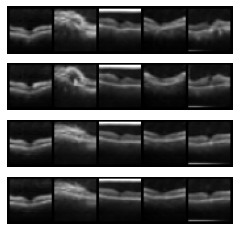

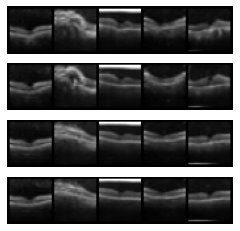

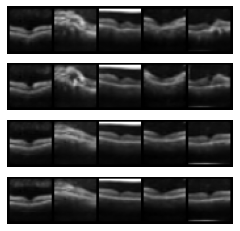

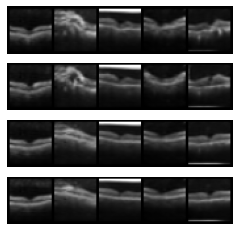

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_63.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_63.pth
Epoch: 63, Duration: 82.24970936775208 , Gen Loss: 2.6252066192537726 Disc Loss: 0.4197907342886014
Epoch 64 of 100


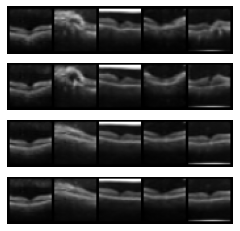

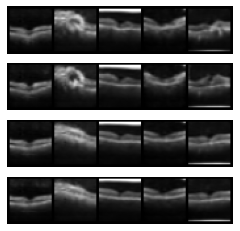

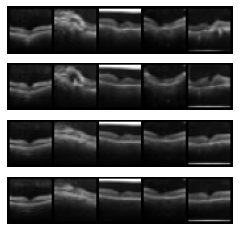

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 82.17001628875732 , Gen Loss: 2.469358957754137 Disc Loss: 0.43543132290181275
Epoch 65 of 100


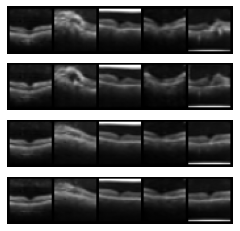

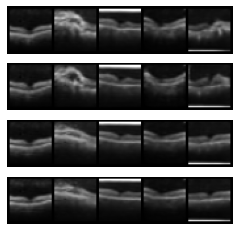

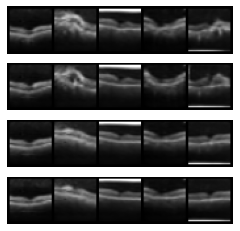

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 82.34753823280334 , Gen Loss: 2.7373322681247885 Disc Loss: 0.4143708259384265
Epoch 66 of 100


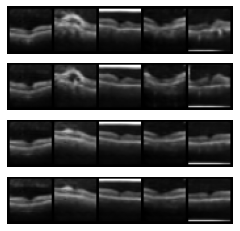

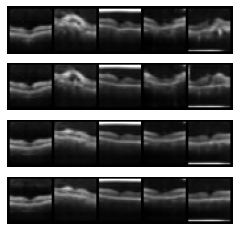

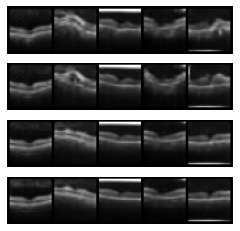

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 82.08528923988342 , Gen Loss: 2.5804037426777597 Disc Loss: 0.4265480975640408
Epoch 67 of 100


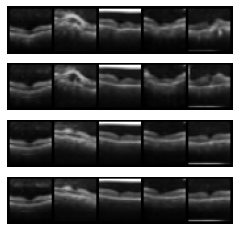

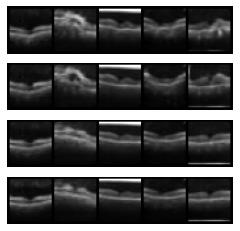

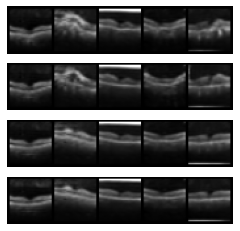

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_67.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_67.pth
Epoch: 67, Duration: 82.19722962379456 , Gen Loss: 2.7245266832175794 Disc Loss: 0.4210383443017327
Epoch 68 of 100


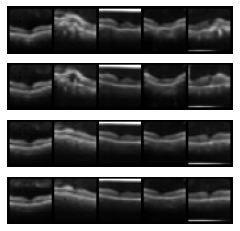

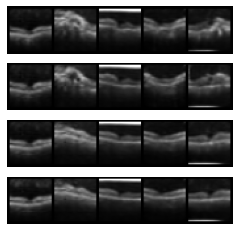

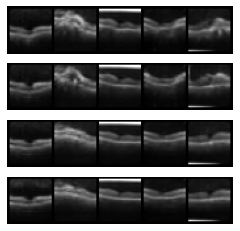

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_68.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_68.pth
Epoch: 68, Duration: 82.23703336715698 , Gen Loss: 3.020184569180422 Disc Loss: 0.4125380618633113
Epoch 69 of 100


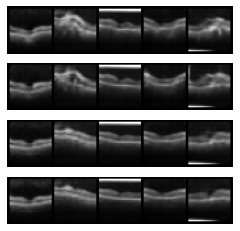

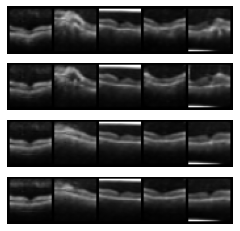

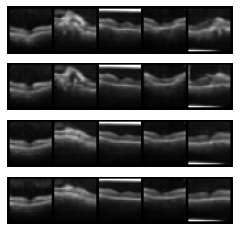

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 82.12855911254883 , Gen Loss: 2.834661317541574 Disc Loss: 0.42194180261754055
Epoch 70 of 100


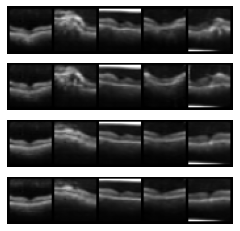

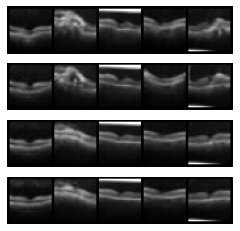

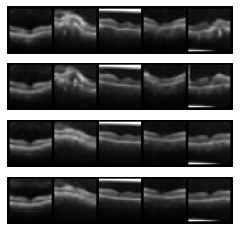

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 82.2099461555481 , Gen Loss: 3.0508225658360435 Disc Loss: 0.4109274655816244
Epoch 71 of 100


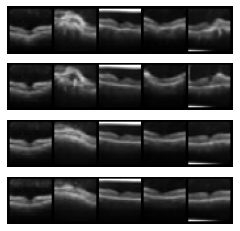

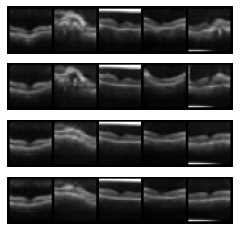

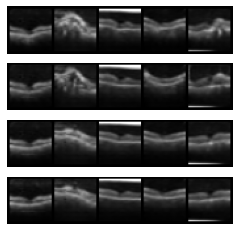

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 82.26651954650879 , Gen Loss: 2.9148783174492445 Disc Loss: 0.4145251091283072
Epoch 72 of 100


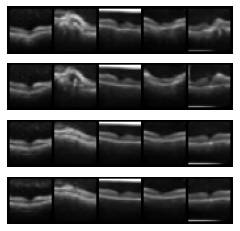

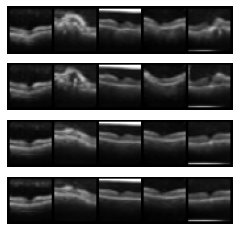

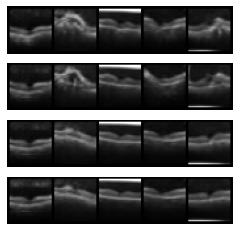

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_72.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_72.pth
Epoch: 72, Duration: 82.1975667476654 , Gen Loss: 2.662170948018507 Disc Loss: 0.43206410230105563
Epoch 73 of 100


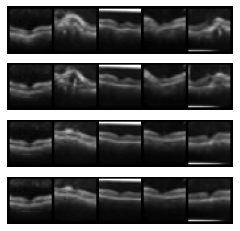

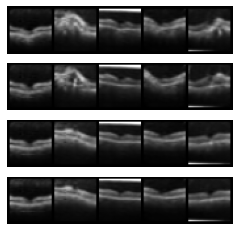

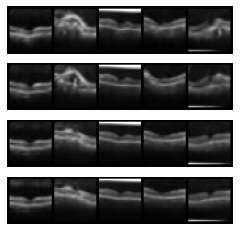

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_73.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_73.pth
Epoch: 73, Duration: 82.28475713729858 , Gen Loss: 2.986331711583245 Disc Loss: 0.41101502630107617
Epoch 74 of 100


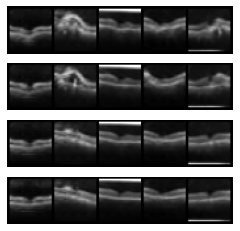

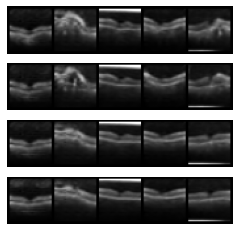

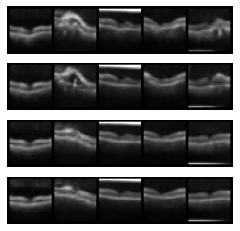

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 82.24279618263245 , Gen Loss: 2.8586128009684337 Disc Loss: 0.42362557321214234
Epoch 75 of 100


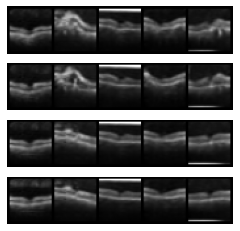

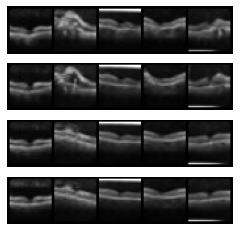

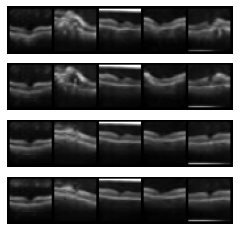

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 82.23458743095398 , Gen Loss: 2.888482347117782 Disc Loss: 0.4225829394369954
Epoch 76 of 100


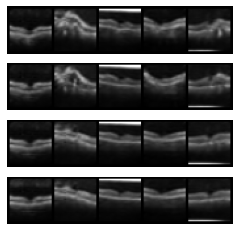

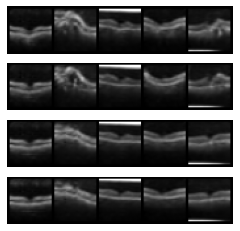

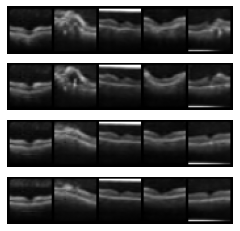

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 82.21636629104614 , Gen Loss: 2.9820678852447244 Disc Loss: 0.41380017850364703
Epoch 77 of 100


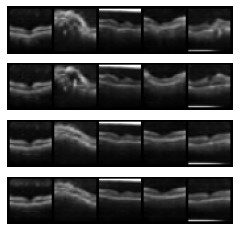

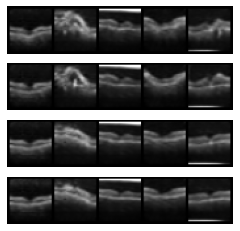

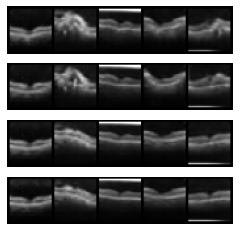

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_77.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_77.pth
Epoch: 77, Duration: 82.2194471359253 , Gen Loss: 2.6353830583111915 Disc Loss: 0.4206237833668455
Epoch 78 of 100


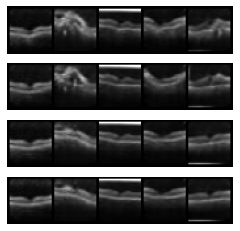

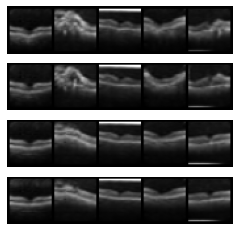

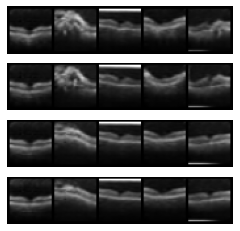

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_78.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_78.pth
Epoch: 78, Duration: 82.15491509437561 , Gen Loss: 2.9346397098802797 Disc Loss: 0.4088779436431158
Epoch 79 of 100


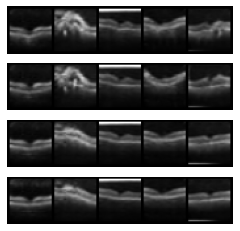

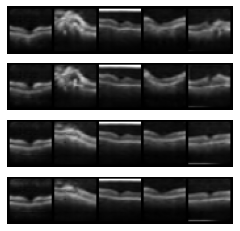

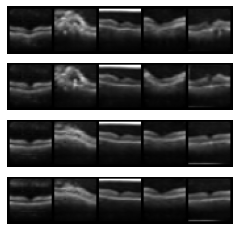

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 82.18448519706726 , Gen Loss: 2.846668957805431 Disc Loss: 0.41788896355037597
Epoch 80 of 100


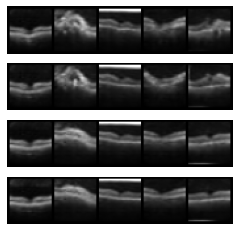

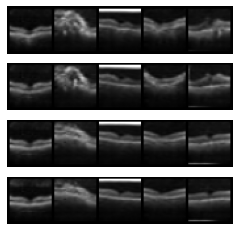

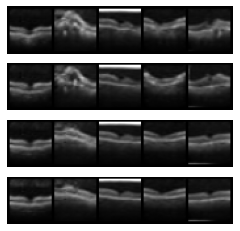

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 82.17660069465637 , Gen Loss: 2.889098518111965 Disc Loss: 0.4202999489623193
Epoch 81 of 100


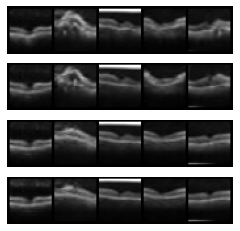

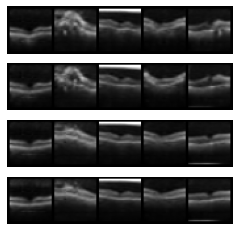

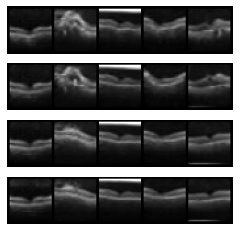

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_81.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_81.pth
Epoch: 81, Duration: 82.34870600700378 , Gen Loss: 3.1569620269396883 Disc Loss: 0.40728129295885185
Epoch 82 of 100


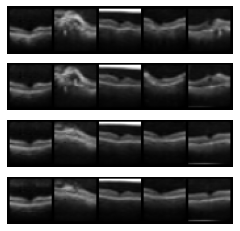

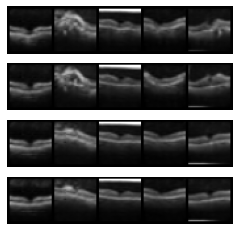

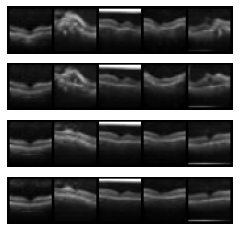

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 82.21831703186035 , Gen Loss: 3.229064933266309 Disc Loss: 0.402225573083907
Epoch 83 of 100


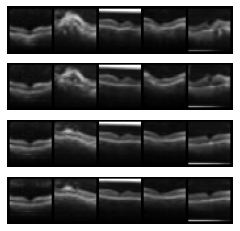

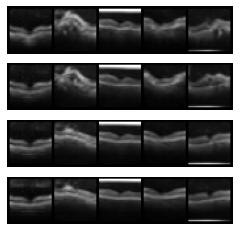

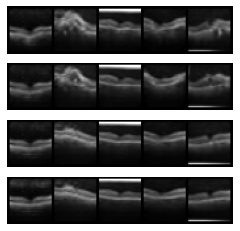

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 82.27915453910828 , Gen Loss: 3.0757983293494875 Disc Loss: 0.4075378438631677
Epoch 84 of 100


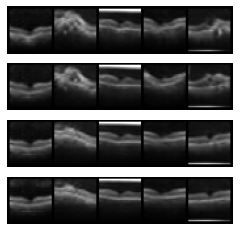

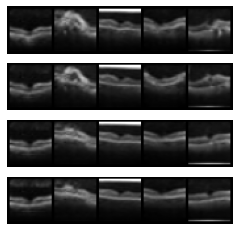

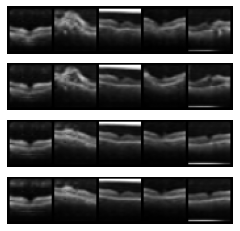

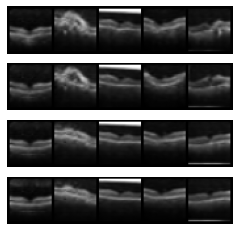

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 82.40619540214539 , Gen Loss: 2.801434569180422 Disc Loss: 0.4277585193173774
Epoch 85 of 100


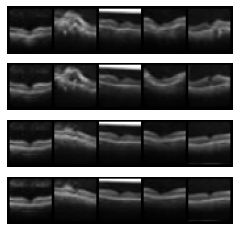

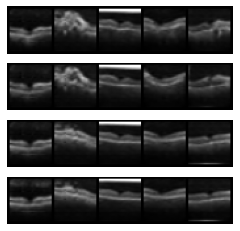

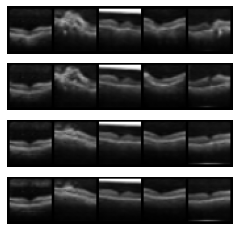

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_85.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_85.pth
Epoch: 85, Duration: 82.20895767211914 , Gen Loss: 3.4311735075966636 Disc Loss: 0.396048314602419
Epoch 86 of 100


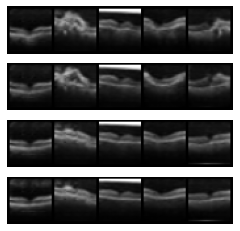

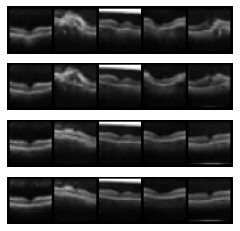

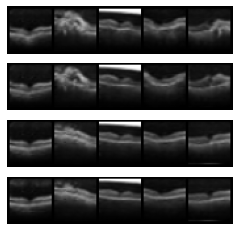

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_86.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_86.pth
Epoch: 86, Duration: 82.16506958007812 , Gen Loss: 3.310504016332058 Disc Loss: 0.40140258246817195
Epoch 87 of 100


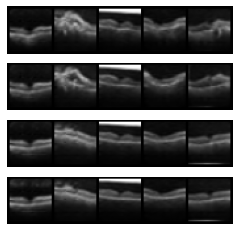

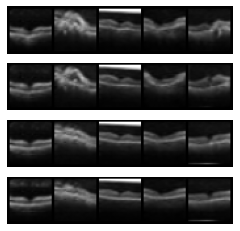

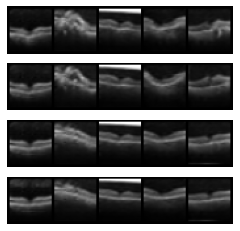

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_87.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_87.pth
Epoch: 87, Duration: 82.21431112289429 , Gen Loss: 3.643610159319634 Disc Loss: 0.3909534829370005
Epoch 88 of 100


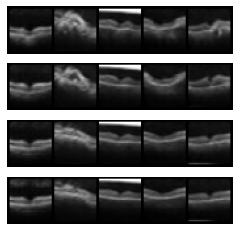

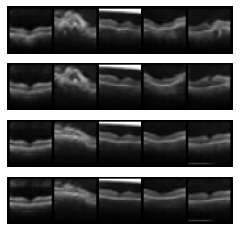

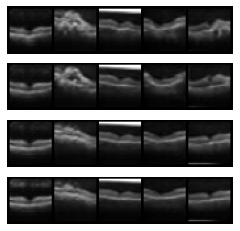

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 82.19571900367737 , Gen Loss: 3.324001110518379 Disc Loss: 0.40441078408239894
Epoch 89 of 100


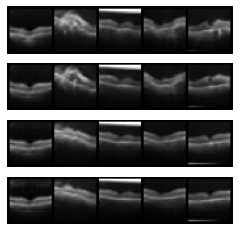

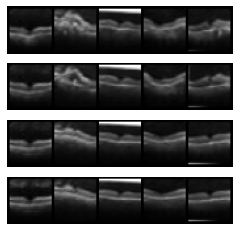

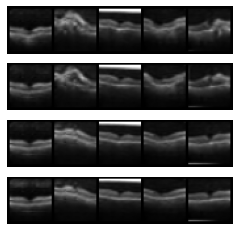

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 82.2784857749939 , Gen Loss: 3.5412347271664086 Disc Loss: 0.39341411948459637
Epoch 90 of 100


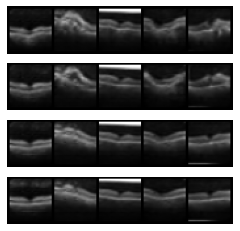

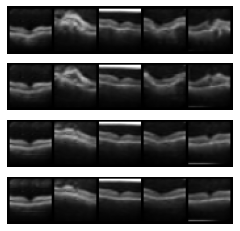

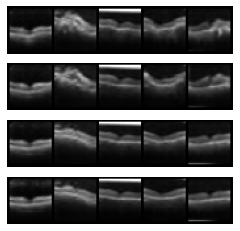

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 82.24787187576294 , Gen Loss: 3.1672359248848445 Disc Loss: 0.41241110883849524
Epoch 91 of 100


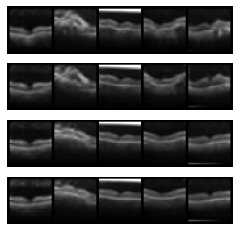

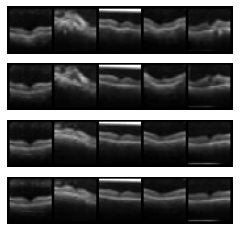

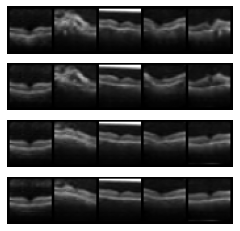

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 82.20092391967773 , Gen Loss: 3.500336297280384 Disc Loss: 0.3941038655272526
Epoch 92 of 100


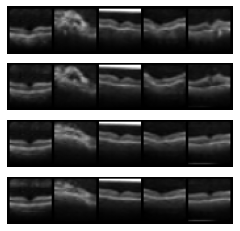

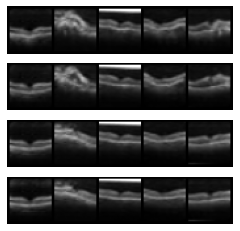

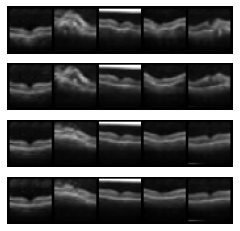

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 82.15971231460571 , Gen Loss: 3.57781354832422 Disc Loss: 0.3920841182407132
Epoch 93 of 100


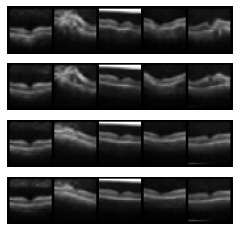

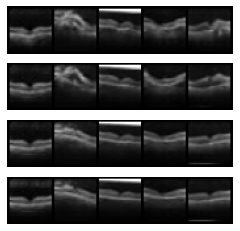

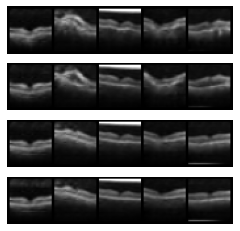

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 82.34023213386536 , Gen Loss: 3.4990282964186425 Disc Loss: 0.39543871567138916
Epoch 94 of 100


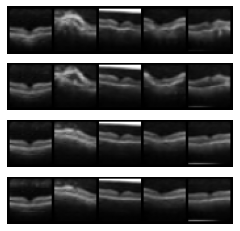

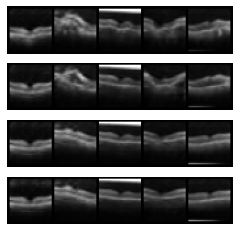

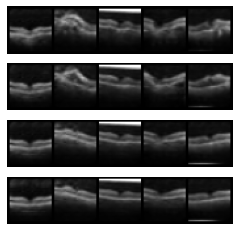

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_94.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_94.pth
Epoch: 94, Duration: 82.1562147140503 , Gen Loss: 3.1054729577233604 Disc Loss: 0.4162900687469865
Epoch 95 of 100


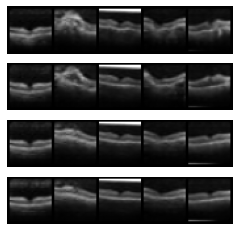

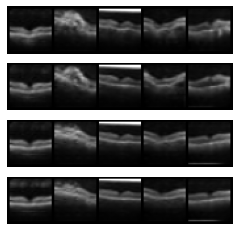

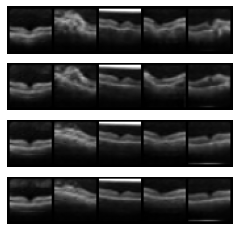

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 82.25108313560486 , Gen Loss: 3.2924394985483754 Disc Loss: 0.4015314990972229
Epoch 96 of 100


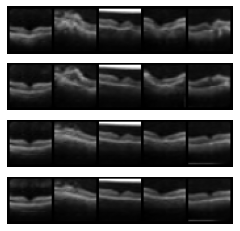

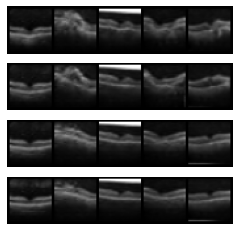

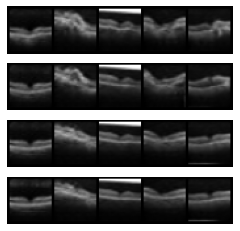

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 82.21760272979736 , Gen Loss: 3.0877101136678395 Disc Loss: 0.4101230290222309
Epoch 97 of 100


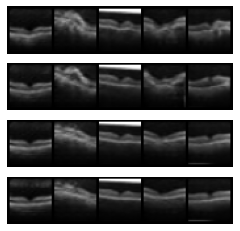

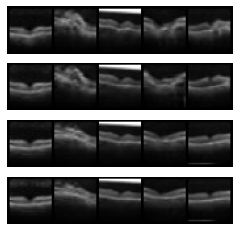

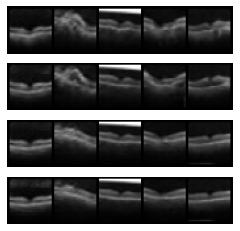

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 82.10431122779846 , Gen Loss: 3.338366358217836 Disc Loss: 0.40543654689054853
Epoch 98 of 100


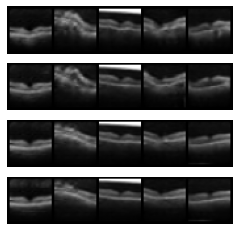

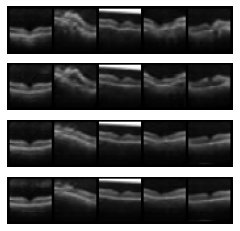

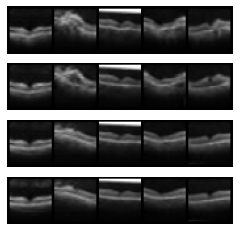

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_98.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_98.pth
Epoch: 98, Duration: 82.21083688735962 , Gen Loss: 3.6206743000913035 Disc Loss: 0.3900116341547237
Epoch 99 of 100


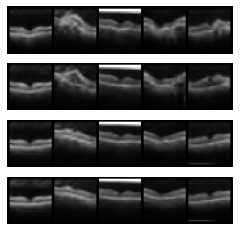

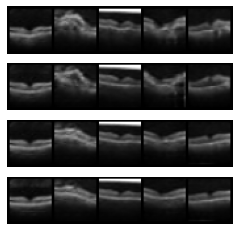

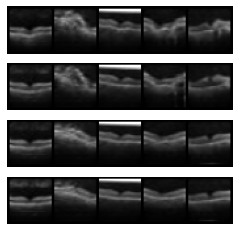

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_99.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_99.pth
Epoch: 99, Duration: 82.19051456451416 , Gen Loss: 3.5821309129333074 Disc Loss: 0.3946691431055531
Epoch 100 of 100


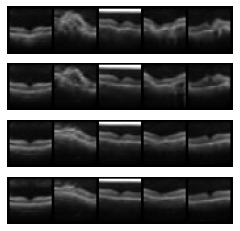

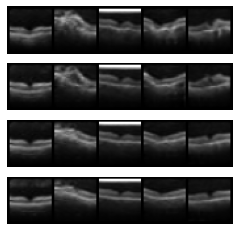

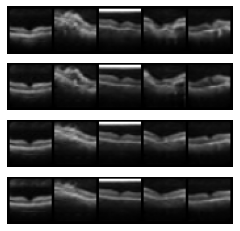

New Generator model saved at trained_models/conditionalGAN/octmnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/octmnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 82.24855542182922 , Gen Loss: 3.380718656708762 Disc Loss: 0.40644243321501483


In [106]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [107]:
# Removes saved intermediary models
model_path = f"models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 4
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 3899 (4% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.89it/s]


train -- accuracy: 0.7943
val -- accuracy: 0.8488,  AUC: 0.9303
Epoch 1



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.90it/s]


train -- accuracy: 0.8602
val -- accuracy: 0.8777,  AUC: 0.9508
Epoch 2



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.95it/s]


train -- accuracy: 0.8801
val -- accuracy: 0.8814,  AUC: 0.9569
Epoch 3



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.32it/s]


train -- accuracy: 0.8926
val -- accuracy: 0.8658,  AUC: 0.9539
Epoch 4



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.80it/s]


train -- accuracy: 0.9031
val -- accuracy: 0.8904,  AUC: 0.9639
Epoch 5



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.71it/s]


train -- accuracy: 0.9098
val -- accuracy: 0.8896,  AUC: 0.9629
Epoch 6



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 115.67it/s]


train -- accuracy: 0.9178
val -- accuracy: 0.9072,  AUC: 0.9686
Epoch 7



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.97it/s]


train -- accuracy: 0.9231
val -- accuracy: 0.8993,  AUC: 0.9702
Epoch 8



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.62it/s]


train -- accuracy: 0.9281
val -- accuracy: 0.9095,  AUC: 0.9701
Epoch 9



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.52it/s]


train -- accuracy: 0.9341
val -- accuracy: 0.9046,  AUC: 0.9675
Epoch 10



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.09it/s]


train -- accuracy: 0.9371
val -- accuracy: 0.9097,  AUC: 0.9729
Epoch 11



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.95it/s]


train -- accuracy: 0.9424
val -- accuracy: 0.9027,  AUC: 0.9691
Epoch 12



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.40it/s]


train -- accuracy: 0.9468
val -- accuracy: 0.9141,  AUC: 0.9696
Epoch 13



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.63it/s]


train -- accuracy: 0.9505
val -- accuracy: 0.9104,  AUC: 0.9692
Epoch 14



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 115.60it/s]


train -- accuracy: 0.9539
val -- accuracy: 0.8783,  AUC: 0.967
Epoch 15



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.69it/s]


train -- accuracy: 0.9558
val -- accuracy: 0.9026,  AUC: 0.9687
Epoch 16



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.81it/s]


train -- accuracy: 0.9585
val -- accuracy: 0.9114,  AUC: 0.9723
Epoch 17



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.75it/s]


train -- accuracy: 0.9623
val -- accuracy: 0.8893,  AUC: 0.9682
Epoch 18



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.75it/s]


train -- accuracy: 0.9633
val -- accuracy: 0.9106,  AUC: 0.9698
Epoch 19



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.28it/s]


train -- accuracy: 0.9669
val -- accuracy: 0.9103,  AUC: 0.9675
test -- accuracy: 0.673,  AUC: 0.9293


<Figure size 720x720 with 0 Axes>

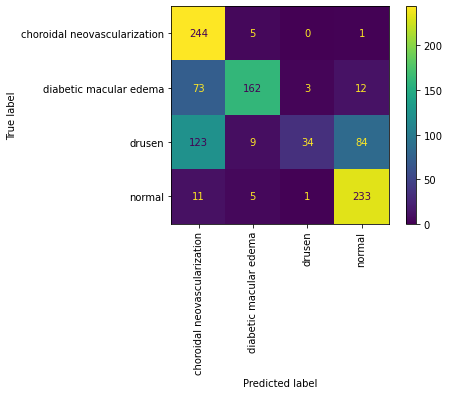

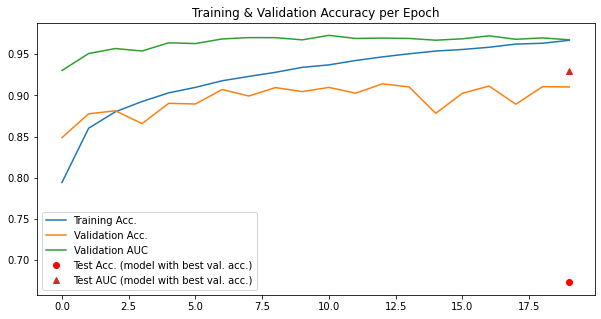

In [108]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [109]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OCTMNIST",
  "description": "The OCTMNIST is based on a prior dataset of 109,309 valid optical coherence tomography (OCT) images for retinal diseases. The dataset is comprised of 4 diagnosis categories, leading to a multi-class classification task. We split the source training set with a ratio of 9:1 into training and validation set, and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22121,536)\u00d7(277\u2212512). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/octmnist.npz?download=1",
  "MD5": "c68d92d5b585d8d81f7112f81e2d0842",
  "task": "multi-class",
  "label": {
    "0": "choroidal neovascularization",
    "1": "diabetic macular edema",
    "2": "drusen",
    "3": "normal"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 97477,
    "val": 10832,
    "test": 1000
  },
  "license": "CC BY 4.0"
}
--------------------------------

100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.71it/s]


train -- accuracy: 0.7001
val -- accuracy: 0.7868,  AUC: 0.9439
Epoch 1



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.61it/s]


train -- accuracy: 0.8137
val -- accuracy: 0.8735,  AUC: 0.9602
Epoch 2



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.91it/s]


train -- accuracy: 0.8495
val -- accuracy: 0.836,  AUC: 0.9579
Epoch 3



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.57it/s]


train -- accuracy: 0.8712
val -- accuracy: 0.867,  AUC: 0.9643
Epoch 4



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.35it/s]


train -- accuracy: 0.8885
val -- accuracy: 0.827,  AUC: 0.961
Epoch 5



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.94it/s]


train -- accuracy: 0.9021
val -- accuracy: 0.8766,  AUC: 0.9684
Epoch 6



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.24it/s]


train -- accuracy: 0.914
val -- accuracy: 0.8671,  AUC: 0.9682
Epoch 7



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.35it/s]


train -- accuracy: 0.9234
val -- accuracy: 0.8384,  AUC: 0.9644
Epoch 8



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.52it/s]


train -- accuracy: 0.9327
val -- accuracy: 0.8838,  AUC: 0.9672
Epoch 9



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 116.11it/s]


train -- accuracy: 0.9397
val -- accuracy: 0.8987,  AUC: 0.9686
Epoch 10



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.10it/s]


train -- accuracy: 0.9452
val -- accuracy: 0.8867,  AUC: 0.9692
Epoch 11



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.61it/s]


train -- accuracy: 0.9509
val -- accuracy: 0.9056,  AUC: 0.9687
Epoch 12



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.46it/s]


train -- accuracy: 0.9558
val -- accuracy: 0.8753,  AUC: 0.9654
Epoch 13



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.28it/s]


train -- accuracy: 0.9599
val -- accuracy: 0.8992,  AUC: 0.9671
Epoch 14



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.09it/s]


train -- accuracy: 0.9642
val -- accuracy: 0.9057,  AUC: 0.9687
Epoch 15



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.43it/s]


train -- accuracy: 0.9652
val -- accuracy: 0.8944,  AUC: 0.9684
Epoch 16



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.45it/s]


train -- accuracy: 0.97
val -- accuracy: 0.9072,  AUC: 0.9688
Epoch 17



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 115.90it/s]


train -- accuracy: 0.9726
val -- accuracy: 0.9102,  AUC: 0.9709
Epoch 18



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.23it/s]


train -- accuracy: 0.9741
val -- accuracy: 0.9027,  AUC: 0.969
Epoch 19



100%|██████████████████████████████████████| 1584/1584 [00:13<00:00, 117.11it/s]


train -- accuracy: 0.9749
val -- accuracy: 0.9001,  AUC: 0.9692
test -- accuracy: 0.7,  AUC: 0.9217


<Figure size 720x720 with 0 Axes>

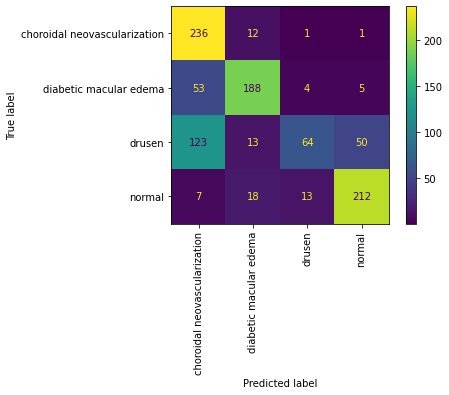

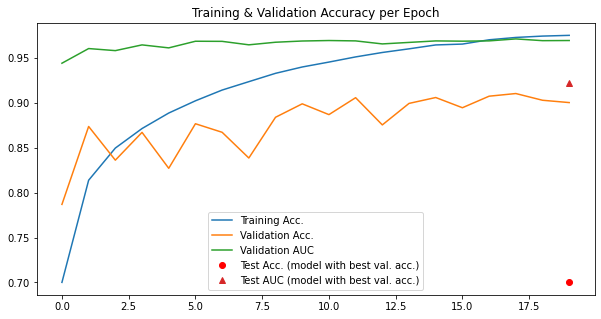

In [110]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### PneumoniaMNIST

#### Training the Conditional GAN

In [111]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "pneumoniamnist"
base_dataset = pneumoniamnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 4.032091379165649 , Gen Loss: 1.8366879679534833 Disc Loss: 0.2773889429810296
Epoch 2 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 3.940758228302002 , Gen Loss: 2.267326931884558 Disc Loss: 0.23020254441409568
Epoch 3 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 3.9422757625579834 , Gen Loss: 2.7084900783905055 Disc Loss: 0.2124084887508629
Epoch 4 of 100
New Generator mode

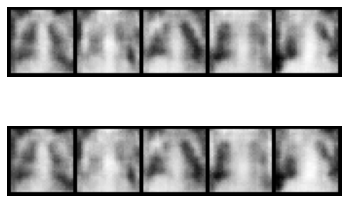

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 4.053317070007324 , Gen Loss: 2.913069965683411 Disc Loss: 0.24847816590444458
Epoch 8 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_8.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_8.pth
Epoch: 8, Duration: 3.9546821117401123 , Gen Loss: 2.6713244908931606 Disc Loss: 0.28163690169989913
Epoch 9 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_9.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_9.pth
Epoch: 9, Duration: 3.957934617996216 , Gen Loss: 2.127046881637638 Disc Loss: 0.34657200737939414
Epoch 10 of 100
New Generator model saved at tr

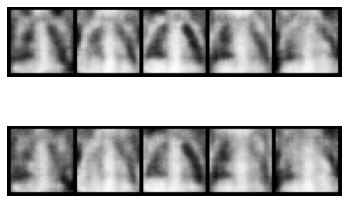

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 4.035510063171387 , Gen Loss: 1.2000671231149107 Disc Loss: 0.5042583559566164
Epoch 15 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 3.944058895111084 , Gen Loss: 1.125866522906489 Disc Loss: 0.5093993103494052
Epoch 16 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 4.022343873977661 , Gen Loss: 1.130550932256266 Disc Loss: 0.5103017179866717
Epoch 17 of 100
New Generator model save

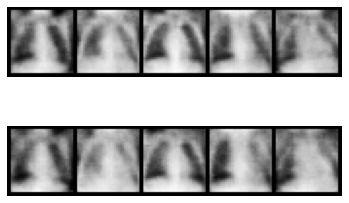

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 4.09989333152771 , Gen Loss: 1.135015158705926 Disc Loss: 0.49038548497902507
Epoch 22 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_22.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_22.pth
Epoch: 22, Duration: 3.975506544113159 , Gen Loss: 1.1427975819084537 Disc Loss: 0.48102532632288125
Epoch 23 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 3.9626219272613525 , Gen Loss: 1.1615511911241503 Disc Loss: 0.48395397669193396
Epoch 24 of 100
New Generator model 

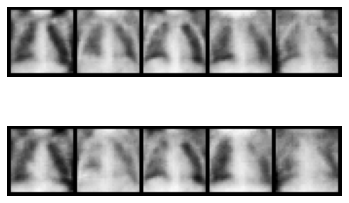

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 4.03904128074646 , Gen Loss: 1.160518934692279 Disc Loss: 0.4911463760985291
Epoch 29 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 3.9530842304229736 , Gen Loss: 1.1388465278515294 Disc Loss: 0.4733327705169392
Epoch 30 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 3.9459049701690674 , Gen Loss: 1.1284867305318076 Disc Loss: 0.4855970513952315
Epoch 31 of 100
New Generator model sa

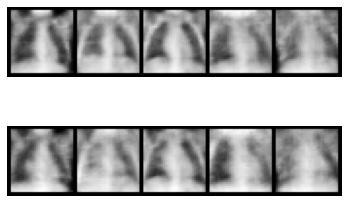

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 4.057217597961426 , Gen Loss: 1.13517062463493 Disc Loss: 0.4921775435429057
Epoch 35 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 3.952918767929077 , Gen Loss: 1.1458320196341334 Disc Loss: 0.5070586095143904
Epoch 36 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_36.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_36.pth
Epoch: 36, Duration: 3.9596498012542725 , Gen Loss: 1.121016276318235 Disc Loss: 0.49312050300021243
Epoch 37 of 100
New Generator model sav

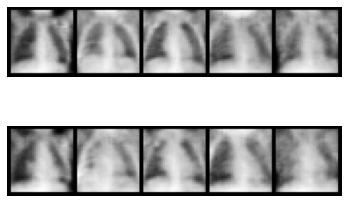

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 4.053588390350342 , Gen Loss: 1.092890425870858 Disc Loss: 0.5082732454233485
Epoch 42 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 3.9448108673095703 , Gen Loss: 1.078005211375584 Disc Loss: 0.5141841658314306
Epoch 43 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 3.9475655555725098 , Gen Loss: 1.100998300764656 Disc Loss: 0.5118012019103122
Epoch 44 of 100
New Generator model sav

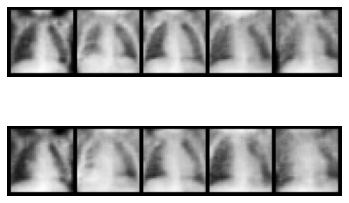

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 4.050466060638428 , Gen Loss: 1.06519716274161 Disc Loss: 0.5316456135998566
Epoch 49 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_49.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_49.pth
Epoch: 49, Duration: 3.949648857116699 , Gen Loss: 1.0252537237149533 Disc Loss: 0.5371135753803367
Epoch 50 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 3.94732403755188 , Gen Loss: 1.036890747796304 Disc Loss: 0.5348899666292747
Epoch 51 of 100
New Generator model saved 

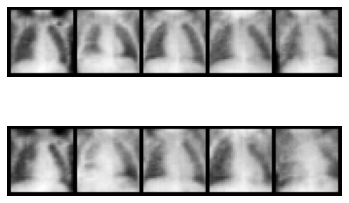

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 4.064794301986694 , Gen Loss: 1.0022273424224724 Disc Loss: 0.5607732288292534
Epoch 56 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 3.971160888671875 , Gen Loss: 1.0099183943885408 Disc Loss: 0.5641166797206882
Epoch 57 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 3.972097873687744 , Gen Loss: 0.9835196781077421 Disc Loss: 0.5650772704040994
Epoch 58 of 100
New Generator model sa

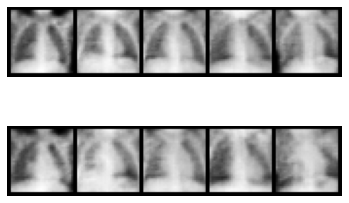

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 4.058826684951782 , Gen Loss: 0.9935309994291631 Disc Loss: 0.5600063223502549
Epoch 62 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 3.9473352432250977 , Gen Loss: 0.9700593778209962 Disc Loss: 0.5635867058066057
Epoch 63 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_63.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_63.pth
Epoch: 63, Duration: 3.949406147003174 , Gen Loss: 0.9777977229582625 Disc Loss: 0.5742529753212616
Epoch 64 of 100
New Generator model s

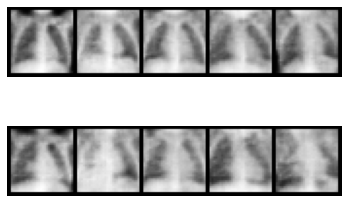

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_68.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_68.pth
Epoch: 68, Duration: 4.058628082275391 , Gen Loss: 0.9593781736206988 Disc Loss: 0.5846570581324342
Epoch 69 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 3.957864284515381 , Gen Loss: 0.936775356607105 Disc Loss: 0.5884532166823757
Epoch 70 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 3.957674026489258 , Gen Loss: 0.9481602541551615 Disc Loss: 0.5883707129155161
Epoch 71 of 100
New Generator model sav

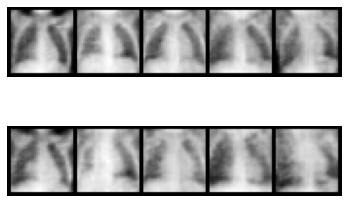

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 4.040428161621094 , Gen Loss: 0.9330123343909303 Disc Loss: 0.5963787120990867
Epoch 76 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 3.9469172954559326 , Gen Loss: 0.9228940848688403 Disc Loss: 0.6001933315798906
Epoch 77 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_77.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_77.pth
Epoch: 77, Duration: 3.949155330657959 , Gen Loss: 0.9205555620088148 Disc Loss: 0.600643135271745
Epoch 78 of 100
New Generator model sa

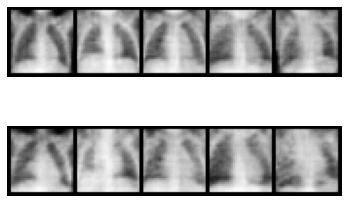

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 4.080207586288452 , Gen Loss: 0.9112600684672366 Disc Loss: 0.6023088712862416
Epoch 83 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 3.9467668533325195 , Gen Loss: 0.8917501833647515 Disc Loss: 0.6053196624263222
Epoch 84 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 3.9538960456848145 , Gen Loss: 0.9041636036732689 Disc Loss: 0.6158685287177411
Epoch 85 of 100
New Generator model 

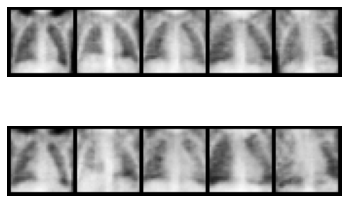

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 4.04249906539917 , Gen Loss: 0.8877361754593246 Disc Loss: 0.608047368674331
Epoch 89 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 3.9565651416778564 , Gen Loss: 0.902430557860291 Disc Loss: 0.6003669473004726
Epoch 90 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 3.951061487197876 , Gen Loss: 0.8870634923268904 Disc Loss: 0.6182881552178473
Epoch 91 of 100
New Generator model save

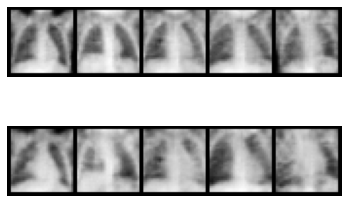

New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 4.053489446640015 , Gen Loss: 0.8842516229025064 Disc Loss: 0.617982097875292
Epoch 96 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 3.976731777191162 , Gen Loss: 0.8828601043104821 Disc Loss: 0.6162905891567545
Epoch 97 of 100
New Generator model saved at trained_models/conditionalGAN/pneumoniamnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/pneumoniamnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 3.956357955932617 , Gen Loss: 0.8864481625358432 Disc Loss: 0.6144859813084113
Epoch 98 of 100
New Generator model sav

In [112]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [113]:
# Removes saved intermediary models
model_path = f"models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 470 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.58it/s]


train -- accuracy: 0.832
val -- accuracy: 0.8989,  AUC: 0.9679
Epoch 1



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.06it/s]


train -- accuracy: 0.9409
val -- accuracy: 0.9389,  AUC: 0.9831
Epoch 2



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.24it/s]


train -- accuracy: 0.9552
val -- accuracy: 0.9542,  AUC: 0.9891
Epoch 3



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.77it/s]


train -- accuracy: 0.9677
val -- accuracy: 0.9523,  AUC: 0.9918
Epoch 4



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 116.95it/s]


train -- accuracy: 0.9728
val -- accuracy: 0.9676,  AUC: 0.9938
Epoch 5



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.45it/s]


train -- accuracy: 0.9793
val -- accuracy: 0.9656,  AUC: 0.9939
Epoch 6



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.16it/s]


train -- accuracy: 0.983
val -- accuracy: 0.9656,  AUC: 0.9933
Epoch 7



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.35it/s]


train -- accuracy: 0.988
val -- accuracy: 0.9599,  AUC: 0.9954
Epoch 8



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.20it/s]


train -- accuracy: 0.9919
val -- accuracy: 0.9656,  AUC: 0.9949
Epoch 9



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.94it/s]


train -- accuracy: 0.9923
val -- accuracy: 0.9695,  AUC: 0.995
Epoch 10



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.46it/s]


train -- accuracy: 0.9936
val -- accuracy: 0.9637,  AUC: 0.9954
Epoch 11



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.11it/s]


train -- accuracy: 0.9975
val -- accuracy: 0.9695,  AUC: 0.9958
Epoch 12



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.76it/s]


train -- accuracy: 0.9985
val -- accuracy: 0.9695,  AUC: 0.9956
Epoch 13



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.82it/s]


train -- accuracy: 0.9981
val -- accuracy: 0.9676,  AUC: 0.9957
Epoch 14



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.11it/s]


train -- accuracy: 0.9986
val -- accuracy: 0.9714,  AUC: 0.9952
Epoch 15



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.56it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9676,  AUC: 0.9958
Epoch 16



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.54it/s]


train -- accuracy: 0.9996
val -- accuracy: 0.9656,  AUC: 0.9957
Epoch 17



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.34it/s]


train -- accuracy: 0.9994
val -- accuracy: 0.9676,  AUC: 0.996
Epoch 18



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.24it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9733,  AUC: 0.996
Epoch 19



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.41it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9771,  AUC: 0.9958
test -- accuracy: 0.8542,  AUC: 0.9627


<Figure size 720x720 with 0 Axes>

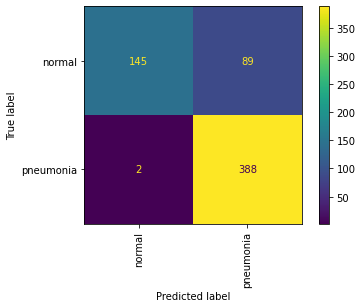

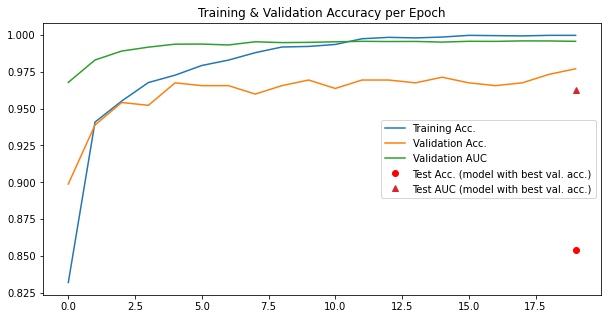

In [114]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [115]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "PneumoniaMNIST",
  "description": "The PneumoniaMNIST is based on a prior dataset of 5,856 pediatric chest X-Ray images. The task is binary-class classification of pneumonia against normal. We split the source training set with a ratio of 9:1 into training and validation set and use its source validation set as the test set. The source images are gray-scale, and their sizes are (384\u22122,916)\u00d7(127\u22122,713). We center-crop the images and resize them into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/pneumoniamnist.npz?download=1",
  "MD5": "28209eda62fecd6e6a2d98b1501bb15f",
  "task": "binary-class",
  "label": {
    "0": "normal",
    "1": "pneumonia"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 4708,
    "val": 524,
    "test": 624
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           

100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.44it/s]


train -- accuracy: 0.8563
val -- accuracy: 0.937,  AUC: 0.9813
Epoch 1



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.23it/s]


train -- accuracy: 0.9438
val -- accuracy: 0.9294,  AUC: 0.9885
Epoch 2



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 116.47it/s]


train -- accuracy: 0.9581
val -- accuracy: 0.9275,  AUC: 0.9949
Epoch 3



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 116.85it/s]


train -- accuracy: 0.9683
val -- accuracy: 0.9695,  AUC: 0.9953
Epoch 4



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.62it/s]


train -- accuracy: 0.9757
val -- accuracy: 0.9676,  AUC: 0.9958
Epoch 5



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.89it/s]


train -- accuracy: 0.9797
val -- accuracy: 0.9656,  AUC: 0.9966
Epoch 6



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.27it/s]


train -- accuracy: 0.982
val -- accuracy: 0.9695,  AUC: 0.9974
Epoch 7



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.83it/s]


train -- accuracy: 0.9859
val -- accuracy: 0.9771,  AUC: 0.9973
Epoch 8



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.28it/s]


train -- accuracy: 0.9894
val -- accuracy: 0.9809,  AUC: 0.9974
Epoch 9



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.08it/s]


train -- accuracy: 0.994
val -- accuracy: 0.9733,  AUC: 0.9972
Epoch 10



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.10it/s]


train -- accuracy: 0.9963
val -- accuracy: 0.9771,  AUC: 0.9975
Epoch 11



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.41it/s]


train -- accuracy: 0.9967
val -- accuracy: 0.9752,  AUC: 0.997
Epoch 12



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.01it/s]


train -- accuracy: 0.9977
val -- accuracy: 0.9752,  AUC: 0.9977
Epoch 13



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.58it/s]


train -- accuracy: 0.9983
val -- accuracy: 0.9695,  AUC: 0.9966
Epoch 14



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 118.36it/s]


train -- accuracy: 0.9992
val -- accuracy: 0.979,  AUC: 0.9972
Epoch 15



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.50it/s]


train -- accuracy: 0.9996
val -- accuracy: 0.9752,  AUC: 0.9975
Epoch 16



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.20it/s]


train -- accuracy: 0.9994
val -- accuracy: 0.9733,  AUC: 0.9974
Epoch 17



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.27it/s]


train -- accuracy: 1.0
val -- accuracy: 0.9809,  AUC: 0.997
Epoch 18



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.36it/s]


train -- accuracy: 0.9994
val -- accuracy: 0.9771,  AUC: 0.9971
Epoch 19



100%|██████████████████████████████████████████| 81/81 [00:00<00:00, 117.55it/s]


train -- accuracy: 0.9998
val -- accuracy: 0.9809,  AUC: 0.9973
test -- accuracy: 0.8702,  AUC: 0.9587


<Figure size 720x720 with 0 Axes>

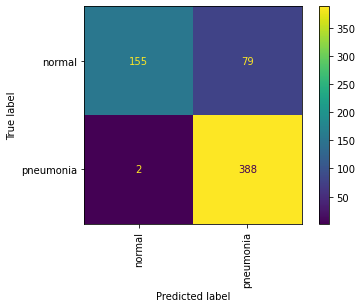

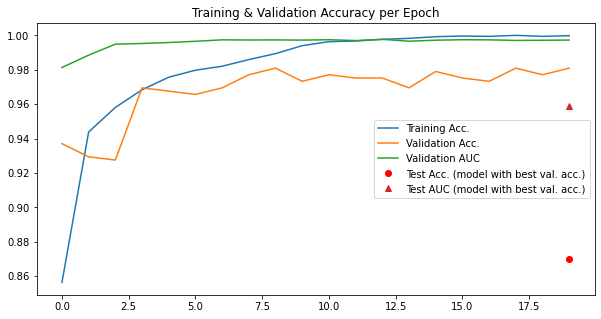

In [116]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### BreastMNIST

#### Training the Conditional GAN

In [117]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "breastmnist"
base_dataset = breastmnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 0.5477361679077148 , Gen Loss: 0.8372247157952725 Disc Loss: 0.6100453247517457
Epoch 2 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 0.4689607620239258 , Gen Loss: 1.4486571371336996 Disc Loss: 0.3493014884082389
Epoch 3 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 0.4674665927886963 , Gen Loss: 1.791258759550996 Disc Loss: 0.2737176636636475
Epoch 4 of 100
New Generator model saved at traine

New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 0.47687697410583496 , Gen Loss: 1.1874738420758928 Disc Loss: 0.5214582729688931
Epoch 28 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 0.4692370891571045 , Gen Loss: 1.2142638042296245 Disc Loss: 0.5316647260616987
Epoch 29 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 0.4671924114227295 , Gen Loss: 1.0902864225618132 Disc Loss: 0.5642908676203354
Epoch 30 of 100
New Generator model saved at trained

New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 0.4659717082977295 , Gen Loss: 1.1196522695240958 Disc Loss: 0.5663938976469494
Epoch 54 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 0.4671189785003662 , Gen Loss: 1.0380853785699977 Disc Loss: 0.5846231202066163
Epoch 55 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 0.4670140743255615 , Gen Loss: 1.081822769109146 Disc Loss: 0.5653124239855197
Epoch 56 of 100


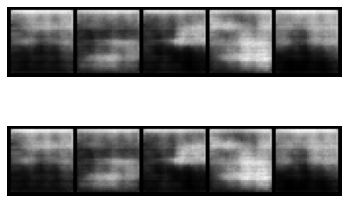

New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 0.5655171871185303 , Gen Loss: 1.0274158519702954 Disc Loss: 0.5865500313895089
Epoch 57 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 0.4666750431060791 , Gen Loss: 1.1955037658467835 Disc Loss: 0.5028135418455243
Epoch 58 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_58.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_58.pth
Epoch: 58, Duration: 0.4672706127166748 , Gen Loss: 1.1033766750014309 Disc Loss: 0.5343203701815762
Epoch 59 of 100
New Generator model saved at trained_

New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 0.46666455268859863 , Gen Loss: 0.963121351304945 Disc Loss: 0.6635985322050996
Epoch 83 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 0.46887898445129395 , Gen Loss: 1.025499504564446 Disc Loss: 0.5941939581008184
Epoch 84 of 100
New Generator model saved at trained_models/conditionalGAN/breastmnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/breastmnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 0.466280460357666 , Gen Loss: 1.1134757576407968 Disc Loss: 0.5146244035099016
Epoch 85 of 100
New Generator model saved at trained_m

In [118]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [119]:
# Removes saved intermediary models
model_path = f"models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 54 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 119.55it/s]


train -- accuracy: 0.7383
val -- accuracy: 0.7308,  AUC: 0.6124
Epoch 1



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 120.30it/s]


train -- accuracy: 0.7383
val -- accuracy: 0.7308,  AUC: 0.6207
Epoch 2



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.26it/s]


train -- accuracy: 0.7383
val -- accuracy: 0.7308,  AUC: 0.6867
Epoch 3



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 120.91it/s]


train -- accuracy: 0.7383
val -- accuracy: 0.7308,  AUC: 0.7068
Epoch 4



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.81it/s]


train -- accuracy: 0.7383
val -- accuracy: 0.7308,  AUC: 0.7327
Epoch 5



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.45it/s]


train -- accuracy: 0.7383
val -- accuracy: 0.7308,  AUC: 0.7377
Epoch 6



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.20it/s]


train -- accuracy: 0.7383
val -- accuracy: 0.7308,  AUC: 0.7552
Epoch 7



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.59it/s]


train -- accuracy: 0.7383
val -- accuracy: 0.7308,  AUC: 0.7703
Epoch 8



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.12it/s]


train -- accuracy: 0.7383
val -- accuracy: 0.7308,  AUC: 0.7861
Epoch 9



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.62it/s]


train -- accuracy: 0.74
val -- accuracy: 0.7308,  AUC: 0.7978
Epoch 10



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.26it/s]


train -- accuracy: 0.7467
val -- accuracy: 0.7436,  AUC: 0.8104
Epoch 11



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 119.65it/s]


train -- accuracy: 0.77
val -- accuracy: 0.7949,  AUC: 0.8204
Epoch 12



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.26it/s]


train -- accuracy: 0.78
val -- accuracy: 0.7692,  AUC: 0.8204
Epoch 13



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.62it/s]


train -- accuracy: 0.7883
val -- accuracy: 0.8077,  AUC: 0.8388
Epoch 14



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.15it/s]


train -- accuracy: 0.82
val -- accuracy: 0.859,  AUC: 0.8471
Epoch 15



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.56it/s]


train -- accuracy: 0.835
val -- accuracy: 0.8333,  AUC: 0.8471
Epoch 16



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.63it/s]


train -- accuracy: 0.84
val -- accuracy: 0.859,  AUC: 0.8538
Epoch 17



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.62it/s]


train -- accuracy: 0.87
val -- accuracy: 0.8462,  AUC: 0.8563
Epoch 18



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 120.41it/s]


train -- accuracy: 0.8817
val -- accuracy: 0.8718,  AUC: 0.8789
Epoch 19



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.75it/s]


train -- accuracy: 0.9
val -- accuracy: 0.8718,  AUC: 0.878
test -- accuracy: 0.8077,  AUC: 0.8331


<Figure size 720x720 with 0 Axes>

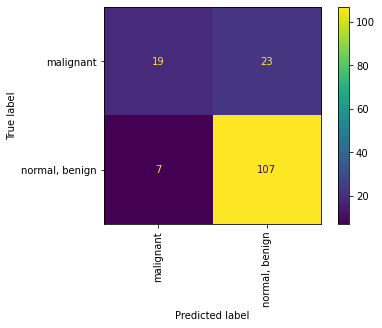

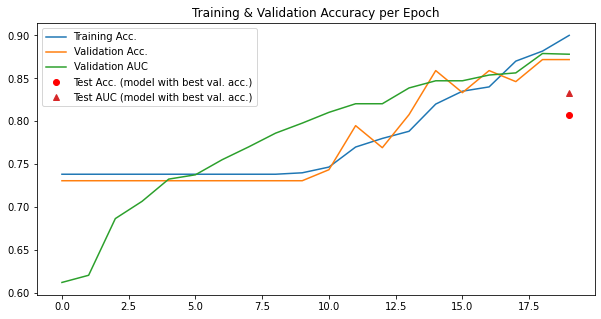

In [120]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [121]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "BreastMNIST",
  "description": "The BreastMNIST is based on a dataset of 780 breast ultrasound images. It is categorized into 3 classes: normal, benign, and malignant. As we use low-resolution images, we simplify the task into binary classification by combining normal and benign as positive and classifying them against malignant as negative. We split the source dataset with a ratio of 7:1:2 into training, validation and test set. The source images of 1\u00d7500\u00d7500 are resized into 1\u00d728\u00d728.",
  "url": "https://zenodo.org/record/5208230/files/breastmnist.npz?download=1",
  "MD5": "750601b1f35ba3300ea97c75c52ff8f6",
  "task": "binary-class",
  "label": {
    "0": "malignant",
    "1": "normal, benign"
  },
  "n_channels": 1,
  "n_samples": {
    "train": 546,
    "val": 78,
    "test": 156
  },
  "license": "CC BY 4.0"
}
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
    

100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.08it/s]


train -- accuracy: 0.535
val -- accuracy: 0.2692,  AUC: 0.5965
Epoch 1



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.22it/s]


train -- accuracy: 0.6433
val -- accuracy: 0.2692,  AUC: 0.6299
Epoch 2



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 123.05it/s]


train -- accuracy: 0.72
val -- accuracy: 0.4872,  AUC: 0.6742
Epoch 3



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.30it/s]


train -- accuracy: 0.6967
val -- accuracy: 0.6795,  AUC: 0.7243
Epoch 4



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.75it/s]


train -- accuracy: 0.7717
val -- accuracy: 0.7436,  AUC: 0.7527
Epoch 5



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 119.67it/s]


train -- accuracy: 0.755
val -- accuracy: 0.7436,  AUC: 0.7669
Epoch 6



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.47it/s]


train -- accuracy: 0.7583
val -- accuracy: 0.7436,  AUC: 0.7794
Epoch 7



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.17it/s]


train -- accuracy: 0.74
val -- accuracy: 0.7692,  AUC: 0.7987
Epoch 8



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.30it/s]


train -- accuracy: 0.795
val -- accuracy: 0.7821,  AUC: 0.8112
Epoch 9



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.00it/s]


train -- accuracy: 0.8117
val -- accuracy: 0.7821,  AUC: 0.8154
Epoch 10



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.64it/s]


train -- accuracy: 0.82
val -- accuracy: 0.7692,  AUC: 0.8396
Epoch 11



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.52it/s]


train -- accuracy: 0.8333
val -- accuracy: 0.7949,  AUC: 0.848
Epoch 12



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 120.02it/s]


train -- accuracy: 0.8617
val -- accuracy: 0.8205,  AUC: 0.8713
Epoch 13



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.03it/s]


train -- accuracy: 0.8767
val -- accuracy: 0.7949,  AUC: 0.8672
Epoch 14



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.26it/s]


train -- accuracy: 0.905
val -- accuracy: 0.8205,  AUC: 0.8881
Epoch 15



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.25it/s]


train -- accuracy: 0.9267
val -- accuracy: 0.859,  AUC: 0.8972
Epoch 16



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 116.50it/s]


train -- accuracy: 0.9567
val -- accuracy: 0.8462,  AUC: 0.9039
Epoch 17



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.50it/s]


train -- accuracy: 0.9617
val -- accuracy: 0.8462,  AUC: 0.9006
Epoch 18



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 122.35it/s]


train -- accuracy: 0.9567
val -- accuracy: 0.8333,  AUC: 0.9039
Epoch 19



100%|██████████████████████████████████████████| 10/10 [00:00<00:00, 121.93it/s]


train -- accuracy: 0.975
val -- accuracy: 0.8333,  AUC: 0.8972
test -- accuracy: 0.859,  AUC: 0.8933


<Figure size 720x720 with 0 Axes>

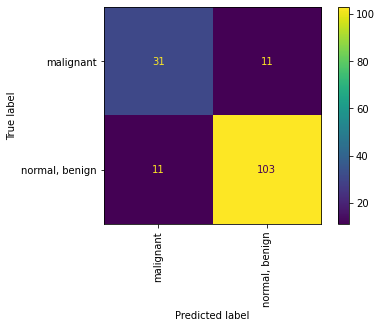

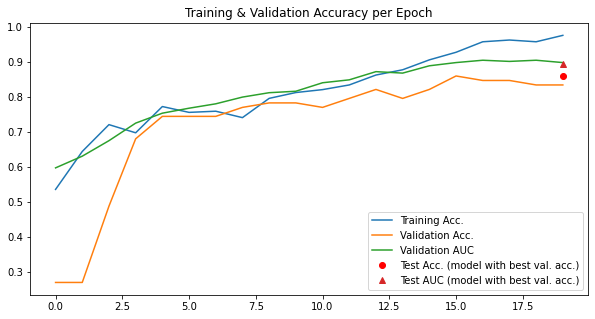

In [122]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### OrganaMNIST

#### Training the Conditional GAN

In [123]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organamnist"
base_dataset = organamnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Epoch 1 of 100


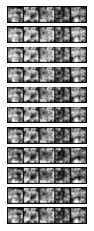

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 29.48041582107544 , Gen Loss: 4.751207310372748 Disc Loss: 0.15834495968252074
Epoch 2 of 100


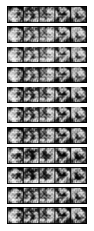

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 29.404077529907227 , Gen Loss: 5.155642278274197 Disc Loss: 0.1254013872095587
Epoch 3 of 100


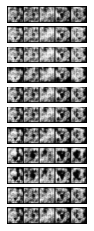

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 29.3925564289093 , Gen Loss: 4.545450355686649 Disc Loss: 0.1601151751277797
Epoch 4 of 100


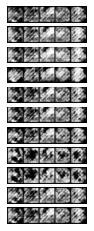

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_4.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_4.pth
Epoch: 4, Duration: 29.429998874664307 , Gen Loss: 3.425375160854226 Disc Loss: 0.187508839075287
Epoch 5 of 100


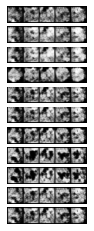

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 29.377843618392944 , Gen Loss: 3.3196939341690523 Disc Loss: 0.17247916350380266
Epoch 6 of 100


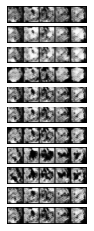

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 29.48828411102295 , Gen Loss: 3.269806758046326 Disc Loss: 0.17450771716224228
Epoch 7 of 100


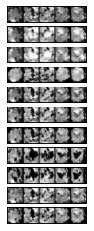

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 29.450940370559692 , Gen Loss: 3.054050408822764 Disc Loss: 0.18617178067887713
Epoch 8 of 100


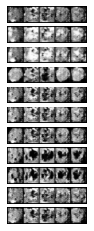

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_8.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_8.pth
Epoch: 8, Duration: 29.49453377723694 , Gen Loss: 2.9163494765911917 Disc Loss: 0.20098295035568664
Epoch 9 of 100


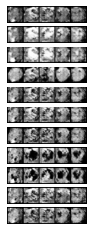

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_9.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_9.pth
Epoch: 9, Duration: 29.365785360336304 , Gen Loss: 2.812178743385096 Disc Loss: 0.20564460241444002
Epoch 10 of 100


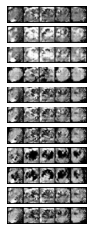

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 29.502875328063965 , Gen Loss: 2.808696204201729 Disc Loss: 0.21144184972871663
Epoch 11 of 100


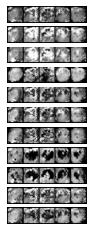

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 29.460068464279175 , Gen Loss: 2.8017925757641478 Disc Loss: 0.21163543394945925
Epoch 12 of 100


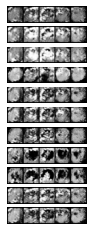

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 29.501283884048462 , Gen Loss: 2.8401585679274746 Disc Loss: 0.2037752791905237
Epoch 13 of 100


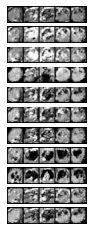

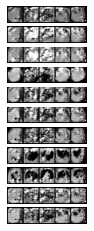

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_13.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_13.pth
Epoch: 13, Duration: 29.865745067596436 , Gen Loss: 2.8664546192273215 Disc Loss: 0.1974025883071629
Epoch 14 of 100


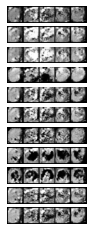

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 29.400259733200073 , Gen Loss: 2.8671662636274253 Disc Loss: 0.20234275595702841
Epoch 15 of 100


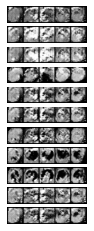

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 29.52586030960083 , Gen Loss: 2.8934270715855526 Disc Loss: 0.19184857088249327
Epoch 16 of 100


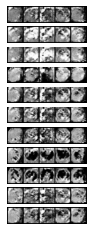

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 29.421902656555176 , Gen Loss: 2.932739211922732 Disc Loss: 0.18907620762665914
Epoch 17 of 100


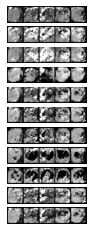

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_17.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_17.pth
Epoch: 17, Duration: 29.488505125045776 , Gen Loss: 2.9716324986987073 Disc Loss: 0.19126849597683698
Epoch 18 of 100


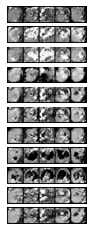

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_18.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_18.pth
Epoch: 18, Duration: 29.406004190444946 , Gen Loss: 3.0241145788149564 Disc Loss: 0.18397419735548423
Epoch 19 of 100


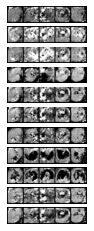

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 29.499675273895264 , Gen Loss: 3.036531982880773 Disc Loss: 0.1830186453092016
Epoch 20 of 100


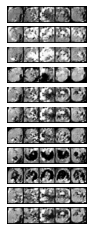

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 29.36820697784424 , Gen Loss: 3.1522202853445536 Disc Loss: 0.1755063208707455
Epoch 21 of 100


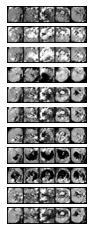

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 29.46874213218689 , Gen Loss: 3.1878334562331916 Disc Loss: 0.17614746446748214
Epoch 22 of 100


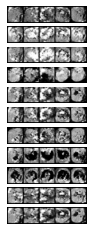

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_22.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_22.pth
Epoch: 22, Duration: 29.401588678359985 , Gen Loss: 3.20691682209884 Disc Loss: 0.17046307774229347
Epoch 23 of 100


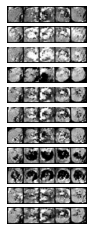

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 29.521812438964844 , Gen Loss: 3.229521359272433 Disc Loss: 0.1682149168347503
Epoch 24 of 100


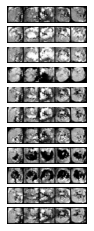

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_24.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_24.pth
Epoch: 24, Duration: 29.411936283111572 , Gen Loss: 3.213926406480437 Disc Loss: 0.1761989598469897
Epoch 25 of 100


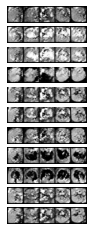

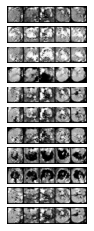

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 29.912997722625732 , Gen Loss: 3.2726391027587405 Disc Loss: 0.1671554562340953
Epoch 26 of 100


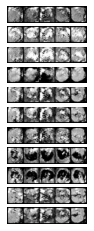

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_26.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_26.pth
Epoch: 26, Duration: 29.515203952789307 , Gen Loss: 3.2752308438882625 Disc Loss: 0.1671401643514502
Epoch 27 of 100


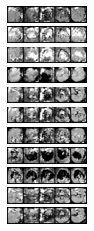

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 29.439239025115967 , Gen Loss: 3.293368513417773 Disc Loss: 0.1614684714420491
Epoch 28 of 100


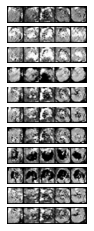

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 29.581783294677734 , Gen Loss: 3.339220326913623 Disc Loss: 0.15790196104345594
Epoch 29 of 100


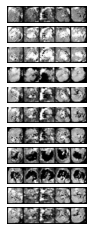

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 29.384790897369385 , Gen Loss: 3.332192894942309 Disc Loss: 0.15929792778187443
Epoch 30 of 100


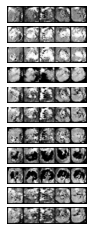

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 29.44516396522522 , Gen Loss: 3.385207917642636 Disc Loss: 0.1543595816027949
Epoch 31 of 100


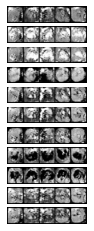

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_31.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_31.pth
Epoch: 31, Duration: 29.407272338867188 , Gen Loss: 3.485805518203638 Disc Loss: 0.15109578835288887
Epoch 32 of 100


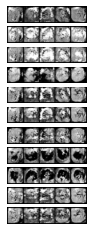

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_32.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_32.pth
Epoch: 32, Duration: 29.554460763931274 , Gen Loss: 3.440431974928429 Disc Loss: 0.14858533565216447
Epoch 33 of 100


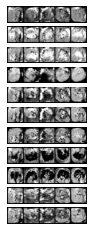

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_33.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_33.pth
Epoch: 33, Duration: 29.432424306869507 , Gen Loss: 3.431949625516902 Disc Loss: 0.1533815223903661
Epoch 34 of 100


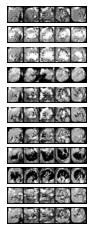

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 29.523823261260986 , Gen Loss: 3.539118076038865 Disc Loss: 0.1464990879655736
Epoch 35 of 100


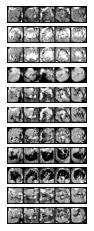

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 29.365471839904785 , Gen Loss: 3.508643429556693 Disc Loss: 0.1516773740909025
Epoch 36 of 100


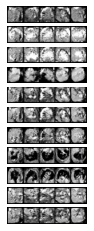

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_36.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_36.pth
Epoch: 36, Duration: 29.536306142807007 , Gen Loss: 3.5232983339839796 Disc Loss: 0.14791884678363842
Epoch 37 of 100


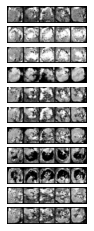

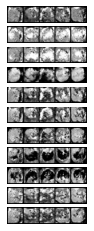

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 29.83354377746582 , Gen Loss: 3.6025009669327086 Disc Loss: 0.14017471547779128
Epoch 38 of 100


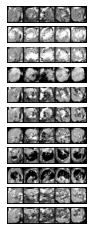

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 29.390130043029785 , Gen Loss: 3.588780914736416 Disc Loss: 0.14576345380682312
Epoch 39 of 100


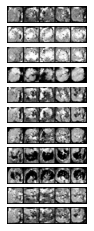

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 29.42323136329651 , Gen Loss: 3.6231919713860212 Disc Loss: 0.1420001398437726
Epoch 40 of 100


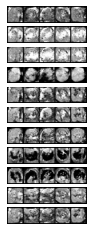

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_40.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_40.pth
Epoch: 40, Duration: 29.495190143585205 , Gen Loss: 3.7303604219079842 Disc Loss: 0.13570790431342356
Epoch 41 of 100


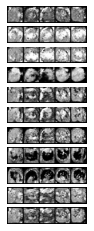

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 29.440075159072876 , Gen Loss: 3.769975293513779 Disc Loss: 0.13569134163720684
Epoch 42 of 100


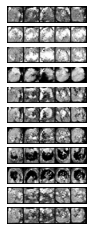

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 29.38776421546936 , Gen Loss: 3.7978107559064225 Disc Loss: 0.13705758592597814
Epoch 43 of 100


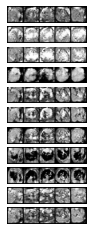

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 29.428499221801758 , Gen Loss: 3.8379479519100084 Disc Loss: 0.1353182084047237
Epoch 44 of 100


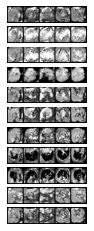

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_44.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_44.pth
Epoch: 44, Duration: 29.433090209960938 , Gen Loss: 3.8300778426014284 Disc Loss: 0.13139723131922154
Epoch 45 of 100


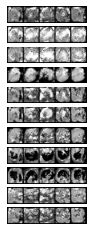

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_45.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_45.pth
Epoch: 45, Duration: 29.462483406066895 , Gen Loss: 3.8986139426274544 Disc Loss: 0.13690410230238426
Epoch 46 of 100


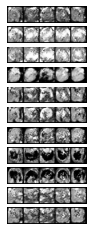

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 29.345763444900513 , Gen Loss: 3.932577228102137 Disc Loss: 0.1299329382464359
Epoch 47 of 100


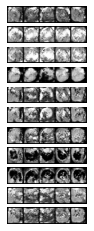

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 29.45250678062439 , Gen Loss: 3.937912075995489 Disc Loss: 0.12793609794757235
Epoch 48 of 100


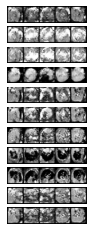

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 29.436687469482422 , Gen Loss: 3.9871818158815535 Disc Loss: 0.13092809669236719
Epoch 49 of 100


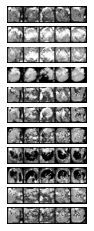

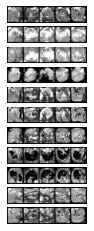

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_49.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_49.pth
Epoch: 49, Duration: 29.87866449356079 , Gen Loss: 4.003938669356005 Disc Loss: 0.1270281300605824
Epoch 50 of 100


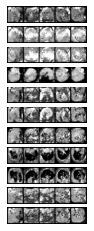

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 29.428110599517822 , Gen Loss: 4.070241787397704 Disc Loss: 0.12790455402713918
Epoch 51 of 100


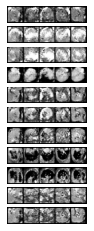

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 29.444222927093506 , Gen Loss: 4.107707266996328 Disc Loss: 0.12130376981760216
Epoch 52 of 100


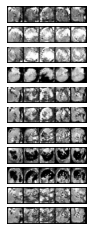

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 29.556987524032593 , Gen Loss: 4.320897855758942 Disc Loss: 0.11447940359906814
Epoch 53 of 100


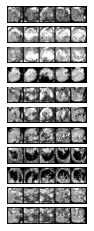

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 29.438594818115234 , Gen Loss: 4.271029430901362 Disc Loss: 0.1290056542971574
Epoch 54 of 100


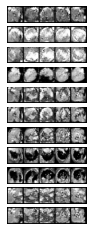

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 29.479759216308594 , Gen Loss: 4.378663952025679 Disc Loss: 0.11354231335939534
Epoch 55 of 100


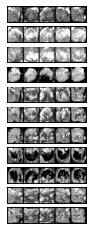

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 29.411755323410034 , Gen Loss: 4.416226576732888 Disc Loss: 0.10925844704959009
Epoch 56 of 100


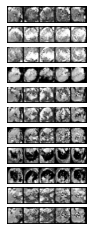

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 29.567551851272583 , Gen Loss: 4.49188589832567 Disc Loss: 0.11527149629221972
Epoch 57 of 100


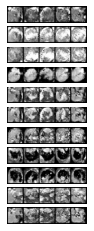

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 29.44141125679016 , Gen Loss: 4.396747852867182 Disc Loss: 0.10912298751482027
Epoch 58 of 100


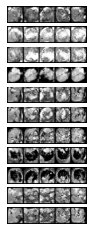

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_58.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_58.pth
Epoch: 58, Duration: 29.500465631484985 , Gen Loss: 4.650017350568231 Disc Loss: 0.10634089562819901
Epoch 59 of 100


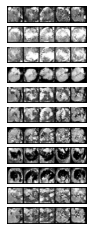

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_59.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_59.pth
Epoch: 59, Duration: 29.36465287208557 , Gen Loss: 4.725910272259333 Disc Loss: 0.10282648776604204
Epoch 60 of 100


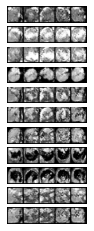

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 29.553511381149292 , Gen Loss: 4.616596270350771 Disc Loss: 0.10840622464060828
Epoch 61 of 100


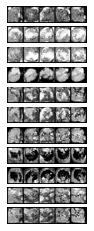

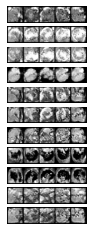

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 29.793633460998535 , Gen Loss: 4.869243135681444 Disc Loss: 0.103455057566384
Epoch 62 of 100


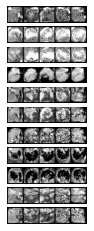

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 29.367607831954956 , Gen Loss: 4.89866635580232 Disc Loss: 0.09438666757937884
Epoch 63 of 100


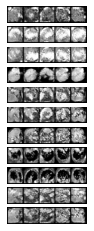

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_63.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_63.pth
Epoch: 63, Duration: 29.50969696044922 , Gen Loss: 5.014402778982678 Disc Loss: 0.09448782274767936
Epoch 64 of 100


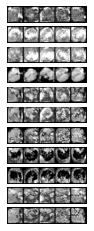

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 29.420994758605957 , Gen Loss: 5.063293427026402 Disc Loss: 0.09156938883075244
Epoch 65 of 100


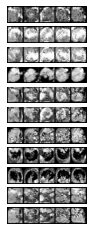

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 29.493709087371826 , Gen Loss: 5.414543933084642 Disc Loss: 0.08755207147259333
Epoch 66 of 100


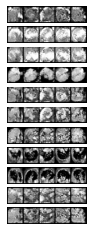

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 29.370417833328247 , Gen Loss: 5.263232519302507 Disc Loss: 0.08775559612305167
Epoch 67 of 100


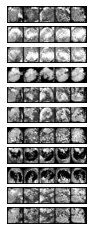

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_67.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_67.pth
Epoch: 67, Duration: 29.511626720428467 , Gen Loss: 5.30455714481941 Disc Loss: 0.09335590573354949
Epoch 68 of 100


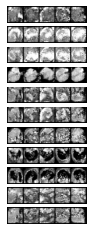

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_68.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_68.pth
Epoch: 68, Duration: 29.45682120323181 , Gen Loss: 5.29945815621295 Disc Loss: 0.08442260110320696
Epoch 69 of 100


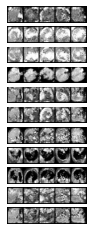

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 29.491600275039673 , Gen Loss: 5.572856572250658 Disc Loss: 0.0778081982225608
Epoch 70 of 100


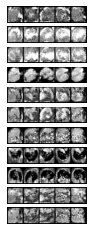

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 29.349513292312622 , Gen Loss: 5.76278429628987 Disc Loss: 0.07988071427861398
Epoch 71 of 100


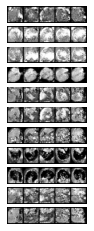

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 29.46216320991516 , Gen Loss: 5.6522191557502675 Disc Loss: 0.08706047909934285
Epoch 72 of 100


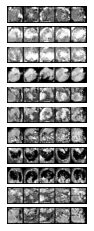

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_72.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_72.pth
Epoch: 72, Duration: 29.452727794647217 , Gen Loss: 6.0488287462768575 Disc Loss: 0.0690726714317472
Epoch 73 of 100


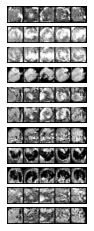

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_73.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_73.pth
Epoch: 73, Duration: 29.447694540023804 , Gen Loss: 6.113981937335531 Disc Loss: 0.06935262019560959
Epoch 74 of 100


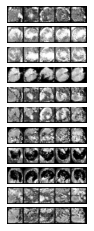

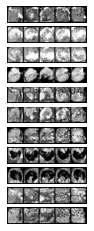

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 29.83280658721924 , Gen Loss: 6.113592001388046 Disc Loss: 0.07276743314157341
Epoch 75 of 100


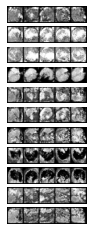

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 29.396788358688354 , Gen Loss: 6.185471700500274 Disc Loss: 0.07238390764166017
Epoch 76 of 100


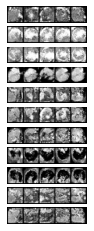

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 29.504996299743652 , Gen Loss: 6.080342619502039 Disc Loss: 0.07479509724451289
Epoch 77 of 100


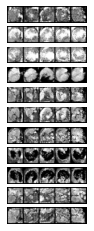

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_77.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_77.pth
Epoch: 77, Duration: 29.434056758880615 , Gen Loss: 6.337802008328273 Disc Loss: 0.06548190299586479
Epoch 78 of 100


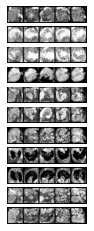

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_78.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_78.pth
Epoch: 78, Duration: 29.46476697921753 , Gen Loss: 6.405221617362136 Disc Loss: 0.06643121403371793
Epoch 79 of 100


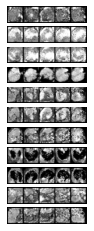

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 29.34042978286743 , Gen Loss: 6.612715436222203 Disc Loss: 0.06040109379744296
Epoch 80 of 100


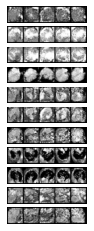

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 29.582266807556152 , Gen Loss: 6.723314012752668 Disc Loss: 0.06168722161148824
Epoch 81 of 100


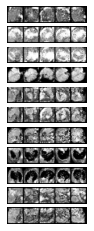

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_81.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_81.pth
Epoch: 81, Duration: 29.399072885513306 , Gen Loss: 6.712331193429918 Disc Loss: 0.062145851011483906
Epoch 82 of 100


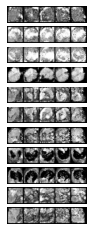

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 29.52505922317505 , Gen Loss: 6.5011024840230185 Disc Loss: 0.08312809311155331
Epoch 83 of 100


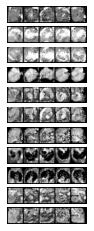

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 29.421577215194702 , Gen Loss: 6.85534641493884 Disc Loss: 0.051060404517880124
Epoch 84 of 100


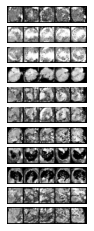

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 29.45142412185669 , Gen Loss: 7.187035510829646 Disc Loss: 0.05461243492972116
Epoch 85 of 100


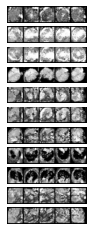

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_85.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_85.pth
Epoch: 85, Duration: 29.453432083129883 , Gen Loss: 7.033786616928371 Disc Loss: 0.052439928599474786
Epoch 86 of 100


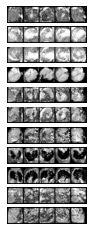

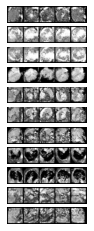

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_86.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_86.pth
Epoch: 86, Duration: 29.920593976974487 , Gen Loss: 7.218292288395362 Disc Loss: 0.04993802904548379
Epoch 87 of 100


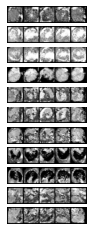

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_87.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_87.pth
Epoch: 87, Duration: 29.481850385665894 , Gen Loss: 7.418131524536595 Disc Loss: 0.05406641023181986
Epoch 88 of 100


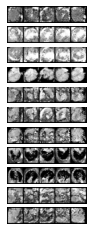

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 29.361337423324585 , Gen Loss: 7.798372842023077 Disc Loss: 0.04453336869528245
Epoch 89 of 100


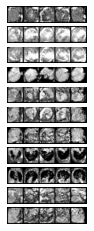

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 29.5358989238739 , Gen Loss: 6.934193451606373 Disc Loss: 0.0803909873173672
Epoch 90 of 100


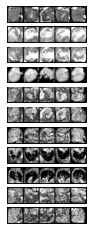

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 29.33428144454956 , Gen Loss: 7.6869993638124985 Disc Loss: 0.04495850915468393
Epoch 91 of 100


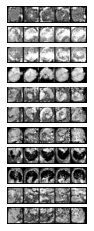

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 29.43561887741089 , Gen Loss: 7.954772852144241 Disc Loss: 0.04406724514319641
Epoch 92 of 100


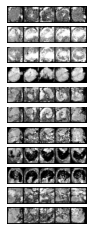

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 29.587064504623413 , Gen Loss: 8.169817782886556 Disc Loss: 0.04325626704557777
Epoch 93 of 100


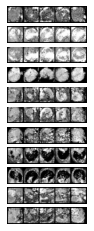

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 31.316083669662476 , Gen Loss: 8.266465869986408 Disc Loss: 0.052700826049709375
Epoch 94 of 100


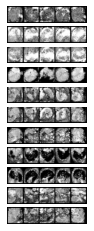

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_94.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_94.pth
Epoch: 94, Duration: 30.550700664520264 , Gen Loss: 8.301319727596079 Disc Loss: 0.03812095845284441
Epoch 95 of 100


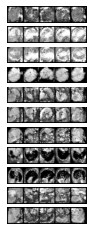

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 29.660051345825195 , Gen Loss: 8.798549962407103 Disc Loss: 0.03936358276695476
Epoch 96 of 100


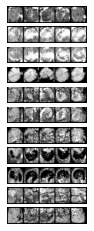

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 29.370258331298828 , Gen Loss: 8.546393792834216 Disc Loss: 0.04393362119914115
Epoch 97 of 100


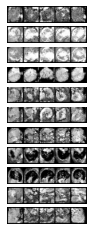

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 29.728611946105957 , Gen Loss: 8.640627259188571 Disc Loss: 0.04089796716517922
Epoch 98 of 100


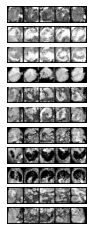

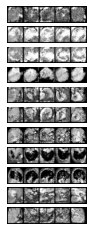

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_98.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_98.pth
Epoch: 98, Duration: 29.871662378311157 , Gen Loss: 8.902744643012058 Disc Loss: 0.04340939414097517
Epoch 99 of 100


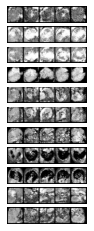

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_99.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_99.pth
Epoch: 99, Duration: 29.42709231376648 , Gen Loss: 9.042636310401665 Disc Loss: 0.03684159055460368
Epoch 100 of 100


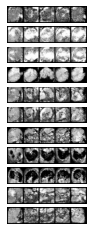

New Generator model saved at trained_models/conditionalGAN/organamnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/organamnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 29.467068433761597 , Gen Loss: 8.965650393279546 Disc Loss: 0.04067121170223533


In [124]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [125]:
# Removes saved intermediary models
model_path = f"models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 5
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 1729 (5% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|████████████████████████████████████████| 568/568 [00:05<00:00, 113.04it/s]


train -- accuracy: 0.5777
val -- accuracy: 0.8617,  AUC: 0.9912
Epoch 1



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.06it/s]


train -- accuracy: 0.8574
val -- accuracy: 0.9442,  AUC: 0.9977
Epoch 2



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.87it/s]


train -- accuracy: 0.9234
val -- accuracy: 0.9479,  AUC: 0.9986
Epoch 3



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.06it/s]


train -- accuracy: 0.9517
val -- accuracy: 0.961,  AUC: 0.999
Epoch 4



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.05it/s]


train -- accuracy: 0.9676
val -- accuracy: 0.9636,  AUC: 0.9994
Epoch 5



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.68it/s]


train -- accuracy: 0.9762
val -- accuracy: 0.9561,  AUC: 0.999
Epoch 6



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.23it/s]


train -- accuracy: 0.9817
val -- accuracy: 0.9675,  AUC: 0.9994
Epoch 7



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.08it/s]


train -- accuracy: 0.9876
val -- accuracy: 0.9658,  AUC: 0.9993
Epoch 8



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.15it/s]


train -- accuracy: 0.9893
val -- accuracy: 0.9672,  AUC: 0.9995
Epoch 9



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.06it/s]


train -- accuracy: 0.9913
val -- accuracy: 0.9652,  AUC: 0.9993
Epoch 10



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.84it/s]


train -- accuracy: 0.9941
val -- accuracy: 0.966,  AUC: 0.9993
Epoch 11



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.34it/s]


train -- accuracy: 0.9947
val -- accuracy: 0.9673,  AUC: 0.9994
Epoch 12



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.26it/s]


train -- accuracy: 0.9957
val -- accuracy: 0.9658,  AUC: 0.9994
Epoch 13



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.19it/s]


train -- accuracy: 0.9968
val -- accuracy: 0.9678,  AUC: 0.9994
Epoch 14



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.01it/s]


train -- accuracy: 0.9974
val -- accuracy: 0.9581,  AUC: 0.9992
Epoch 15



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 115.57it/s]


train -- accuracy: 0.9985
val -- accuracy: 0.9684,  AUC: 0.9995
Epoch 16



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.17it/s]


train -- accuracy: 0.9981
val -- accuracy: 0.9707,  AUC: 0.9996
Epoch 17



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.38it/s]


train -- accuracy: 0.9986
val -- accuracy: 0.9675,  AUC: 0.9995
Epoch 18



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.24it/s]


train -- accuracy: 0.9989
val -- accuracy: 0.9647,  AUC: 0.9994
Epoch 19



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.10it/s]


train -- accuracy: 0.9988
val -- accuracy: 0.9675,  AUC: 0.9995
test -- accuracy: 0.8854,  AUC: 0.9907


<Figure size 720x720 with 0 Axes>

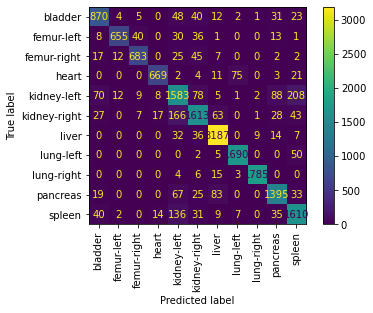

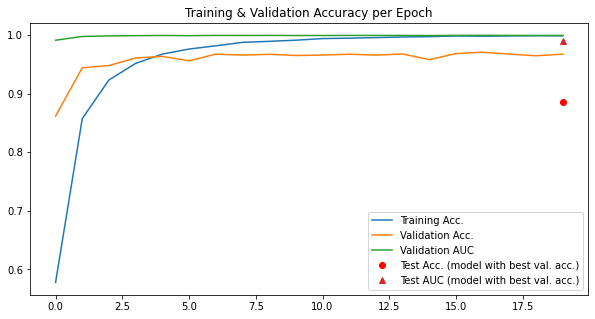

In [126]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [127]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganAMNIST",
  "description": "The OrganAMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Axial (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in axial views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organamnist.npz?download=1",
  "MD5": "866b832ed4eeba67bfb9edee1d5544e6",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-left",

100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.00it/s]


train -- accuracy: 0.5949
val -- accuracy: 0.8848,  AUC: 0.9935
Epoch 1



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.10it/s]


train -- accuracy: 0.8784
val -- accuracy: 0.9433,  AUC: 0.9982
Epoch 2



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.50it/s]


train -- accuracy: 0.9312
val -- accuracy: 0.9473,  AUC: 0.9987
Epoch 3



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.41it/s]


train -- accuracy: 0.9557
val -- accuracy: 0.951,  AUC: 0.9986
Epoch 4



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.30it/s]


train -- accuracy: 0.9687
val -- accuracy: 0.9581,  AUC: 0.9989
Epoch 5



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 117.04it/s]


train -- accuracy: 0.9763
val -- accuracy: 0.9547,  AUC: 0.9992
Epoch 6



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.69it/s]


train -- accuracy: 0.9833
val -- accuracy: 0.9606,  AUC: 0.9992
Epoch 7



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.65it/s]


train -- accuracy: 0.9865
val -- accuracy: 0.9641,  AUC: 0.9992
Epoch 8



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.58it/s]


train -- accuracy: 0.989
val -- accuracy: 0.9633,  AUC: 0.9993
Epoch 9



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.18it/s]


train -- accuracy: 0.9922
val -- accuracy: 0.9653,  AUC: 0.9993
Epoch 10



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.48it/s]


train -- accuracy: 0.9939
val -- accuracy: 0.9595,  AUC: 0.9991
Epoch 11



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.34it/s]


train -- accuracy: 0.9947
val -- accuracy: 0.9629,  AUC: 0.9991
Epoch 12



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.47it/s]


train -- accuracy: 0.9964
val -- accuracy: 0.9619,  AUC: 0.999
Epoch 13



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.21it/s]


train -- accuracy: 0.9958
val -- accuracy: 0.9635,  AUC: 0.9989
Epoch 14



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.36it/s]


train -- accuracy: 0.9966
val -- accuracy: 0.963,  AUC: 0.9992
Epoch 15



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.86it/s]


train -- accuracy: 0.9972
val -- accuracy: 0.9669,  AUC: 0.9993
Epoch 16



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.49it/s]


train -- accuracy: 0.9976
val -- accuracy: 0.9663,  AUC: 0.9992
Epoch 17



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.91it/s]


train -- accuracy: 0.9976
val -- accuracy: 0.9652,  AUC: 0.9993
Epoch 18



100%|████████████████████████████████████████| 568/568 [00:04<00:00, 116.57it/s]


train -- accuracy: 0.9985
val -- accuracy: 0.9687,  AUC: 0.9993
Epoch 19



100%|████████████████████████████████████████| 568/568 [00:05<00:00, 113.28it/s]


train -- accuracy: 0.9986
val -- accuracy: 0.9678,  AUC: 0.9993
test -- accuracy: 0.882,  AUC: 0.9908


<Figure size 720x720 with 0 Axes>

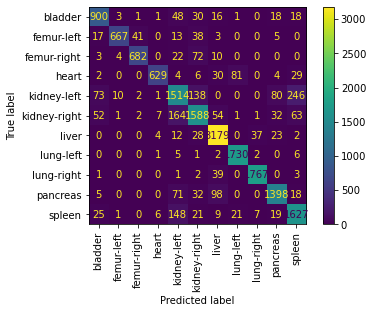

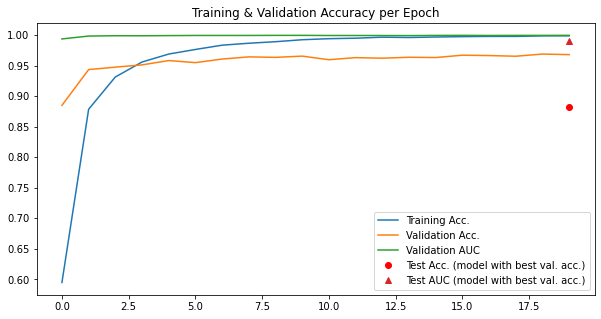

In [128]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### OrgancMNIST

#### Training the Conditional GAN

In [129]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organcmnist"
base_dataset = organcmnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 11.06109881401062 , Gen Loss: 4.039930588942307 Disc Loss: 0.1689247295673077
Epoch 2 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 10.931875467300415 , Gen Loss: 6.102584735576923 Disc Loss: 0.09284654822716346
Epoch 3 of 100


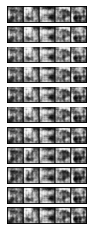

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 11.269893646240234 , Gen Loss: 5.598618389423077 Disc Loss: 0.13241748046875
Epoch 4 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_4.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_4.pth
Epoch: 4, Duration: 10.891563653945923 , Gen Loss: 5.275668269230769 Disc Loss: 0.12329240534855769
Epoch 5 of 100


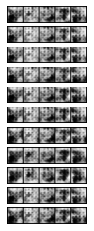

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 11.388441562652588 , Gen Loss: 5.385001201923077 Disc Loss: 0.10489884127103366
Epoch 6 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 10.980365514755249 , Gen Loss: 5.269155649038462 Disc Loss: 0.11445465557391826
Epoch 7 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 10.964993000030518 , Gen Loss: 5.021309194711538 Disc Loss: 0.12091005295973557
Epoch 8 of 100


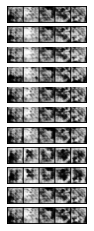

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_8.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_8.pth
Epoch: 8, Duration: 11.318502426147461 , Gen Loss: 4.2387334735576925 Disc Loss: 0.15070581993689905
Epoch 9 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_9.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_9.pth
Epoch: 9, Duration: 10.912723064422607 , Gen Loss: 3.638877704326923 Disc Loss: 0.17062006084735576
Epoch 10 of 100


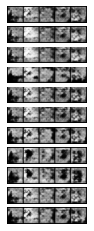

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 11.375434875488281 , Gen Loss: 3.604838341346154 Disc Loss: 0.16124778395432693
Epoch 11 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 10.98458743095398 , Gen Loss: 3.304845252403846 Disc Loss: 0.18291502028245193
Epoch 12 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 10.91883111000061 , Gen Loss: 3.3483551682692307 Disc Loss: 0.16499539888822115
Epoch 13 of 100


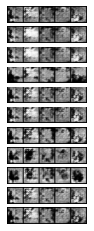

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_13.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_13.pth
Epoch: 13, Duration: 11.291505813598633 , Gen Loss: 3.2562833533653848 Disc Loss: 0.17408856670673076
Epoch 14 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 10.902729988098145 , Gen Loss: 3.187629206730769 Disc Loss: 0.17997263746995193
Epoch 15 of 100


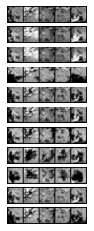

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 11.398130416870117 , Gen Loss: 3.151216045673077 Disc Loss: 0.1655240196814904
Epoch 16 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 10.94785213470459 , Gen Loss: 3.117213341346154 Disc Loss: 0.17581854717548076
Epoch 17 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_17.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_17.pth
Epoch: 17, Duration: 10.924671411514282 , Gen Loss: 3.076068209134615 Disc Loss: 0.17461089618389422
Epoch 18 of 100


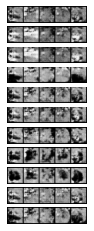

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_18.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_18.pth
Epoch: 18, Duration: 11.317760705947876 , Gen Loss: 3.0121385216346153 Disc Loss: 0.18393096454326924
Epoch 19 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 10.926929235458374 , Gen Loss: 2.8954209735576923 Disc Loss: 0.19859784405048078
Epoch 20 of 100


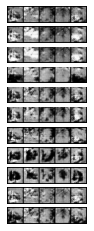

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 11.395598888397217 , Gen Loss: 2.82369921875 Disc Loss: 0.20172487229567307
Epoch 21 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 10.984820365905762 , Gen Loss: 2.8200892427884616 Disc Loss: 0.18869016676682693
Epoch 22 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_22.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_22.pth
Epoch: 22, Duration: 10.981606245040894 , Gen Loss: 2.8203446514423076 Disc Loss: 0.2028541541466346
Epoch 23 of 100


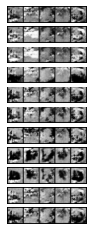

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 11.282370328903198 , Gen Loss: 2.8040306490384617 Disc Loss: 0.19396612079326922
Epoch 24 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_24.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_24.pth
Epoch: 24, Duration: 10.921587467193604 , Gen Loss: 2.77923046875 Disc Loss: 0.21010052959735576
Epoch 25 of 100


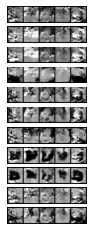

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 11.411919116973877 , Gen Loss: 2.761235576923077 Disc Loss: 0.20440701998197117
Epoch 26 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_26.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_26.pth
Epoch: 26, Duration: 10.94765043258667 , Gen Loss: 2.787463942307692 Disc Loss: 0.20153517503004809
Epoch 27 of 100


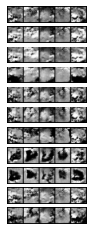

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 11.301981687545776 , Gen Loss: 2.7284789663461537 Disc Loss: 0.21418447641225963
Epoch 28 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 10.937843084335327 , Gen Loss: 2.6816388221153846 Disc Loss: 0.2077431640625
Epoch 29 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 10.930304050445557 , Gen Loss: 2.6998569711538463 Disc Loss: 0.20395986703725963
Epoch 30 of 100


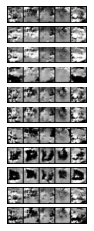

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 11.411749601364136 , Gen Loss: 2.6324158653846155 Disc Loss: 0.2185569035456731
Epoch 31 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_31.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_31.pth
Epoch: 31, Duration: 10.945988655090332 , Gen Loss: 2.7530075120192308 Disc Loss: 0.19736005108173077
Epoch 32 of 100


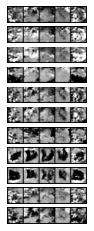

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_32.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_32.pth
Epoch: 32, Duration: 11.388059377670288 , Gen Loss: 2.761882512019231 Disc Loss: 0.19640555513822117
Epoch 33 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_33.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_33.pth
Epoch: 33, Duration: 10.925223588943481 , Gen Loss: 2.726295673076923 Disc Loss: 0.20514789287860577
Epoch 34 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 10.913771867752075 , Gen Loss: 2.82241015625 Disc Loss: 0.2007776817908654
Epoch 35 of 100


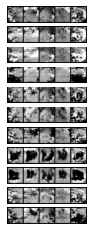

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 11.38610315322876 , Gen Loss: 2.806580528846154 Disc Loss: 0.2039661395733173
Epoch 36 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_36.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_36.pth
Epoch: 36, Duration: 10.925046443939209 , Gen Loss: 2.845522235576923 Disc Loss: 0.19557078200120193
Epoch 37 of 100


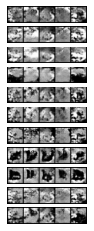

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 11.316225290298462 , Gen Loss: 2.8946814903846154 Disc Loss: 0.19845472130408653
Epoch 38 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 10.913328170776367 , Gen Loss: 2.8970967548076922 Disc Loss: 0.19893115234375
Epoch 39 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 10.92940878868103 , Gen Loss: 2.7459969951923076 Disc Loss: 0.224340087890625
Epoch 40 of 100


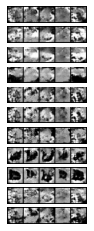

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_40.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_40.pth
Epoch: 40, Duration: 11.403355121612549 , Gen Loss: 2.9486138822115384 Disc Loss: 0.20002073317307692
Epoch 41 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 10.922036409378052 , Gen Loss: 2.944874699519231 Disc Loss: 0.19633143028846153
Epoch 42 of 100


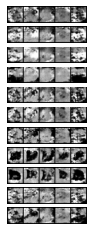

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 11.326765298843384 , Gen Loss: 2.98472265625 Disc Loss: 0.1822802734375
Epoch 43 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 10.994362831115723 , Gen Loss: 3.0499197716346154 Disc Loss: 0.1844003155048077
Epoch 44 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_44.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_44.pth
Epoch: 44, Duration: 10.947995662689209 , Gen Loss: 2.9871171875 Disc Loss: 0.193557373046875
Epoch 45 of 100


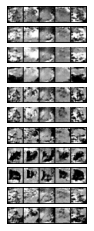

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_45.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_45.pth
Epoch: 45, Duration: 11.412688970565796 , Gen Loss: 3.072341045673077 Disc Loss: 0.18430500676081732
Epoch 46 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 10.969345808029175 , Gen Loss: 3.0634338942307693 Disc Loss: 0.18541239107572116
Epoch 47 of 100


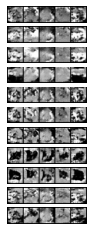

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 11.335392236709595 , Gen Loss: 3.126700420673077 Disc Loss: 0.17711461463341346
Epoch 48 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 10.956279277801514 , Gen Loss: 3.073147536057692 Disc Loss: 0.19088531024639424
Epoch 49 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_49.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_49.pth
Epoch: 49, Duration: 10.957674026489258 , Gen Loss: 3.180924579326923 Disc Loss: 0.17337513146033653
Epoch 50 of 100


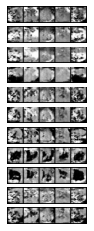

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 11.405872106552124 , Gen Loss: 3.2636989182692306 Disc Loss: 0.168683837890625
Epoch 51 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 10.949290752410889 , Gen Loss: 3.2775141225961537 Disc Loss: 0.16976094876802886
Epoch 52 of 100


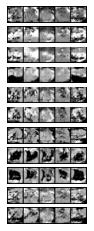

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 11.338354587554932 , Gen Loss: 3.3851075721153845 Disc Loss: 0.16744732196514422
Epoch 53 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 10.950636625289917 , Gen Loss: 3.253225661057692 Disc Loss: 0.17509160907451923
Epoch 54 of 100


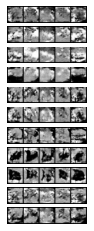

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 11.48315715789795 , Gen Loss: 3.3402908653846155 Disc Loss: 0.16677294921875
Epoch 55 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 10.930916786193848 , Gen Loss: 3.4104498197115385 Disc Loss: 0.1607626953125
Epoch 56 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 10.945567846298218 , Gen Loss: 3.483311298076923 Disc Loss: 0.15680894118088942
Epoch 57 of 100


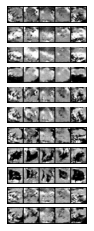

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 11.32240104675293 , Gen Loss: 3.454466947115385 Disc Loss: 0.1537935321514423
Epoch 58 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_58.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_58.pth
Epoch: 58, Duration: 10.936375856399536 , Gen Loss: 3.4017451923076925 Disc Loss: 0.17498726712740384
Epoch 59 of 100


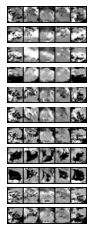

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_59.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_59.pth
Epoch: 59, Duration: 11.401649951934814 , Gen Loss: 3.446698918269231 Disc Loss: 0.15832440655048077
Epoch 60 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 10.961403846740723 , Gen Loss: 3.5331280048076925 Disc Loss: 0.17576806640625
Epoch 61 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 10.94952130317688 , Gen Loss: 3.4961156850961537 Disc Loss: 0.15707982459435096
Epoch 62 of 100


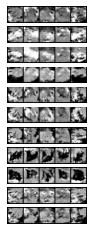

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 11.305765390396118 , Gen Loss: 3.2904212740384615 Disc Loss: 0.18360402268629808
Epoch 63 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_63.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_63.pth
Epoch: 63, Duration: 10.935982942581177 , Gen Loss: 3.530396935096154 Disc Loss: 0.161709716796875
Epoch 64 of 100


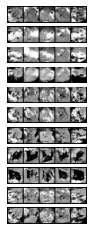

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 11.444222450256348 , Gen Loss: 3.690953425480769 Disc Loss: 0.1524825908954327
Epoch 65 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 10.970081806182861 , Gen Loss: 3.7344720552884616 Disc Loss: 0.1417786395733173
Epoch 66 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 10.919822454452515 , Gen Loss: 3.6026487379807692 Disc Loss: 0.15414537635216347
Epoch 67 of 100


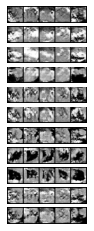

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_67.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_67.pth
Epoch: 67, Duration: 11.280156373977661 , Gen Loss: 3.7171778846153845 Disc Loss: 0.15361353478064904
Epoch 68 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_68.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_68.pth
Epoch: 68, Duration: 10.910218715667725 , Gen Loss: 3.740052283653846 Disc Loss: 0.15631014310396635
Epoch 69 of 100


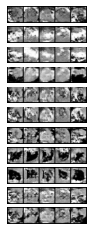

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 11.411350011825562 , Gen Loss: 3.7848359375 Disc Loss: 0.14757477276141828
Epoch 70 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 10.961636066436768 , Gen Loss: 3.700401141826923 Disc Loss: 0.15616251314603366
Epoch 71 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 10.94033408164978 , Gen Loss: 3.5928404447115385 Disc Loss: 0.17282957106370192
Epoch 72 of 100


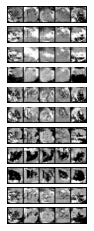

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_72.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_72.pth
Epoch: 72, Duration: 11.310242176055908 , Gen Loss: 3.7041986177884616 Disc Loss: 0.15506752366286058
Epoch 73 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_73.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_73.pth
Epoch: 73, Duration: 10.918167114257812 , Gen Loss: 3.6378602764423076 Disc Loss: 0.15360826697716345
Epoch 74 of 100


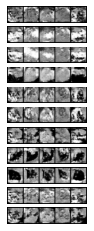

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 11.394530057907104 , Gen Loss: 3.7830868389423076 Disc Loss: 0.1431217041015625
Epoch 75 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 10.985829591751099 , Gen Loss: 3.7745492788461537 Disc Loss: 0.1439984412560096
Epoch 76 of 100


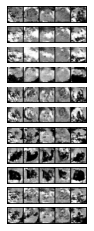

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 11.349245071411133 , Gen Loss: 3.9319903846153847 Disc Loss: 0.1405749042217548
Epoch 77 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_77.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_77.pth
Epoch: 77, Duration: 10.955052614212036 , Gen Loss: 3.9520075120192306 Disc Loss: 0.1375143761268029
Epoch 78 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_78.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_78.pth
Epoch: 78, Duration: 10.921146631240845 , Gen Loss: 3.8324888822115386 Disc Loss: 0.14444615760216345
Epoch 79 of 100


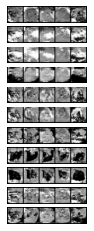

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 11.400132894515991 , Gen Loss: 3.7451015625 Disc Loss: 0.1743023399939904
Epoch 80 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 10.929274559020996 , Gen Loss: 3.750561598557692 Disc Loss: 0.14761375075120192
Epoch 81 of 100


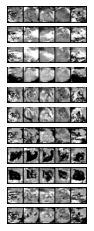

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_81.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_81.pth
Epoch: 81, Duration: 11.338624715805054 , Gen Loss: 3.8824681490384614 Disc Loss: 0.14210273625300482
Epoch 82 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 10.93645453453064 , Gen Loss: 4.058194110576923 Disc Loss: 0.13797943584735578
Epoch 83 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 10.949817895889282 , Gen Loss: 3.898585637019231 Disc Loss: 0.14192989408052883
Epoch 84 of 100


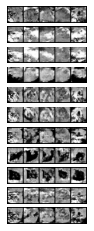

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 11.417080640792847 , Gen Loss: 3.8978416466346153 Disc Loss: 0.1420364990234375
Epoch 85 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_85.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_85.pth
Epoch: 85, Duration: 10.926458835601807 , Gen Loss: 3.804292067307692 Disc Loss: 0.15218892728365385
Epoch 86 of 100


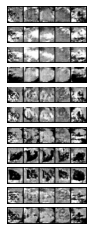

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_86.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_86.pth
Epoch: 86, Duration: 11.366237163543701 , Gen Loss: 3.9344630408653845 Disc Loss: 0.14690847543569713
Epoch 87 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_87.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_87.pth
Epoch: 87, Duration: 10.91262674331665 , Gen Loss: 3.8278416466346155 Disc Loss: 0.14716051307091346
Epoch 88 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 10.90721607208252 , Gen Loss: 4.004443509615385 Disc Loss: 0.13596274977463943
Epoch 89 of 100


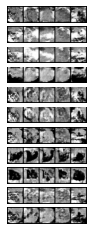

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 11.383280754089355 , Gen Loss: 3.894521033653846 Disc Loss: 0.14512860576923076
Epoch 90 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 10.92076826095581 , Gen Loss: 3.8967028245192306 Disc Loss: 0.13911607947716345
Epoch 91 of 100


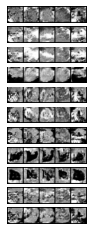

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 11.289751291275024 , Gen Loss: 3.957637620192308 Disc Loss: 0.12578819861778845
Epoch 92 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 10.904043674468994 , Gen Loss: 4.112072115384615 Disc Loss: 0.13470001690204328
Epoch 93 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 10.902070999145508 , Gen Loss: 3.9562836538461537 Disc Loss: 0.1524833045372596
Epoch 94 of 100


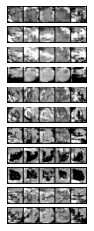

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_94.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_94.pth
Epoch: 94, Duration: 11.379525423049927 , Gen Loss: 3.8915901442307694 Disc Loss: 0.14005511005108173
Epoch 95 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 10.917256593704224 , Gen Loss: 3.9971875 Disc Loss: 0.1384670597956731
Epoch 96 of 100


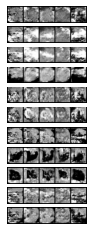

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 11.294114828109741 , Gen Loss: 4.08216376201923 Disc Loss: 0.14214844689002404
Epoch 97 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 11.006203174591064 , Gen Loss: 3.8396592548076924 Disc Loss: 0.13954080904447116
Epoch 98 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_98.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_98.pth
Epoch: 98, Duration: 10.936221837997437 , Gen Loss: 4.133192908653847 Disc Loss: 0.12634186260516828
Epoch 99 of 100


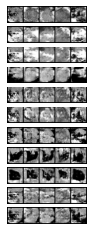

New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_99.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_99.pth
Epoch: 99, Duration: 11.417251110076904 , Gen Loss: 3.9160841346153847 Disc Loss: 0.14308295147235578
Epoch 100 of 100
New Generator model saved at trained_models/conditionalGAN/organcmnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/organcmnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 10.931782960891724 , Gen Loss: 4.040438401442308 Disc Loss: 0.13901378455528846


In [130]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [131]:
# Removes saved intermediary models
model_path = f"models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 1300 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.77it/s]


train -- accuracy: 0.3927
val -- accuracy: 0.6802,  AUC: 0.964
Epoch 1



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.64it/s]


train -- accuracy: 0.6887
val -- accuracy: 0.8269,  AUC: 0.9899
Epoch 2



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.21it/s]


train -- accuracy: 0.7834
val -- accuracy: 0.8859,  AUC: 0.9944
Epoch 3



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.46it/s]


train -- accuracy: 0.8419
val -- accuracy: 0.9084,  AUC: 0.9961
Epoch 4



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.64it/s]


train -- accuracy: 0.875
val -- accuracy: 0.9105,  AUC: 0.9956
Epoch 5



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.95it/s]


train -- accuracy: 0.9008
val -- accuracy: 0.9381,  AUC: 0.9979
Epoch 6



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.43it/s]


train -- accuracy: 0.9148
val -- accuracy: 0.931,  AUC: 0.9973
Epoch 7



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.08it/s]


train -- accuracy: 0.9258
val -- accuracy: 0.9352,  AUC: 0.9971
Epoch 8



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.68it/s]


train -- accuracy: 0.9355
val -- accuracy: 0.9461,  AUC: 0.9985
Epoch 9



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.30it/s]


train -- accuracy: 0.9444
val -- accuracy: 0.9419,  AUC: 0.9979
Epoch 10



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.79it/s]


train -- accuracy: 0.9511
val -- accuracy: 0.944,  AUC: 0.9982
Epoch 11



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.31it/s]


train -- accuracy: 0.9563
val -- accuracy: 0.9498,  AUC: 0.9985
Epoch 12



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.86it/s]


train -- accuracy: 0.9655
val -- accuracy: 0.9503,  AUC: 0.9985
Epoch 13



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.79it/s]


train -- accuracy: 0.9663
val -- accuracy: 0.9465,  AUC: 0.9982
Epoch 14



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.85it/s]


train -- accuracy: 0.9722
val -- accuracy: 0.9561,  AUC: 0.9988
Epoch 15



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.98it/s]


train -- accuracy: 0.9755
val -- accuracy: 0.9469,  AUC: 0.9985
Epoch 16



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.44it/s]


train -- accuracy: 0.9776
val -- accuracy: 0.9557,  AUC: 0.9987
Epoch 17



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.92it/s]


train -- accuracy: 0.9806
val -- accuracy: 0.9561,  AUC: 0.9987
Epoch 18



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.28it/s]


train -- accuracy: 0.9824
val -- accuracy: 0.949,  AUC: 0.9984
Epoch 19



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.45it/s]


train -- accuracy: 0.9873
val -- accuracy: 0.9523,  AUC: 0.9987
test -- accuracy: 0.8543,  AUC: 0.9866


<Figure size 720x720 with 0 Axes>

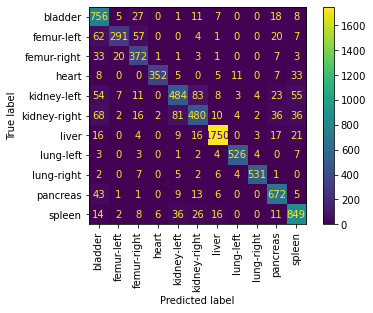

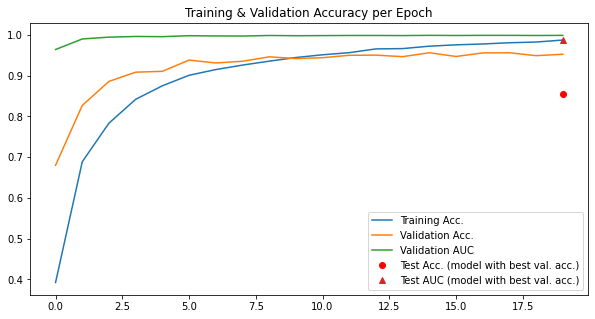

In [132]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [133]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganCMNIST",
  "description": "The OrganCMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Coronal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in coronal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organcmnist.npz?download=1",
  "MD5": "0afa5834fb105f7705a7d93372119a21",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-le

100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.31it/s]


train -- accuracy: 0.4571
val -- accuracy: 0.7454,  AUC: 0.972
Epoch 1



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.63it/s]


train -- accuracy: 0.7073
val -- accuracy: 0.8951,  AUC: 0.9932
Epoch 2



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.11it/s]


train -- accuracy: 0.8088
val -- accuracy: 0.9486,  AUC: 0.9973
Epoch 3



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.23it/s]


train -- accuracy: 0.8598
val -- accuracy: 0.9465,  AUC: 0.998
Epoch 4



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.90it/s]


train -- accuracy: 0.8945
val -- accuracy: 0.9519,  AUC: 0.9986
Epoch 5



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.49it/s]


train -- accuracy: 0.912
val -- accuracy: 0.9523,  AUC: 0.9986
Epoch 6



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.34it/s]


train -- accuracy: 0.9207
val -- accuracy: 0.9494,  AUC: 0.998
Epoch 7



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.64it/s]


train -- accuracy: 0.9301
val -- accuracy: 0.9553,  AUC: 0.9988
Epoch 8



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.39it/s]


train -- accuracy: 0.9466
val -- accuracy: 0.9565,  AUC: 0.9987
Epoch 9



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.54it/s]


train -- accuracy: 0.9503
val -- accuracy: 0.9574,  AUC: 0.999
Epoch 10



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.05it/s]


train -- accuracy: 0.958
val -- accuracy: 0.9636,  AUC: 0.9993
Epoch 11



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.22it/s]


train -- accuracy: 0.9668
val -- accuracy: 0.9519,  AUC: 0.9984
Epoch 12



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 114.05it/s]


train -- accuracy: 0.9683
val -- accuracy: 0.9565,  AUC: 0.9989
Epoch 13



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 115.37it/s]


train -- accuracy: 0.9738
val -- accuracy: 0.9599,  AUC: 0.999
Epoch 14



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.69it/s]


train -- accuracy: 0.9794
val -- accuracy: 0.9615,  AUC: 0.999
Epoch 15



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.47it/s]


train -- accuracy: 0.9821
val -- accuracy: 0.9607,  AUC: 0.999
Epoch 16



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.61it/s]


train -- accuracy: 0.9833
val -- accuracy: 0.9582,  AUC: 0.9989
Epoch 17



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.27it/s]


train -- accuracy: 0.9879
val -- accuracy: 0.9586,  AUC: 0.9991
Epoch 18



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 117.48it/s]


train -- accuracy: 0.9866
val -- accuracy: 0.9636,  AUC: 0.9991
Epoch 19



100%|████████████████████████████████████████| 224/224 [00:01<00:00, 116.79it/s]


train -- accuracy: 0.9897
val -- accuracy: 0.9548,  AUC: 0.9987
test -- accuracy: 0.8694,  AUC: 0.9883


<Figure size 720x720 with 0 Axes>

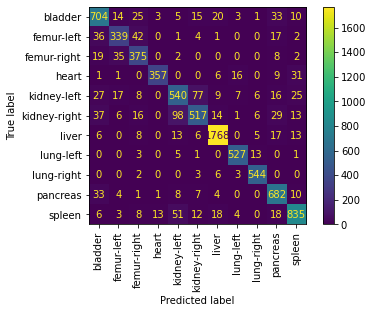

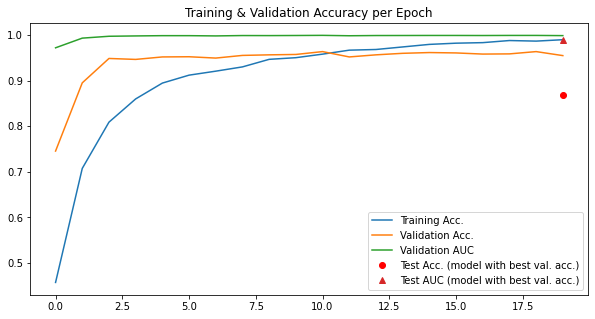

In [134]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

### OrgansMNIST

#### Training the Conditional GAN

In [135]:
# Declares the dataset name and retrieves the base dataset
name_dataset = "organsmnist"
base_dataset = organsmnist_noWRS_noGDA_upscaled

# Retrieves the dataset parameters
n_classes  = len(info_flags[name_dataset][0]["label"])
n_channels = info_flags[name_dataset][0]["n_channels"]

# Retrieves the data loader
train_loader = base_dataset[3] #####################################################
val_loader = base_dataset[5]   ### OF NOTE #########################################
test_loader = base_dataset[4]  ### EVALUATE/TEST NOT IMPLEMENTED YET IN ############
                               ### TORCHFUSION AT THE TIME OF CREATION OF NOTEBOOK #
                               ### Thus the use of None below in the pipeline ######
                               #####################################################

Epoch 1 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_1.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_1.pth
Epoch: 1, Duration: 11.755483627319336 , Gen Loss: 3.166375706151363 Disc Loss: 0.23973187264616214
Epoch 2 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_2.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_2.pth
Epoch: 2, Duration: 11.613192558288574 , Gen Loss: 3.4821991010581064 Disc Loss: 0.2111328125
Epoch 3 of 100


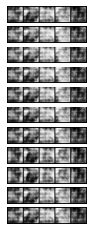

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_3.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_3.pth
Epoch: 3, Duration: 12.060855865478516 , Gen Loss: 3.4119233097202297 Disc Loss: 0.23082464538311515
Epoch 4 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_4.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_4.pth
Epoch: 4, Duration: 11.660447597503662 , Gen Loss: 3.66742568597561 Disc Loss: 0.18964791208975967
Epoch 5 of 100


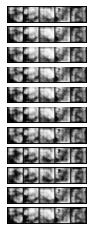

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_5.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_5.pth
Epoch: 5, Duration: 12.125657081604004 , Gen Loss: 3.5876311423959826 Disc Loss: 0.18221540628923064
Epoch 6 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_6.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_6.pth
Epoch: 6, Duration: 11.68944525718689 , Gen Loss: 3.180828550932568 Disc Loss: 0.22829426966575503
Epoch 7 of 100


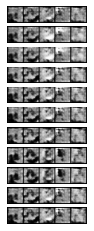

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_7.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_7.pth
Epoch: 7, Duration: 12.065777063369751 , Gen Loss: 2.9319894973995697 Disc Loss: 0.2358260254606797
Epoch 8 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_8.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_8.pth
Epoch: 8, Duration: 11.762896537780762 , Gen Loss: 3.0187508406563843 Disc Loss: 0.2464278758854914
Epoch 9 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_9.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_9.pth
Epoch: 9, Duration: 11.77529501914978 , Gen Loss: 2.9980323036226686 Disc Loss: 0.2415508954391589
Epoch 10 of 100


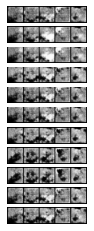

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_10.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_10.pth
Epoch: 10, Duration: 12.078532457351685 , Gen Loss: 3.07576443687231 Disc Loss: 0.2343767688811424
Epoch 11 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_11.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_11.pth
Epoch: 11, Duration: 11.661052465438843 , Gen Loss: 3.181905992198709 Disc Loss: 0.2183308101966015
Epoch 12 of 100


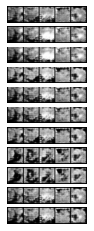

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_12.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_12.pth
Epoch: 12, Duration: 12.157287120819092 , Gen Loss: 3.2817451466104735 Disc Loss: 0.21856453018516858
Epoch 13 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_13.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_13.pth
Epoch: 13, Duration: 11.712326526641846 , Gen Loss: 3.165203270713773 Disc Loss: 0.23076501132083932
Epoch 14 of 100


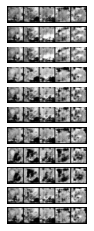

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_14.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_14.pth
Epoch: 14, Duration: 12.082008600234985 , Gen Loss: 3.0305819583931135 Disc Loss: 0.25030498313082855
Epoch 15 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_15.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_15.pth
Epoch: 15, Duration: 11.658174753189087 , Gen Loss: 3.1562284231527977 Disc Loss: 0.22370109831756635
Epoch 16 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_16.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_16.pth
Epoch: 16, Duration: 11.682186365127563 , Gen Loss: 2.9548225654591103 Disc Loss: 0.2525014431267934
Epoch 17 of 100


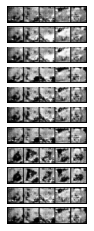

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_17.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_17.pth
Epoch: 17, Duration: 12.185330629348755 , Gen Loss: 2.857918142485653 Disc Loss: 0.2504748657751973
Epoch 18 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_18.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_18.pth
Epoch: 18, Duration: 11.721115589141846 , Gen Loss: 2.8944782886477762 Disc Loss: 0.24081335957115316
Epoch 19 of 100


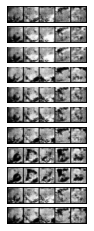

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_19.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_19.pth
Epoch: 19, Duration: 12.160215377807617 , Gen Loss: 2.745775981886657 Disc Loss: 0.2571220058621772
Epoch 20 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_20.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_20.pth
Epoch: 20, Duration: 11.712428092956543 , Gen Loss: 2.7545202093794834 Disc Loss: 0.24715679502555596
Epoch 21 of 100


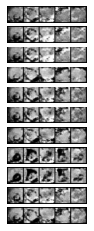

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_21.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_21.pth
Epoch: 21, Duration: 12.157012462615967 , Gen Loss: 2.704276138809182 Disc Loss: 0.2432220327631815
Epoch 22 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_22.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_22.pth
Epoch: 22, Duration: 11.704966306686401 , Gen Loss: 2.673254517126973 Disc Loss: 0.2377564352246234
Epoch 23 of 100


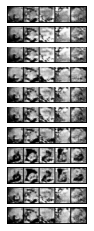

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_23.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_23.pth
Epoch: 23, Duration: 12.105258226394653 , Gen Loss: 2.6816173668400287 Disc Loss: 0.2409554480138092
Epoch 24 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_24.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_24.pth
Epoch: 24, Duration: 11.69139051437378 , Gen Loss: 2.60772787392396 Disc Loss: 0.24103231553196736
Epoch 25 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_25.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_25.pth
Epoch: 25, Duration: 11.666836500167847 , Gen Loss: 2.6239990584648494 Disc Loss: 0.23911635454963234
Epoch 26 of 100


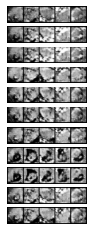

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_26.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_26.pth
Epoch: 26, Duration: 12.134456634521484 , Gen Loss: 2.6290822274031562 Disc Loss: 0.2292649475710635
Epoch 27 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_27.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_27.pth
Epoch: 27, Duration: 11.669512748718262 , Gen Loss: 2.694206756635581 Disc Loss: 0.23444211240136298
Epoch 28 of 100


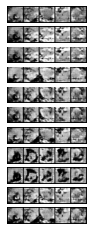

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_28.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_28.pth
Epoch: 28, Duration: 12.050965547561646 , Gen Loss: 2.6888259953371594 Disc Loss: 0.2287057184249462
Epoch 29 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_29.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_29.pth
Epoch: 29, Duration: 11.74813199043274 , Gen Loss: 2.6865545417862267 Disc Loss: 0.2231956011253587
Epoch 30 of 100


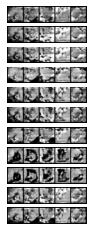

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_30.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_30.pth
Epoch: 30, Duration: 12.190890550613403 , Gen Loss: 2.7441893830703012 Disc Loss: 0.2240226668983142
Epoch 31 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_31.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_31.pth
Epoch: 31, Duration: 11.694417476654053 , Gen Loss: 2.758656519010043 Disc Loss: 0.2235792206554878
Epoch 32 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_32.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_32.pth
Epoch: 32, Duration: 11.66963243484497 , Gen Loss: 2.7049366145086085 Disc Loss: 0.22288186115719152
Epoch 33 of 100


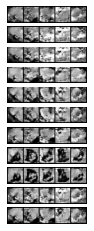

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_33.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_33.pth
Epoch: 33, Duration: 12.055056810379028 , Gen Loss: 2.7863763226327114 Disc Loss: 0.20394945623542862
Epoch 34 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_34.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_34.pth
Epoch: 34, Duration: 11.686159610748291 , Gen Loss: 2.7655120718256816 Disc Loss: 0.21656051044655666
Epoch 35 of 100


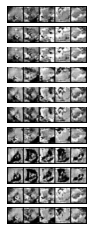

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_35.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_35.pth
Epoch: 35, Duration: 12.168308973312378 , Gen Loss: 2.8344627084827834 Disc Loss: 0.2033395074874462
Epoch 36 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_36.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_36.pth
Epoch: 36, Duration: 11.710288047790527 , Gen Loss: 2.8047337361011477 Disc Loss: 0.20878020058061333
Epoch 37 of 100


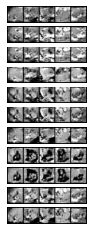

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_37.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_37.pth
Epoch: 37, Duration: 12.085657835006714 , Gen Loss: 2.821621962428264 Disc Loss: 0.21018528767261477
Epoch 38 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_38.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_38.pth
Epoch: 38, Duration: 11.696109056472778 , Gen Loss: 2.8072596283177904 Disc Loss: 0.2066469824639078
Epoch 39 of 100


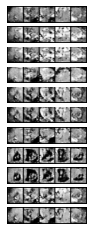

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_39.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_39.pth
Epoch: 39, Duration: 12.211150884628296 , Gen Loss: 2.889165900735294 Disc Loss: 0.1990665736807299
Epoch 40 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_40.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_40.pth
Epoch: 40, Duration: 11.686071395874023 , Gen Loss: 2.9313337854196555 Disc Loss: 0.20599906406922525
Epoch 41 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_41.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_41.pth
Epoch: 41, Duration: 11.70676565170288 , Gen Loss: 2.9488796852582495 Disc Loss: 0.19393988326085007
Epoch 42 of 100


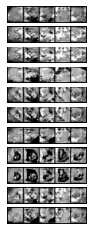

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_42.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_42.pth
Epoch: 42, Duration: 12.048515796661377 , Gen Loss: 2.9037355967539455 Disc Loss: 0.19908151284522957
Epoch 43 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_43.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_43.pth
Epoch: 43, Duration: 11.685374736785889 , Gen Loss: 2.891912605362267 Disc Loss: 0.19762833320256457
Epoch 44 of 100


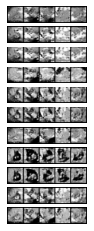

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_44.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_44.pth
Epoch: 44, Duration: 12.16500210762024 , Gen Loss: 2.9682514907639885 Disc Loss: 0.19947683151004303
Epoch 45 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_45.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_45.pth
Epoch: 45, Duration: 11.697500705718994 , Gen Loss: 2.9144284657460546 Disc Loss: 0.19546063066041966
Epoch 46 of 100


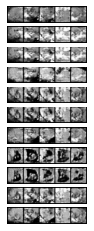

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_46.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_46.pth
Epoch: 46, Duration: 12.054138898849487 , Gen Loss: 3.0549071915351504 Disc Loss: 0.1790830505458662
Epoch 47 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_47.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_47.pth
Epoch: 47, Duration: 11.683093309402466 , Gen Loss: 3.067074852044476 Disc Loss: 0.1885094181536944
Epoch 48 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_48.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_48.pth
Epoch: 48, Duration: 11.667985200881958 , Gen Loss: 3.071362199605452 Disc Loss: 0.18616601842718794
Epoch 49 of 100


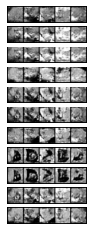

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_49.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_49.pth
Epoch: 49, Duration: 12.208274602890015 , Gen Loss: 3.0674651968256814 Disc Loss: 0.18863444827721484
Epoch 50 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_50.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_50.pth
Epoch: 50, Duration: 11.704307794570923 , Gen Loss: 3.0320819696018653 Disc Loss: 0.19418125672525108
Epoch 51 of 100


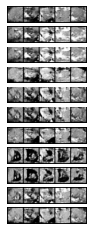

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_51.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_51.pth
Epoch: 51, Duration: 12.08027982711792 , Gen Loss: 3.0580543288199427 Disc Loss: 0.18900193771296628
Epoch 52 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_52.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_52.pth
Epoch: 52, Duration: 11.681767225265503 , Gen Loss: 3.018108298959828 Disc Loss: 0.19194642426806852
Epoch 53 of 100


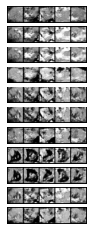

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_53.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_53.pth
Epoch: 53, Duration: 12.166436195373535 , Gen Loss: 3.1362765647417503 Disc Loss: 0.1804288888764347
Epoch 54 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_54.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_54.pth
Epoch: 54, Duration: 11.719051122665405 , Gen Loss: 3.1428339647596846 Disc Loss: 0.18564547698843256
Epoch 55 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_55.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_55.pth
Epoch: 55, Duration: 11.70495080947876 , Gen Loss: 3.135201925663558 Disc Loss: 0.18518957852291068
Epoch 56 of 100


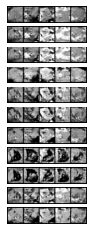

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_56.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_56.pth
Epoch: 56, Duration: 12.071049928665161 , Gen Loss: 3.139016824336442 Disc Loss: 0.1731003792761388
Epoch 57 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_57.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_57.pth
Epoch: 57, Duration: 11.673702001571655 , Gen Loss: 3.1609405824067434 Disc Loss: 0.17862347420866212
Epoch 58 of 100


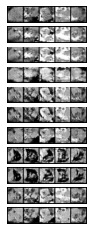

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_58.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_58.pth
Epoch: 58, Duration: 12.165621280670166 , Gen Loss: 3.16875056043759 Disc Loss: 0.18393069558711442
Epoch 59 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_59.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_59.pth
Epoch: 59, Duration: 11.750092267990112 , Gen Loss: 3.150940974713056 Disc Loss: 0.17254691212899032
Epoch 60 of 100


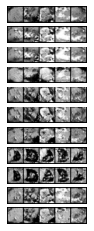

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_60.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_60.pth
Epoch: 60, Duration: 12.114274501800537 , Gen Loss: 3.184152506276901 Disc Loss: 0.17993281404120337
Epoch 61 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_61.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_61.pth
Epoch: 61, Duration: 11.68799352645874 , Gen Loss: 3.230218514616212 Disc Loss: 0.1730829706835097
Epoch 62 of 100


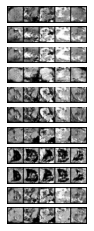

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_62.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_62.pth
Epoch: 62, Duration: 12.146421909332275 , Gen Loss: 3.26723793938307 Disc Loss: 0.17512827015333574
Epoch 63 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_63.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_63.pth
Epoch: 63, Duration: 11.710547924041748 , Gen Loss: 3.2380181245516497 Disc Loss: 0.17308967842091105
Epoch 64 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_64.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_64.pth
Epoch: 64, Duration: 11.711065769195557 , Gen Loss: 3.259946926560258 Disc Loss: 0.1688355893281474
Epoch 65 of 100


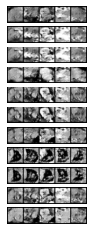

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_65.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_65.pth
Epoch: 65, Duration: 12.069649457931519 , Gen Loss: 3.254837136836442 Disc Loss: 0.17469599763495336
Epoch 66 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_66.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_66.pth
Epoch: 66, Duration: 11.680541038513184 , Gen Loss: 3.2178908491750358 Disc Loss: 0.17053117574201937
Epoch 67 of 100


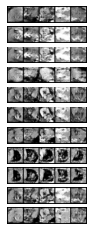

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_67.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_67.pth
Epoch: 67, Duration: 12.141295194625854 , Gen Loss: 3.280835276183644 Disc Loss: 0.1716925950782371
Epoch 68 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_68.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_68.pth
Epoch: 68, Duration: 11.678630828857422 , Gen Loss: 3.352586699695122 Disc Loss: 0.16838683644189384
Epoch 69 of 100


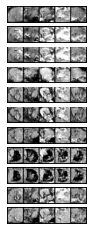

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_69.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_69.pth
Epoch: 69, Duration: 12.107209205627441 , Gen Loss: 3.35489149928264 Disc Loss: 0.16143793574022597
Epoch 70 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_70.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_70.pth
Epoch: 70, Duration: 11.698988676071167 , Gen Loss: 3.45122287482066 Disc Loss: 0.17039761645893114
Epoch 71 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_71.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_71.pth
Epoch: 71, Duration: 11.69938325881958 , Gen Loss: 3.366433151004304 Disc Loss: 0.16881501076040173
Epoch 72 of 100


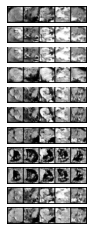

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_72.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_72.pth
Epoch: 72, Duration: 12.195332050323486 , Gen Loss: 3.5032502578012914 Disc Loss: 0.15986722182680238
Epoch 73 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_73.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_73.pth
Epoch: 73, Duration: 11.70726203918457 , Gen Loss: 3.5322142328730273 Disc Loss: 0.16224690988723997
Epoch 74 of 100


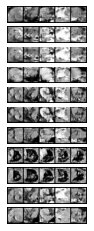

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_74.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_74.pth
Epoch: 74, Duration: 12.05391526222229 , Gen Loss: 3.3470885267216643 Disc Loss: 0.1629118866010581
Epoch 75 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_75.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_75.pth
Epoch: 75, Duration: 11.710081100463867 , Gen Loss: 3.399030162751076 Disc Loss: 0.16832809557702655
Epoch 76 of 100


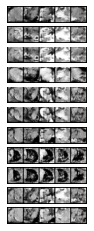

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_76.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_76.pth
Epoch: 76, Duration: 12.14711332321167 , Gen Loss: 3.3688180931671448 Disc Loss: 0.16446151405017037
Epoch 77 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_77.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_77.pth
Epoch: 77, Duration: 11.703955173492432 , Gen Loss: 3.3812172144010044 Disc Loss: 0.16709085954313127
Epoch 78 of 100


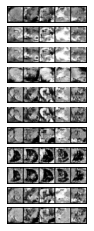

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_78.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_78.pth
Epoch: 78, Duration: 12.075483322143555 , Gen Loss: 3.4365105474354376 Disc Loss: 0.16465006627174497
Epoch 79 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_79.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_79.pth
Epoch: 79, Duration: 11.711928129196167 , Gen Loss: 3.350181861997848 Disc Loss: 0.17596015218682748
Epoch 80 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_80.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_80.pth
Epoch: 80, Duration: 11.708889961242676 , Gen Loss: 3.3430172278515062 Disc Loss: 0.1687747818496682
Epoch 81 of 100


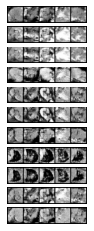

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_81.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_81.pth
Epoch: 81, Duration: 12.15852427482605 , Gen Loss: 3.4149639638629843 Disc Loss: 0.16089783152685616
Epoch 82 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_82.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_82.pth
Epoch: 82, Duration: 11.69515085220337 , Gen Loss: 3.4524048376972742 Disc Loss: 0.15559810600116572
Epoch 83 of 100


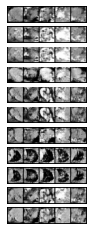

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_83.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_83.pth
Epoch: 83, Duration: 12.069187641143799 , Gen Loss: 3.4313250986370156 Disc Loss: 0.16431856743745515
Epoch 84 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_84.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_84.pth
Epoch: 84, Duration: 11.698238372802734 , Gen Loss: 3.4275415844691537 Disc Loss: 0.16654201600609755
Epoch 85 of 100


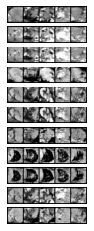

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_85.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_85.pth
Epoch: 85, Duration: 12.138008832931519 , Gen Loss: 3.347926941355811 Disc Loss: 0.1699326108825771
Epoch 86 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_86.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_86.pth
Epoch: 86, Duration: 11.722837924957275 , Gen Loss: 3.4412302725968438 Disc Loss: 0.15816862306088594
Epoch 87 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_87.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_87.pth
Epoch: 87, Duration: 11.719965934753418 , Gen Loss: 3.5218520220588236 Disc Loss: 0.15884237412571736
Epoch 88 of 100


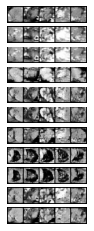

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_88.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_88.pth
Epoch: 88, Duration: 12.074912309646606 , Gen Loss: 3.527653391768293 Disc Loss: 0.16101921880604375
Epoch 89 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_89.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_89.pth
Epoch: 89, Duration: 11.67748212814331 , Gen Loss: 3.488303387284792 Disc Loss: 0.1631876569225251
Epoch 90 of 100


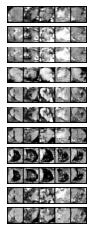

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_90.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_90.pth
Epoch: 90, Duration: 12.24030327796936 , Gen Loss: 3.576703450053802 Disc Loss: 0.14810748982805774
Epoch 91 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_91.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_91.pth
Epoch: 91, Duration: 11.701133966445923 , Gen Loss: 3.585134112715208 Disc Loss: 0.16040849945637553
Epoch 92 of 100


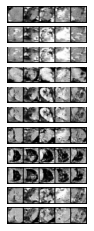

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_92.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_92.pth
Epoch: 92, Duration: 12.067176342010498 , Gen Loss: 3.5835469534612625 Disc Loss: 0.14373948303835635
Epoch 93 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_93.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_93.pth
Epoch: 93, Duration: 11.671368837356567 , Gen Loss: 3.600871760670732 Disc Loss: 0.15566810815885043
Epoch 94 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_94.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_94.pth
Epoch: 94, Duration: 11.68447732925415 , Gen Loss: 3.584184451219512 Disc Loss: 0.1441431469691535
Epoch 95 of 100


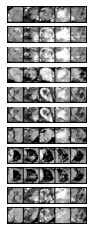

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_95.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_95.pth
Epoch: 95, Duration: 12.192795753479004 , Gen Loss: 3.655380200860832 Disc Loss: 0.1440071182579358
Epoch 96 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_96.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_96.pth
Epoch: 96, Duration: 11.704449892044067 , Gen Loss: 3.7304810796269727 Disc Loss: 0.14708756346955704
Epoch 97 of 100


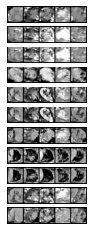

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_97.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_97.pth
Epoch: 97, Duration: 12.054200649261475 , Gen Loss: 3.5699325233142036 Disc Loss: 0.15656680486123564
Epoch 98 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_98.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_98.pth
Epoch: 98, Duration: 11.65966248512268 , Gen Loss: 3.740200468525825 Disc Loss: 0.14589032866862447
Epoch 99 of 100


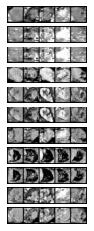

New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_99.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_99.pth
Epoch: 99, Duration: 12.150474071502686 , Gen Loss: 3.6946004640423245 Disc Loss: 0.1405491482749731
Epoch 100 of 100
New Generator model saved at trained_models/conditionalGAN/organsmnist/gen_models/gen_model_100.pth
New Discriminator model saved at trained_models/conditionalGAN/organsmnist/disc_models/disc_model_100.pth
Epoch: 100, Duration: 11.772743463516235 , Gen Loss: 3.7013083415530845 Disc Loss: 0.14730960183711442


In [136]:
# Runs the Cond GAN
run_GAN_pipeline(
    train_loader, None, None, #val_loader, test_loader, 
    n_channels, latent_dims, n_classes,
    epochs=epochs, name_dataset=name_dataset
)

#### Generating an upgraded dataset without Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [137]:
# Removes saved intermediary models
model_path = f"models/conditionalGAN/{name_dataset}/gen_models/"
models = [x for x in os.listdir(model_path) 
          if x[-(4+len(str(epochs))):]!=f"{epochs}.pth"]
for model in models:
    os.remove(model_path+model)
# Fetches the generated GAN Model model to import
model_path += f"gen_model_{epochs}.pth"

# Calculates the number of images to generate
percentage = 10
nb_images_in_dataset = len(base_dataset[0])
n_generated_images = int((percentage/100)*nb_images_in_dataset)
print(f"Number of generated images: {n_generated_images}",
      f"({percentage}% of the dataset)")

# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=False
)

Number of generated images: 1394 (10% of the dataset)


2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.22it/s]


train -- accuracy: 0.3392
val -- accuracy: 0.498,  AUC: 0.9218
Epoch 1



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.35it/s]


train -- accuracy: 0.5612
val -- accuracy: 0.69,  AUC: 0.9714
Epoch 2



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.69it/s]


train -- accuracy: 0.6729
val -- accuracy: 0.7471,  AUC: 0.9827
Epoch 3



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.42it/s]


train -- accuracy: 0.7386
val -- accuracy: 0.7904,  AUC: 0.9859
Epoch 4



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.59it/s]


train -- accuracy: 0.7742
val -- accuracy: 0.8042,  AUC: 0.9866
Epoch 5



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.02it/s]


train -- accuracy: 0.8002
val -- accuracy: 0.8132,  AUC: 0.9879
Epoch 6



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.71it/s]


train -- accuracy: 0.8244
val -- accuracy: 0.8438,  AUC: 0.9891
Epoch 7



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.45it/s]


train -- accuracy: 0.8434
val -- accuracy: 0.8336,  AUC: 0.9892
Epoch 8



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.51it/s]


train -- accuracy: 0.8617
val -- accuracy: 0.8373,  AUC: 0.9885
Epoch 9



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 115.56it/s]


train -- accuracy: 0.8784
val -- accuracy: 0.8593,  AUC: 0.99
Epoch 10



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.69it/s]


train -- accuracy: 0.894
val -- accuracy: 0.8361,  AUC: 0.989
Epoch 11



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.74it/s]


train -- accuracy: 0.9004
val -- accuracy: 0.8246,  AUC: 0.99
Epoch 12



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.47it/s]


train -- accuracy: 0.915
val -- accuracy: 0.854,  AUC: 0.99
Epoch 13



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.94it/s]


train -- accuracy: 0.9241
val -- accuracy: 0.8626,  AUC: 0.9902
Epoch 14



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.73it/s]


train -- accuracy: 0.9383
val -- accuracy: 0.8491,  AUC: 0.9893
Epoch 15



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.92it/s]


train -- accuracy: 0.9418
val -- accuracy: 0.8495,  AUC: 0.9892
Epoch 16



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.69it/s]


train -- accuracy: 0.9436
val -- accuracy: 0.8356,  AUC: 0.9887
Epoch 17



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.03it/s]


train -- accuracy: 0.9459
val -- accuracy: 0.8495,  AUC: 0.9894
Epoch 18



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.92it/s]


train -- accuracy: 0.9523
val -- accuracy: 0.8532,  AUC: 0.9896
Epoch 19



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.03it/s]


train -- accuracy: 0.9594
val -- accuracy: 0.8532,  AUC: 0.9896
test -- accuracy: 0.7227,  AUC: 0.9646


<Figure size 720x720 with 0 Axes>

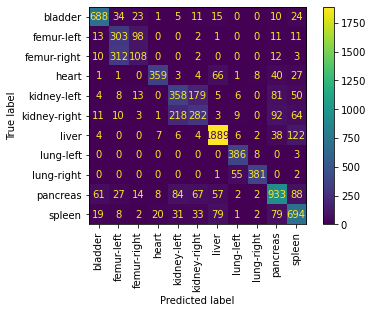

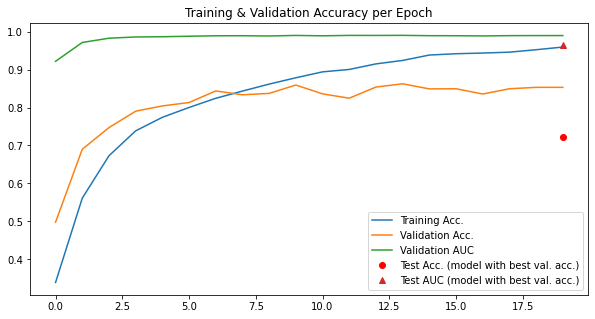

In [138]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)

#### Generating an upgraded dataset with Weighted Random Sampling and training the classifier

1. <u>Generating the dataset</u>

In [139]:
# Creates the augmented dataloader
condGAN_loader = generate_augmented_dataset_condGAN(
    n_channels, n_classes, latent_dims, model_path,
    base_dataset[0], 64, 
    test_loader, val_loader, n_generated_images,
    weighted_sampling=True
)

2. <u>Retraining the classifier and assessing changes in performance</u>

{
  "python_class": "OrganSMNIST",
  "description": "The OrganSMNIST is based on 3D computed tomography (CT) images from Liver Tumor Segmentation Benchmark (LiTS). It is renamed from OrganMNIST_Sagittal (in MedMNIST v1) for simplicity. We use bounding-box annotations of 11 body organs from another study to obtain the organ labels. Hounsfield-Unit (HU) of the 3D images are transformed into gray-scale with an abdominal window. We crop 2D images from the center slices of the 3D bounding boxes in sagittal views (planes). The images are resized into 1\u00d728\u00d728 to perform multi-class classification of 11 body organs. 115 and 16 CT scans from the source training set are used as training and validation set, respectively. The 70 CT scans from the source test set are treated as the test set.",
  "url": "https://zenodo.org/record/5208230/files/organsmnist.npz?download=1",
  "MD5": "e5c39f1af030238290b9557d9503af9d",
  "task": "multi-class",
  "label": {
    "0": "bladder",
    "1": "femur-

100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.83it/s]


train -- accuracy: 0.3506
val -- accuracy: 0.5763,  AUC: 0.9444
Epoch 1



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.82it/s]


train -- accuracy: 0.5703
val -- accuracy: 0.7447,  AUC: 0.9754
Epoch 2



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.54it/s]


train -- accuracy: 0.6747
val -- accuracy: 0.7516,  AUC: 0.9841
Epoch 3



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.12it/s]


train -- accuracy: 0.7113
val -- accuracy: 0.801,  AUC: 0.9873
Epoch 4



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.30it/s]


train -- accuracy: 0.7417
val -- accuracy: 0.8397,  AUC: 0.9895
Epoch 5



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.37it/s]


train -- accuracy: 0.7778
val -- accuracy: 0.8254,  AUC: 0.9891
Epoch 6



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.70it/s]


train -- accuracy: 0.7984
val -- accuracy: 0.8238,  AUC: 0.9895
Epoch 7



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.18it/s]


train -- accuracy: 0.8222
val -- accuracy: 0.8458,  AUC: 0.99
Epoch 8



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.92it/s]


train -- accuracy: 0.829
val -- accuracy: 0.8552,  AUC: 0.9903
Epoch 9



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.56it/s]


train -- accuracy: 0.8542
val -- accuracy: 0.8569,  AUC: 0.9905
Epoch 10



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.32it/s]


train -- accuracy: 0.864
val -- accuracy: 0.8597,  AUC: 0.9904
Epoch 11



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.55it/s]


train -- accuracy: 0.8824
val -- accuracy: 0.8479,  AUC: 0.9902
Epoch 12



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.14it/s]


train -- accuracy: 0.8931
val -- accuracy: 0.8593,  AUC: 0.9907
Epoch 13



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.96it/s]


train -- accuracy: 0.9038
val -- accuracy: 0.8569,  AUC: 0.9906
Epoch 14



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.99it/s]


train -- accuracy: 0.9167
val -- accuracy: 0.8569,  AUC: 0.9908
Epoch 15



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.15it/s]


train -- accuracy: 0.9301
val -- accuracy: 0.8564,  AUC: 0.9906
Epoch 16



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.86it/s]


train -- accuracy: 0.9337
val -- accuracy: 0.8491,  AUC: 0.99
Epoch 17



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 116.92it/s]


train -- accuracy: 0.9432
val -- accuracy: 0.8691,  AUC: 0.9915
Epoch 18



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.28it/s]


train -- accuracy: 0.9548
val -- accuracy: 0.8626,  AUC: 0.9906
Epoch 19



100%|████████████████████████████████████████| 240/240 [00:02<00:00, 117.98it/s]


train -- accuracy: 0.957
val -- accuracy: 0.8515,  AUC: 0.9897
test -- accuracy: 0.7147,  AUC: 0.9616


<Figure size 720x720 with 0 Axes>

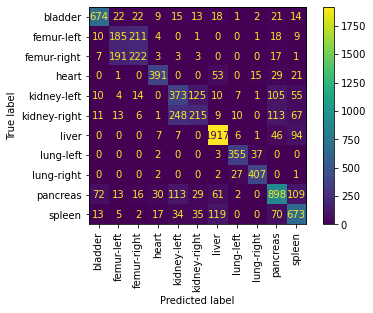

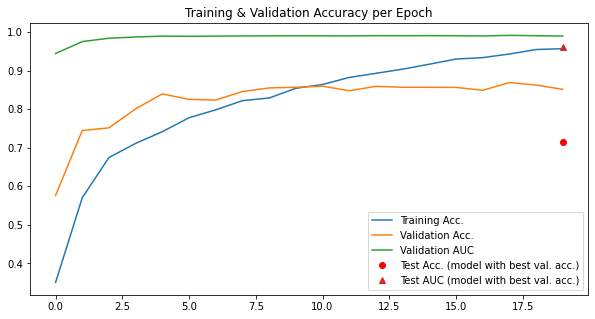

In [140]:
# Runs the classifier again 

clf = run_classifier_pipeline(name_dataset, info_flags, condGAN_loader)